Britton Lab - 06/09/2023 <br>

Early Polarization - Allan Deviation Plots


<font color='red'>Author: Evan McClintock

In [19]:
import numpy as np
#from numpy import linalg as la
import matplotlib.pyplot as plt
import pandas as pd
#from datetime import timedelta
import allantools #https://allantools.readthedocs.io/en/latest/functions.html
import os
#import scipy
#import copy
#import math
#import time
#import pypolar.jones as jones #https://pypolar.readthedocs.io/en/latest/05-Jones-Examples.html
#import pypolar.mueller as mueller
#import pypolar.visualization as vis
#import py_pol
#from py_pol.jones_vector import Jones_vector, degrees #https://py-pol.readthedocs.io/en/master/source/tutorial/Drawing_docs.html
#from py_pol.stokes import Stokes, create_Stokes, degrees
#import seaborn as sns
#import plotly.graph_objs as go   # For plotting 3D vectors
#from plotly.offline import iplot
#import warnings

In [23]:
import importlib
import dataset
import stationary
import switch
import plotting
import pairs
importlib.reload(dataset)
importlib.reload(stationary)
importlib.reload(switch)
importlib.reload(plotting)
importlib.reload(pairs)
from dataset import Dataset
from stationary import StationarySet
from switch import SwitchSet
from plotting import plot_rot_angle
from pairs import IOPair

In [21]:
# plt.ioff() #https://matplotlib.org/stable/api/_as_gen/matplotlib.pyplot.ioff.html
# plt.close('all')
BOLD_ON = "\033[1m"
BOLD_OFF = "\033[0m"
LAB = "/mnt/c/Users/2020n/Documents/Career/Locations/Britton Lab/"
DATA = LAB + "QWDM_Project/H1_Datasets/"

In [15]:
import sys
print(sys.executable)
print(sys.version)
print(sys.version_info)

/home/evanshaped/anaconda3/envs/britton2024envWSL/bin/python
3.12.2 | packaged by conda-forge | (main, Feb 16 2024, 20:50:58) [GCC 12.3.0]
sys.version_info(major=3, minor=12, micro=2, releaselevel='final', serial=0)


# Read in data

## Individual Datasets

### Displaying datasets

In [108]:
folder_path = 'Datasets/Whole_setup/Initial_runs'
datasets = []
i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv'):
        file_path = os.path.join(folder_path, file_name)
        #display(file_path)
        ds = SwitchSet(file_path)
        datasets.append(ds)
        print('{:d}: {:s}'.format(i, ds.title))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
# for ds in datasets:
#     rate_hist_fig = ds.rate_hist(bins=80, xmax=0.08)
#     display(rate_hist_fig); plt.close(rate_hist_fig)

===== Datasets =====
0: PAX_1345_2Hz_DC_stability_1
1: PAX_1345_entire_30m
2: PAX_1345_entire_30m_stab_1
3: PAX_1345_fast_1
4: PAX_1345_fast_2
5: PAX_1345_stab_2
6: PAX_1545_2Hz_DC_stability_1
7: PAX_1545_stab_2


### Stable dataset (Switching)

In [32]:
plt.ioff()
plt.close('all')

In [38]:
filename = 'Datasets/Whole_setup/08-01/PAX_1345_stab_2.csv'
ds = SwitchSet(filename)
ds.find_switches(nominal_switch_rate=2, print_process=False)
ds.average_data(print_process=True)

Time range: min=20.003, max=300.008
=== starting average_data ===
averaging data... Done
Dropped 28 observations with <4 points (out of total 1118 observations)

--- interpolating data ---
length before: 545
length after: 559
14 total added
--- end interpolating data ---

--- interpolating data ---
length before: 545
length after: 559
14 total added
--- end interpolating data ---
Signal 1 size=559	Signal 1 range: t=(20.66,299.66)
Signal 2 size=559	Signal 2 range: t=(20.41,299.41)
=== end average_data ===


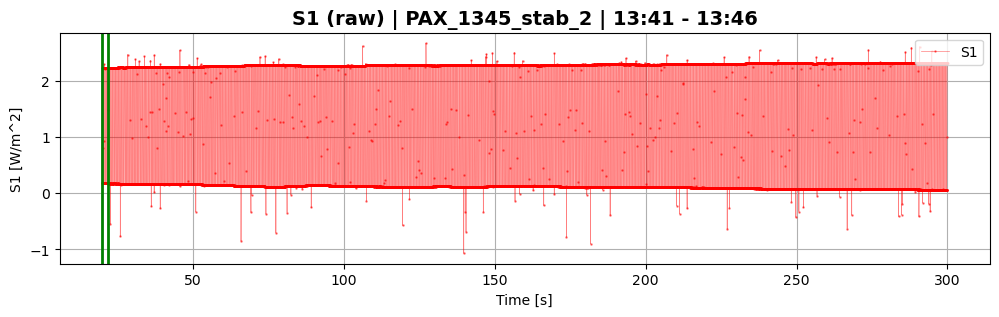

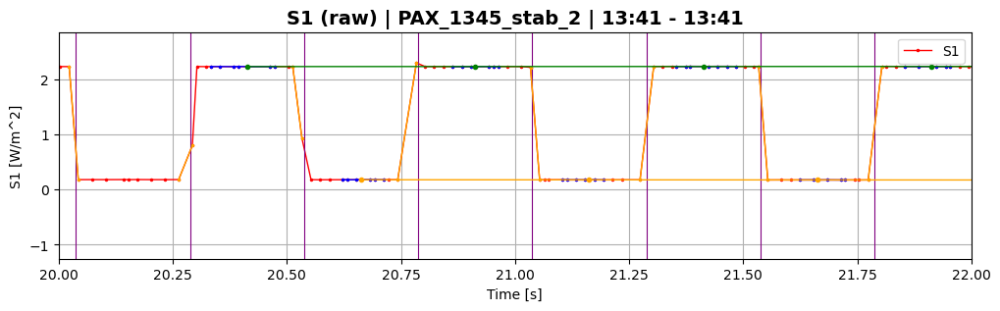

In [37]:
ds.plot_raw(plot_param='S1', sample_range=(20,22),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)
#ds.rate_hist(bins=80)

### Sectioned stable dataset (switching)

updating NCP_fig
updating CP_fig


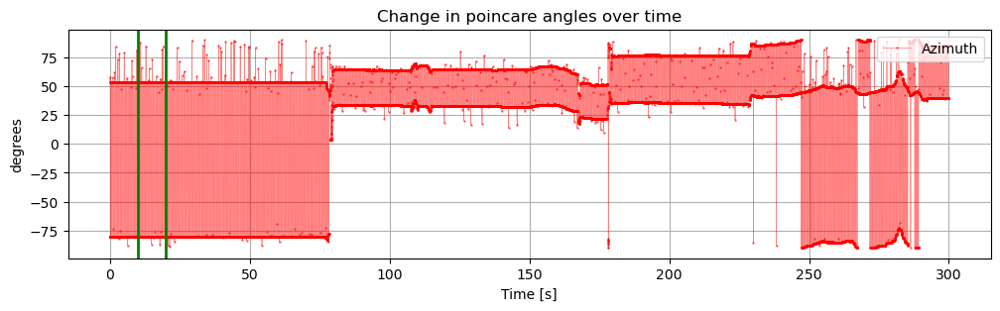

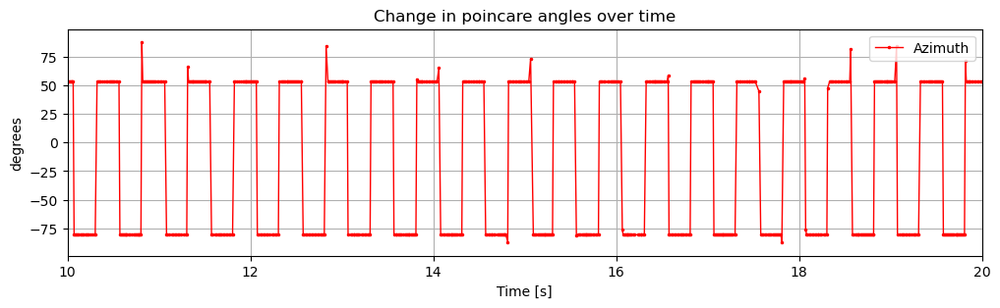

In [84]:
plt.ioff()
plt.close('all')
filename = 'Datasets/Whole_setup/PAX_1345_entire_30m.csv'
ds = SwitchSet(filename)
ds.plot(sample_range=(10,20),plot_param='Azimuth')
#ds.plot(sample_range=(250,260),plot_param='Ellipticity')
#rate_hist_fig = ds.rate_hist(bins=80); display(rate_hist_fig); plt.close(rate_hist_fig)

degree_tolerance = 3.0
first_tolerance = 1.0
second_tolerance = 0.5

jump_fig for: switch parameter = Azimuth



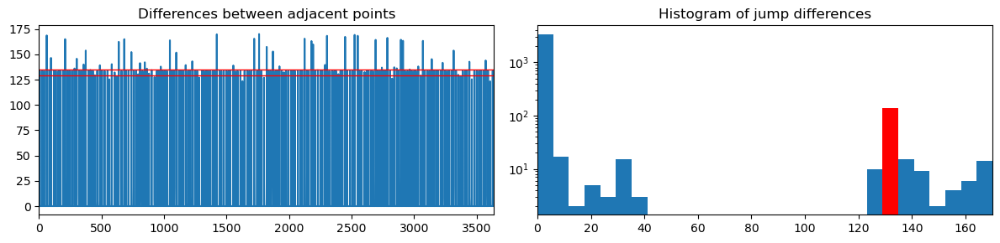



jump_fig for: switch parameter = Ellipticity



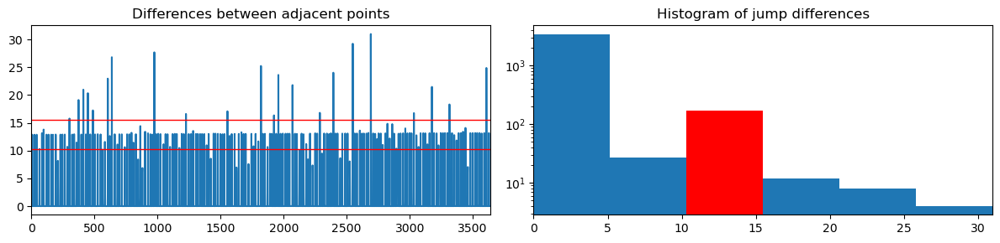



switch parameter = Azimuth

Jump points detected: 140
out of total: ~200.0



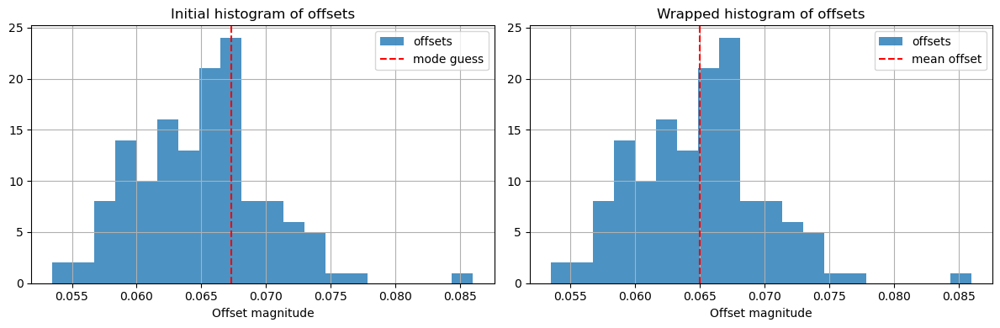

False    20260
True      1200
Name: IsStartPoint, dtype: int64

Int64Index([], dtype='int64')

In [85]:
nominal_switch_rate = 2   # 2 Hz
change_point_range = (10,60)
ds.change_point(nominal_switch_rate, change_point_range, n_exclude=3, print_process=True)
avg_df_arr = ds.average_data()

updating CP_fig
plotting jumps


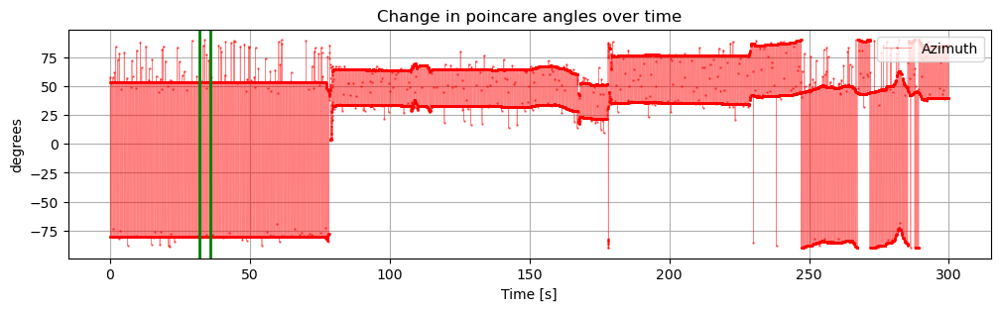

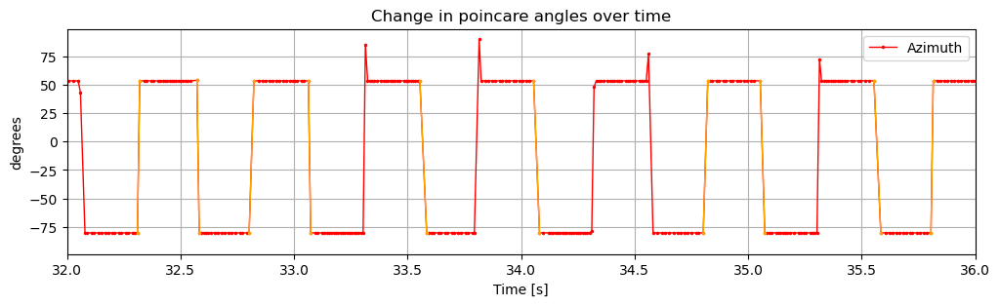

updating CP_fig


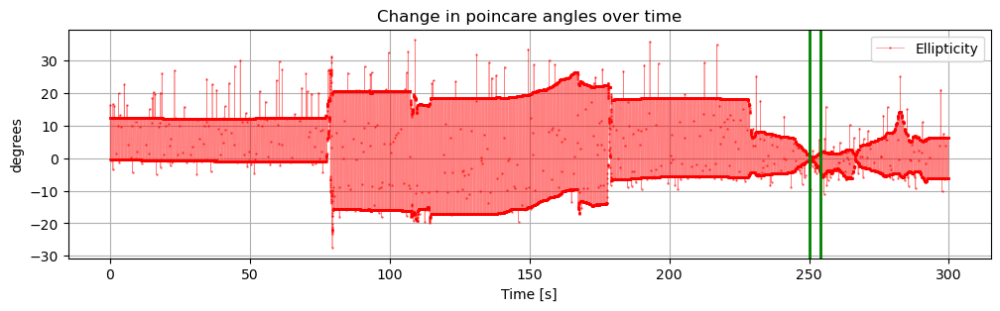

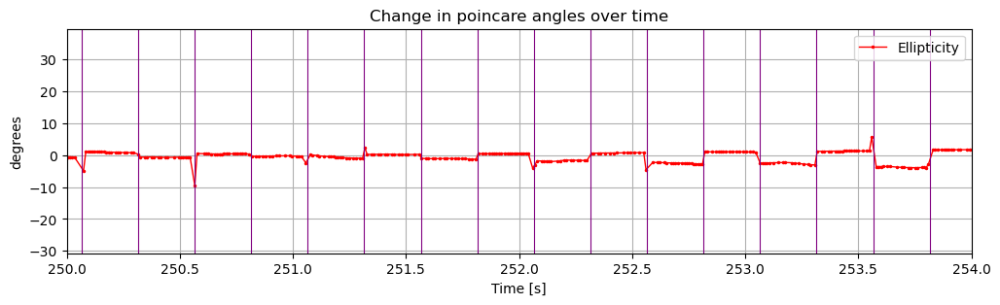

In [164]:
ds.plot(sample_range=(32,36),plot_param='Azimuth',plot_switch=False,plot_jumps=True,plot_valid=False,plot_avg=False)
ds.plot(sample_range=(250,254),plot_param='Ellipticity',plot_switch=True,plot_jumps=False,plot_valid=False,plot_avg=False)

updating CP_fig
plotting jumps


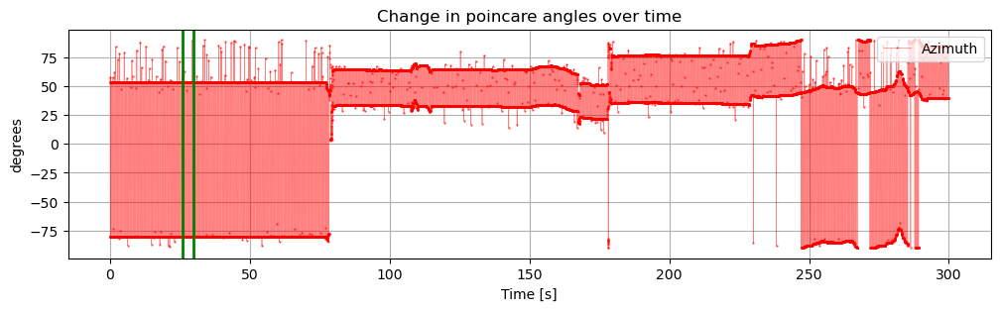

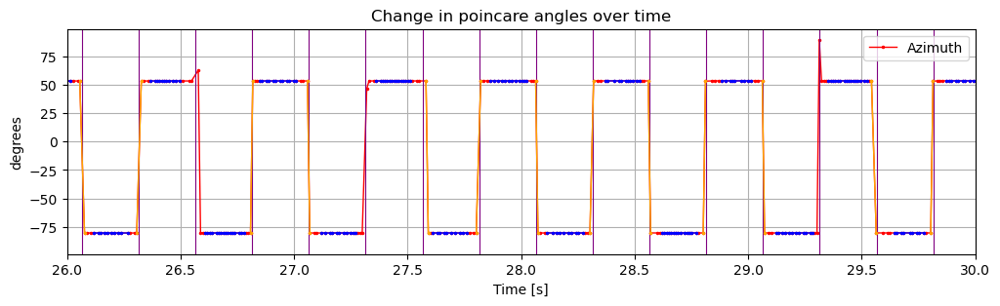

updating CP_fig


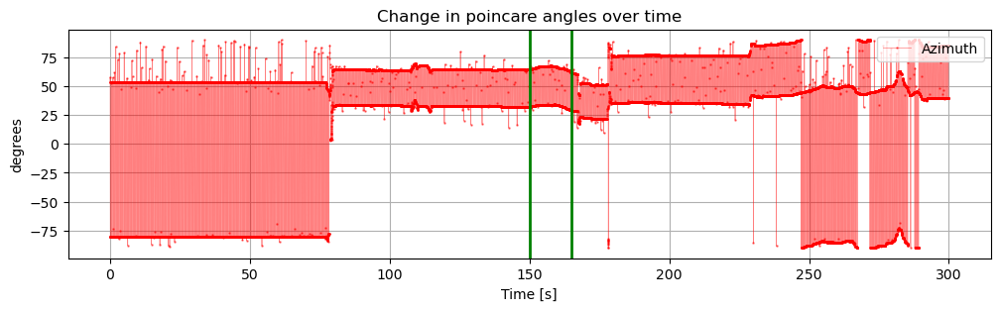

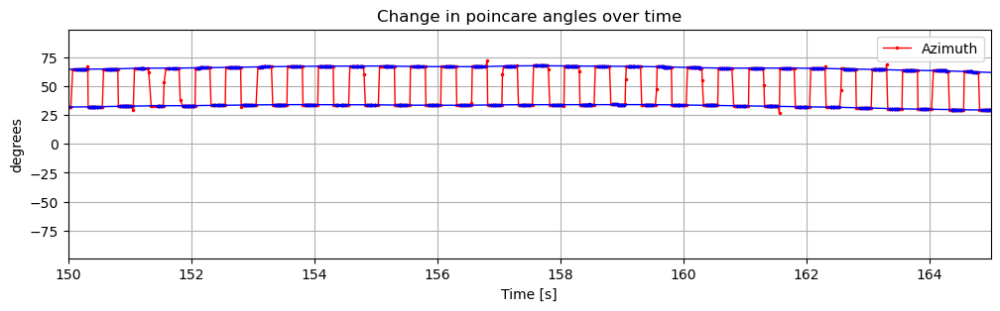

updating CP_fig


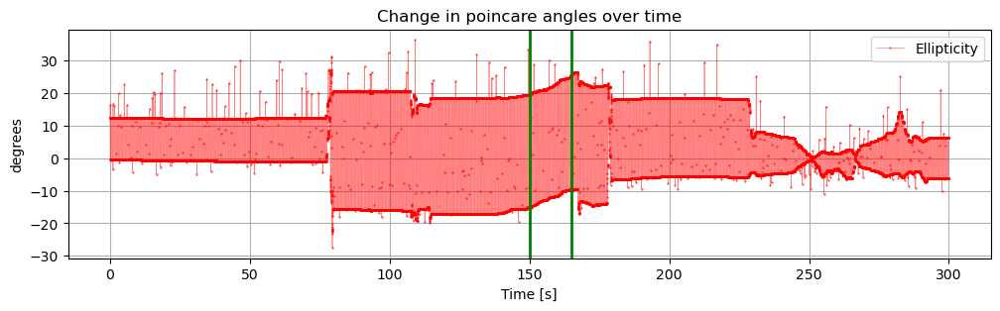

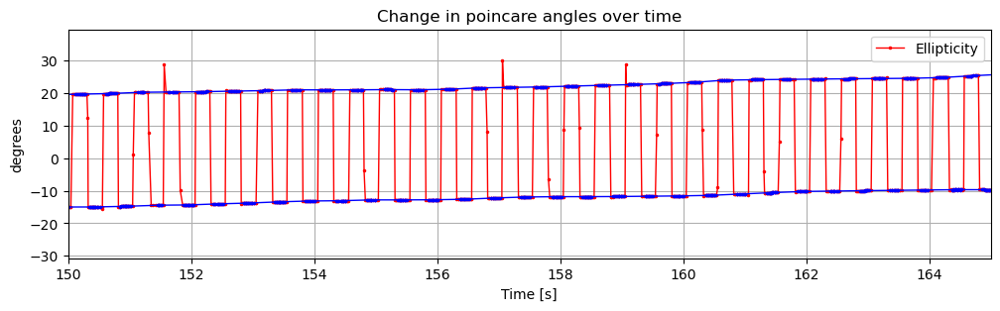

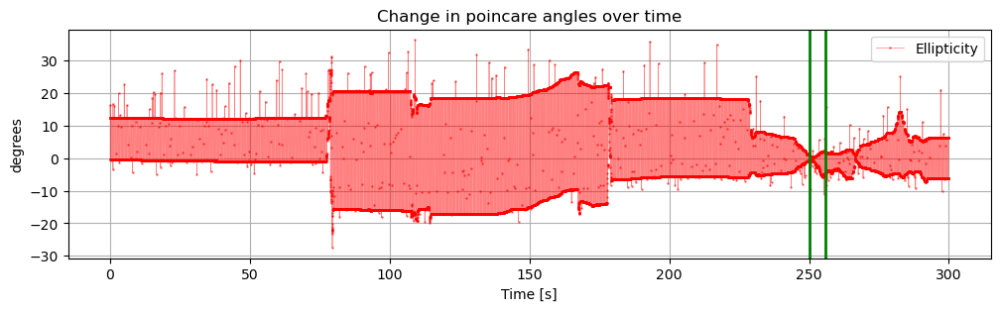

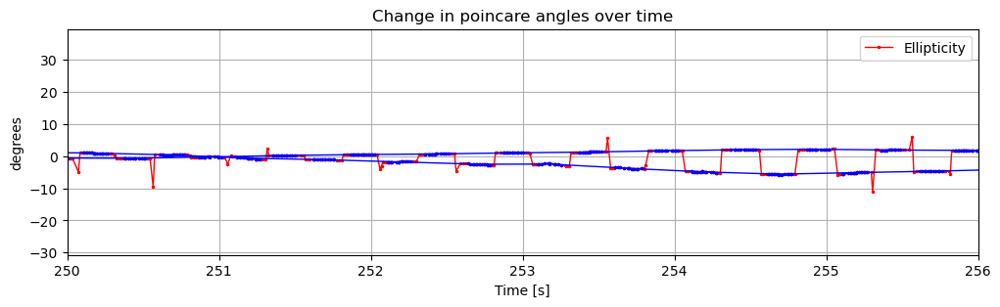

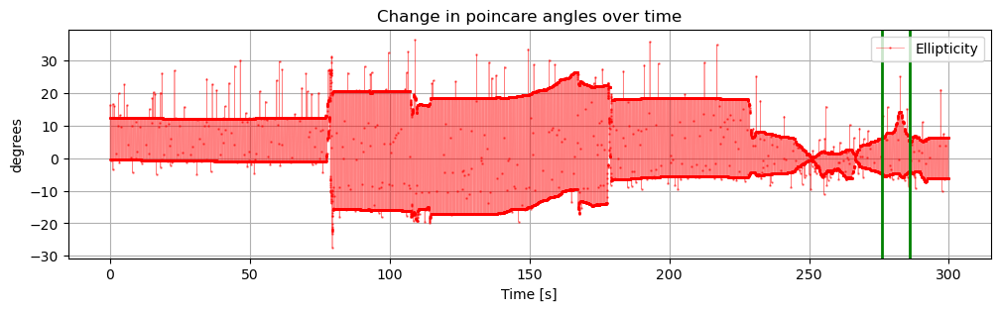

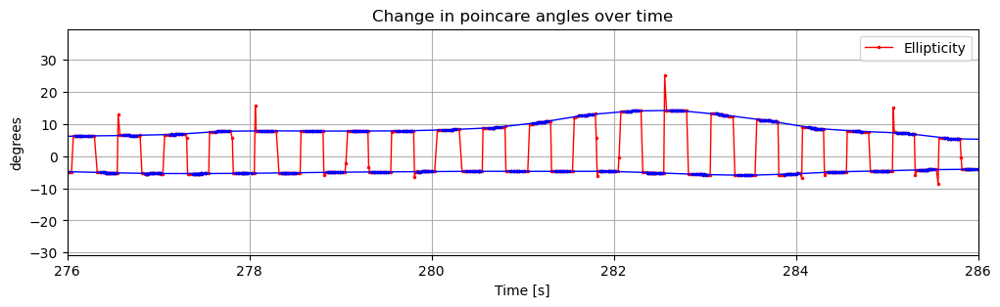

In [165]:
ds.plot(sample_range=(26,30),plot_param='Azimuth',plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=False)
ds.plot(sample_range=(150,165),plot_param='Azimuth',plot_switch=False,plot_jumps=False,plot_valid=True,plot_avg=True)
ds.plot(sample_range=(150,165),plot_param='Ellipticity',plot_switch=False,plot_jumps=False,plot_valid=True,plot_avg=True)
ds.plot(sample_range=(250,256),plot_param='Ellipticity',plot_switch=False,plot_jumps=False,plot_valid=True,plot_avg=True)
ds.plot(sample_range=(276,286),plot_param='Ellipticity',plot_switch=False,plot_jumps=False,plot_valid=True,plot_avg=True)

In [176]:
avg_df_arr[0].loc[150:170]

,StartTime,EndTime,AvgTime,Length,NumPoints,AvgSampleRate,AzimuthAvg,AzimuthStd,EllipticityAvg,EllipticityStd
150,75.101,75.252,75.173643,0.151,14,92.715232,-80.052857,0.008254,12.410714,0.002673
151,75.622,75.783,75.716231,0.161,13,80.745342,-80.053077,0.008549,12.410769,0.002774
152,76.140,76.281,76.214308,0.141,13,92.198582,-80.055385,0.007763,12.416154,0.005064
153,76.621,76.762,76.696400,0.141,10,70.921986,-80.055000,0.005270,12.419000,0.003162
154,77.124,77.264,77.203000,0.140,10,71.428571,-81.139000,0.372065,13.003000,0.174868
155,77.646,77.776,77.717111,0.130,9,69.230769,-82.076667,0.381182,16.153333,0.115109
156,78.107,78.258,78.186000,0.151,12,79.470199,-78.219167,0.410154,17.755833,0.079825
157,78.619,78.760,78.691900,0.141,10,70.921986,52.478000,8.414404,23.184000,2.889768
158,79.121,79.251,79.194750,0.130,8,61.538462,19.028750,6.490750,28.115000,2.164994
159,79.602,79.752,79.679273,0.150,11,73.333333,63.142727,0.439888,20.328182,0.248669


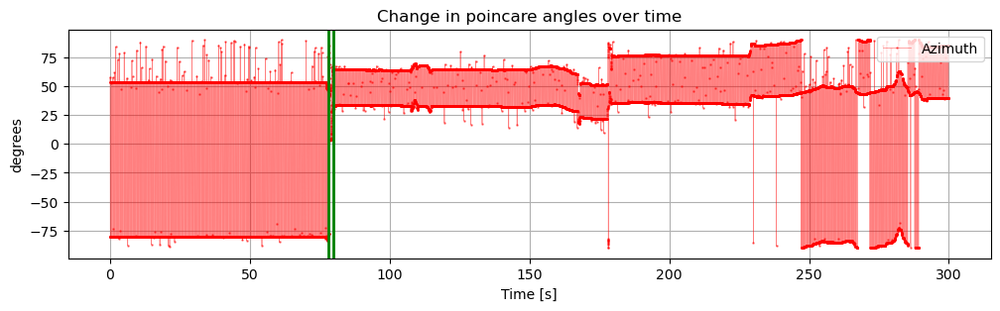

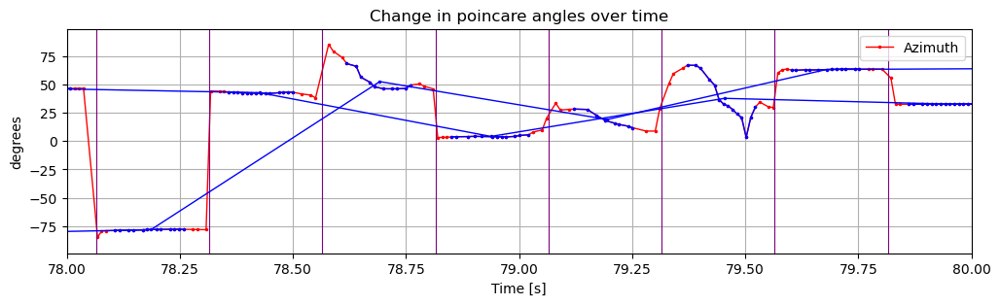

In [172]:
ds.plot(sample_range=(78,80),plot_param='Azimuth',plot_switch=True,plot_jumps=False,plot_valid=True,plot_avg=True)

updating CP_fig


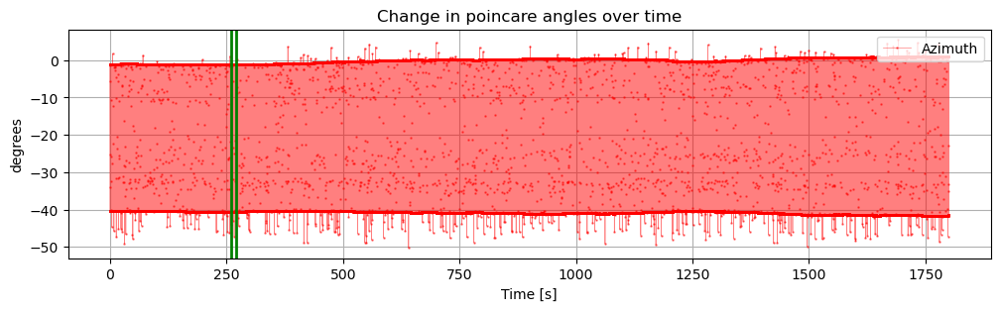

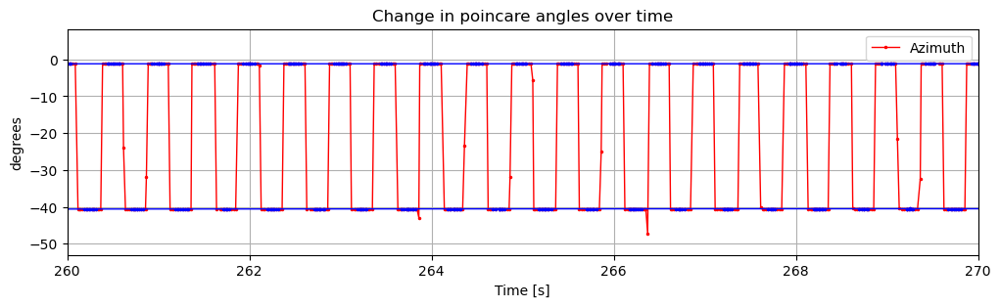

In [60]:
sample_range = (260,270)
#times = ds.df.nlargest(5, 'TimeDiff')['TimeElapsed']   # Timestamps of largest 5 time diffs
#sample_offset = times.iloc[0]-(sample_length/2)
ds.plot(sample_range=sample_range,plot_param='Azimuth',plot_switch=False,plot_jumps=False,plot_avg=True)

### Unstable dataset (switching)

Time range: min=20.014, max=1800.004


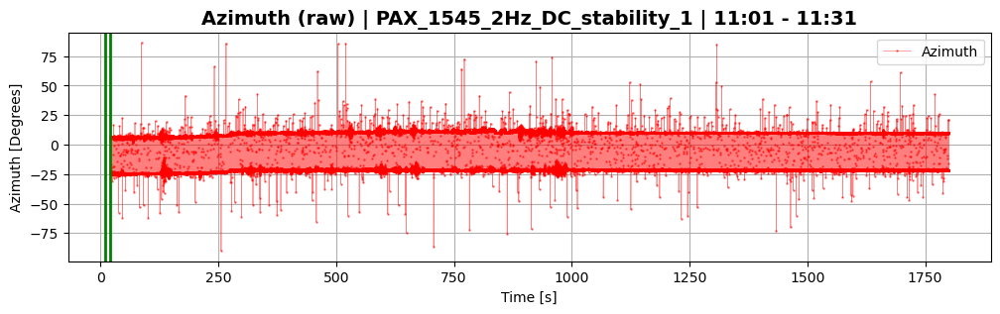

KeyError: nan

In [60]:
plt.ioff()
plt.close('all')
filename = 'Datasets/Whole_setup/08-01/PAX_1545_2Hz_DC_stability_1.csv'
#ds = datasets[0]
ds = SwitchSet(filename)
ds.plot_raw(sample_range=(10,20),plot_param='Azimuth')

degree_tolerance = 3.0
first_tolerance = 1.0
second_tolerance = 0.5

jump_fig for: switch parameter = Azimuth



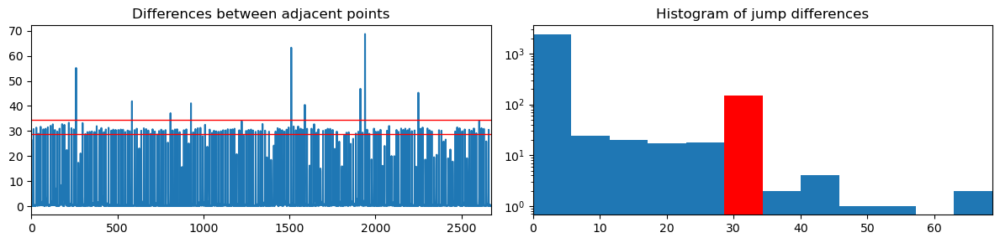



Error in Second Tolerance: difference=0.25 < tolerance=0.50
Likely cause: FPCs moved during setup OR high variability in dataset
jump_fig for: switch parameter = Ellipticity



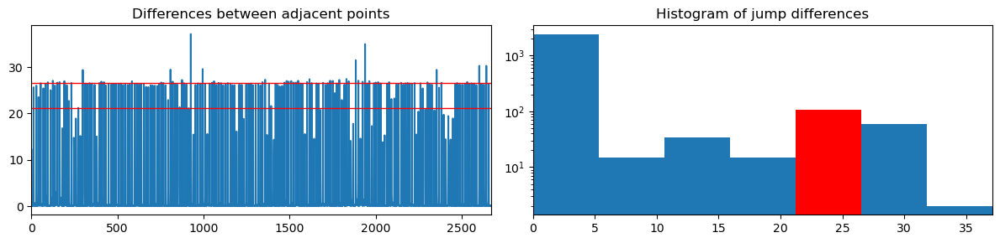



switch parameter = Azimuth

Jump points detected: 152
out of total: ~200.0



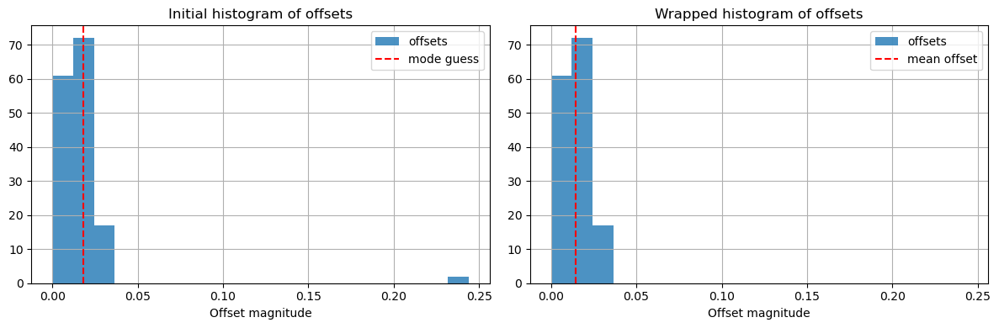

In [127]:
nominal_switch_rate = 2   # 2 Hz
change_point_range = (10,60)
ds.change_point(nominal_switch_rate, change_point_range, n_exclude=3, print_process=False)
avg_df_arr = ds.average_data()

updating CP_fig


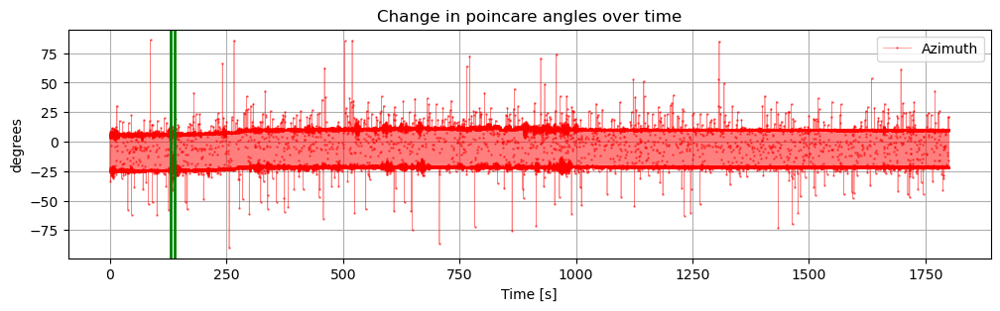

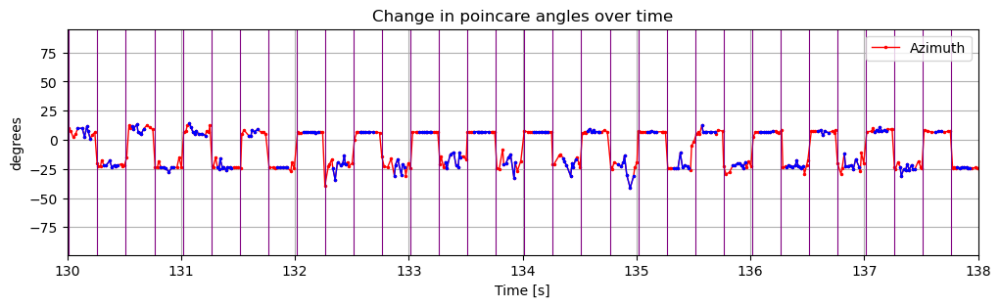

updating NCP_fig
updating CP_fig


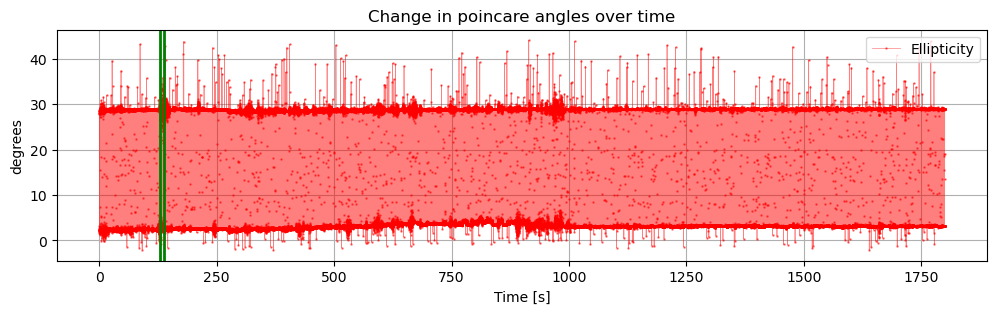

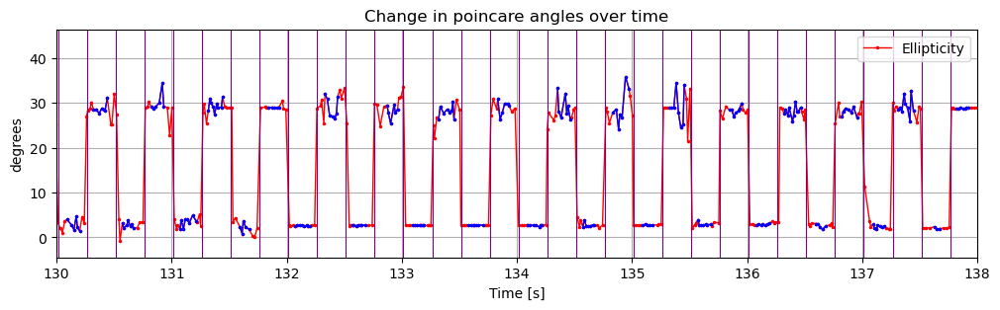

In [128]:
ds.plot(sample_range=(130,138),plot_param='Azimuth',plot_switch=True,plot_jumps=False,plot_valid=True,plot_avg=False)
ds.plot(sample_range=(130,138),plot_param='Ellipticity',plot_switch=True,plot_jumps=False,plot_valid=True,plot_avg=False)

### Slowly varying dataset (switching)

In [61]:
plt.ioff()
plt.close('all')

In [62]:
filename = 'Datasets/Whole_setup/08-01/PAX_1345_2Hz_DC_stability_1.csv'
ds = SwitchSet(filename)

Time range: min=20.025, max=1800.018


In [66]:
nominal_switch_time = 2   # 2 Hz
change_point_range = (10,60)
ds.change_point(nominal_switch_time=nominal_switch_time, change_point_range=change_point_range, n_exclude=3, print_process=False)
ds.average_data()

TypeError: SwitchSet.change_point() missing 1 required positional argument: 'main_df'

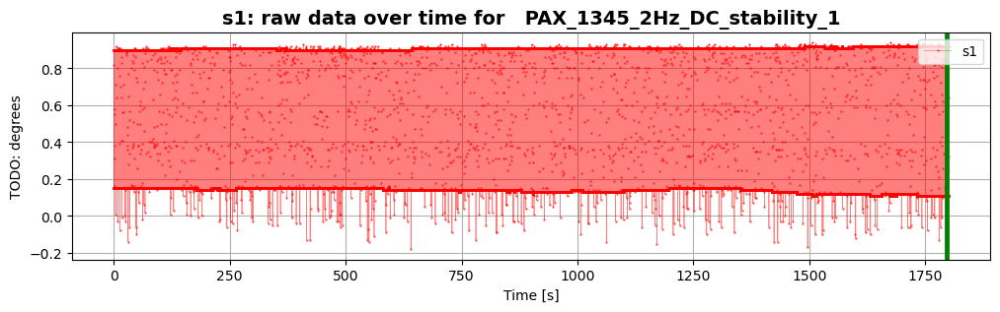

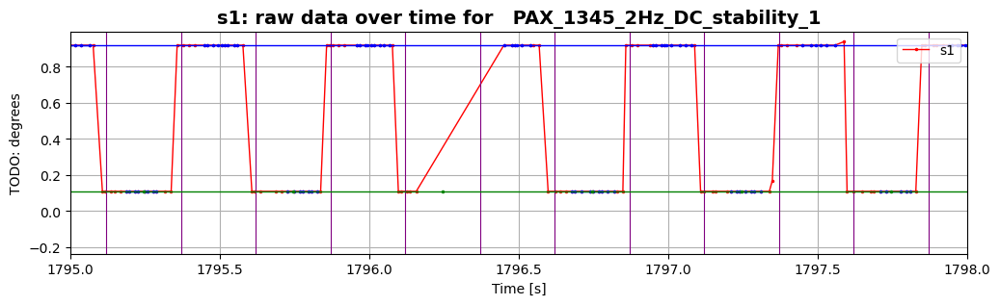

In [33]:
ds.plot_raw(sample_range=(1795,1798),plot_param='s1',plot_avg=True,plot_switch=True,plot_valid=True)

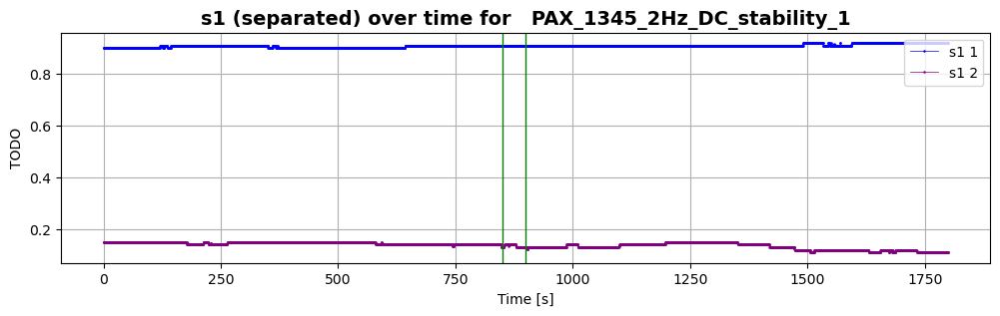

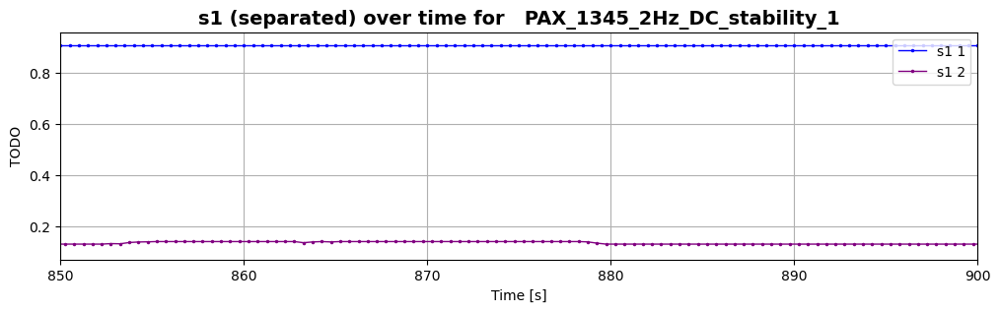

In [55]:
ds.plot_separated(sample_range=(850,900),plot_param='s1')

### Manually varying dataset (switching)

In [63]:
plt.ioff()
plt.close('all')

Time range: min=14.001, max=603.946
Using change_point_range_1=(15, 50)
Using change_point_range_2=None
=== performing change point detection ===
cp range: (15.0, 50.0)
using 2034 data entries
skipping 57 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (2034,)
computing range... ---> range = (0.89,0.95)
displaying jump_fig for switch parameter = s1



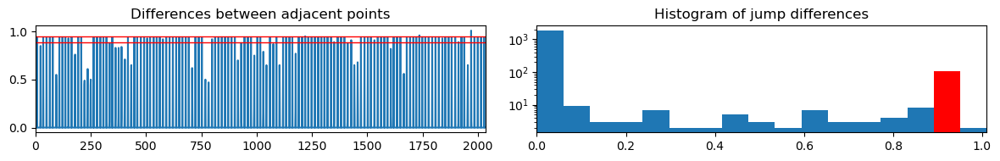



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (2034,)
computing range... ---> range = (0.99,1.05)
displaying jump_fig for switch parameter = s2



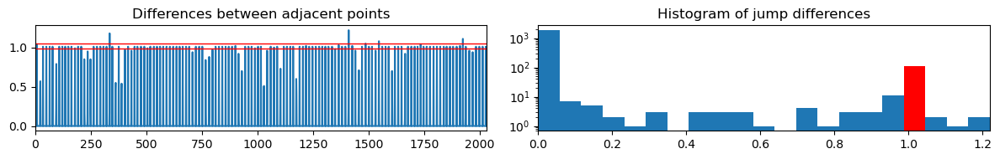



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (2034,)
computing range... ---> range = (0.30,0.36)
displaying jump_fig for switch parameter = s3



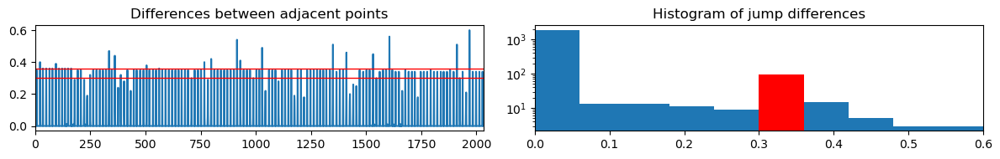



found width of 0.060 for s3
greater than prev width of 0.059 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.30,0.36)
Jump points detected: 107
out of total: ~139.9

computing offset...


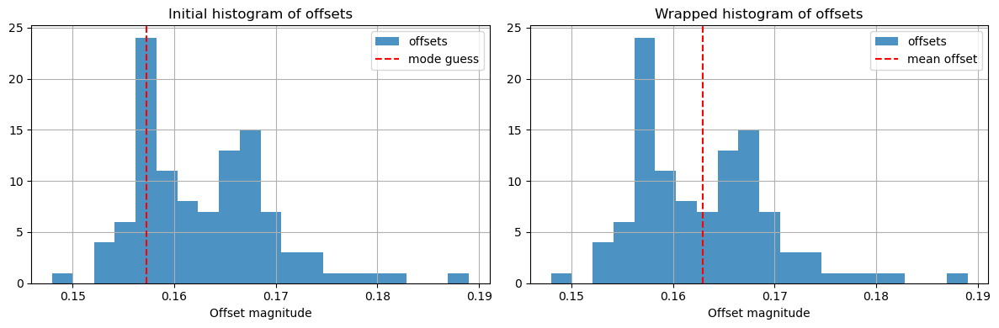



offset = 0.163 seconds
=== end change point detection ===


In [69]:
filename = 'Datasets/Whole_setup/11-15/PAX_11-15_Manual_Orth_1345_desktop.csv'
ds = SwitchSet(filename, skip_default_signal_baseline=14)
ds.find_switches(nominal_switch_rate=2, change_point_range_1=(15,50), print_process=True)

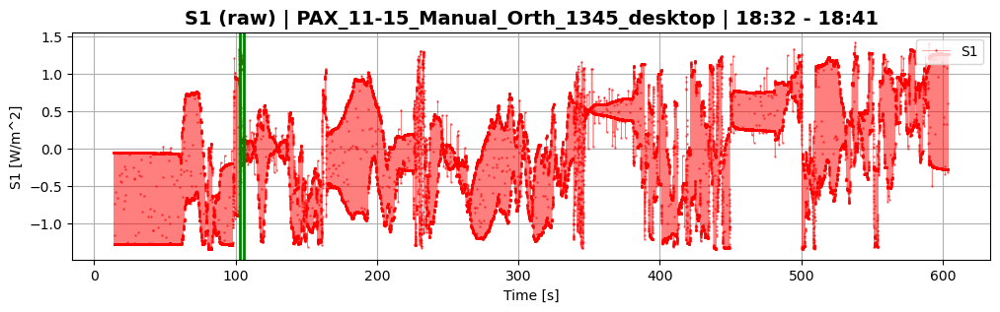

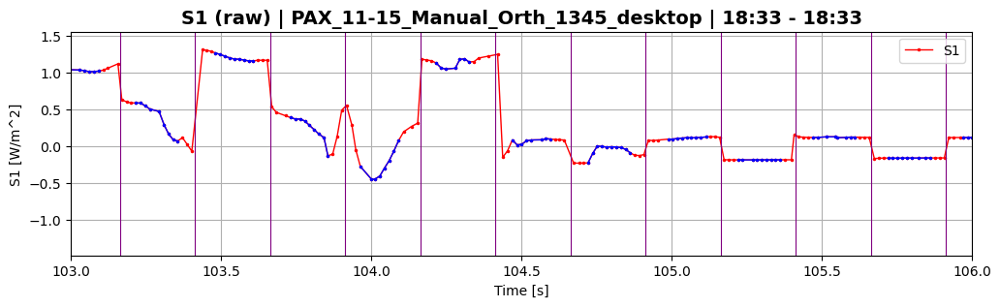

In [70]:
ds.plot_raw(plot_param='S1', sample_range=(103,106),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

In [71]:
ds.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 10 observations with <4 points (out of total 2356 observations)

--- interpolating data ---
length before: 1171
length after: 1179
8 total added
--- end interpolating data ---

--- interpolating data ---
length before: 1175
length after: 1179
4 total added
--- end interpolating data ---
Signal 1 size=1179	Signal 1 range: t=(14.29,603.29)
Signal 2 size=1179	Signal 2 range: t=(14.54,603.54)
=== end average_data ===


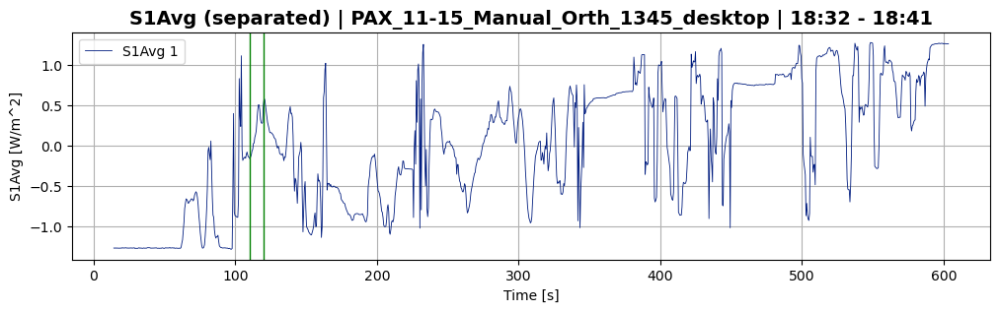

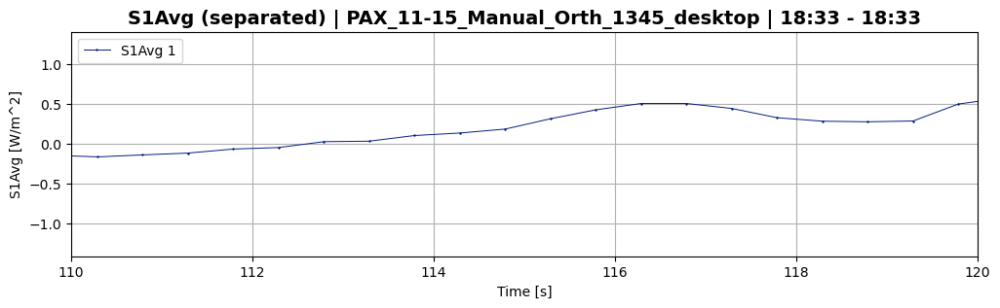

In [72]:
ds.plot_separated(plot_param='S1Avg',plot_signal=1,sample_range=(110,120))

In [73]:
ds.calc_stokes_ptf(input_stokes=None, angle_threshold_deg=np.deg2rad(10))

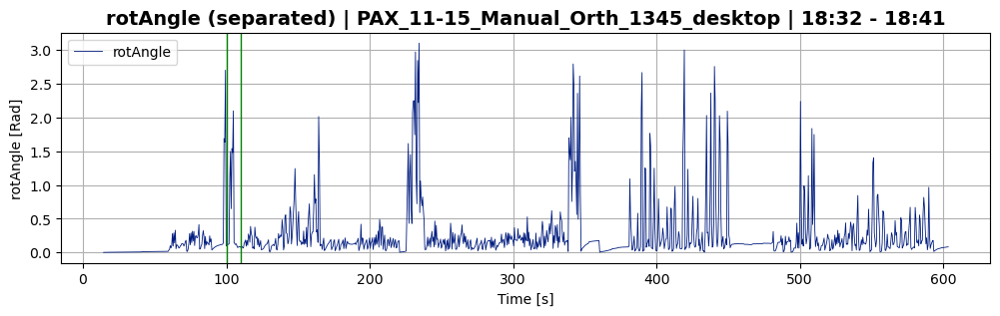

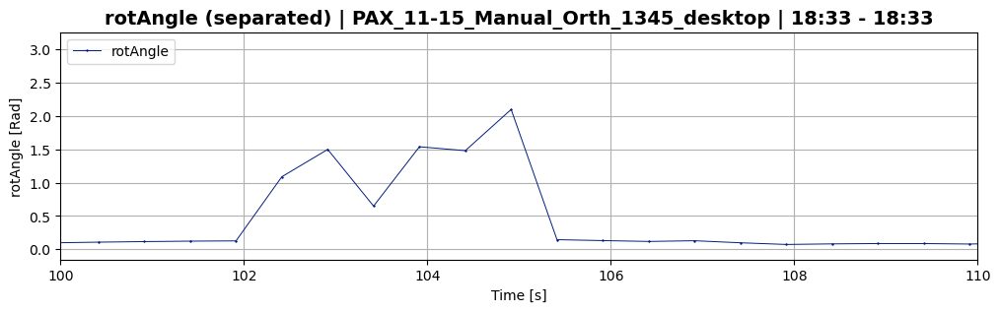

In [75]:
ds.plot_separated(plot_param='rotAngle',plot_signal=1,sample_range=(100,110))

### Adev (stationary)

#### Init

===== Datasets =====
0: PAX_08-16_30m_ADev_1_1345
1: PAX_08-16_30m_ADev_1_1560
2: PAX_08-16_30m_ADev_2_1345
3: PAX_08-16_30m_ADev_2_1560
4: PAX_08-16_30m_ADev_3_1345
5: PAX_08-16_30m_ADev_3_1560
6: PAX_08-16_ARL_ADev_1_1345
7: PAX_08-16_ARL_ADev_1_1560
8: PAX_08-16_ARL_ADev_2_1345
9: PAX_08-16_ARL_ADev_2_1560
10: PAX_08-16_DC_ADev_1_1345
11: PAX_08-16_DC_ADev_1_1560
12: PAX_08-16_DC_ADev_2_1345
13: PAX_08-16_DC_ADev_2_1560


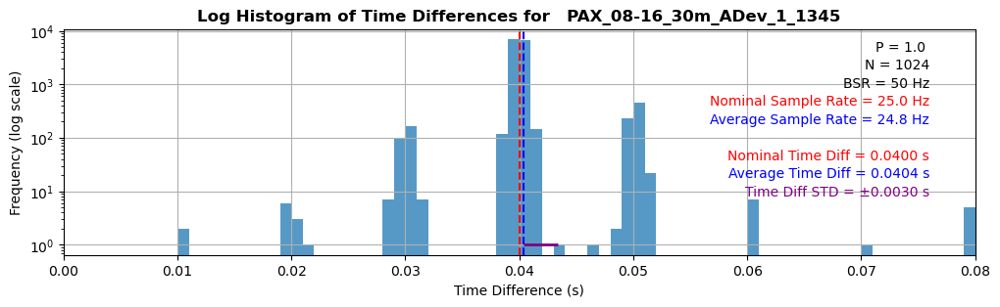

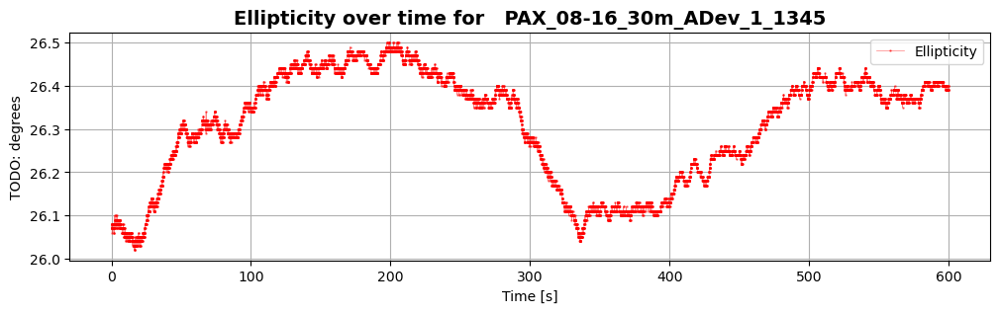

KeyboardInterrupt: 

In [73]:
folder_path = 'Datasets/Whole_setup/08-16'
datasets = []
i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv'):
        file_path = os.path.join(folder_path, file_name)
        #display(file_path)
        ds = StationarySet(file_path)
        datasets.append(ds)
        print('{:d}: {:s}'.format(i, ds.title))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
for ds in datasets:
    ds.rate_hist(bins=80, xmax=0.08)
    ds.plot(plot_param='Ellipticity')

#### rate hist bad even when slow

       TimeElapsed  TimeDiff
0            0.000     0.000
1            0.010     0.010
25           0.961     0.010
8655       348.256     0.019
6048       243.014     0.020
8616       346.695     0.020
9043       363.850     0.020
13294      536.359     0.020
14           0.511     0.020
11           0.391     0.020


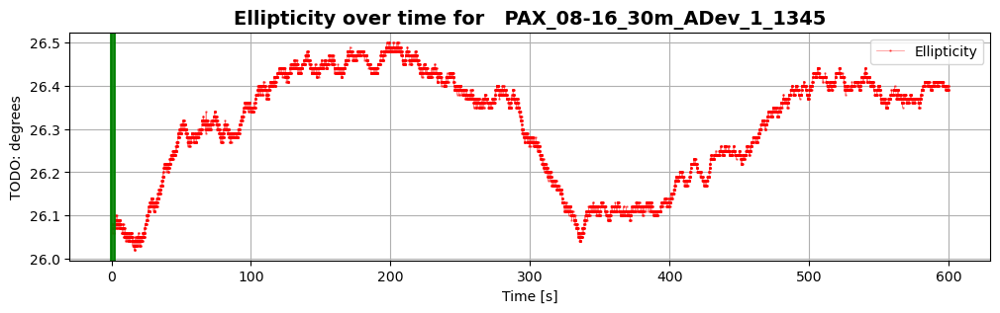

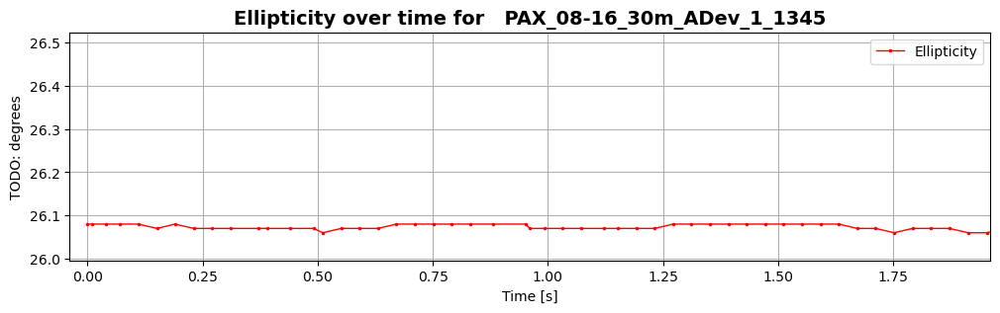

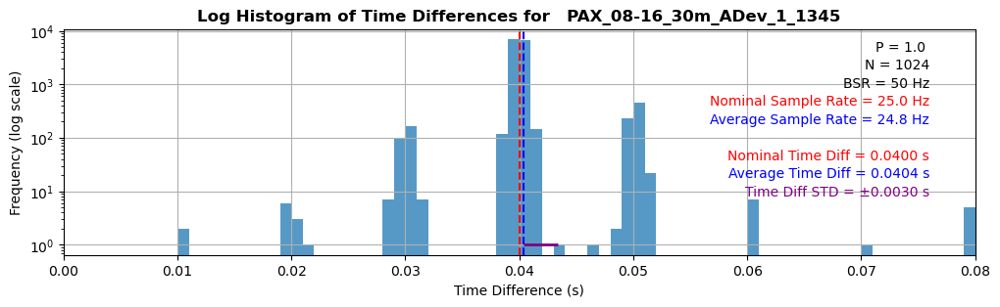

In [72]:
# Just looking at one of the datasets
filename = 'Datasets/Whole_setup/08-16/PAX_08-16_30m_ADev_1_1345.csv'
ds = StationarySet(filename)

times = ds.df.nlargest(10, 'TimeDiff')   # Timestamps and values of largest spacings
times = ds.df.nsmallest(10, 'TimeDiff')   # Timestamps and values of smallest spacings
print(times[['TimeElapsed','TimeDiff']])
sample_length = 2
sample_offset = times['TimeElapsed'].iloc[2]-(sample_length/2)
sample_range = (sample_offset, sample_offset+sample_length)
#sample_range = (100,105)

ds.plot(sample_range=sample_range,plot_param='Ellipticity')
ds.rate_hist(bins=80,xmax=0.08)

#### ADEV: stationary DC 8-16

===== Datasets =====
Time range: min=0.111, max=599.997
0 | PAX_08-16_DC_ADev_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 71.11
Number of taus used: 2257
Time range: min=0.086, max=533.205
1 | PAX_08-16_DC_ADev_1_1560 | bsr = 400.00 | nom rate = 200.00 | avg rate = 55.24
Number of taus used: 2142
Time range: min=0.061, max=600.0
2 | PAX_08-16_DC_ADev_2_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 70.60
Number of taus used: 2255
Time range: min=0.049, max=600.007
3 | PAX_08-16_DC_ADev_2_1560 | bsr = 200.00 | nom rate = 100.00 | avg rate = 63.44
Number of taus used: 2223


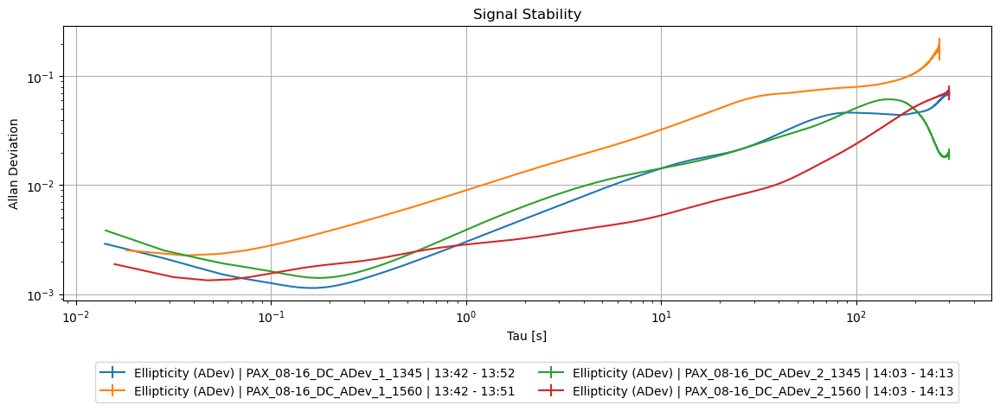

In [109]:
# Allan Dev for 08-16 runs
folder_path='Datasets/Whole_setup/08-16'
datasets = []; params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv') and 'DC' in file_name:
        file_path = os.path.join(folder_path, file_name)
        ds = StationarySet(file_path)
        datasets.append(ds)
        print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
        arr = ds.adev(plot_param='Ellipticity',num_taus=5000)
        params_arr.append(arr)
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
StationarySet.plot_adev(params_arr)

#### ADEV: stationary 30m 8-16

===== Datasets =====
0 | PAX_08-16_30m_ADev_1_1345 | bsr = 50.00 | nom rate = 25.00 | avg rate = 24.77
1 | PAX_08-16_30m_ADev_1_1560 | bsr = 50.00 | nom rate = 25.00 | avg rate = 25.60
2 | PAX_08-16_30m_ADev_2_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 70.64
3 | PAX_08-16_30m_ADev_2_1560 | bsr = 400.00 | nom rate = 200.00 | avg rate = 54.85
4 | PAX_08-16_30m_ADev_3_1345 | bsr = 400.00 | nom rate = 100.00 | avg rate = 84.94
5 | PAX_08-16_30m_ADev_3_1560 | bsr = 400.00 | nom rate = 100.00 | avg rate = 59.33


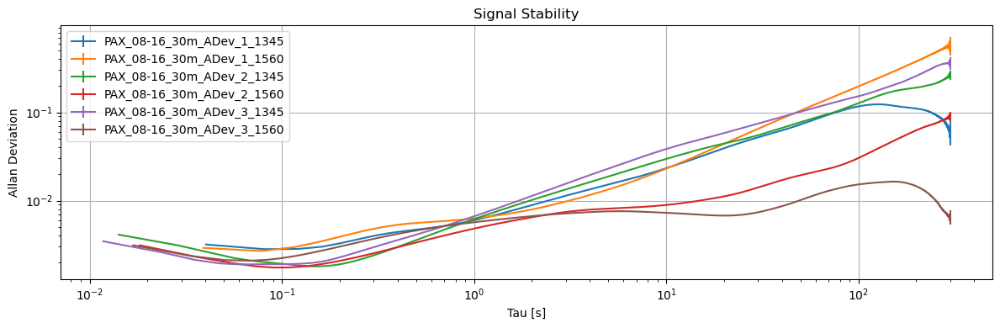

In [7]:
# Allan Dev for 08-16 runs
folder_path='Datasets/Whole_setup/08-16'
int_path='Datasets/Whole_setup/08-16'
datasets = []; params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv') and '30m' in file_name:
        file_path = os.path.join(folder_path, file_name)
        ds = StationarySet(file_path)
        datasets.append(ds)
        print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
        taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000)
        label = ds.title
        params_arr.append((taus2,ad,ade,ns,label))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
StationarySet.plot_adev(params_arr)

#### ADEV: stationary ARL 8-16

===== Datasets =====
0 | PAX_08-16_ARL_ADev_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 33.37
1 | PAX_08-16_ARL_ADev_1_1560 | bsr = 200.00 | nom rate = 100.00 | avg rate = 63.42
2 | PAX_08-16_ARL_ADev_2_1345 | bsr = 400.00 | nom rate = 100.00 | avg rate = 85.05
3 | PAX_08-16_ARL_ADev_2_1560 | bsr = 400.00 | nom rate = 100.00 | avg rate = 59.59


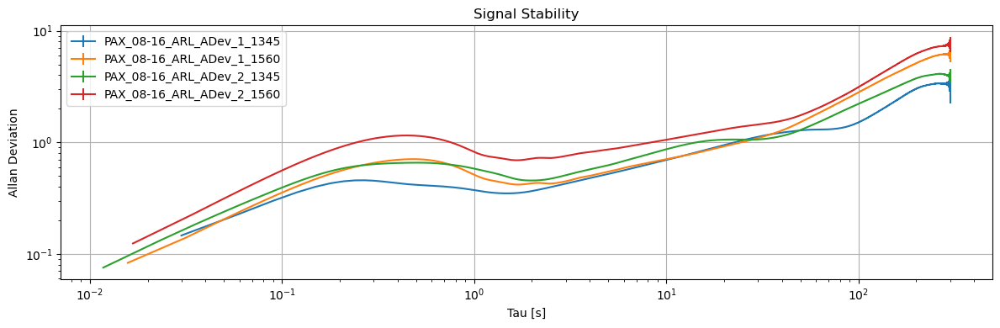

In [254]:
folder_path='Datasets/Whole_setup/New_WDM/Stationary/08-16'
datasets = []; params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv') and 'ARL' in file_name:
        file_path = os.path.join(folder_path, file_name)
        ds = StationarySet(file_path)
        datasets.append(ds)
        print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
        taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000)
        label = ds.title
        params_arr.append((taus2,ad,ade,ns,label))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
StationarySet.plot_adev(params_arr)

#### ADEV: Samples of DC, Connector, ARL

0 | PAX_08-16_ARL_ADev_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 33.37
1 | PAX_08-16_ARL_ADev_2_1345 | bsr = 400.00 | nom rate = 100.00 | avg rate = 85.05
2 | PAX_08-16_30m_ADev_2_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 70.64
3 | PAX_08-16_30m_ADev_3_1345 | bsr = 400.00 | nom rate = 100.00 | avg rate = 84.94
4 | PAX_08-16_DC_ADev_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 71.11
5 | PAX_08-16_DC_ADev_2_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 70.60


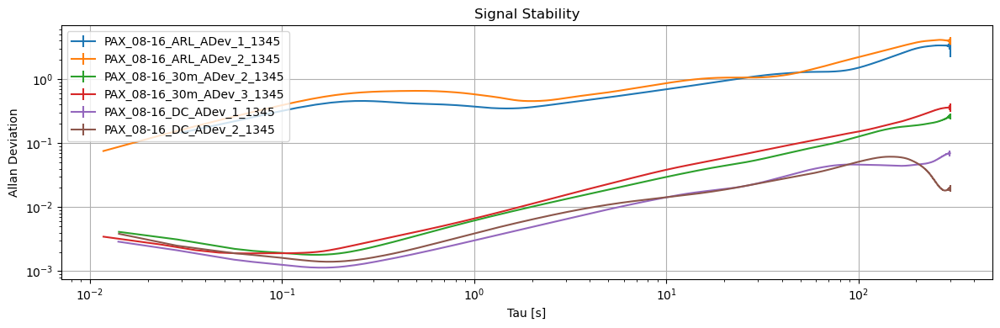

In [16]:
paths_2 = ['Datasets/Whole_setup/08-16/PAX_08-16_ARL_ADev_1_1345.csv',
           'Datasets/Whole_setup/08-16/PAX_08-16_ARL_ADev_2_1345.csv',
           'Datasets/Whole_setup/08-16/PAX_08-16_30m_ADev_2_1345.csv',
           'Datasets/Whole_setup/08-16/PAX_08-16_30m_ADev_3_1345.csv',
           'Datasets/Whole_setup/08-16/PAX_08-16_DC_ADev_1_1345.csv',
           'Datasets/Whole_setup/08-16/PAX_08-16_DC_ADev_2_1345.csv']
datasets = []; params_arr = []; i=0
for file_path in paths_2:
    ds = StationarySet(file_path)
    datasets.append(ds)
    print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
    taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000)
    label = ds.title
    params_arr.append((taus2,ad,ade,ns,label))
    i += 1
StationarySet.plot_adev(params_arr)

#### ADEV: stationary ARL 8-15

===== Datasets =====
0 | PAX_08-15_ARL_ADev_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 71.22
1 | PAX_08-15_ARL_ADev_1_1560 | bsr = 400.00 | nom rate = 200.00 | avg rate = 57.12
2 | PAX_08-15_ARL_ADev_2_1345 | bsr = 400.00 | nom rate = 100.00 | avg rate = 84.76
3 | PAX_08-15_ARL_ADev_2_1560 | bsr = 400.00 | nom rate = 100.00 | avg rate = 60.09
4 | PAX_08-15_ARL_ADev_3_1345 | bsr = 400.00 | nom rate = 100.00 | avg rate = 41.62
5 | PAX_08-15_ARL_ADev_3_1560 | bsr = 400.00 | nom rate = 100.00 | avg rate = 37.66


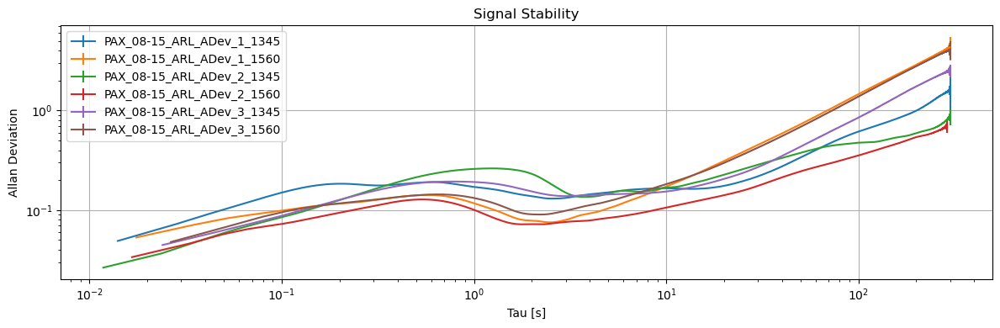

In [255]:
folder_path='Datasets/Whole_setup/New_WDM/Stationary/08-15'
datasets = []; params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv') and 'ARL' in file_name:
        file_path = os.path.join(folder_path, file_name)
        ds = StationarySet(file_path)
        datasets.append(ds)
        print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
        taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000)
        label = ds.title
        params_arr.append((taus2,ad,ade,ns,label))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
StationarySet.plot_adev(params_arr)

#### ADEV: stationary ARL Long

In [9]:
filepath_ARL_long='Datasets/Whole_setup/09-07_09-12/PAX_09-07_ARL_ADEV_2_1560.csv'
ds_ARL_long = StationarySet(filepath_ARL_long,set_range=(600,-600))

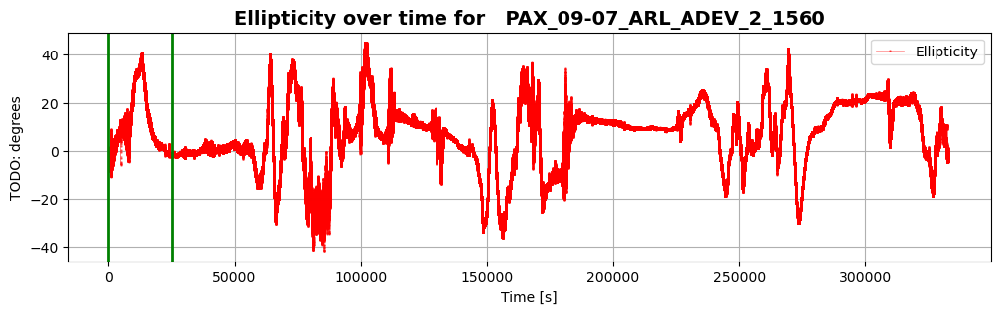

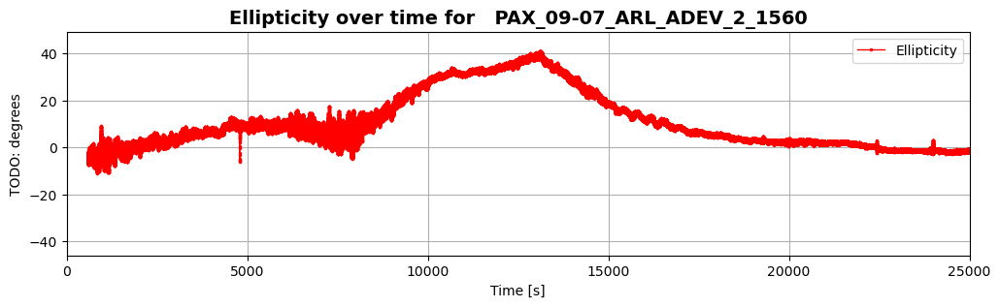

In [10]:
ds_ARL_long.plot_raw(sample_range=(0,25000),plot_param='Ellipticity')

In [211]:
filenames=['Datasets/Whole_setup/09-07_09-12/PAX_09-07_ARL_ADEV_2_1560.csv',
          'Datasets/Whole_setup/09-07_09-12/PAX_09-11_ARL_ADEV_2_1560_desktop.csv',
          'Datasets/Whole_setup/09-07_09-12/PAX_09-12_ARL_ADEV_1_1560_desktop.csv']
ranges=[[(None,0.1),(0.1,0.2),(0.2,0.3),(0.3,0.4),(0.4,0.5),(0.5,0.6),(0.6,0.7),(0.7,0.8),(0.8,0.9),(0.9,None)],
       [(None,0.25),(0.25,0.5),(0.5,0.75),(0.75,None)],
       [(None,0.25),(0.25,0.5),(0.5,0.75),(0.75,None)]]

In [201]:
filenames=['Datasets/Whole_setup/08-16/PAX_08-16_ARL_ADev_2_1345.csv',
          'Datasets/Whole_setup/08-16/PAX_08-16_ARL_ADev_2_1560.csv']
ranges=[[(None,0.1),(0.1,0.2),(0.2,0.3),(0.3,0.4),(0.4,0.5),(0.5,0.6),(0.6,0.7),(0.7,0.8),(0.8,0.9),(0.9,None)],
       [(None,0.25),(0.25,0.5),(0.5,0.75),(0.75,None)]]

In [212]:
start_time_total = time.time()
datasets = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for filename,range_list in zip(filenames,ranges):
    for set_range in range_list:
        start_time = time.time()
        ds = StationarySet(filename,set_range=set_range)
        end_time = time.time()
        datasets.append(ds)
        print('{:d} | {:s} | range = {} | elapsed time = {:.2f} minutes | avg rate = {:.2f}'.format(i,ds.title,set_range,(end_time-start_time)/60,ds.avg_sample_rate))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
end_time_total = time.time()
print("Elapsed time: {:.2f} minutes".format((end_time_total-start_time_total)/60))

===== Datasets =====
0 | PAX_09-07_ARL_ADEV_2_1560 | range = (None, 0.1) | elapsed time = 0.64 minutes | avg rate = 65.70
1 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.1, 0.2) | elapsed time = 0.64 minutes | avg rate = 65.29
2 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.2, 0.3) | elapsed time = 0.67 minutes | avg rate = 64.63
3 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.3, 0.4) | elapsed time = 0.73 minutes | avg rate = 63.74
4 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.4, 0.5) | elapsed time = 0.75 minutes | avg rate = 62.80
5 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.5, 0.6) | elapsed time = 0.79 minutes | avg rate = 61.40
6 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.6, 0.7) | elapsed time = 0.76 minutes | avg rate = 60.32
7 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.7, 0.8) | elapsed time = 0.76 minutes | avg rate = 59.15
8 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.8, 0.9) | elapsed time = 0.81 minutes | avg rate = 46.51
9 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.9, None) | elapsed time = 0.85 minu

In [213]:
start_time_total = time.time()
params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for ds in datasets:
    start_time = time.time()
    taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000)
    end_time = time.time()
    label = ds.title
    params_arr.append((taus2,ad,ade,ns,label))
    print('{:d} | {:s} | elapsed time = {:.2f} minutes'.format(i,ds.title,(end_time-start_time)/60))
    i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
end_time_total = time.time()
print("Elapsed time: {:.2f} minutes".format((end_time_total-start_time_total)/60))

===== Datasets =====
0 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.88 minutes
1 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.91 minutes
2 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.90 minutes
3 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.90 minutes
4 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.89 minutes
5 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.90 minutes
6 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.90 minutes
7 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.89 minutes
8 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.89 minutes
9 | PAX_09-07_ARL_ADEV_2_1560 | elapsed time = 0.91 minutes
10 | PAX_09-11_ARL_ADEV_2_1560_desktop | elapsed time = 0.94 minutes
11 | PAX_09-11_ARL_ADEV_2_1560_desktop | elapsed time = 0.92 minutes
12 | PAX_09-11_ARL_ADEV_2_1560_desktop | elapsed time = 0.93 minutes
13 | PAX_09-11_ARL_ADEV_2_1560_desktop | elapsed time = 0.92 minutes
14 | PAX_09-12_ARL_ADEV_1_1560_desktop | elapsed time = 0.82 minutes
15 | PAX_09-12_ARL_ADEV_1_1560_des

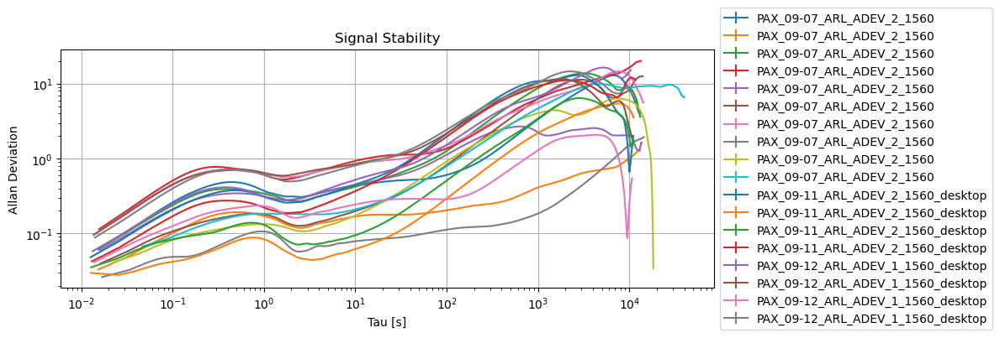

In [214]:
StationarySet.plot_adev(params_arr)

In [18]:
filename='Datasets/Whole_setup/09-07_09-12/PAX_09-07_ARL_ADEV_2_1560.csv'
range_list = [(0.0+i,0.025+i) for i in np.arange(0,1,0.025)]
range_list

[(0.0, 0.025),
 (0.025, 0.05),
 (0.05, 0.07500000000000001),
 (0.07500000000000001, 0.1),
 (0.1, 0.125),
 (0.125, 0.15),
 (0.15000000000000002, 0.17500000000000002),
 (0.17500000000000002, 0.2),
 (0.2, 0.225),
 (0.225, 0.25),
 (0.25, 0.275),
 (0.275, 0.30000000000000004),
 (0.30000000000000004, 0.32500000000000007),
 (0.325, 0.35000000000000003),
 (0.35000000000000003, 0.37500000000000006),
 (0.375, 0.4),
 (0.4, 0.42500000000000004),
 (0.42500000000000004, 0.45000000000000007),
 (0.45, 0.47500000000000003),
 (0.47500000000000003, 0.5),
 (0.5, 0.525),
 (0.525, 0.55),
 (0.55, 0.5750000000000001),
 (0.5750000000000001, 0.6000000000000001),
 (0.6000000000000001, 0.6250000000000001),
 (0.625, 0.65),
 (0.65, 0.675),
 (0.675, 0.7000000000000001),
 (0.7000000000000001, 0.7250000000000001),
 (0.7250000000000001, 0.7500000000000001),
 (0.75, 0.775),
 (0.775, 0.8),
 (0.8, 0.8250000000000001),
 (0.8250000000000001, 0.8500000000000001),
 (0.8500000000000001, 0.8750000000000001),
 (0.875, 0.9),
 (0.

In [22]:
plt.ioff()

===== Datasets =====
Number of taus used: 2820


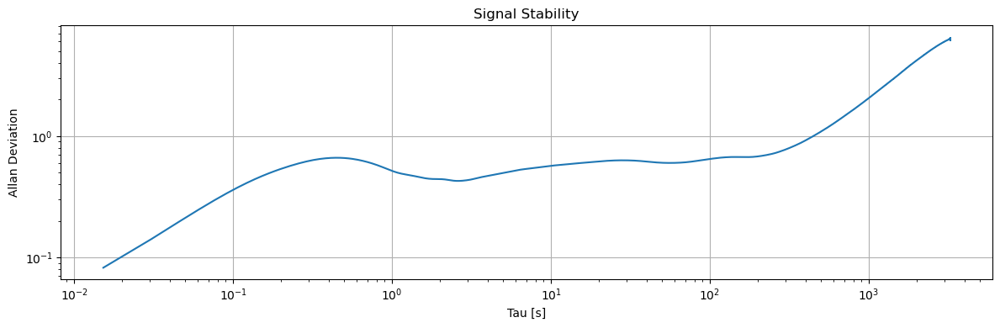

0 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.0, 0.025) | elapsed time = 0.59 minutes | avg rate = 65.54
Number of taus used: 2820


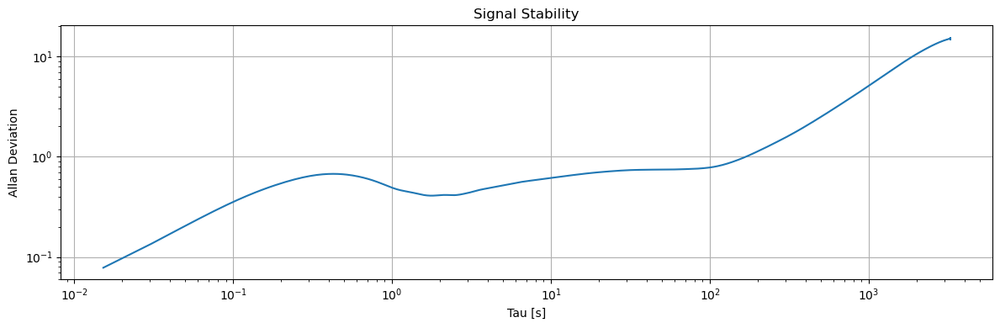

1 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.025, 0.05) | elapsed time = 0.58 minutes | avg rate = 65.58
Number of taus used: 2820


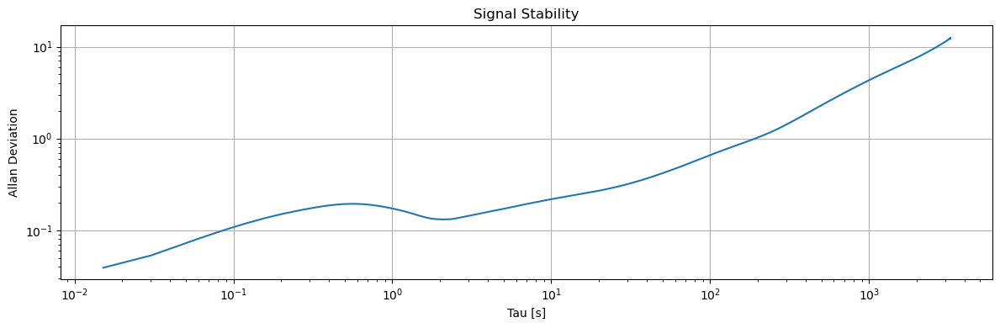

2 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.05, 0.07500000000000001) | elapsed time = 0.59 minutes | avg rate = 65.88
Number of taus used: 2820


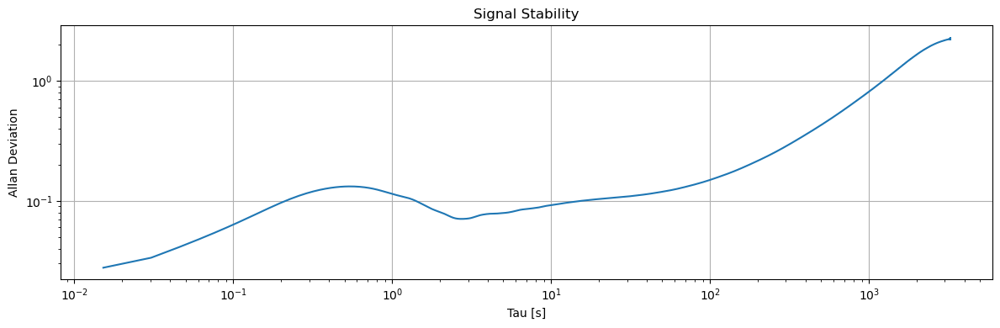

3 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.07500000000000001, 0.1) | elapsed time = 0.61 minutes | avg rate = 65.80
Number of taus used: 2820


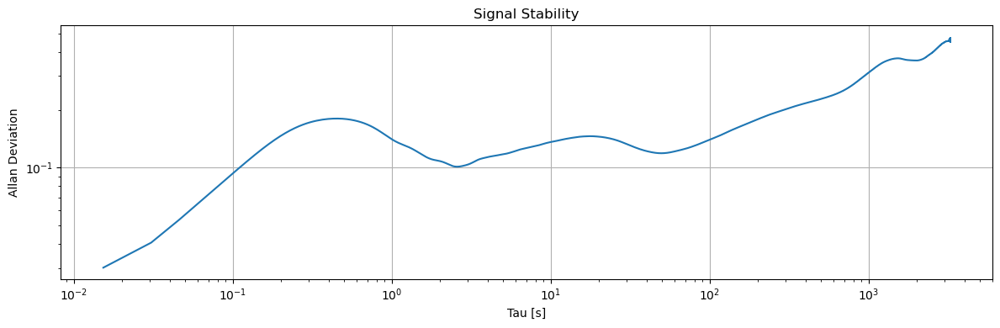

4 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.1, 0.125) | elapsed time = 0.61 minutes | avg rate = 65.42
Number of taus used: 2820


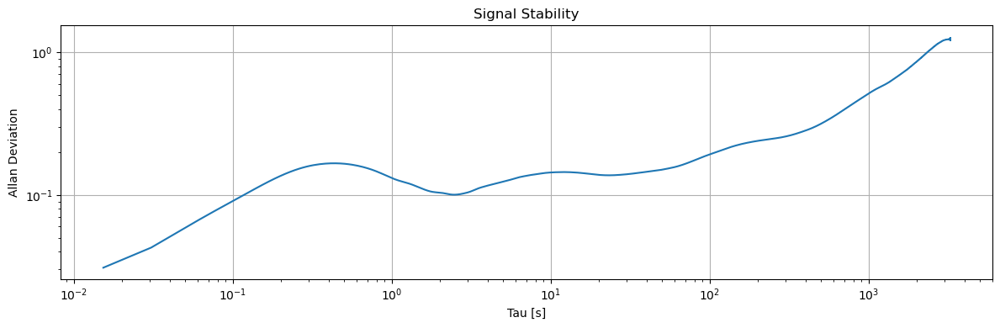

5 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.125, 0.15) | elapsed time = 0.61 minutes | avg rate = 65.42
Number of taus used: 2820


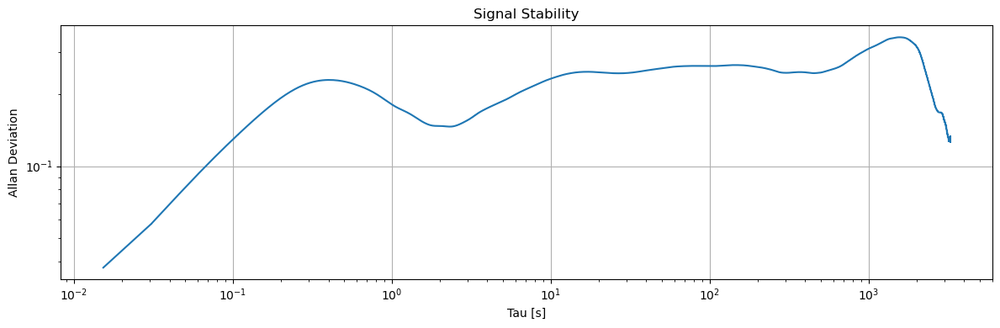

6 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.15000000000000002, 0.17500000000000002) | elapsed time = 0.61 minutes | avg rate = 65.26
Number of taus used: 2820


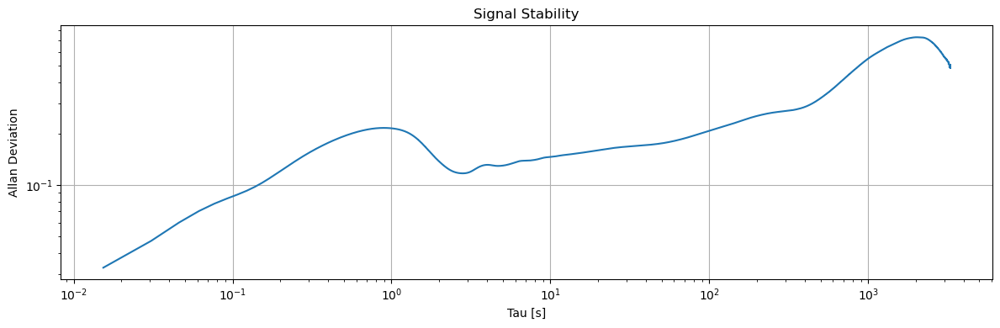

7 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.17500000000000002, 0.2) | elapsed time = 0.63 minutes | avg rate = 65.07
Number of taus used: 2820


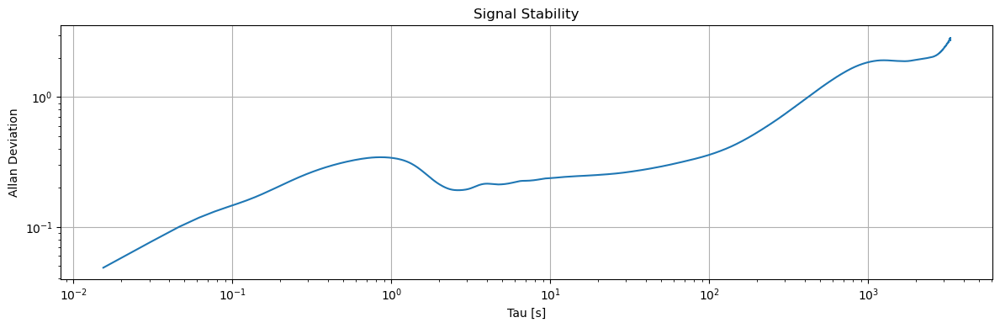

8 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.2, 0.225) | elapsed time = 0.66 minutes | avg rate = 64.91
Number of taus used: 2820


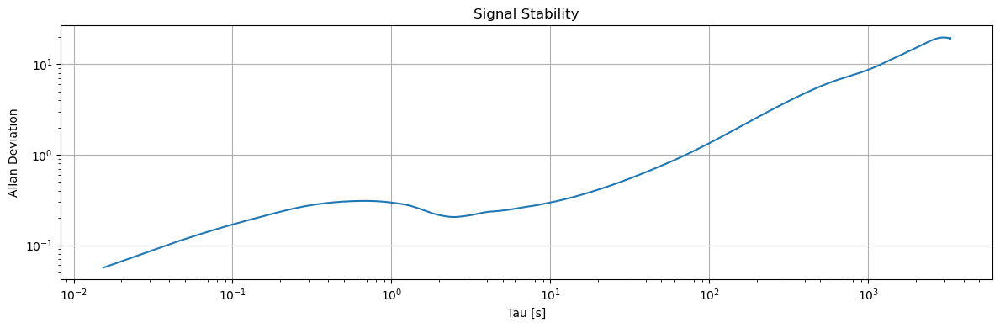

9 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.225, 0.25) | elapsed time = 0.64 minutes | avg rate = 65.04
Number of taus used: 2820


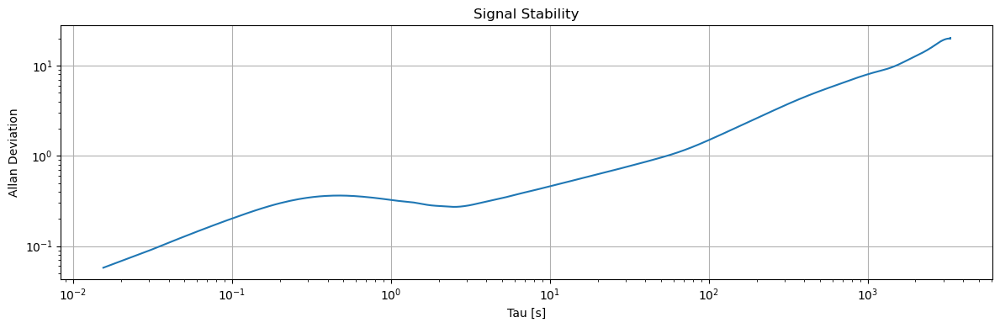

10 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.25, 0.275) | elapsed time = 0.65 minutes | avg rate = 64.45
Number of taus used: 2820


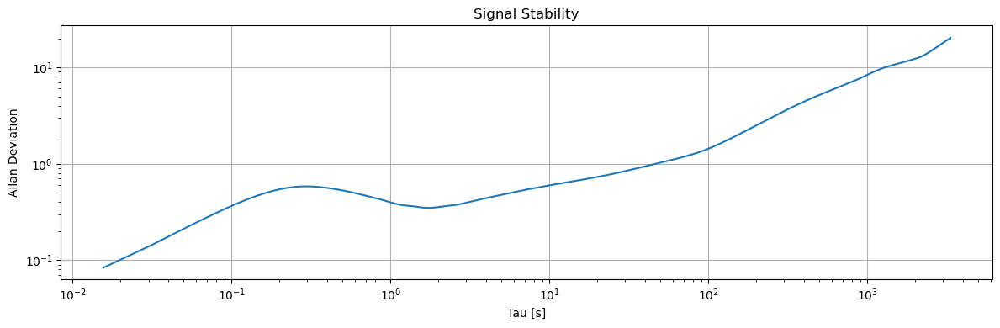

11 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.275, 0.30000000000000004) | elapsed time = 0.65 minutes | avg rate = 64.13
Number of taus used: 2820


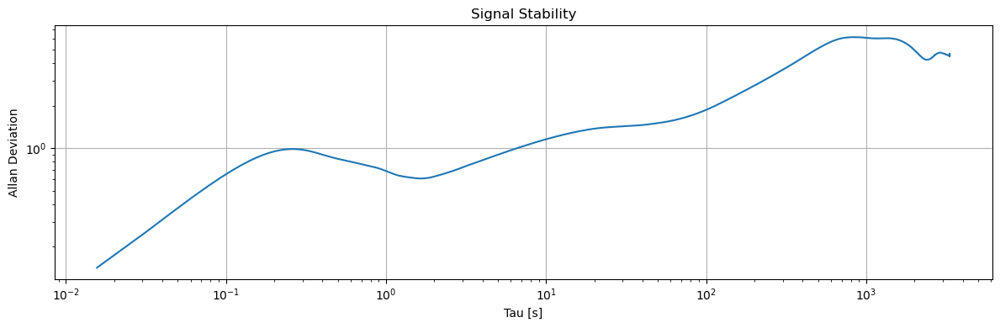

12 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.30000000000000004, 0.32500000000000007) | elapsed time = 0.65 minutes | avg rate = 64.04
Number of taus used: 2820


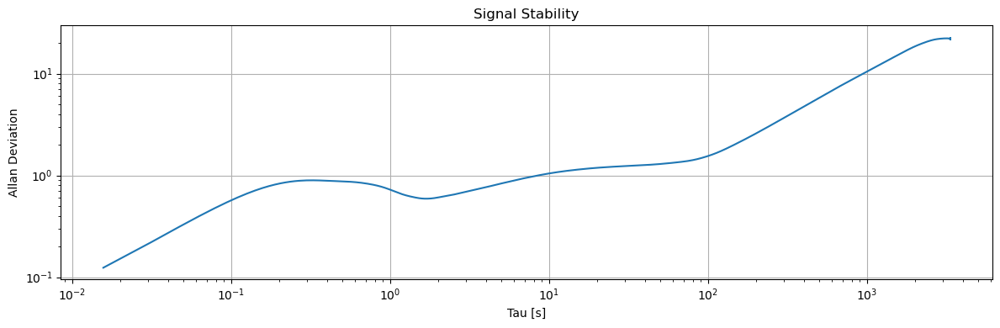

13 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.325, 0.35000000000000003) | elapsed time = 0.66 minutes | avg rate = 63.88
Number of taus used: 2820


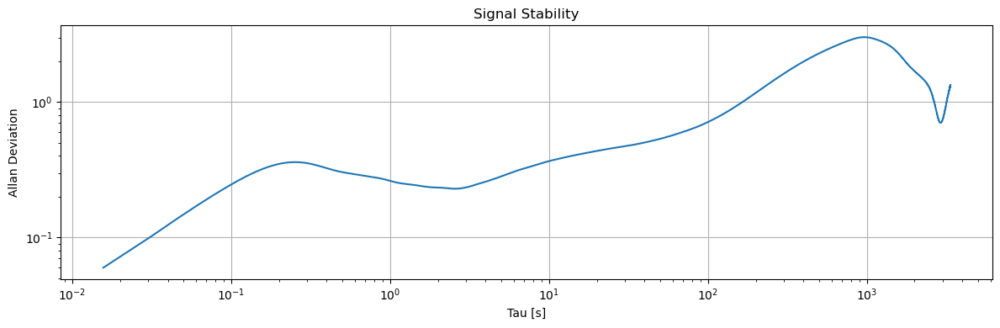

14 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.35000000000000003, 0.37500000000000006) | elapsed time = 0.68 minutes | avg rate = 63.66
Number of taus used: 2820


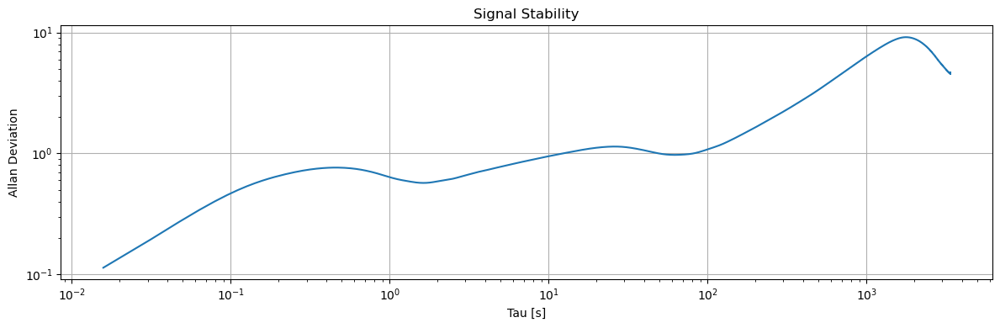

15 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.375, 0.4) | elapsed time = 0.76 minutes | avg rate = 63.38
Number of taus used: 2820


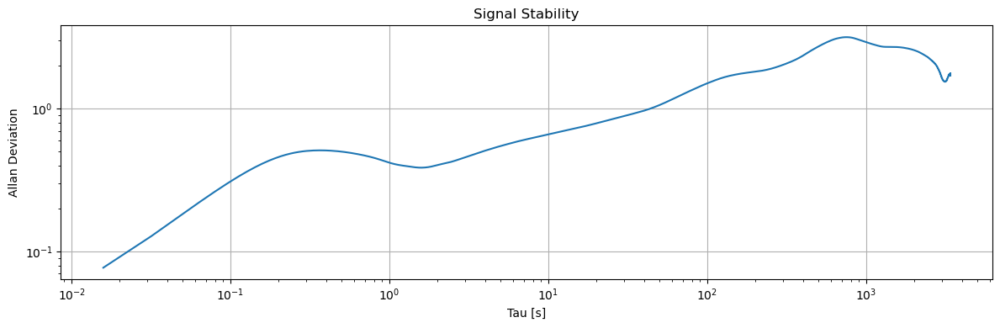

16 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.4, 0.42500000000000004) | elapsed time = 0.70 minutes | avg rate = 63.15
Number of taus used: 2820


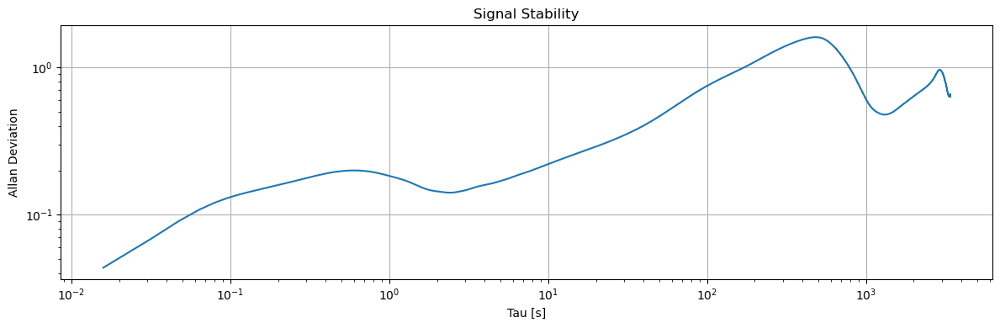

17 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.42500000000000004, 0.45000000000000007) | elapsed time = 0.69 minutes | avg rate = 62.87
Number of taus used: 2820


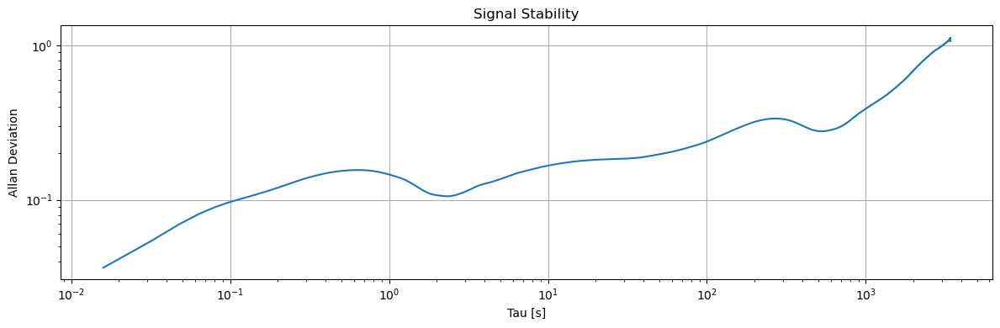

18 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.45, 0.47500000000000003) | elapsed time = 0.72 minutes | avg rate = 62.78
Number of taus used: 2820


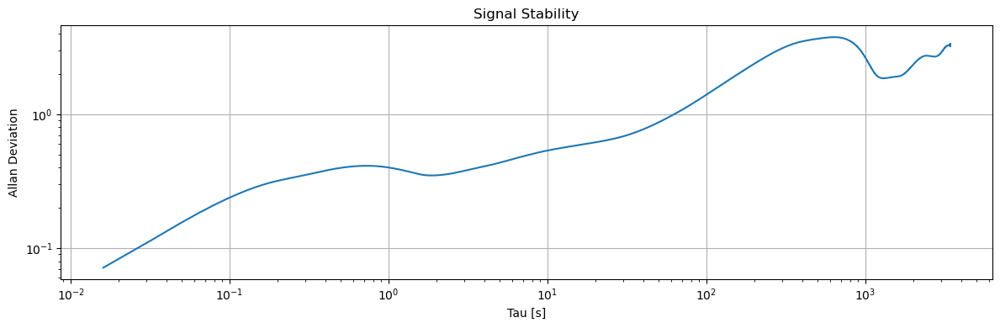

19 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.47500000000000003, 0.5) | elapsed time = 0.71 minutes | avg rate = 62.39
Number of taus used: 2820


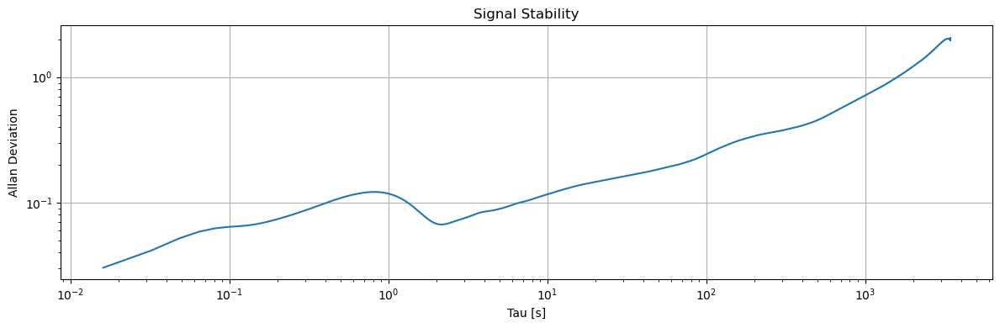

20 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.5, 0.525) | elapsed time = 0.77 minutes | avg rate = 62.28
Number of taus used: 2820


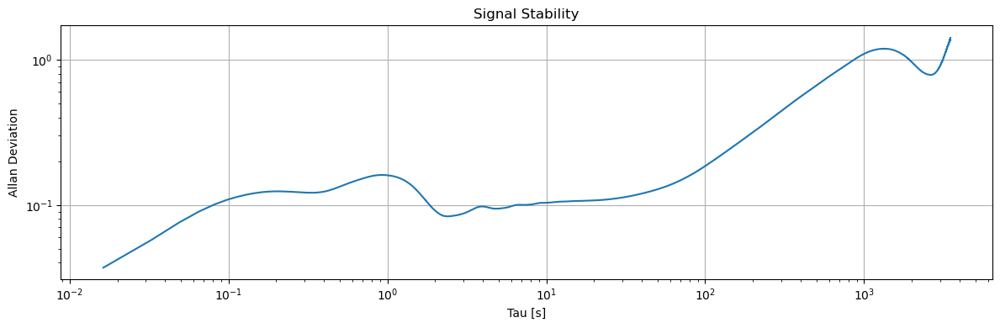

21 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.525, 0.55) | elapsed time = 0.73 minutes | avg rate = 61.28
Number of taus used: 2820


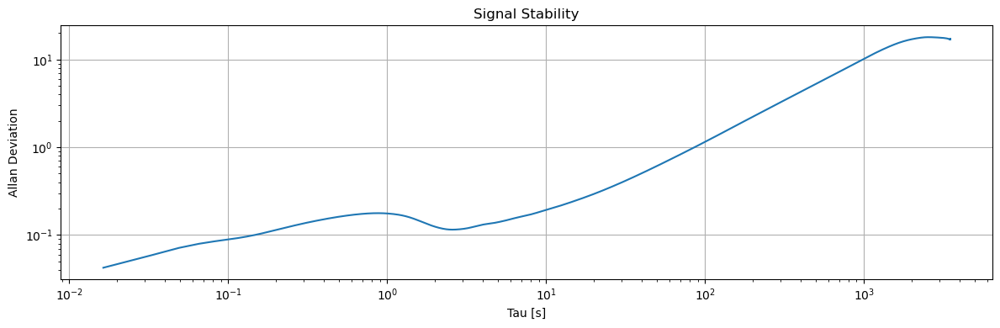

22 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.55, 0.5750000000000001) | elapsed time = 0.77 minutes | avg rate = 61.03
Number of taus used: 2820


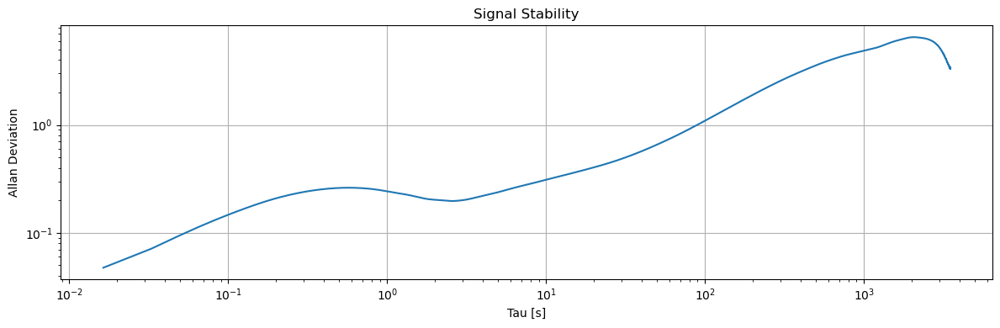

23 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.5750000000000001, 0.6000000000000001) | elapsed time = 0.75 minutes | avg rate = 61.02
Number of taus used: 2820


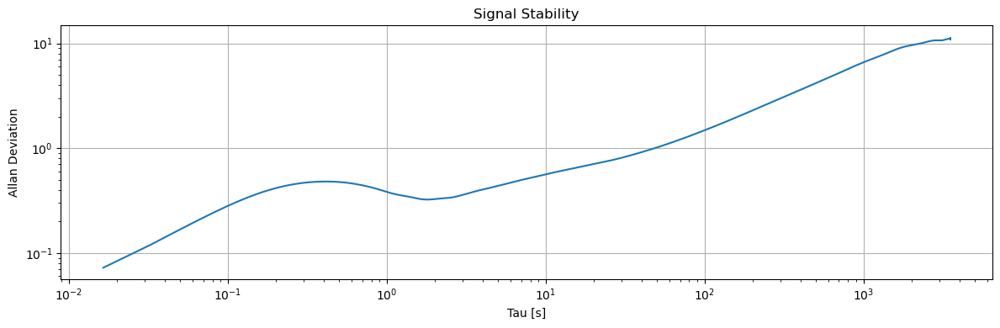

24 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.6000000000000001, 0.6250000000000001) | elapsed time = 0.75 minutes | avg rate = 60.75
Number of taus used: 2820


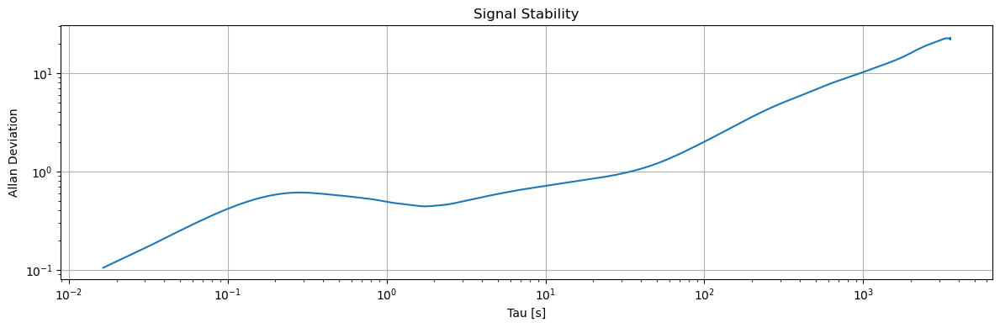

25 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.625, 0.65) | elapsed time = 0.74 minutes | avg rate = 60.53
Number of taus used: 2820


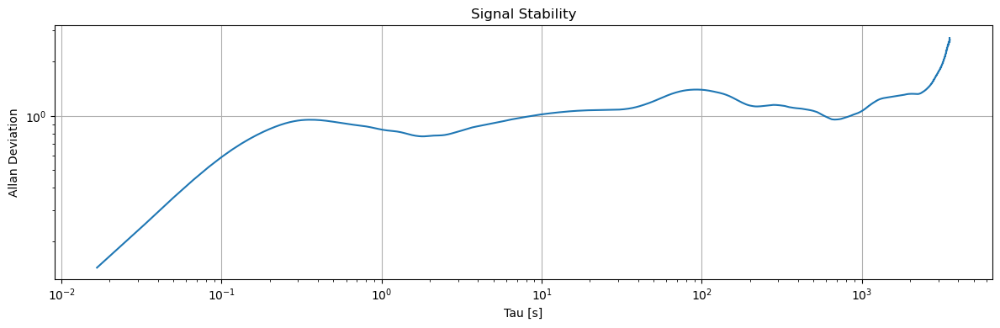

26 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.65, 0.675) | elapsed time = 0.75 minutes | avg rate = 60.06
Number of taus used: 2820


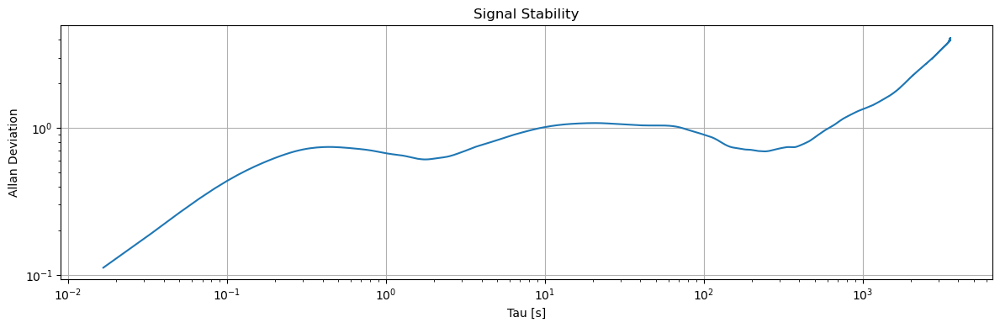

27 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.675, 0.7000000000000001) | elapsed time = 0.79 minutes | avg rate = 59.94
Number of taus used: 2820


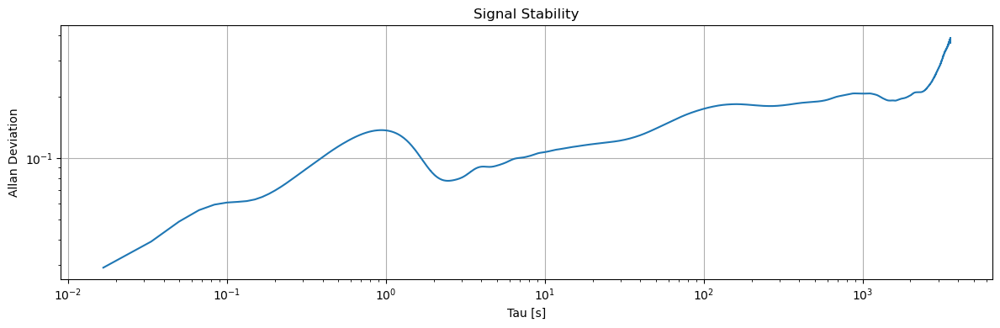

28 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.7000000000000001, 0.7250000000000001) | elapsed time = 0.76 minutes | avg rate = 59.91
Number of taus used: 2820


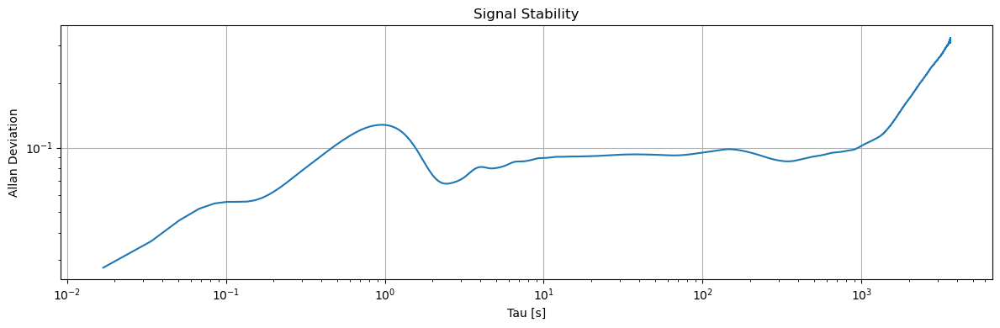

29 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.7250000000000001, 0.7500000000000001) | elapsed time = 0.76 minutes | avg rate = 59.06
Number of taus used: 2820


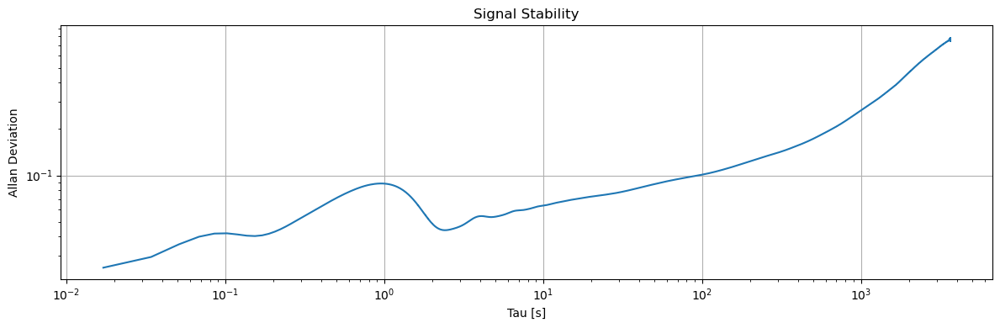

30 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.75, 0.775) | elapsed time = 0.78 minutes | avg rate = 58.59
Number of taus used: 2820


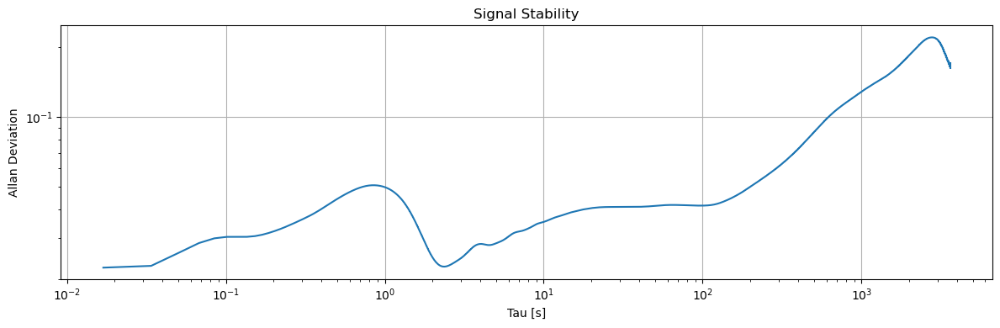

31 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.775, 0.8) | elapsed time = 0.79 minutes | avg rate = 59.05
Number of taus used: 2820


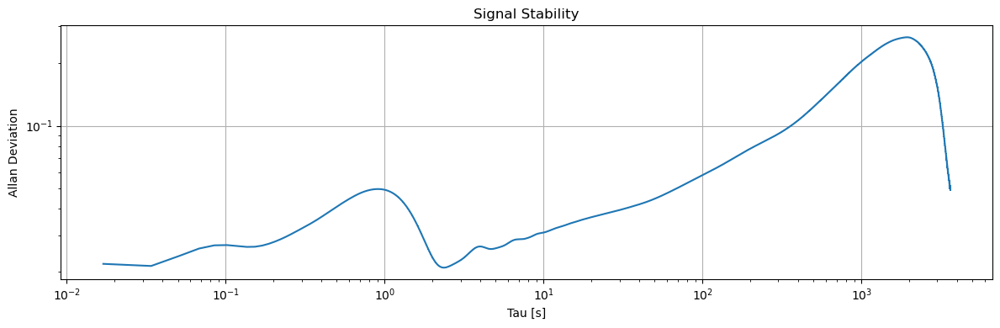

32 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.8, 0.8250000000000001) | elapsed time = 0.80 minutes | avg rate = 58.96
Number of taus used: 2820


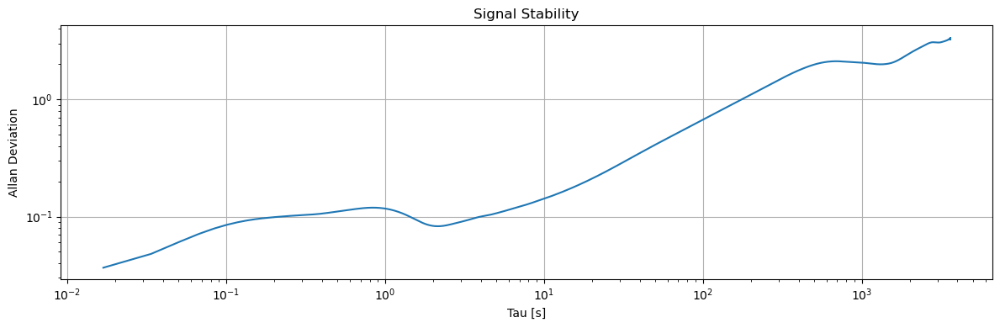

33 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.8250000000000001, 0.8500000000000001) | elapsed time = 0.80 minutes | avg rate = 59.26
Number of taus used: 2820


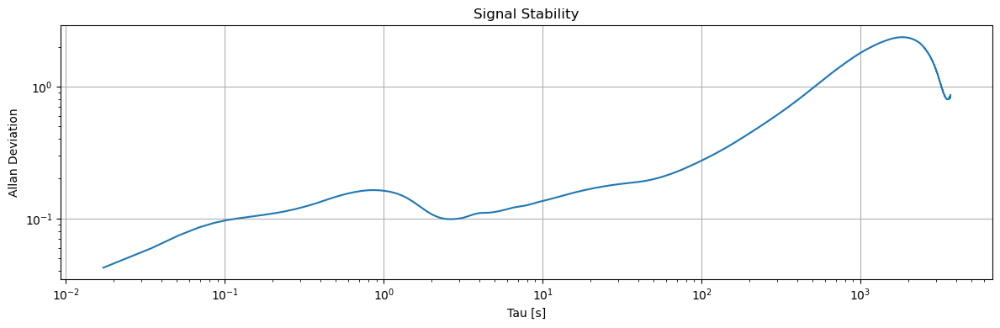

34 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.8500000000000001, 0.8750000000000001) | elapsed time = 0.81 minutes | avg rate = 58.10
Number of taus used: 2820


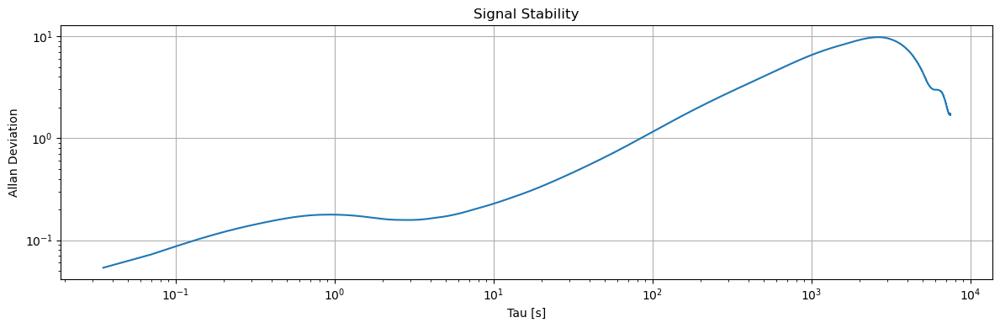

35 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.875, 0.9) | elapsed time = 0.82 minutes | avg rate = 28.60
Number of taus used: 2820


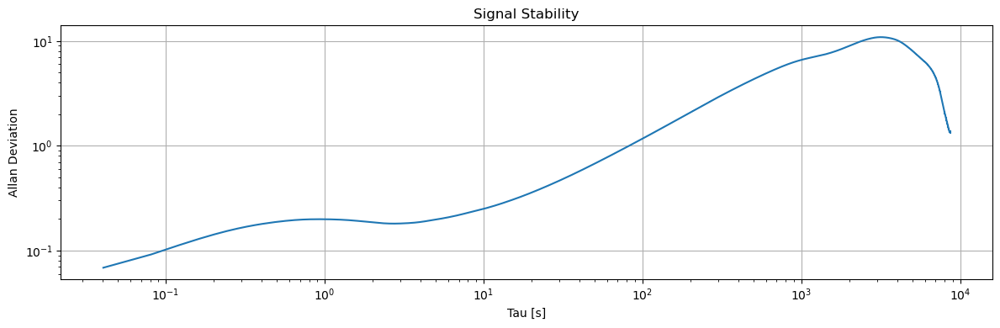

36 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.9, 0.925) | elapsed time = 0.84 minutes | avg rate = 24.65
Number of taus used: 2820


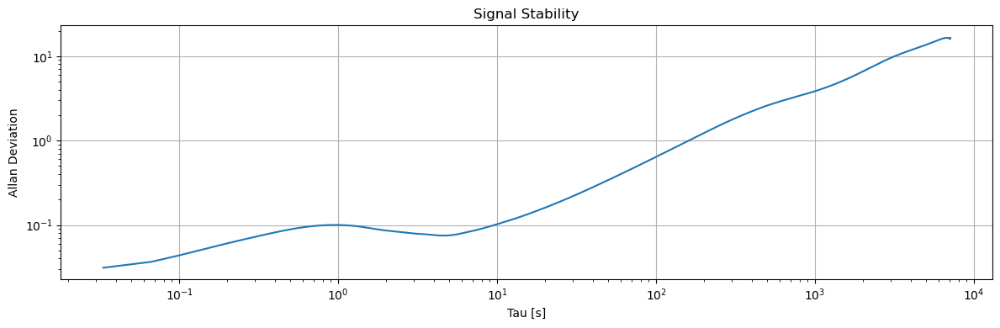

37 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.925, 0.9500000000000001) | elapsed time = 0.86 minutes | avg rate = 30.06
Number of taus used: 2820


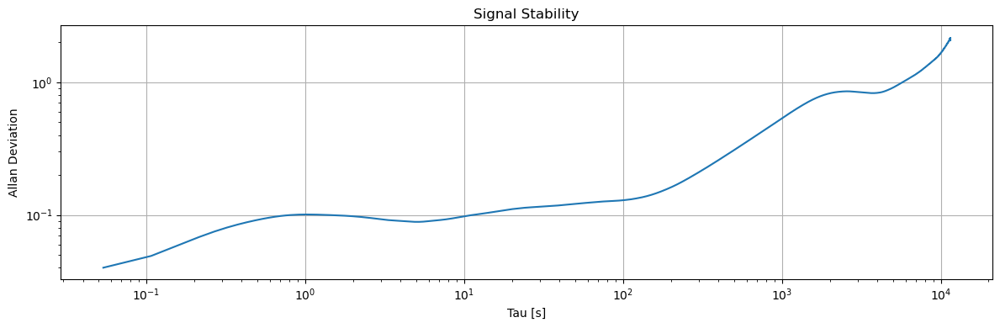

38 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.9500000000000001, 0.9750000000000001) | elapsed time = 0.85 minutes | avg rate = 18.59
Number of taus used: 2820


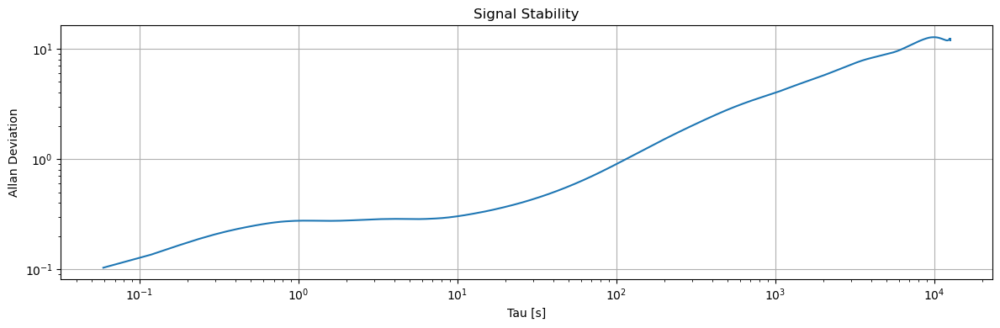

39 | PAX_09-07_ARL_ADEV_2_1560 | range = (0.9750000000000001, 1.0) | elapsed time = 0.87 minutes | avg rate = 16.88
Elapsed time: 28.76 minutes


In [23]:
start_time_total = time.time()
datasets = []; params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for set_range in range_list:
    start_time = time.time()
    ds = StationarySet(filename,set_range=set_range)
    taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=True)
    end_time = time.time()
    datasets.append(ds)
    label = ds.title + ' i'
    params_arr.append((taus2,ad,ade,ns,label))
    print('{:d} | {:s} | range = {} | elapsed time = {:.2f} minutes | avg rate = {:.2f}'.format(i,ds.title,set_range,(end_time-start_time)/60,ds.avg_sample_rate))
    i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
end_time_total = time.time()
print("Elapsed time: {:.2f} minutes".format((end_time_total-start_time_total)/60))

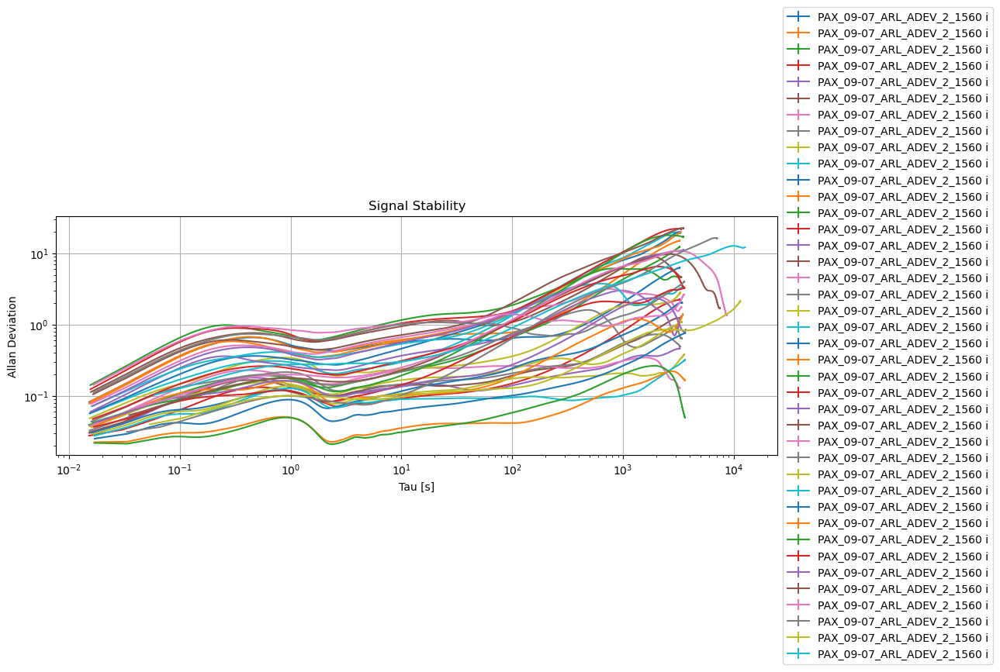

In [24]:
StationarySet.plot_adev(params_arr)

In [ ]:
filepath_11_short='Datasets/Whole_setup/09-07_09-12/PAX_09-11_ARL_ADEV_1_1560_desktop.csv'
ds_11_short = StationarySet(filepath_11_short)
ds_11_short.plot_raw(plot_param='Ellipticity')

In [ ]:
taus2,ad,ade,ns = ds_11_short.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=True)
label = ds_11_short.title
params_arr.append((taus2,ad,ade,ns,label))

In [ ]:
filepath_11='Datasets/Whole_setup/09-07_09-12/PAX_09-11_ARL_ADEV_2_1560_desktop.csv'
ds_11 = StationarySet(filepath_11)
ds_11.plot_raw(plot_param='Ellipticity')

In [ ]:
taus2,ad,ade,ns = ds_11.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=True)
label = ds_11.title
params_arr.append((taus2,ad,ade,ns,label))

#### Testing

In [10]:
plt.ioff();

In [12]:
filepath_ARL_long='Datasets/Whole_setup/09-07_09-12/PAX_09-07_ARL_ADEV_2_1560.csv'
ds_temp = StationarySet(filepath_ARL_long,set_range=(0.2,0.3))

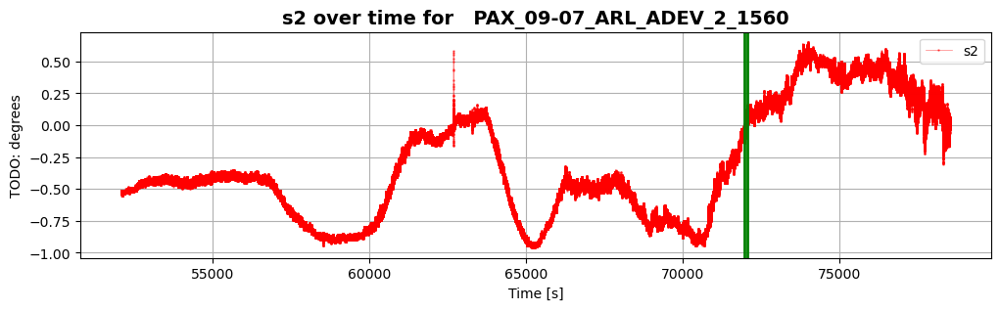

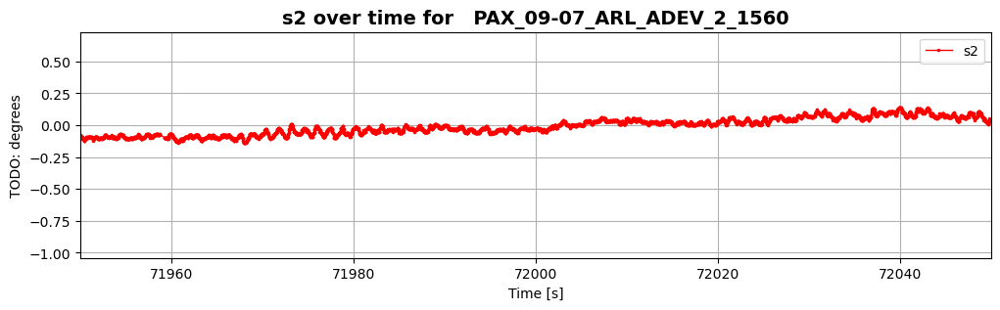

In [21]:
ds_temp.plot_raw(plot_param='s2', sample_range=(71950,72050))

Number of taus used: 3066


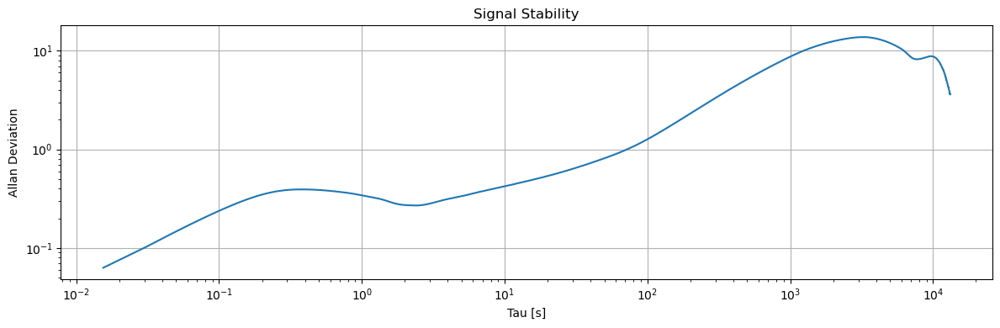

In [22]:
taus2,ad,ade,ns = ds_temp.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=True)

### Adev (switching)

#### Init

In [7]:
folder_path='Datasets/Whole_setup/08-17'
datasets = []; params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_name in os.listdir(folder_path):
    if file_name.endswith('.csv') and 'ARL' in file_name:
        file_path = os.path.join(folder_path, file_name)
        ds = StationarySet(file_path)
        datasets.append(ds)
        print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
        taus2,ad,ade,ns = ds.adev(plot_param='Ellipticity',num_taus=5000)
        label = ds.title
        params_arr.append((taus2,ad,ade,ns,label))
        i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
for ds in datasets:
    ds.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=True)
#StationarySet.plot_adev(params_arr)

===== Datasets =====
0 | PAX_08-17_ARL_Orth_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 66.74


KeyboardInterrupt: 

#### Debugging (implementing change_point_range_2)

##### Test 1

In [159]:
#TODO: drop averaged points with high STD

In [160]:
plt.ioff();

In [166]:
filepath_ARL_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1560.csv'
ds_3 = SwitchSet(filepath_ARL_1_1560,set_range=(0.05,0.15))

Time range: min=2225.277, max=6618.217


=== performing change point detection ===
cp range: (2300.0, 2400.0)
using 5729 data entries
skipping 4275 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5729,)
computing range... ---> range = (1.14,1.20)
displaying jump_fig for switch parameter = s1



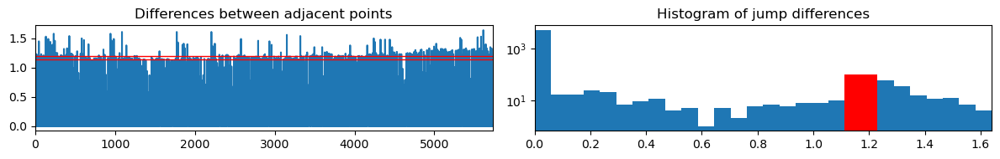



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5729,)
computing range... ---> range = (1.41,1.47)
displaying jump_fig for switch parameter = s2



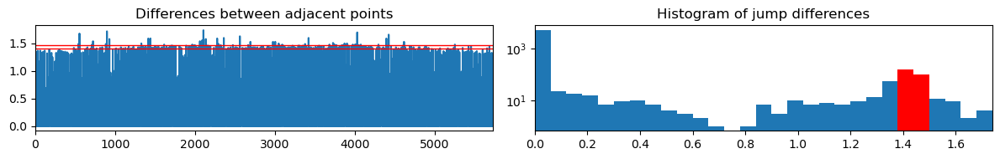



found width of 0.060 for s2
greater than prev width of 0.059 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5729,)
computing range... ---> range = (0.71,0.77)
displaying jump_fig for switch parameter = s3



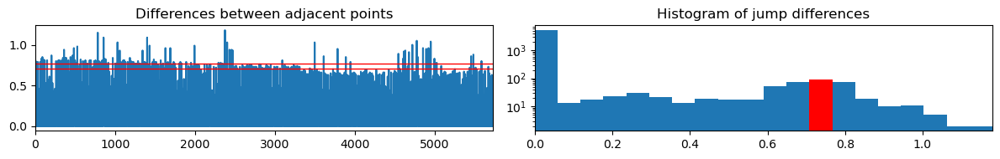



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.41,1.47)
Jump points detected: 183
out of total: ~400.0

computing offset...


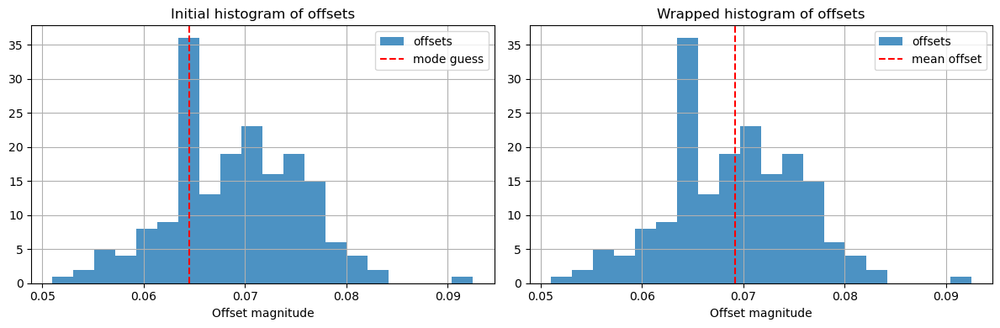



offset = 0.069 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3000.0, 3100.0)
using 5719 data entries
skipping 44436 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5719,)
computing range... ---> range = (1.16,1.22)
displaying jump_fig for switch parameter = s1



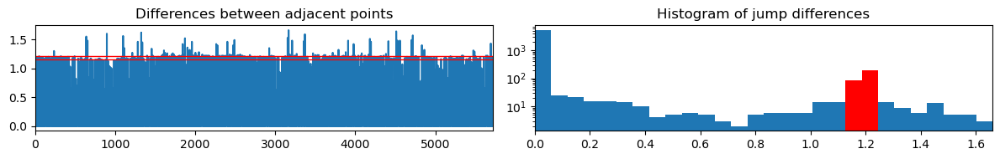



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5719,)
computing range... ---> range = (1.39,1.45)
displaying jump_fig for switch parameter = s2



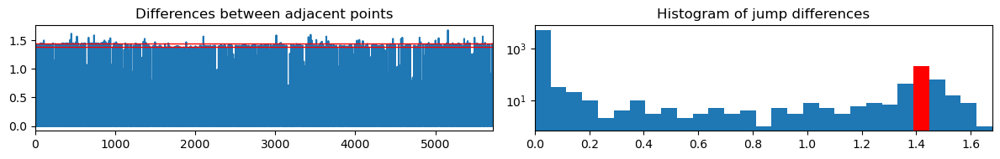



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5719,)
computing range... ---> range = (0.70,0.75)
displaying jump_fig for switch parameter = s3



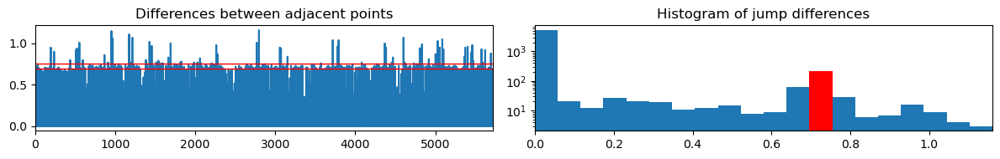



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (1.16,1.22)
Jump points detected: 209
out of total: ~399.9

computing offset...


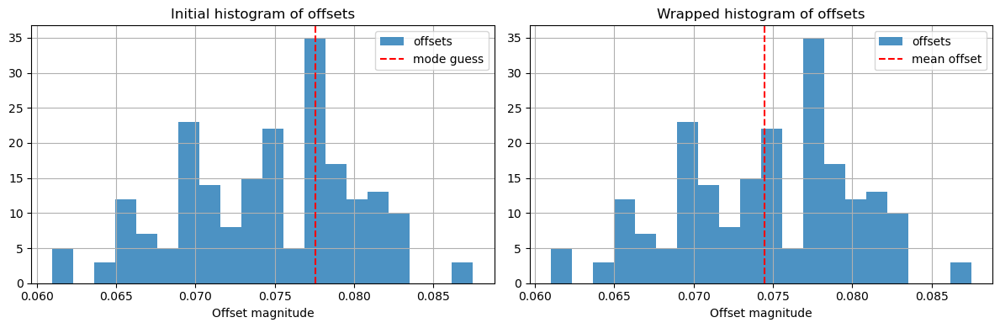



offset = 0.074 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.005 seconds over 2800.0 switches
Corrected Switch Time = 0.2500019


In [167]:
ds_3.find_switches(nominal_switch_rate=2, change_point_range_1=(2300,2400), change_point_range_2=(3000,3100),print_process=True)

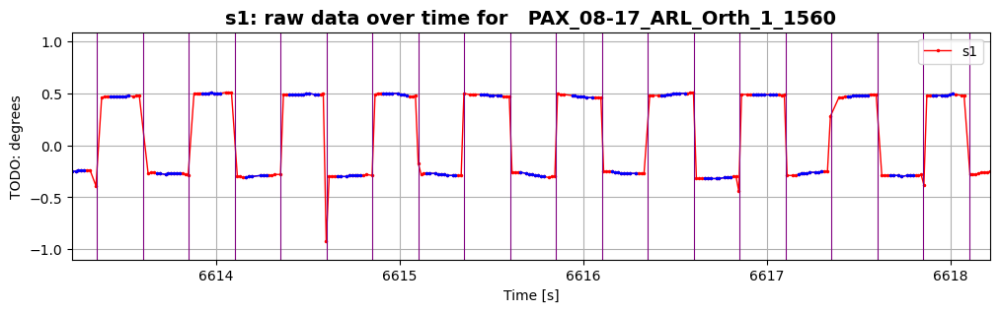

In [168]:
ds_3.plot_raw(birds_eye=False,sample_range=(-5,None),plot_switch=True,plot_valid=True,plot_avg=True)

In [133]:
off = ds_3.switch_offset
time = ds_3.switch_time
print(off)
print(time)
num*time+off

0.24159464350695803
0.2500021196640941


3051.2674630241113

In [9]:
1/.25000211/2

1.999983120142466

##### Test 2

In [42]:
filepath_ARL_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1560.csv'
ds_1_new = SwitchSet(filepath_ARL_1_1560,set_range=(600,-600))

In [43]:
ds_1_new.find_switches(nominal_switch_rate=2, change_point_range_1=(650,750), change_point_range_2=(3000,3100),print_process=False)

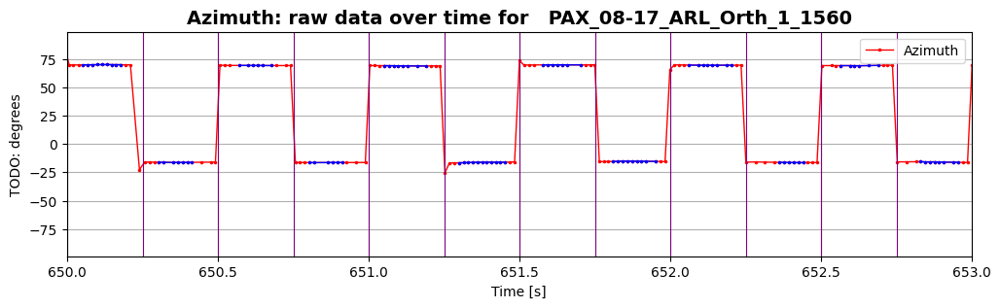

In [44]:
ds_1_new.plot_raw(birds_eye=False,sample_range=(650,653),plot_switch=True,plot_valid=True,plot_avg=True)

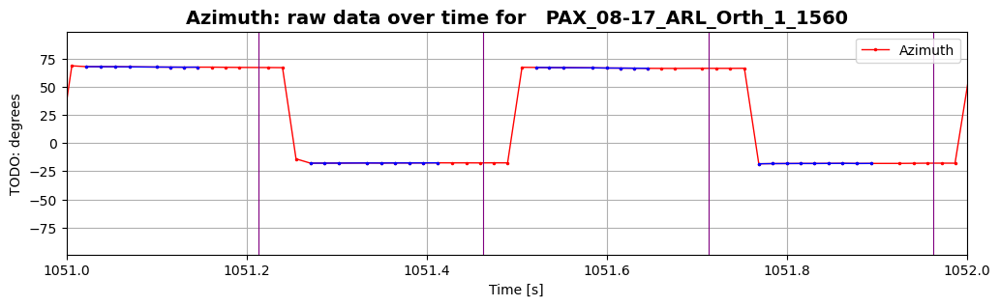

In [129]:
ds_1_new.plot_raw(birds_eye=False,sample_range=(1051,1052),plot_switch=True,plot_valid=True,plot_avg=True)

In [134]:
off = ds_1_new.switch_offset
time = ds_1_new.switch_time
print(off)
print(time)
num*time+off

0.3160627286132845
0.24997552391941325


3051.0173566411327

In [10]:
1/.2499755/2

2.0001960192098824

##### Test 3

In [66]:
filepath_ARL_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1560.csv'
ds_2_new = SwitchSet(filepath_ARL_1_1560,set_range=(600,-600))

In [67]:
ds_2_new.find_switches(nominal_switch_rate=2, change_point_range_1=(650,750), change_point_range_2=None,print_process=False)

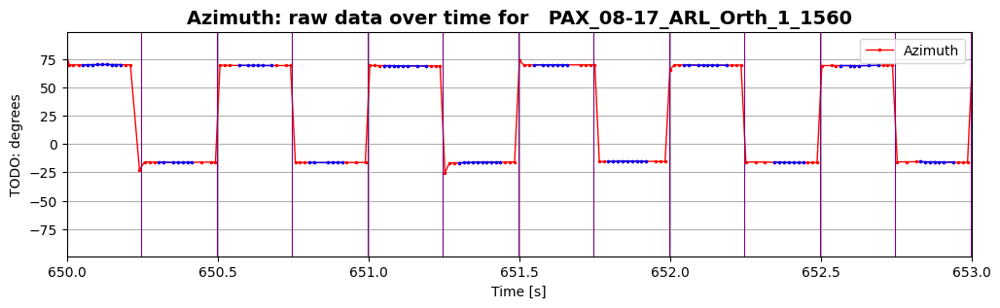

In [68]:
ds_2_new.plot_raw(birds_eye=False,sample_range=(650,653),plot_switch=True,plot_valid=True,plot_avg=True)

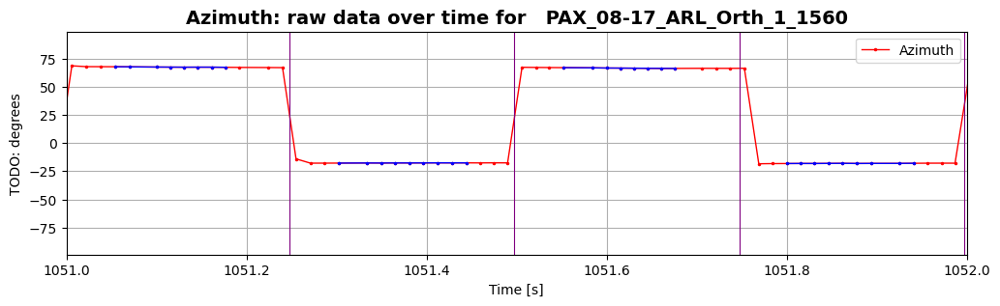

In [138]:
ds_2_new.plot_raw(birds_eye=False,sample_range=(1051,1052),plot_switch=True,plot_valid=True,plot_avg=True)

In [120]:
off = ds_2_new.switch_offset
time = ds_2_new.switch_time
print(off)
print(time)
num = np.ceil(3051/time)
print(num)
num*time+off

0.2475297029703318
0.25
12204.0


3051.2475297029705

##### Test 4

In [152]:
filepath_ARL_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1560.csv'
ds_4 = SwitchSet(filepath_ARL_1_1560,set_range=(600,-600))

In [153]:
ds_4.find_switches(nominal_switch_rate=2, change_point_range_1=(650,750), change_point_range_2=(3000,3100),print_process=False)

In [154]:
ds_4.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 1 observations with <4 points (out of total 172275 observations)

--- interpolating data ---
length before: 86138
length after: 86138
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 86136
length after: 86137
1 total added
--- end interpolating data ---
Signal 1 size=86137	Signal 1 range: t=(600.62,43668.99)
Signal 2 size=86138	Signal 2 range: t=(600.37,43669.24)
=== end average_data ===


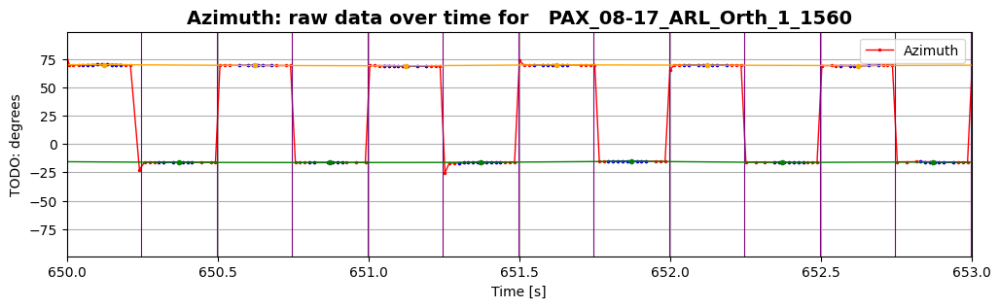

In [155]:
ds_4.plot_raw(birds_eye=False,sample_range=(650,653),plot_switch=True,plot_valid=True,plot_avg=True)

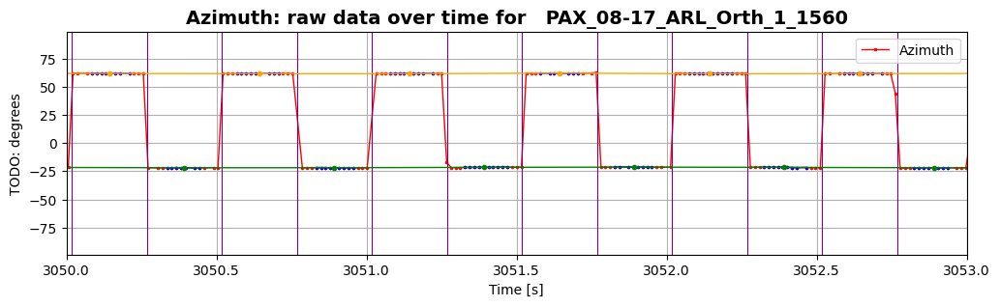

In [157]:
ds_4.plot_raw(birds_eye=False,sample_range=(3050,3053),plot_switch=True,plot_valid=True,plot_avg=True)

##### Test 5

In [170]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_DC_1_1345 = SwitchSet(filepath_DC_1_1345,set_range=(0.05,0.15))

Time range: min=2439.848, max=7306.779


In [ ]:
ds_DC_1_1345.find_switches(nominal_switch_rate=2, change_point_range_1=(2500,2600), print_process=True)

Discontinued test; not needed

#### ADEV: ARL

In [13]:
plt.ioff();

In [14]:
filepath_ARL_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
filepath_ARL_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1560.csv'
filepath_ARL_list = [filepath_ARL_1_1345,filepath_ARL_1_1560]

In [15]:
arr=[(1,2)]
arr_1=[(2,3),(3,4)]
arr+arr_1

[(1, 2), (2, 3), (3, 4)]

===== Datasets =====
Time range: min=2236.844, max=6617.273
Determining change point ranges automatically...
Using change_point_range_1=(2236.844, 2336.844)
Using change_point_range_2=(5236.844, 5336.844)
=== performing change point detection ===
cp range: (2236.844, 2336.844)
using 6767 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6767,)
computing range... ---> range = (0.44,0.50)
displaying jump_fig for switch parameter = s1



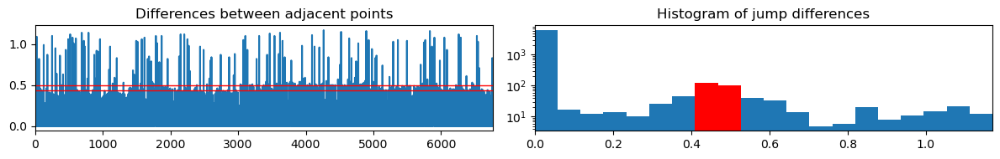



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6767,)
computing range... ---> range = (0.14,0.20)
displaying jump_fig for switch parameter = s2



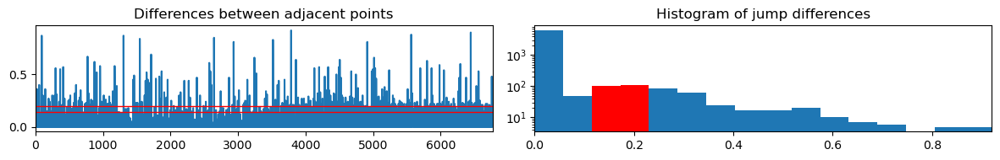



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6767,)
computing range... ---> range = (1.88,1.94)
displaying jump_fig for switch parameter = s3



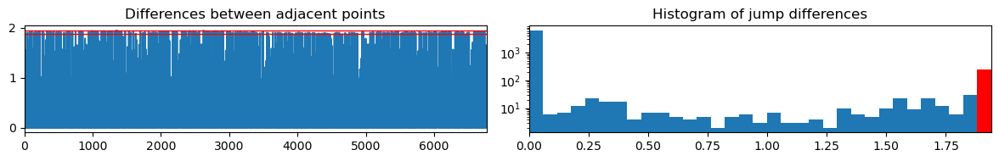



found width of 0.059 for s3
greater than prev width of 0.058 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.88,1.94)
Jump points detected: 243
out of total: ~400.0

computing offset...


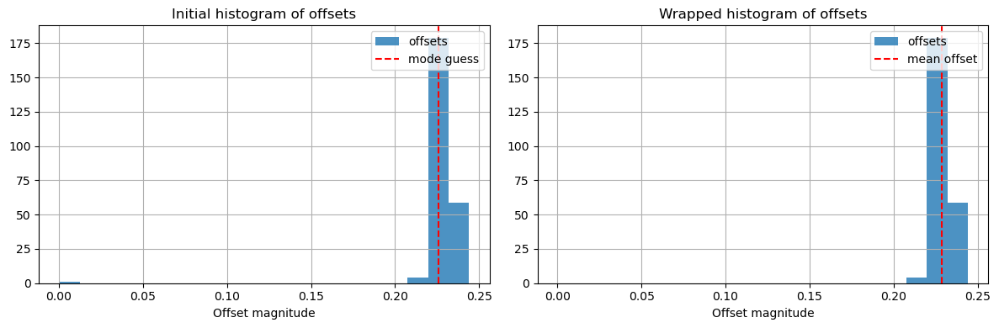



offset = 0.229 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (5236.844, 5336.844)
using 6783 data entries
skipping 202409 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6783,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s1



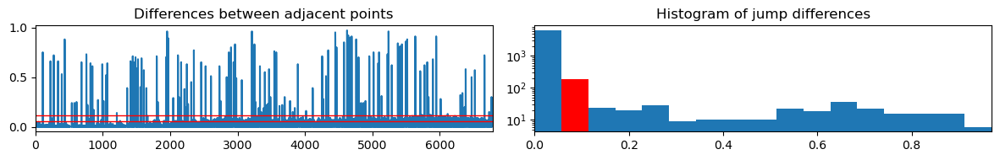



found width of 0.057 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6783,)
computing range... ---> range = (0.09,0.14)
displaying jump_fig for switch parameter = s2



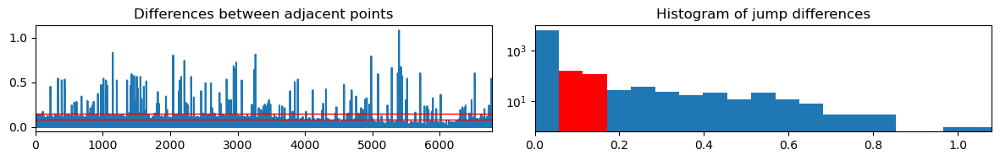



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6783,)
computing range... ---> range = (1.92,1.98)
displaying jump_fig for switch parameter = s3



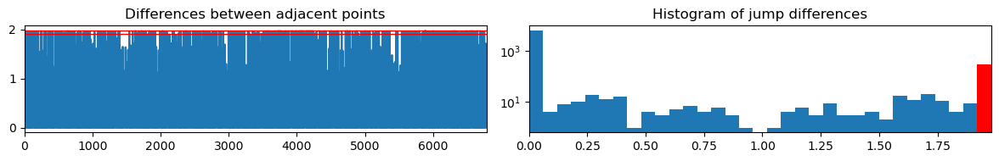



found width of 0.060 for s3
greater than prev width of 0.057 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.92,1.98)
Jump points detected: 289
out of total: ~399.9

computing offset...


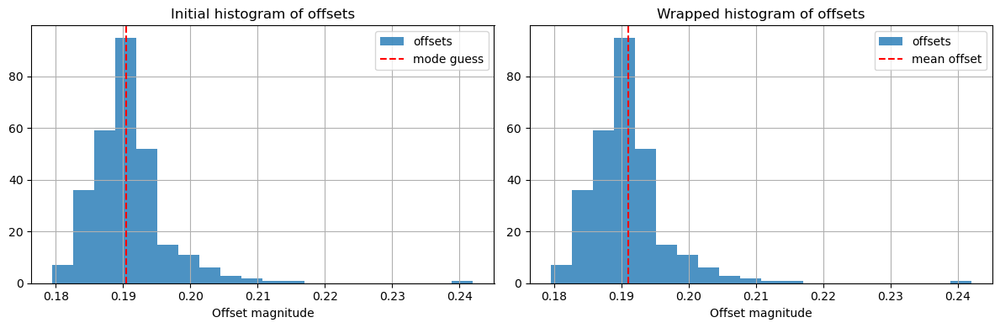



offset = 0.191 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.038 seconds over 12000.0 switches
Corrected Switch Time = 0.2499969
=== starting average_data ===
averaging data... Done
Dropped 11 observations with <4 points (out of total 17423 observations)

--- interpolating data ---
length before: 8709
length after: 8761
52 total added
--- end interpolating data ---

--- interpolating data ---
length before: 8703
length after: 8760
57 total added
--- end interpolating data ---
Signal 1 size=8760	Signal 1 range: t=(2237.35,6616.80)
Signal 2 size=8761	Signal 2 range: t=(2237.10,6617.05)
=== end average_data ===


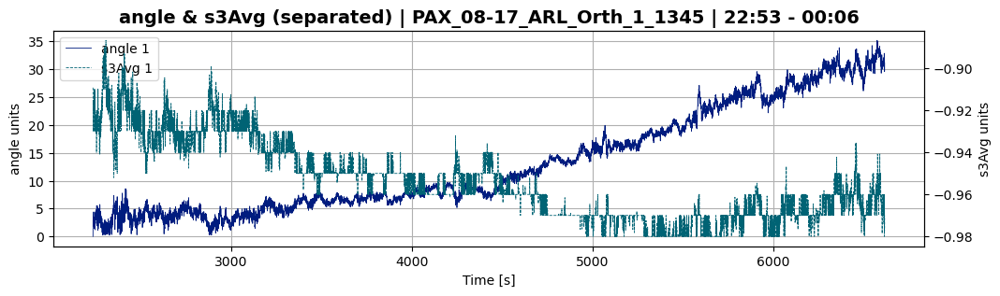

Number of taus used for signal 1: 1692
Number of taus used for signal 2: 1692


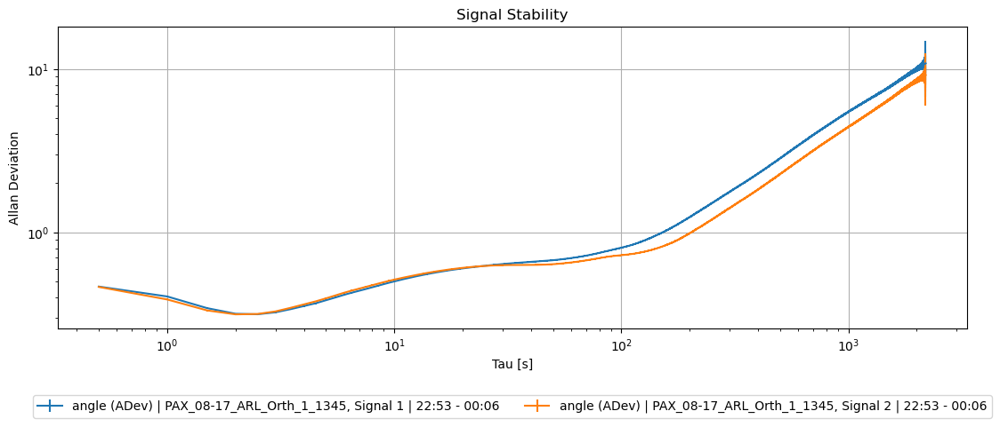

0 | PAX_08-17_ARL_Orth_1_1345 | bsr = 400.00 | nom rate = 200.00 | avg rate = 67.44
Time range: min=2225.277, max=6618.217
Determining change point ranges automatically...
Using change_point_range_1=(2225.277, 2325.277)
Using change_point_range_2=(5225.277, 5325.277)
=== performing change point detection ===
cp range: (2225.277, 2325.277)
using 5717 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5717,)
computing range... ---> range = (1.17,1.23)
displaying jump_fig for switch parameter = s1



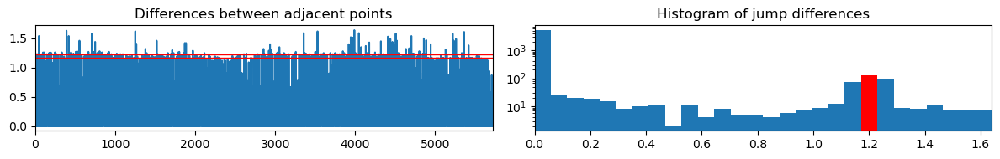



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5717,)
computing range... ---> range = (1.39,1.45)
displaying jump_fig for switch parameter = s2



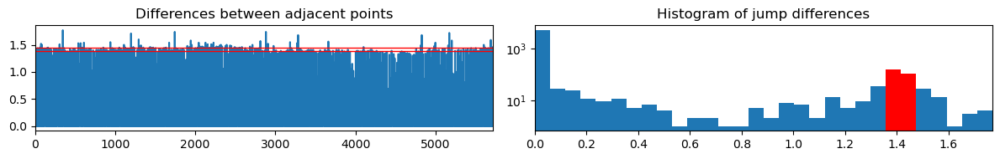



found width of 0.059 for s2
greater than prev width of 0.059 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5717,)
computing range... ---> range = (0.70,0.75)
displaying jump_fig for switch parameter = s3



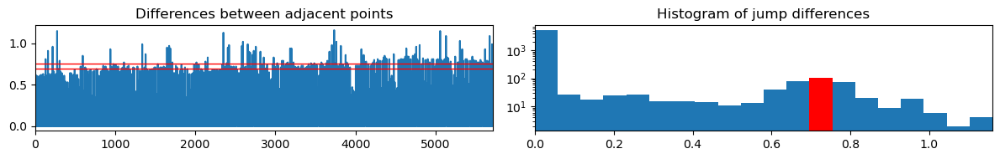



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.39,1.45)
Jump points detected: 179
out of total: ~399.9

computing offset...


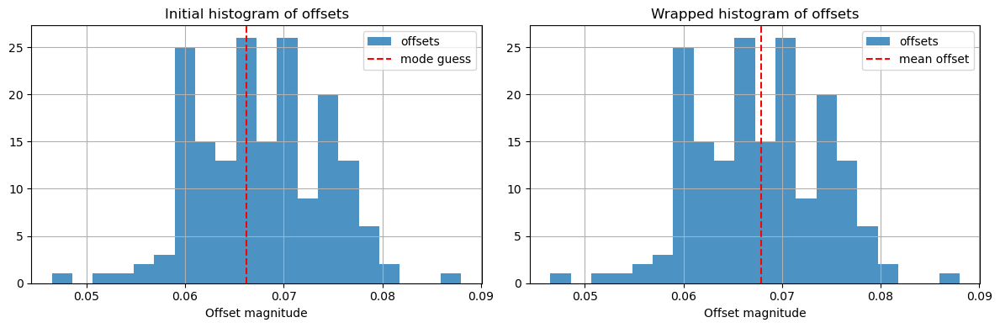



offset = 0.068 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (5225.277, 5325.277)
using 5767 data entries
skipping 171957 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5767,)
computing range... ---> range = (0.87,0.93)
displaying jump_fig for switch parameter = s1



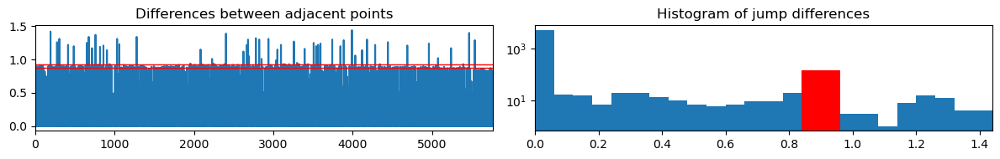



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5767,)
computing range... ---> range = (1.53,1.59)
displaying jump_fig for switch parameter = s2



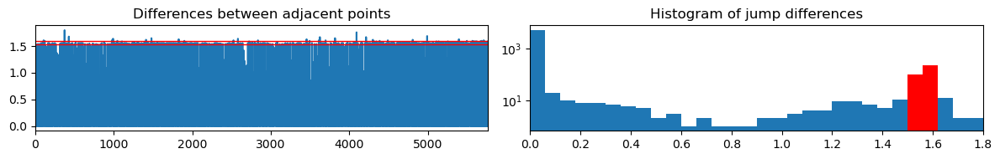



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5767,)
computing range... ---> range = (0.81,0.86)
displaying jump_fig for switch parameter = s3



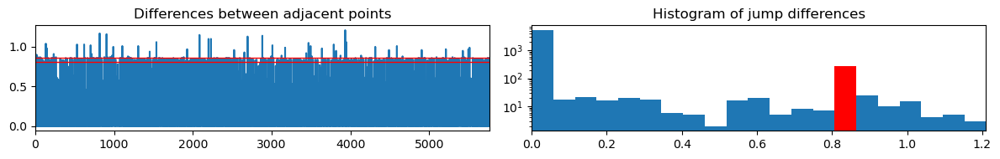



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.87,0.93)
Jump points detected: 252
out of total: ~400.0

computing offset...


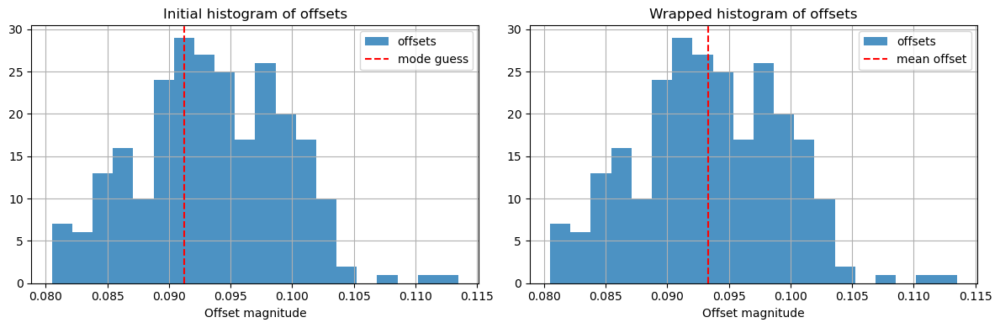



offset = 0.093 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.025 seconds over 12000.0 switches
Corrected Switch Time = 0.2500021
=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 17570 observations)

--- interpolating data ---
length before: 8785
length after: 8785
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 8785
length after: 8785
0 total added
--- end interpolating data ---
Signal 1 size=8785	Signal 1 range: t=(2225.94,6617.98)
Signal 2 size=8785	Signal 2 range: t=(2225.69,6617.73)
=== end average_data ===


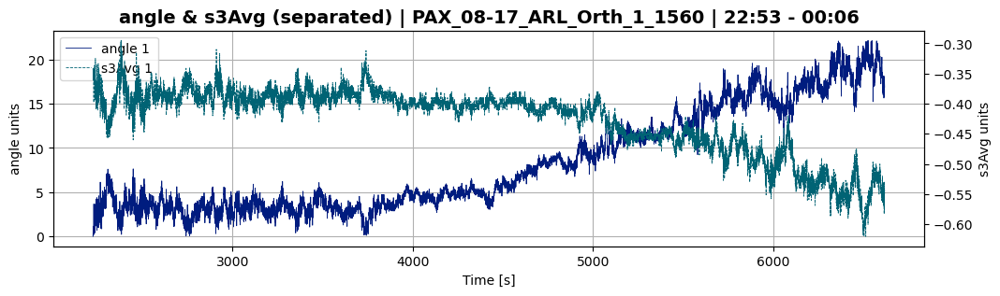

Number of taus used for signal 1: 1693
Number of taus used for signal 2: 1693


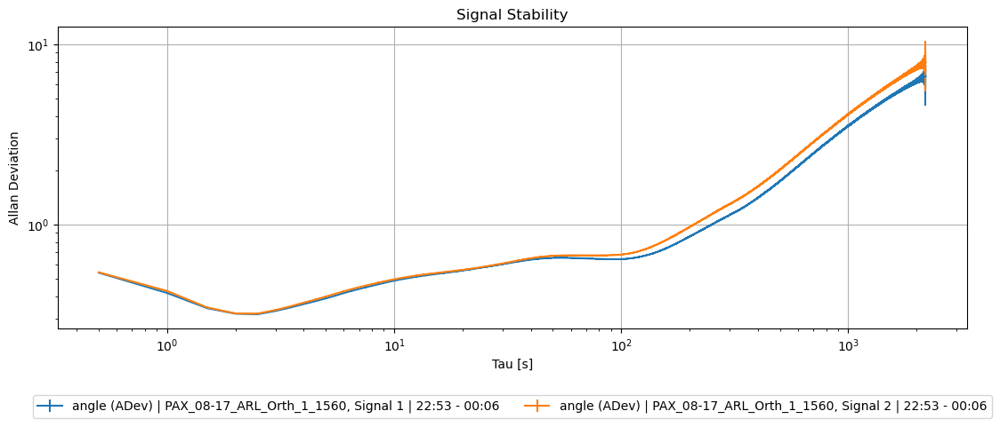

1 | PAX_08-17_ARL_Orth_1_1560 | bsr = 400.00 | nom rate = 200.00 | avg rate = 57.41


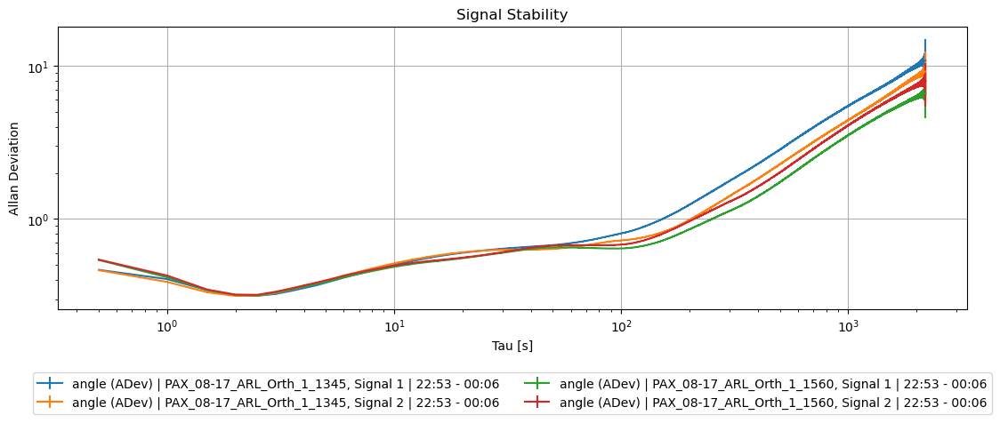

In [127]:
ARL_datasets = []; ARL_params_arr = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_path in filepath_ARL_list:
    ds = SwitchSet(file_path,set_range=(0.05,0.15))
    ds.find_switches(nominal_switch_rate=2, print_process=True)
    ds.average_data(print_process=True)
    ds.calc_similarity(input_stokes='first')
    ds.plot_separated(plot_param='angle', plot_param_2='s3Avg', plot_signal=1)
    arr = ds.adev(plot_param='angle',num_taus=5000,plot_adev=True)
    ARL_datasets.append(ds)
    ARL_params_arr = ARL_params_arr + arr
    print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
    i+=1
print(BOLD_ON + '========================' + BOLD_OFF)
StationarySet.plot_adev(ARL_params_arr)

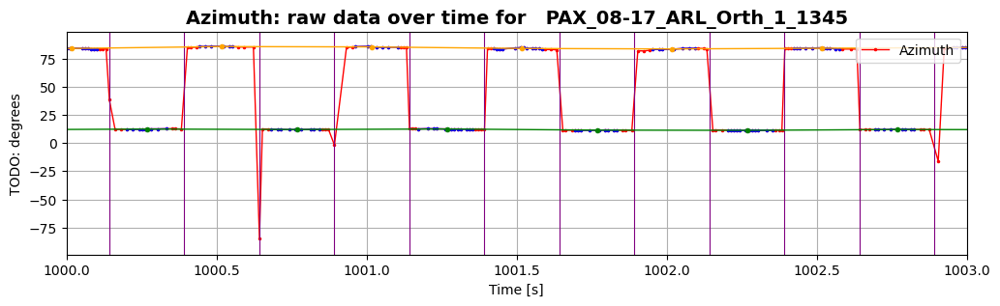

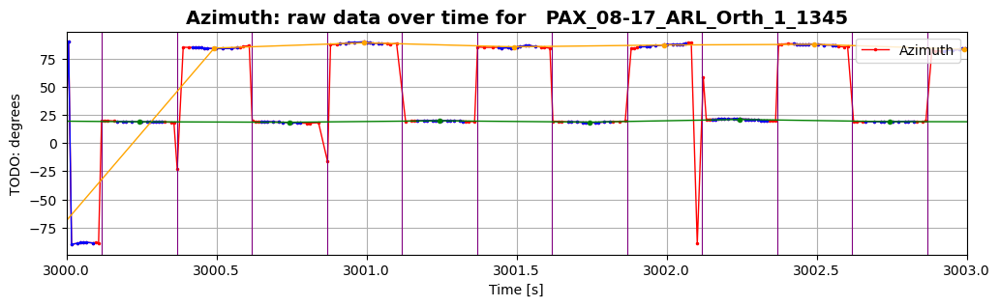

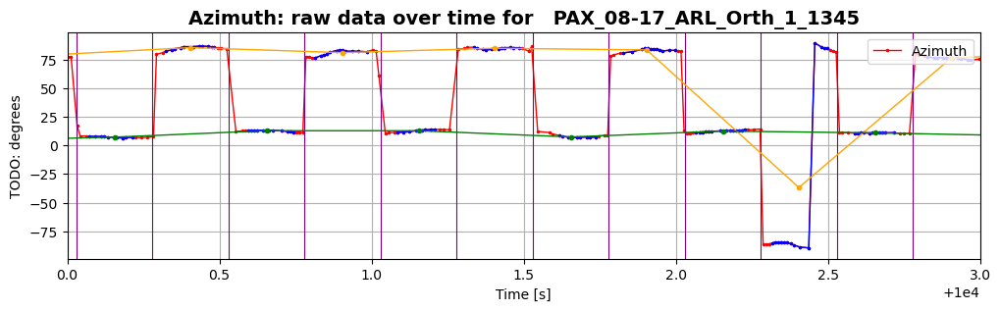

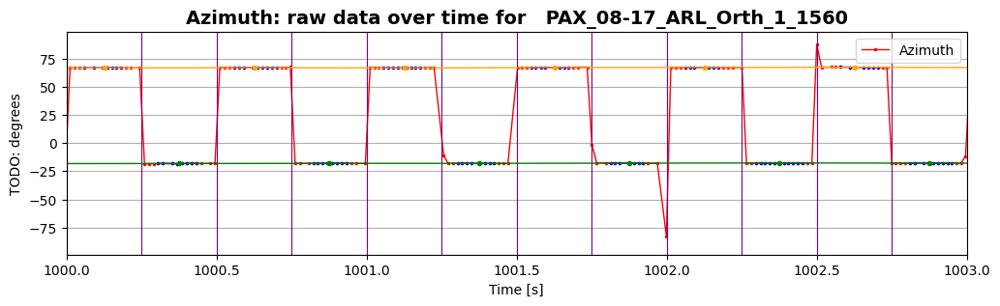

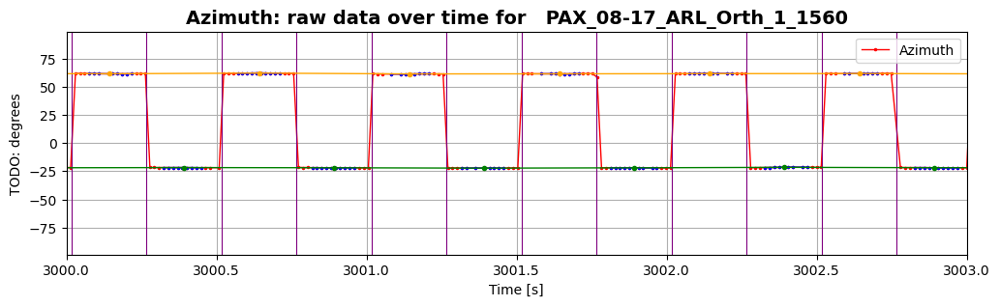

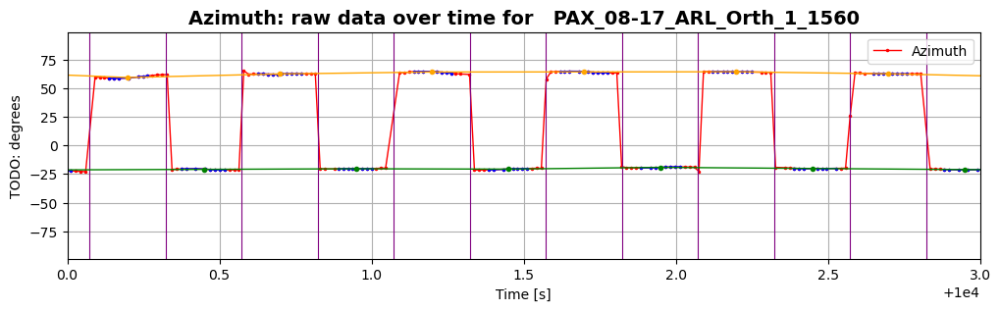

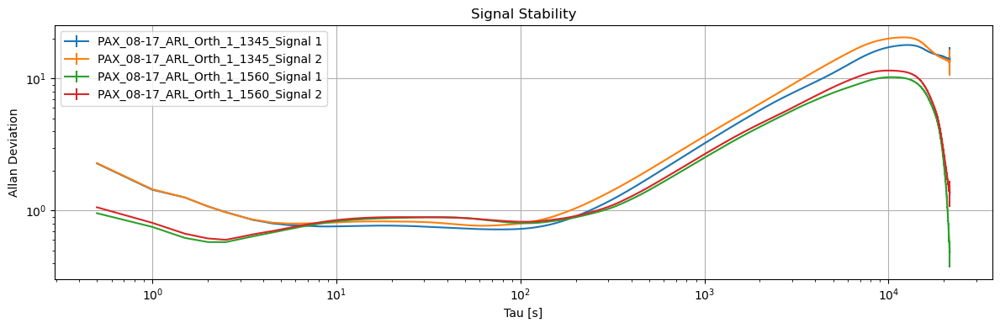

In [207]:
ARL_params_arr = []
for ds in ARL_datasets:
    ds.plot_raw(birds_eye=False,sample_range=(1000,1003),plot_switch=True,plot_valid=True,plot_avg=True)
    ds.plot_raw(birds_eye=False,sample_range=(3000,3003),plot_switch=True,plot_valid=True,plot_avg=True)
    ds.plot_raw(birds_eye=False,sample_range=(10000,10003),plot_switch=True,plot_valid=True,plot_avg=True)
    taus2_1,ad_1,ade_1,ns_1,taus2_2,ad_2,ade_2,ns_2 = ds.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=False)
    label = ds.title
    ARL_params_arr.append((taus2_1,ad_1,ade_1,ns_1,label+'_Signal 1'))
    ARL_params_arr.append((taus2_2,ad_2,ade_2,ns_2,label+'_Signal 2'))
StationarySet.plot_adev(ARL_params_arr)

#### ADEV: 30m

In [ ]:
filepath_con_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_Connector_Orth_1_1345.csv'
filepath_con_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_Connector_Orth_1_1560.csv'
filepath_con_list = [filepath_con_1_1345,filepath_con_1_1560]

In [ ]:
con_datasets = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_path in filepath_con_list:
    ds = SwitchSet(file_path,set_range=(600,-600))
    ds.find_switches(nominal_switch_rate=2, change_point_range_1=(600,800), change_point_range_2=(3000,3200),print_process=False)
    ds.average_data(print_process=False)
    con_datasets.append(ds)
    print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
    i+=1
print(BOLD_ON + '========================' + BOLD_OFF)

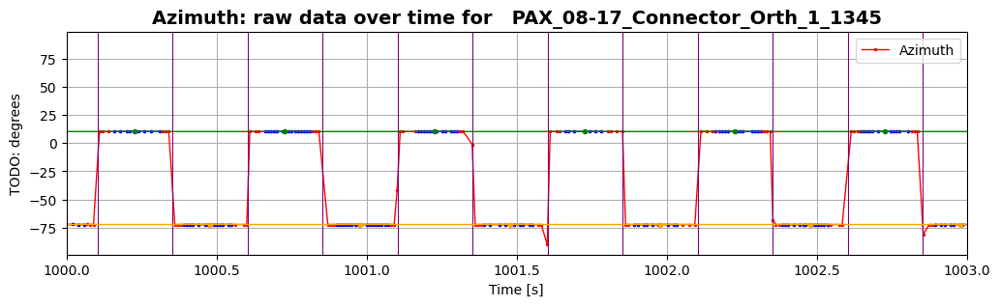

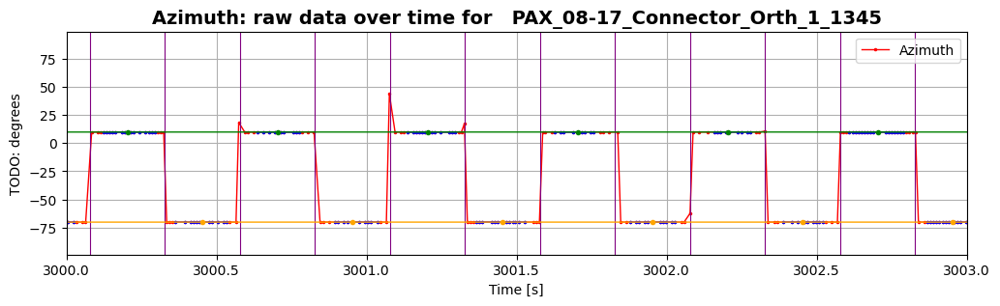

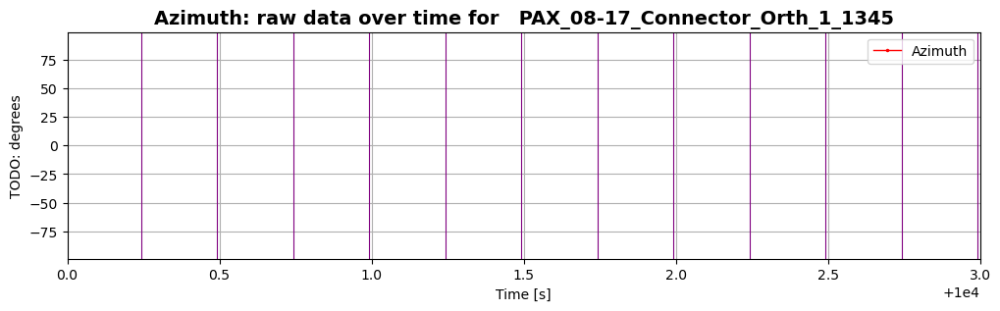

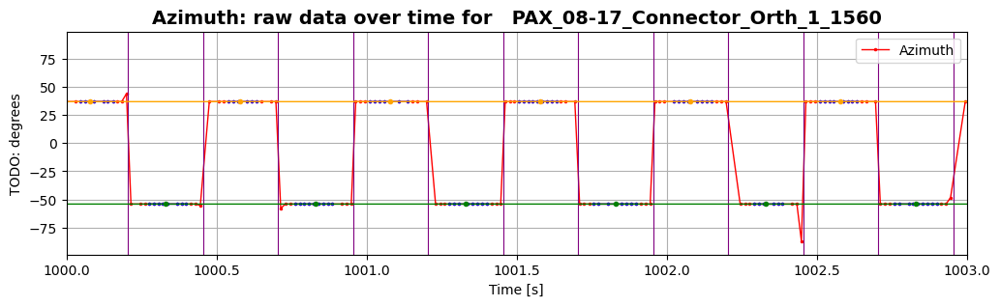

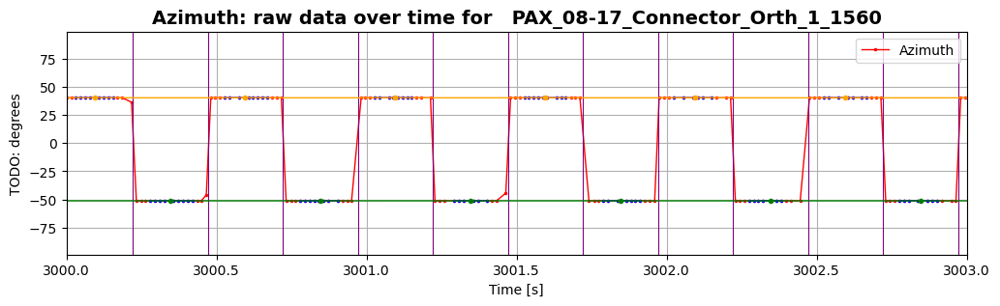

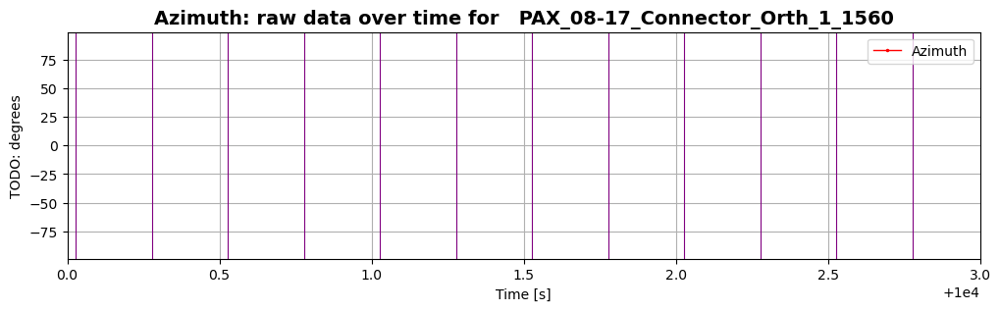

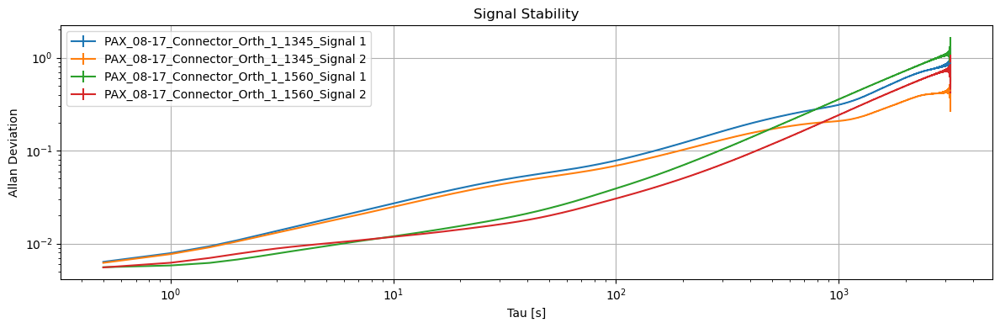

In [209]:
Connector_params_arr = []
for ds in Connector_datasets:
    ds.plot_raw(birds_eye=False,sample_range=(1000,1003),plot_switch=True,plot_valid=True,plot_avg=True)
    ds.plot_raw(birds_eye=False,sample_range=(3000,3003),plot_switch=True,plot_valid=True,plot_avg=True)
    ds.plot_raw(birds_eye=False,sample_range=(10000,10003),plot_switch=True,plot_valid=True,plot_avg=True)
    taus2_1,ad_1,ade_1,ns_1,taus2_2,ad_2,ade_2,ns_2 = ds.adev(plot_param='Ellipticity',num_taus=5000,plot_adev=False)
    label = ds.title
    Connector_params_arr.append((taus2_1,ad_1,ade_1,ns_1,label+'_Signal 1'))
    Connector_params_arr.append((taus2_2,ad_2,ade_2,ns_2,label+'_Signal 2'))
StationarySet.plot_adev(Connector_params_arr)

#### ADEV: DC

In [59]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
filepath_DC_1_1560='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1560.csv'
filepath_DC_list = [filepath_DC_1_1345,filepath_DC_1_1560]

In [60]:
DC_datasets = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_path in filepath_DC_list:
    ds = SwitchSet(file_path,set_range=(600,-600))
    ds.find_switches(nominal_switch_rate=2, change_point_range_1=(600,800), change_point_range_2=(3000,3200),print_process=False)
    ds.average_data(print_process=False)
    ds.calc_transfer(input_stokes='first')
    DC_datasets.append(ds)
    print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
    i+=1
print(BOLD_ON + '========================' + BOLD_OFF)

===== Datasets =====
Time range: min=600.005, max=48479.705


TypeError: can only concatenate str (not "float") to str

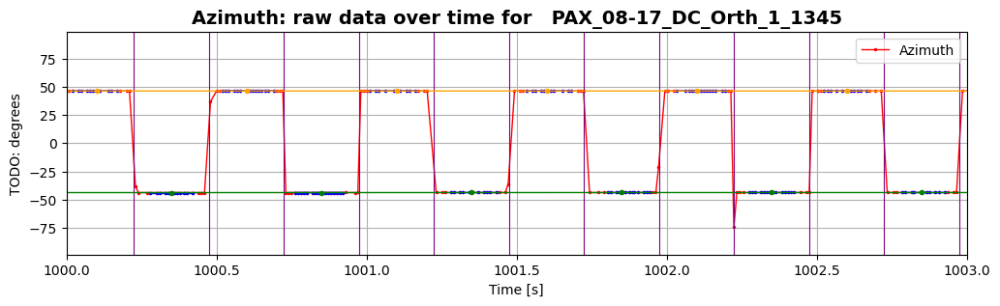

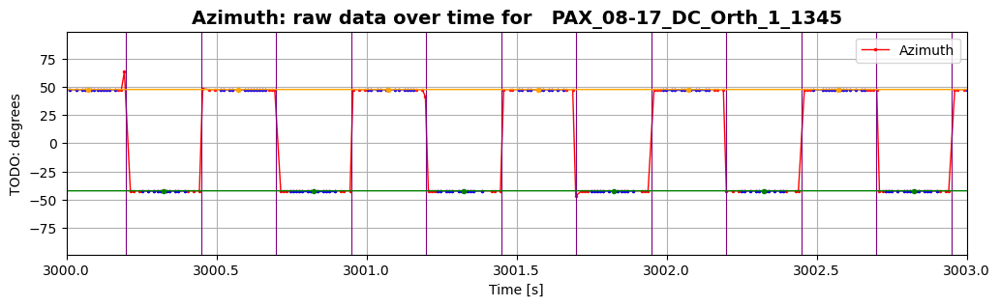

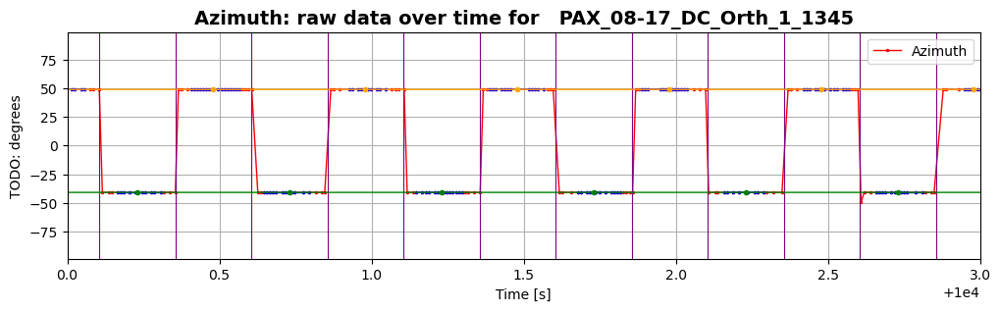

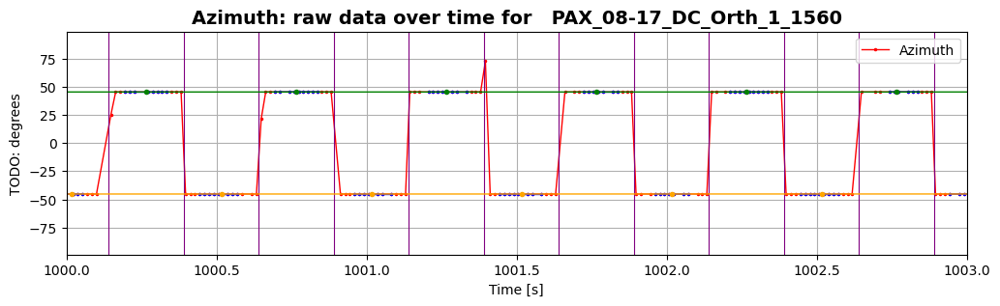

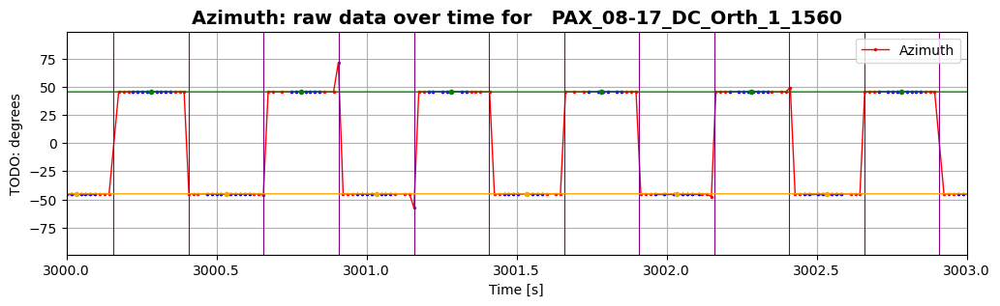

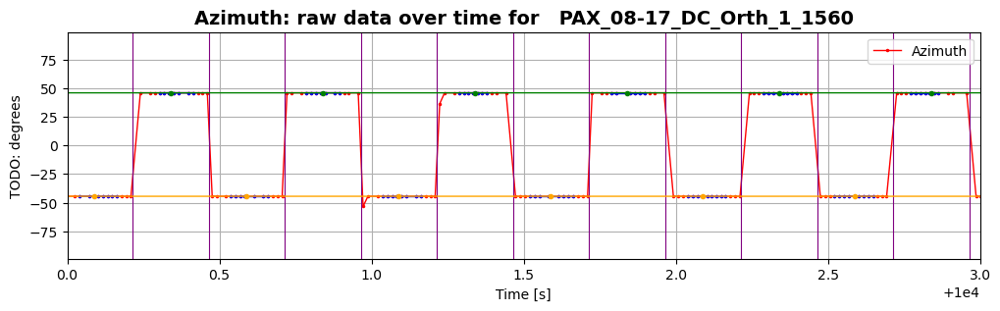

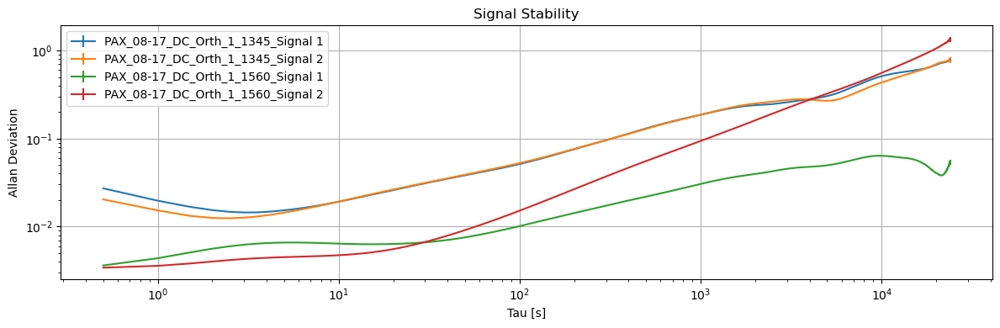

In [211]:
DC_params_arr = []
for ds in DC_datasets:
    ds.plot_raw(birds_eye=False,plot_param='dot',sample_range=(1000,1003),plot_switch=True,plot_valid=True,plot_avg=True)
    ds.plot_raw(birds_eye=False,plot_param='dot',sample_range=(3000,3003),plot_switch=True,plot_valid=True,plot_avg=True)
    ds.plot_raw(birds_eye=False,plot_param='dot',sample_range=(10000,10003),plot_switch=True,plot_valid=True,plot_avg=True)
    taus2_1,ad_1,ade_1,ns_1,taus2_2,ad_2,ade_2,ns_2 = ds.adev(plot_param='dot',num_taus=5000,plot_adev=False)
    label = ds.title
    DC_params_arr.append((taus2_1,ad_1,ade_1,ns_1,label+'_Signal 1'))
    DC_params_arr.append((taus2_2,ad_2,ade_2,ns_2,label+'_Signal 2'))
StationarySet.plot_adev(DC_params_arr)

#### debugging

In [175]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_1 = SwitchSet(filepath_DC_1_1345,set_range=(600,-600))

In [176]:
ds_1.find_switches(nominal_switch_rate=2, change_point_range_1=(600,700), change_point_range_2=(3000,3100),print_process=False)

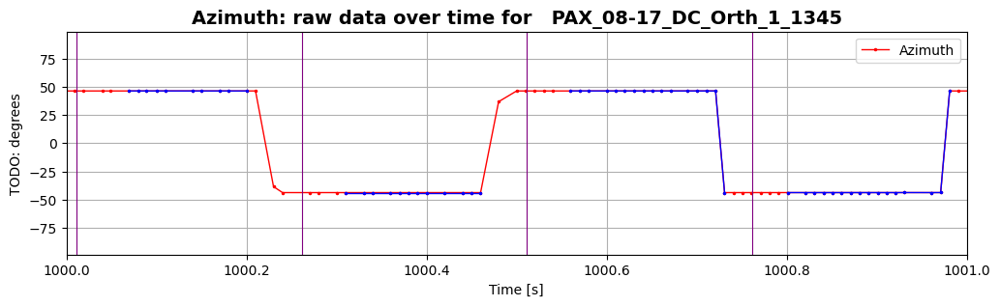

In [189]:
ds_1.plot_raw(birds_eye=False,sample_range=(1000,1001),plot_switch=True,plot_valid=True)

In [187]:
off = ds_1.switch_offset
time = ds_1.switch_time
print(off)
print(time)
num*time+off

0.17026419250584857
0.25002281928735265


3000.4440956407375

In [178]:
ds_2 = SwitchSet(filepath_DC_1_1345,set_range=(600,-600))

In [179]:
ds_2.find_switches(nominal_switch_rate=2, change_point_range_1=(600,700), change_point_range_2=None,print_process=False)

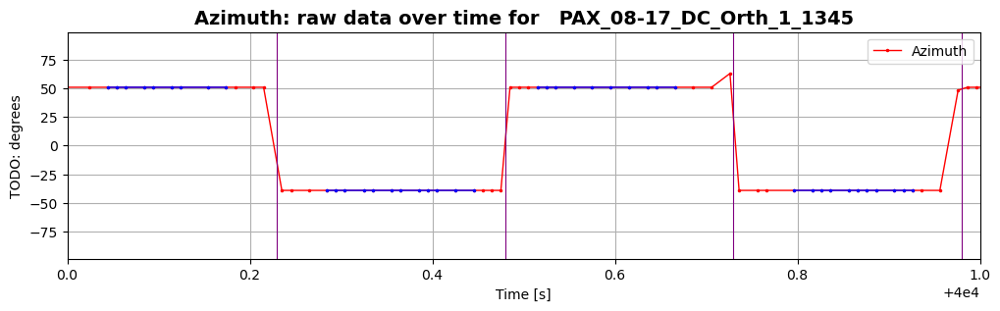

In [194]:
ds_2.plot_raw(birds_eye=False,sample_range=(40000,40001),plot_switch=True,plot_valid=True)

In [191]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_3 = SwitchSet(filepath_DC_1_1345,set_range=(600,-600))

In [192]:
ds_3.find_switches(nominal_switch_rate=2, change_point_range_1=(600,700), change_point_range_2=(3000,3100),print_process=False)

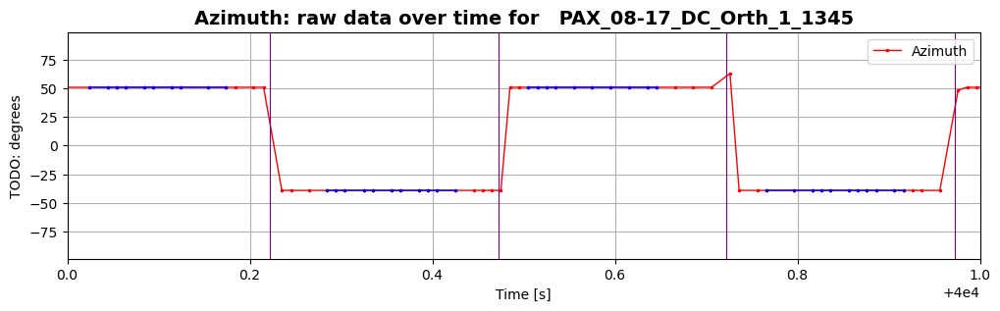

In [201]:
ds_3.plot_raw(birds_eye=False,sample_range=(40000,40001),plot_switch=True,plot_valid=True)

In [183]:
off = ds_2.switch_offset
time = ds_2.switch_time
print(off)
print(time)
num = np.ceil(3000/time)
print(num)
num*time+off

0.22959433962268216
0.25
12000.0


3000.2295943396225

#### Other stuff

In [ ]:
datasets = []; i=0
print(BOLD_ON + '===== Datasets =====' + BOLD_OFF)
for file_path in filepath_connector_list:
    ds = SwitchSet(file_path,set_range=(500,None))
    ds.find_switches(nominal_switch_rate=2, change_point_range_1=(550,650), change_point_range_2=(3000,3050),print_process=False)
    ds.average_data(print_process=False)
    datasets.append(ds)
    print('{:d} | {:s} | bsr = {:.2f} | nom rate = {:.2f} | avg rate = {:.2f}'.format(i,ds.title,ds.basic_sample_rate,ds.nominal_sample_rate,ds.avg_sample_rate))
    i+=1
print(BOLD_ON + '========================' + BOLD_OFF)

In [66]:
filepath='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1560.csv'
ds = SwitchSet(filepath,set_range=(500,None))
#ds.plot_raw()

#ds.find_switches(nominal_switch_rate=2, change_point_range_1=(550,650), change_point_range_2=(3000,3050))
#ds.average_data()
#ds.adev(plot_adev=True);

In [69]:
ds.find_switches(nominal_switch_rate=2, change_point_range_1=(550,650), change_point_range_2=(3000,3050),print_process=True)

Error in Second Tolerance: difference=0.14 < tolerance=0.50
Likely cause: FPCs moved during setup OR high variability in dataset
Error in Second Tolerance: difference=0.23 < tolerance=0.50
Likely cause: FPCs moved during setup OR high variability in dataset


In [85]:
ds.average_data(print_process=True)

Dropped 16 observations with <4 points (out of total 194346 observations)
adding 16 total
length before: 194330

Marked ind=1116: Imputing single gap at t=779.5 of length 0.530 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=1117: Imputing single gap at t=780.0 of length 0.502 seconds (vs nominal switch time of 0.250 seconds)


TypeError: can only concatenate str (not "float") to str

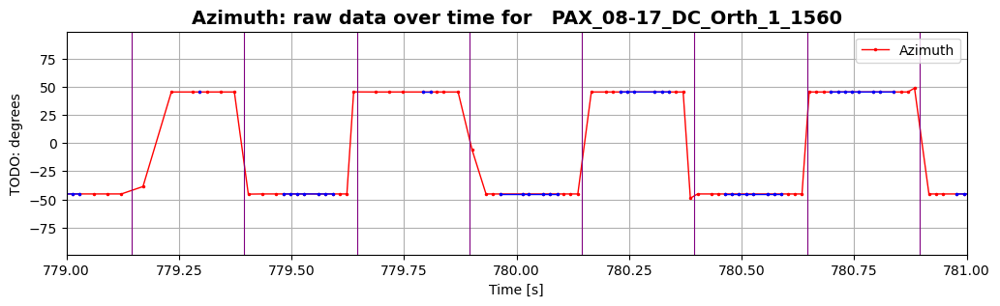

In [86]:
ds.plot_raw(birds_eye=False,sample_range=(779,781),plot_switch=True,plot_valid=True)

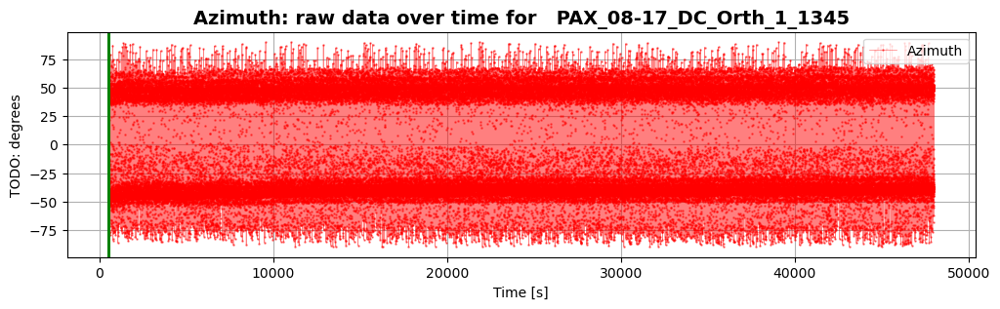

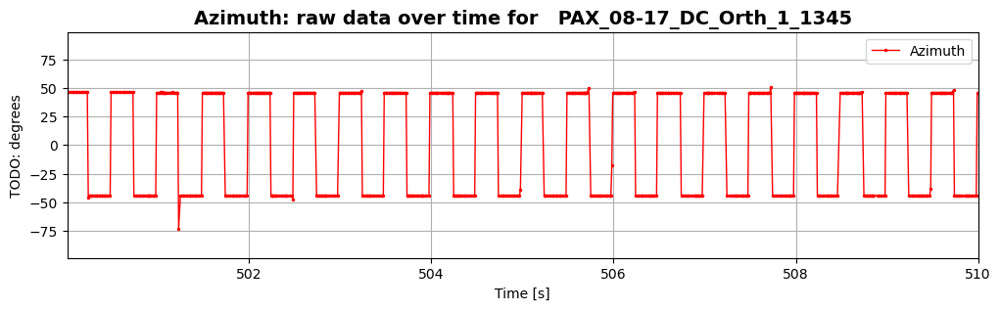

In [112]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_DC_1_1345 = SwitchSet(filepath_DC_1_1345,set_range=(500,48000))
ds_DC_1_1345.plot_raw(sample_range=(None,510))

noise_tolerance = 0.0
first_tolerance = 1.0
second_tolerance = 0.5

Error in Second Tolerance: difference=0.24 < tolerance=0.50
Likely cause: FPCs moved during setup OR high variability in dataset
jump_fig for: switch parameter = s1



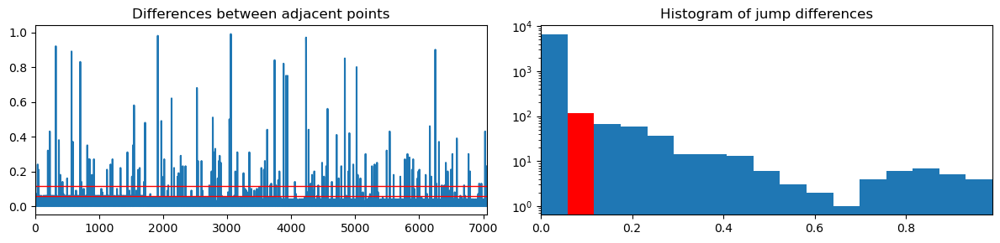



jump_fig for: switch parameter = s2



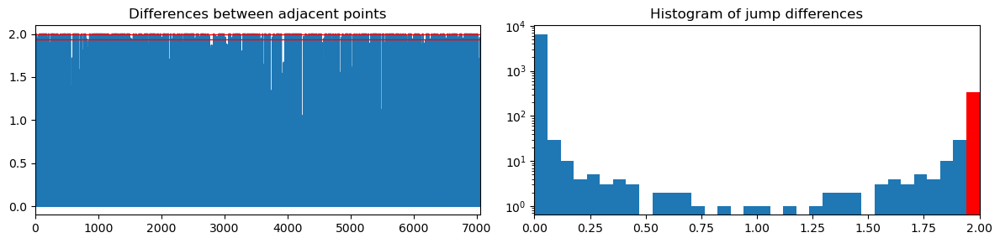



Error in (adjusted) Second Tolerance: difference=0.02 < tolerance=0.20
Likely cause: FPCs moved during setup OR high variability in dataset
jump_fig for: switch parameter = s3



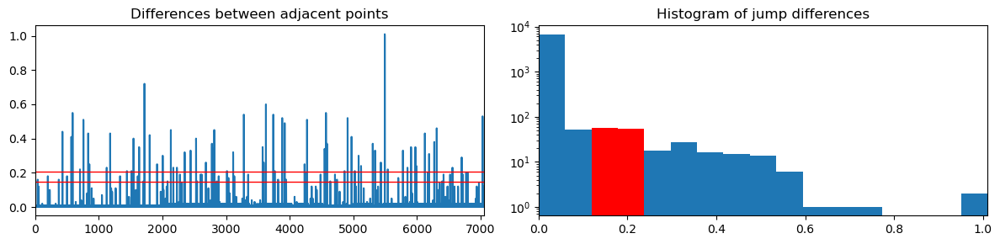



switch parameter = s3

Jump points detected: 64
out of total: ~400.0



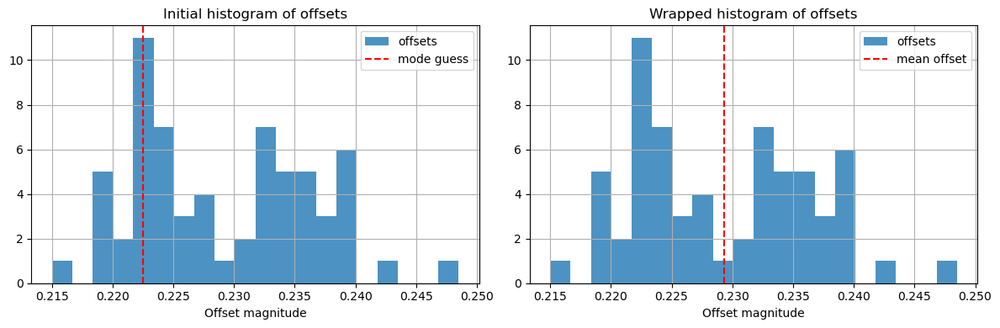



noise_tolerance = 0.0
first_tolerance = 1.0
second_tolerance = 0.5

jump_fig for: switch parameter = s1



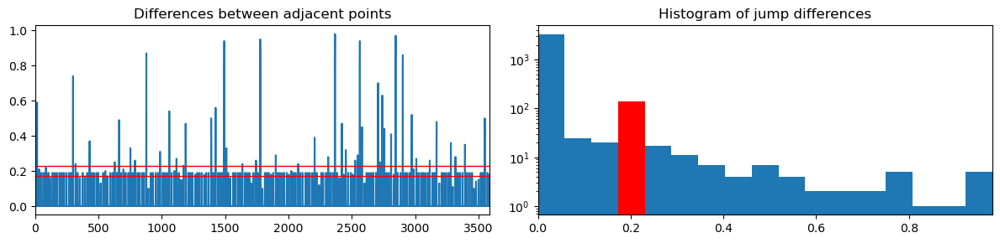



jump_fig for: switch parameter = s2



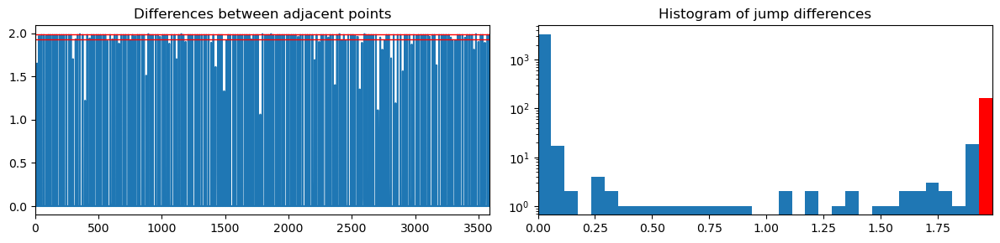



Error in (adjusted) Second Tolerance: difference=0.05 < tolerance=0.20
Likely cause: FPCs moved during setup OR high variability in dataset
jump_fig for: switch parameter = s3



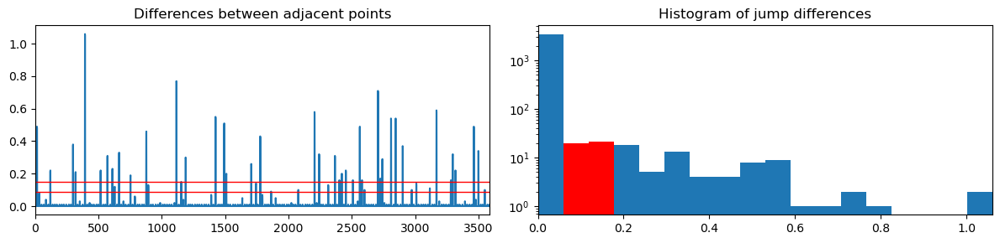



switch parameter = s3

Jump points detected: 22
out of total: ~199.9



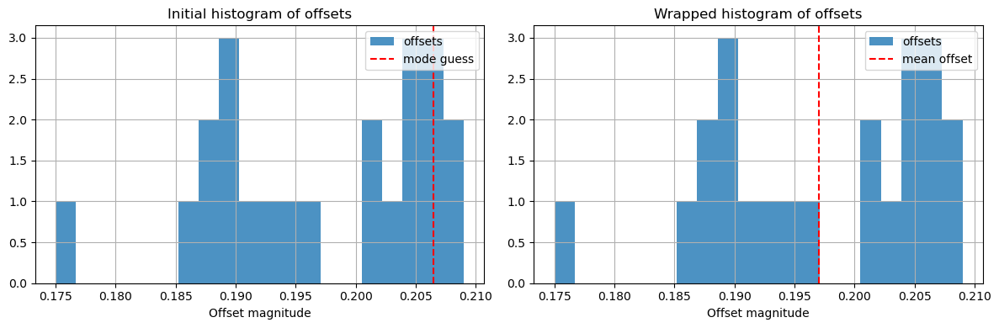



Nominal Switch Time = 0.2500000
Offset change of -0.032 seconds over 9700.0 switches
Corrected Switch Time = 0.2499967


In [113]:
ds_DC_1_1345.find_switches(nominal_switch_rate=2, change_point_range_1=(550,650), change_point_range_2=(3000,3050),print_process=True)

In [114]:
ds_DC_1_1345.average_data(print_process=True)

Dropped 136 observations with <4 points (out of total 189801 observations)
adding 336 total
length before: 189665

Marked ind=1026: Imputing single gap at t=757.1 of length 0.512 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=1053: Imputing single gap at t=764.1 of length 0.527 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=1055: Imputing single gap at t=764.8 of length 0.529 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=31708: Imputing single gap at t=8428.2 of length 0.498 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=33251: Imputing single gap at t=8814.2 of length 0.491 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=34388: Imputing single gap at t=9098.7 of length 0.479 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=34616: Imputing single gap at t=9156.0 of length 0.492 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=34845: Imputing single gap at t=9213.5 of length 0.536 seconds (vs n

Marked ind=68052: Imputing single gap at t=17528.6 of length 0.535 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=68442: Imputing single gap at t=17626.4 of length 0.498 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=68833: Imputing single gap at t=17724.4 of length 0.503 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=69225: Imputing single gap at t=17822.6 of length 0.517 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=69623: Imputing single gap at t=17922.4 of length 0.500 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=75631: Imputing single gap at t=19424.6 of length 0.524 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=76832: Imputing single gap at t=19725.1 of length 0.518 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=79635: Imputing single gap at t=20426.1 of length 0.508 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=80435: Imputing single gap at t=20626.3 of length 0.5

Marked ind=115631: Imputing single gap at t=29440.0 of length 0.528 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=116431: Imputing single gap at t=29640.2 of length 0.498 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=116830: Imputing single gap at t=29740.2 of length 0.502 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=117229: Imputing single gap at t=29840.2 of length 0.523 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=118028: Imputing single gap at t=30040.2 of length 0.550 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=118428: Imputing single gap at t=30140.5 of length 0.502 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=119629: Imputing single gap at t=30440.9 of length 0.520 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=120428: Imputing single gap at t=30640.9 of length 0.535 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=120828: Imputing single gap at t=30741.2 of l

Marked ind=146400: Imputing single gap at t=37150.6 of length 0.492 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=147198: Imputing single gap at t=37350.9 of length 0.543 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=147598: Imputing single gap at t=37451.1 of length 0.535 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=147998: Imputing single gap at t=37551.4 of length 0.466 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=148796: Imputing single gap at t=37751.6 of length 0.510 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=149195: Imputing single gap at t=37851.6 of length 0.507 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=149594: Imputing single gap at t=37951.6 of length 0.549 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=149994: Imputing single gap at t=38051.8 of length 0.515 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=150393: Imputing single gap at t=38151.8 of l

Marked ind=175157: Imputing single gap at t=44361.3 of length 0.584 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=175955: Imputing single gap at t=44561.5 of length 0.552 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=176355: Imputing single gap at t=44661.8 of length 0.501 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=177552: Imputing single gap at t=44962.3 of length 0.521 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=178750: Imputing single gap at t=45263.0 of length 0.561 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=179149: Imputing single gap at t=45363.0 of length 0.550 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=179948: Imputing single gap at t=45563.5 of length 0.520 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=180347: Imputing single gap at t=45663.5 of length 0.535 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=180747: Imputing single gap at t=45763.7 of l

Marked ind=185540: Imputing double gap at t=46965.7 of length 0.741 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=187536: Imputing double gap at t=47466.2 of length 0.753 seconds (vs nominal switch time of 0.250 seconds)
Marked ind=188335: Imputing double gap at t=47666.7 of length 0.759 seconds (vs nominal switch time of 0.250 seconds)



length after: 190001
336 total added
Signal 1 size=95000	Signal 1 range: t=(500.60,47999.47)
Signal 2 size=95001	Signal 2 range: t=(500.35,47999.72)


Number of taus used for signal 1: 2481
Number of taus used for signal 2: 2481


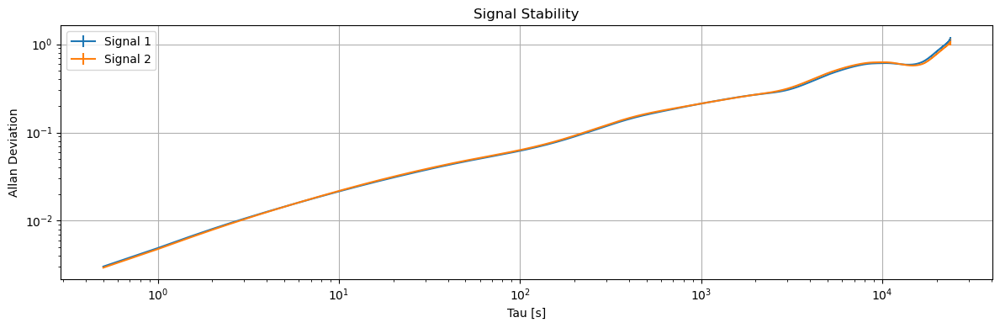

In [115]:
ds_DC_1_1345.adev(plot_adev=True);

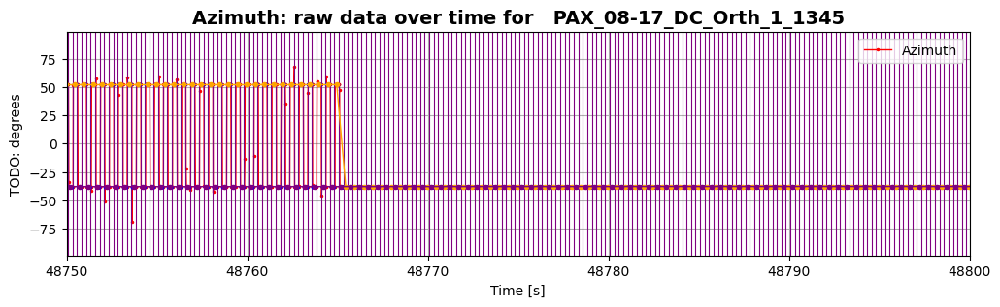

In [111]:
ds_DC_1_1345.plot_raw(birds_eye=False,sample_range=(48750,48800),plot_switch=True,plot_valid=True,plot_avg=True)

In [ ]:
filepath_ARL_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
ds_ARL_1_1345 = SwitchSet(filepath_ARL_1_1345,set_range=(500,None))
ds_ARL_1_1345.find_switches(nominal_switch_rate=2, change_point_range_1=(550,650), change_point_range_2=(3000,3050),print_process=True)
ds_ARL_1_1345.average_data(print_process=True)
ds_ARL_1_1345.adev(plot_adev=True);

## Great Circle Metric

#### Testing

In [214]:
# TODO: ax.grid() for both plot parameters

In [31]:
filepath_temp='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_temp = SwitchSet(filepath_temp,set_range=(0.05,0.15))

Time range: min=2439.848, max=7306.779


=== performing change point detection ===
cp range: (2500.0, 2600.0)
using 7169 data entries
skipping 4327 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7169,)
computing range... ---> range = (0.17,0.23)
displaying jump_fig for switch parameter = s1



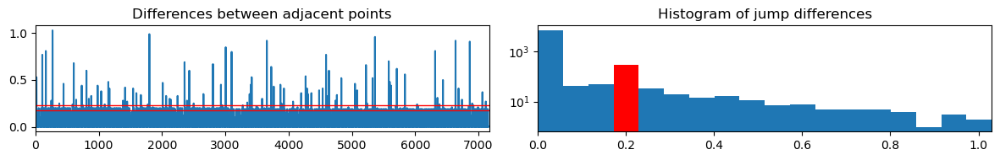



found width of 0.057 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7169,)
computing range... ---> range = (1.94,2.00)
displaying jump_fig for switch parameter = s2



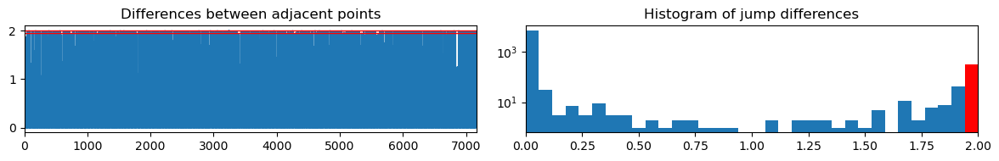



found width of 0.059 for s2
greater than prev width of 0.057 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7169,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s3



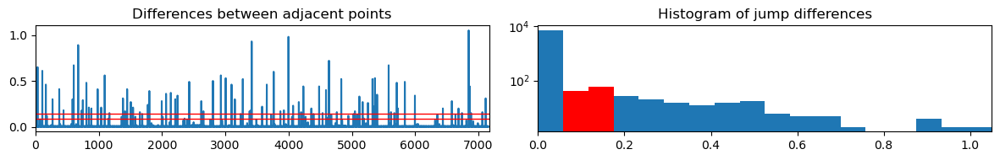



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.94,2.00)
Jump points detected: 313
out of total: ~399.9

computing offset...


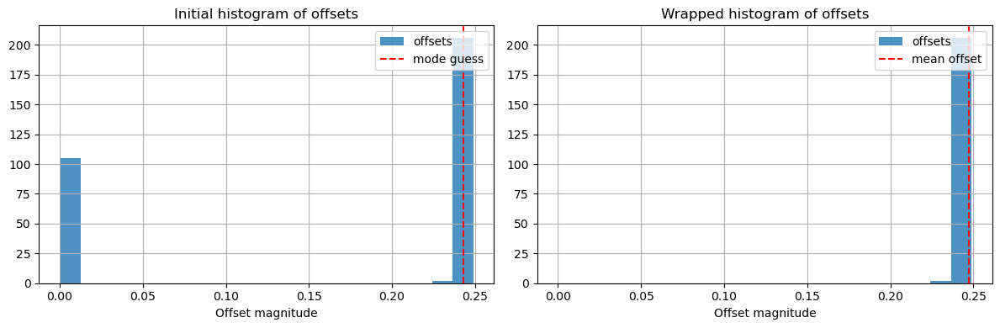



offset = 0.247 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (6000.0, 6100.0)
using 7184 data entries
skipping 254317 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7184,)
computing range... ---> range = (0.17,0.23)
displaying jump_fig for switch parameter = s1



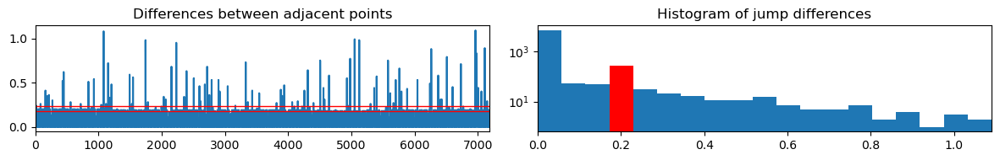



found width of 0.057 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7184,)
computing range... ---> range = (1.94,2.00)
displaying jump_fig for switch parameter = s2



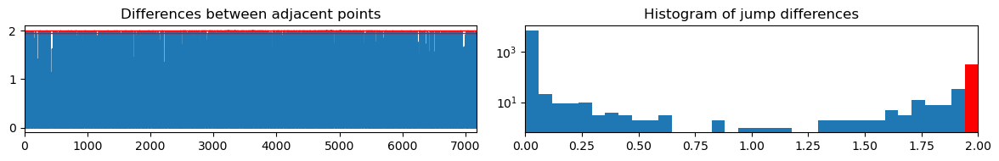



found width of 0.059 for s2
greater than prev width of 0.057 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7184,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s3



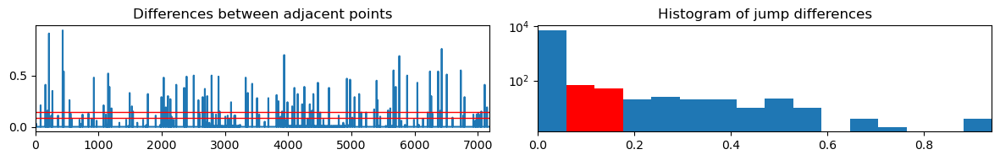



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.94,2.00)
Jump points detected: 318
out of total: ~399.9

computing offset...


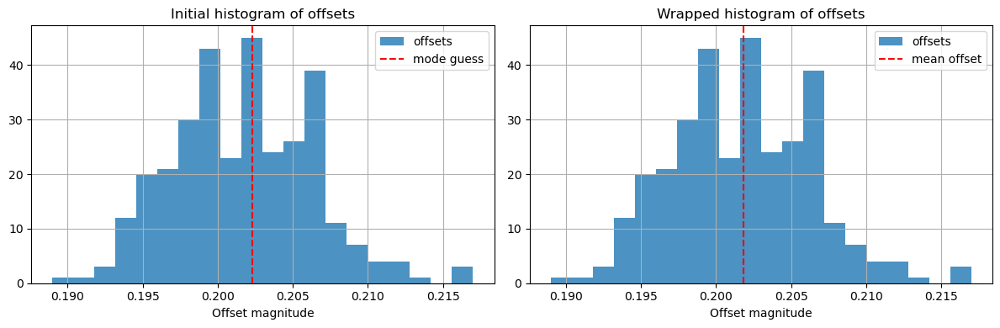



offset = 0.202 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.045 seconds over 14000.0 switches
Corrected Switch Time = 0.2499968
=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 19467 observations)

--- interpolating data ---
length before: 9734
length after: 9734
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 9733
length after: 9733
0 total added
--- end interpolating data ---
Signal 1 size=9733	Signal 1 range: t=(2440.37,7306.31)
Signal 2 size=9734	Signal 2 range: t=(2440.12,7306.56)
=== end average_data ===


In [32]:
ds_temp.find_switches(nominal_switch_rate=2, change_point_range_1=(2500,2600), change_point_range_2=(6000,6100), print_process=True)
ds_temp.average_data(print_process=True)

In [18]:
s1, s2 = ds_temp.first_stokes()
s1

[0.13488181818181819, -1.3066363636363636, 0.0912618181818182]

In [19]:
s3, s4 = ds_temp.average_stokes()
s3

[0.1247180188634663, -1.3087391489519469, 0.09136231106319524]

In [28]:
def dist_metric(stokes_1, stokes_2):
    dot = np.dot(stokes_1, stokes_2)
    cos_value = dot / (np.linalg.norm(stokes_1) * np.linalg.norm(stokes_2))
    return 1-cos_value

In [29]:
dist_metric(s1, s1)

0.0

In [22]:
np.dot(s1[1:4], s1[1:4])

1.7156273062347105

In [33]:
ds_temp.calc_transfer(input_stokes='first')

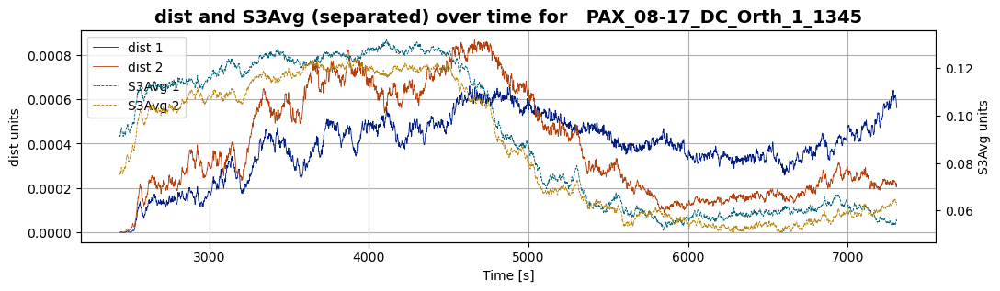

In [34]:
ds_temp.plot_separated(plot_param='dist', plot_param_2='S3Avg')

### Preliminary test on DC Switching dataset

In [11]:
plt.ioff();

In [35]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_DC_1_1345 = SwitchSet(filepath_DC_1_1345,set_range=(0.05,0.75))

Time range: min=2439.848, max=36693.33


=== performing change point detection ===
cp range: (2500.0, 2600.0)
using 7169 data entries
skipping 4327 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7169,)
computing range... ---> range = (0.17,0.23)
displaying jump_fig for switch parameter = s1



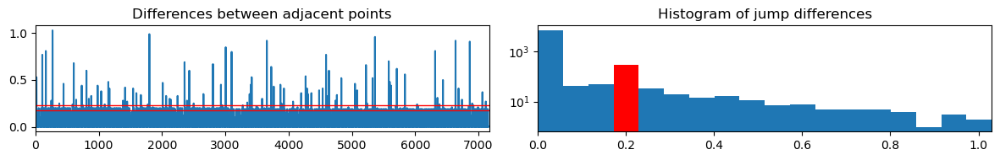



found width of 0.057 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7169,)
computing range... ---> range = (1.94,2.00)
displaying jump_fig for switch parameter = s2



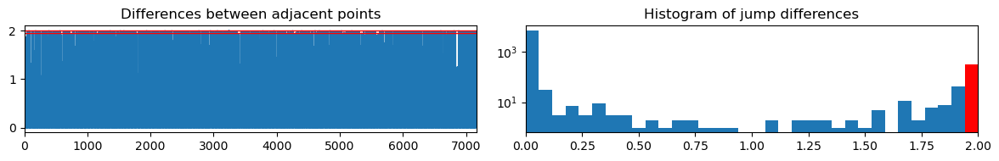



found width of 0.059 for s2
greater than prev width of 0.057 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7169,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s3



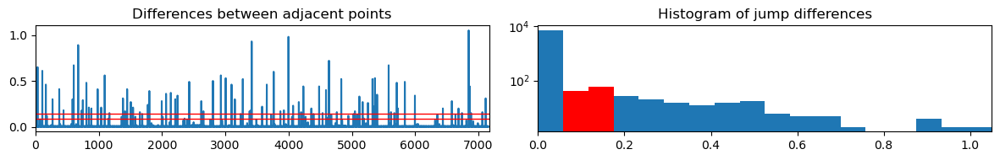



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.94,2.00)
Jump points detected: 313
out of total: ~399.9

computing offset...


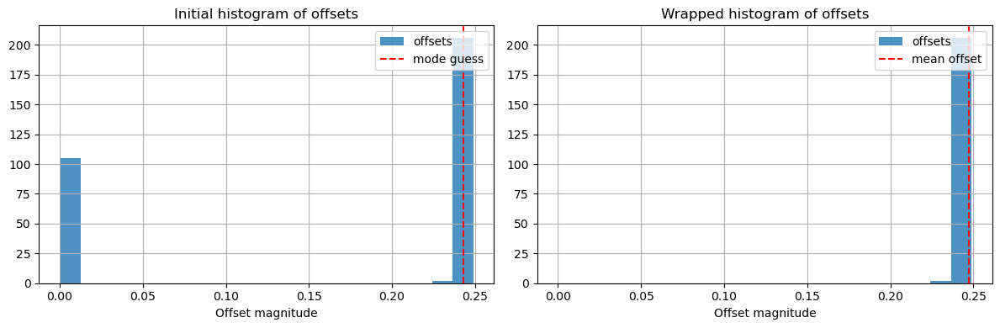



offset = 0.247 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (6000.0, 6100.0)
using 7184 data entries
skipping 254317 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7184,)
computing range... ---> range = (0.17,0.23)
displaying jump_fig for switch parameter = s1



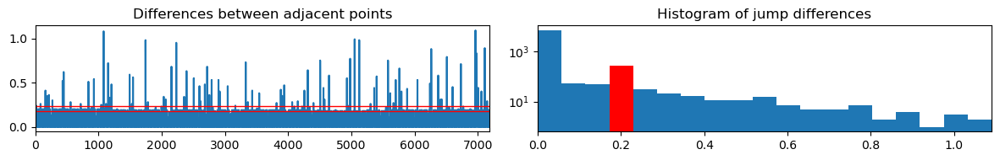



found width of 0.057 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7184,)
computing range... ---> range = (1.94,2.00)
displaying jump_fig for switch parameter = s2



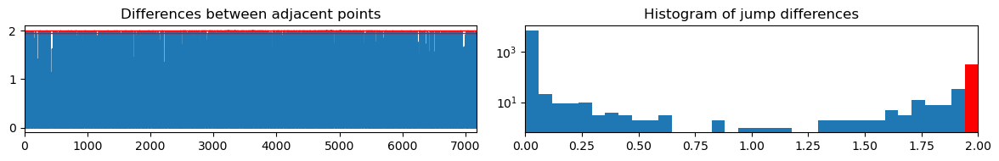



found width of 0.059 for s2
greater than prev width of 0.057 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7184,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s3



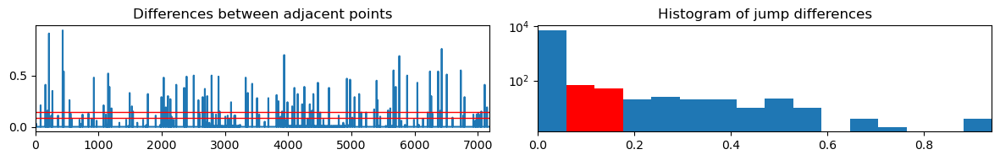



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.94,2.00)
Jump points detected: 318
out of total: ~399.9

computing offset...


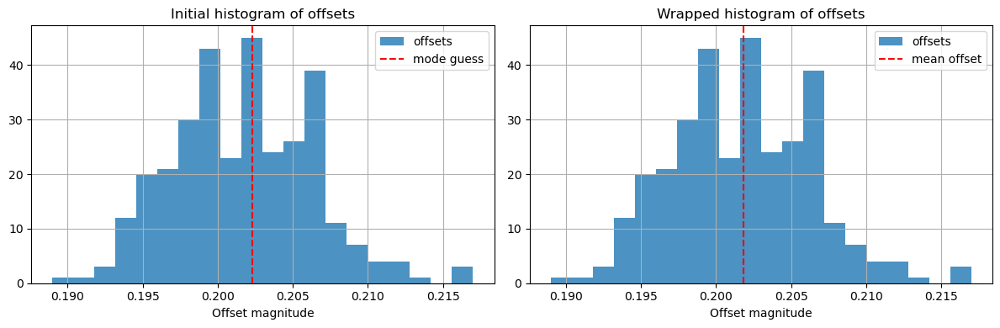



offset = 0.202 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.045 seconds over 14000.0 switches
Corrected Switch Time = 0.2499968
=== starting average_data ===
averaging data... Done
Dropped 105 observations with <4 points (out of total 136923 observations)

--- interpolating data ---
length before: 68419
length after: 68507
88 total added
--- end interpolating data ---

--- interpolating data ---
length before: 68399
length after: 68507
108 total added
--- end interpolating data ---
Signal 1 size=68507	Signal 1 range: t=(2440.37,36692.93)
Signal 2 size=68507	Signal 2 range: t=(2440.12,36692.68)
=== end average_data ===


In [36]:
ds_DC_1_1345.find_switches(nominal_switch_rate=2, change_point_range_1=(2500,2600), change_point_range_2=(6000,6100), print_process=True)
ds_DC_1_1345.average_data(print_process=True)

In [37]:
ds_DC_1_1345.calc_transfer(input_stokes='first')

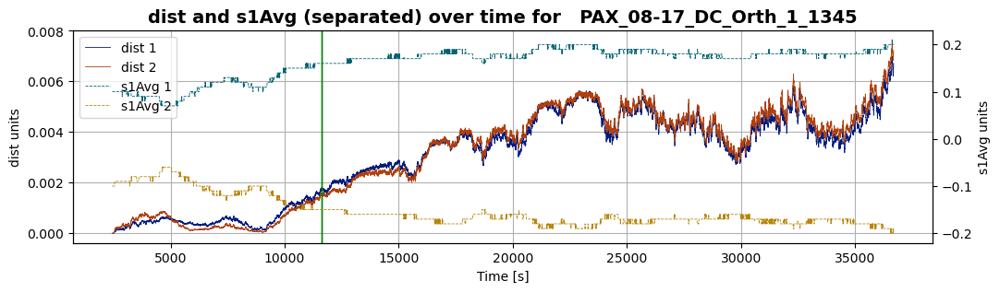

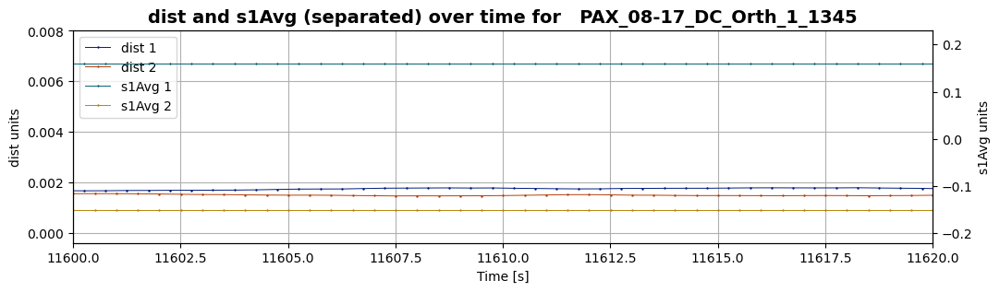

In [45]:
ds_DC_1_1345.plot_separated(plot_param='dist', plot_param_2='s1Avg', sample_range=(11600,11620))

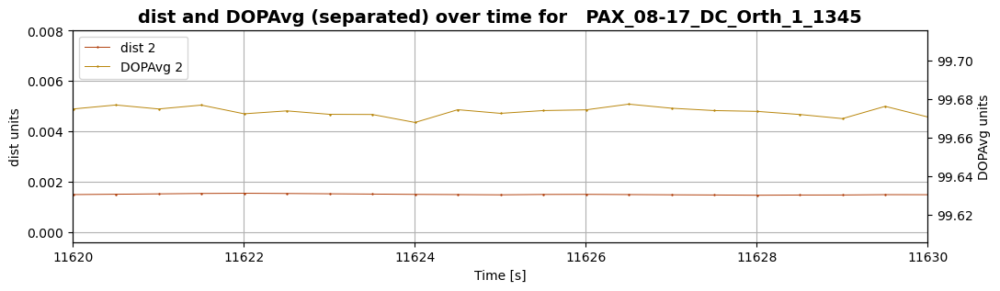

In [40]:
ds_DC_1_1345.plot_separated(birds_eye=False, plot_param='dist', plot_param_2='DOPAvg', sample_range=(11620,11630), plot_signal=2)

Number of taus used for signal 1: 2394
Number of taus used for signal 2: 2394


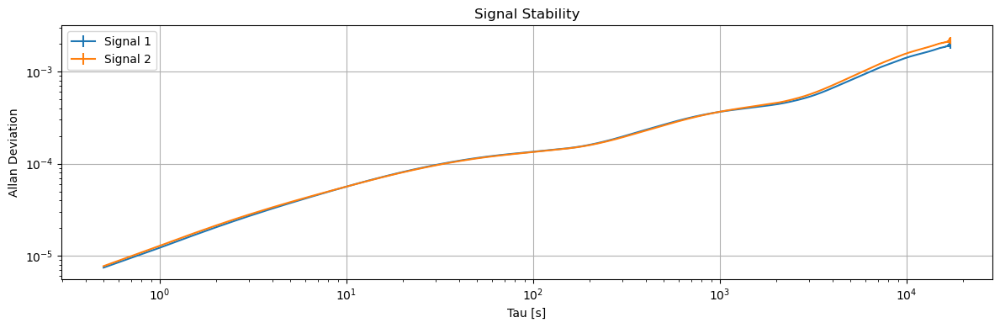

In [41]:
ds_DC_1_1345.adev(plot_param='dist', plot_adev=True);

### DOP Investigation (discontinued)

In [ ]:
filepath_DC_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_1_1345.csv'
ds_DC_1_1345 = SwitchSet(filepath_DC_1_1345,set_range=(0.05,0.35))

In [ ]:
ds_DC_1_1345.find_switches(nominal_switch_rate=2, change_point_range_1=(2500,2600), print_process=True)
ds_DC_1_1345.average_data(print_process=True)
ds_DC_1_1345.calc_transfer(input_stokes='first')

In [254]:
df_raw = ds_DC_1_1345.df

In [256]:
df_raw[['TimeElapsed','S0','S1','S2','S3','DOP','s1','s2','s3','Power']].head()

,TimeElapsed,S0,S1,S2,S3,DOP,s1,s2,s3,Power
0,2439.848,1.31,0.1345,-1.305,0.09144,100.35,0.1,-0.99,0.07,1.31
1,2439.858,1.31,0.1346,-1.305,0.09127,100.34,0.1,-0.99,0.07,1.31
2,2439.878,1.31,0.1345,-1.305,0.09102,100.33,0.1,-0.99,0.07,1.31
3,2439.888,1.31,0.1344,-1.305,0.09130,100.35,0.1,-0.99,0.07,1.31
4,2439.918,1.31,0.1346,-1.305,0.09135,100.34,0.1,-0.99,0.07,1.31


In [179]:
df = ds_DC_1_1345.signal_1_df

In [180]:
df[['EstTime','S0Avg','S1Avg','S2Avg','S3Avg','DOPAvg','s1Avg','s2Avg','s3Avg','PowerAvg']].head()

,EstTime,S0Avg,S1Avg,S2Avg,S3Avg,DOPAvg,s1Avg,s2Avg,s3Avg,PowerAvg
0,2440.373677,1.312,0.134882,-1.306636,0.091262,100.344545,0.1,-0.99,0.07,1.312
1,2440.873671,1.313,0.134908,-1.307000,0.091239,100.344615,0.1,-0.99,0.07,1.313
2,2441.373664,1.313,0.134527,-1.307000,0.091423,100.340909,0.1,-0.99,0.07,1.313
3,2441.873658,1.312,0.134060,-1.306133,0.091739,100.346667,0.1,-0.99,0.07,1.312
4,2442.373651,1.311,0.133840,-1.306000,0.091794,100.345000,0.1,-0.99,0.07,1.311


In [181]:
min_cutoff = 101
frac = len(df[df['DOPAvg']>min_cutoff]) / len(df)
print('Fraction of DOP values greater than {:d}: {:.5f} ({:.3f}%)'.format(min_cutoff,frac,frac*100))

Fraction of DOP values greater than 101: 0.00000 (0.000%)


In [183]:
max_cutoff = 99
frac = len(df[df['DOPAvg']<max_cutoff]) / len(df)
print('Fraction of DOP values less than {:d}: {:.5f} ({:.3f}%)'.format(max_cutoff,frac,frac*100))

Fraction of DOP values less than 99: 0.00000 (0.000%)


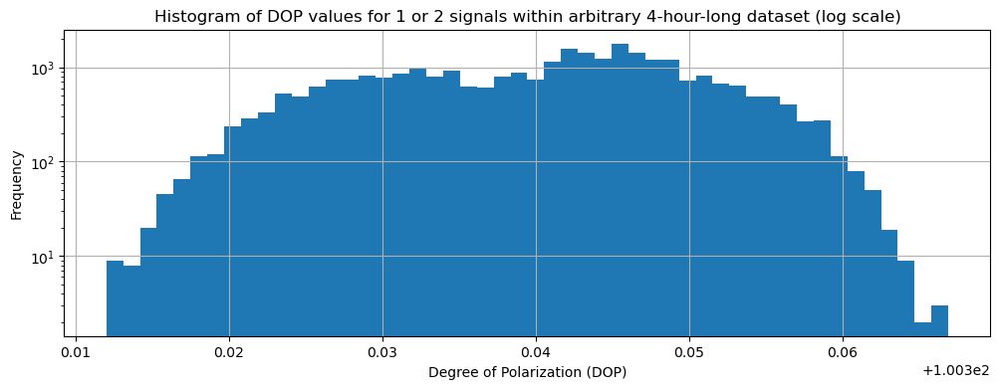

In [187]:
plt.ion()
plt.figure(figsize=(12,4))
plt.hist(df['DOPAvg'], bins=50, log=True)
plt.xlabel('Degree of Polarization (DOP)')
plt.ylabel('Frequency')
plt.title('Histogram of DOP values for 1 or 2 signals within arbitrary 4-hour-long dataset (log scale)')
plt.grid()
plt.show()

In [188]:
df[df['DOPAvg']>cutoff][['EstTime','S0Avg','S1Avg','S2Avg','S3Avg','DOPAvg','s1Avg','s2Avg','s3Avg','PowerAvg']].head(8)

,EstTime,S0Avg,S1Avg,S2Avg,S3Avg,DOPAvg,s1Avg,s2Avg,s3Avg,PowerAvg


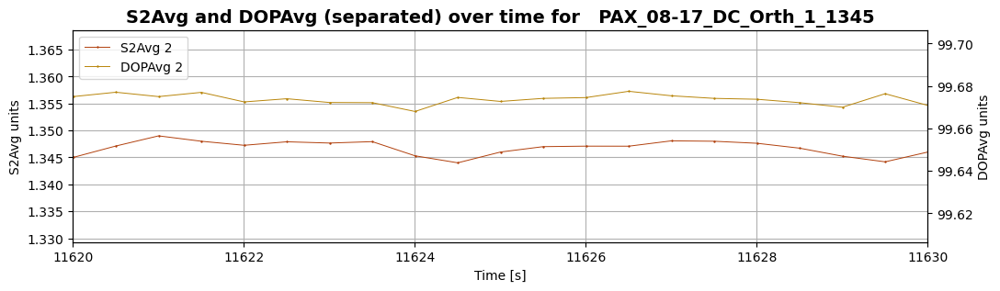

In [192]:
plt.ioff()
ds_DC_1_1345.plot_separated(birds_eye=False, plot_param='S2Avg', plot_param_2='DOPAvg', sample_range=(11620,11630), plot_signal=2)

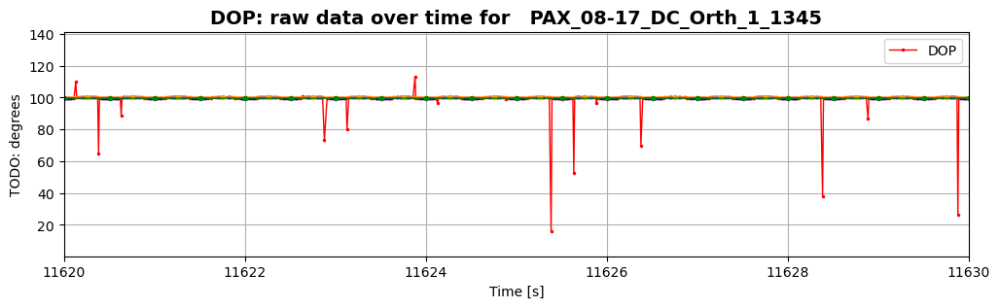

In [193]:
ds_DC_1_1345.plot_raw(birds_eye=False, plot_param='DOP', plot_valid=True, plot_avg=True, sample_range=(11620,11630))

### Use on ARL Switching dataset

In [9]:
plt.ioff();
plt.close('all');

In [10]:
filepath_ARL_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
ds_ARL_1_1345 = SwitchSet(filepath_ARL_1_1345,set_range=(0,0.05), skip_default_signal_baseline=600)

Time range: min=600.017, max=2236.844


Determining change point ranges automatically...
Using change_point_range_1=(600.017, 700.017)
Using change_point_range_2=(2136.844, 2236.844)
=== performing change point detection ===
cp range: (600.017, 700.017)
using 6437 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6437,)
computing range... ---> range = (0.88,0.93)
displaying jump_fig for switch parameter = s1



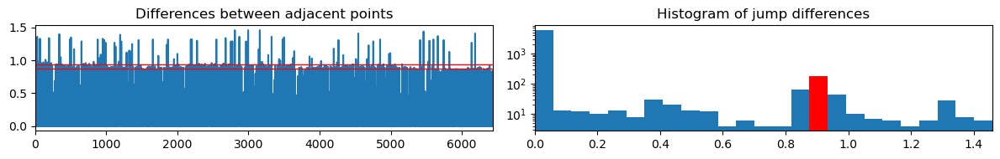



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6437,)
computing range... ---> range = (0.11,0.17)
displaying jump_fig for switch parameter = s2



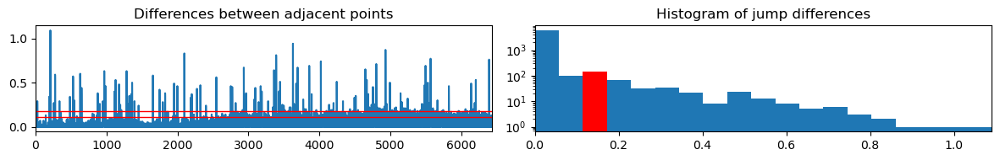



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6437,)
computing range... ---> range = (1.71,1.77)
displaying jump_fig for switch parameter = s3



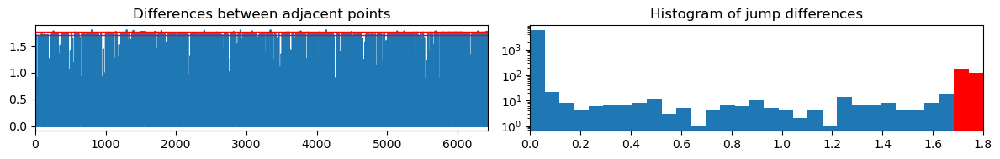



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.88,0.93)
Jump points detected: 183
out of total: ~400.0

computing offset...


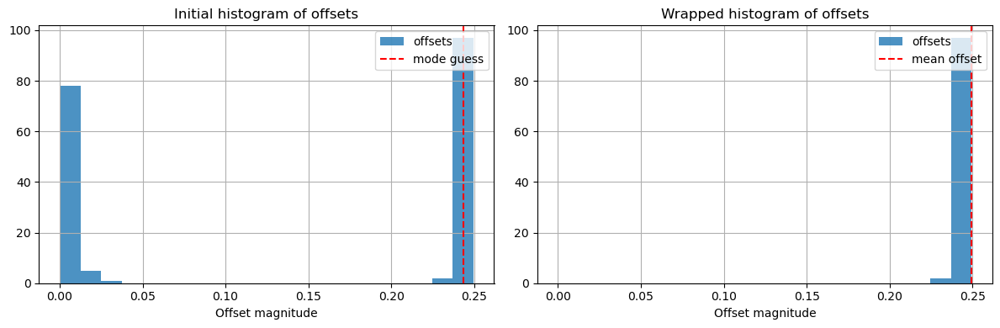



offset = 0.249 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (2136.844, 2236.844)
using 6747 data entries
skipping 102812 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6747,)
computing range... ---> range = (0.44,0.49)
displaying jump_fig for switch parameter = s1



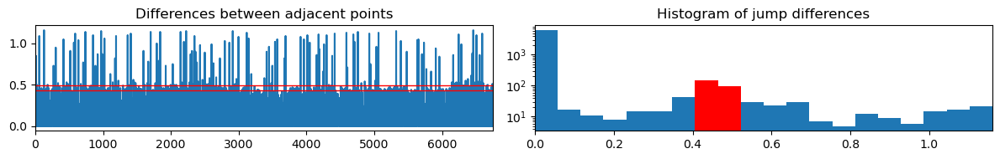



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6747,)
computing range... ---> range = (0.14,0.20)
displaying jump_fig for switch parameter = s2



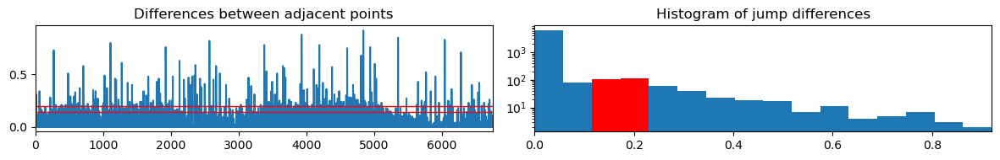



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6747,)
computing range... ---> range = (1.87,1.93)
displaying jump_fig for switch parameter = s3



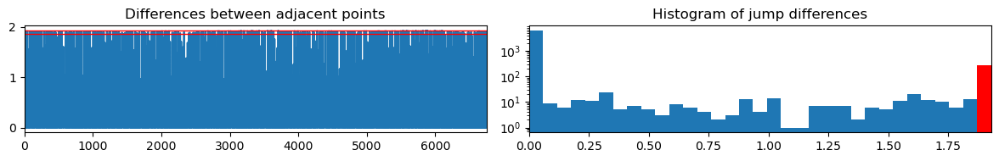



found width of 0.058 for s3
greater than prev width of 0.058 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.87,1.93)
Jump points detected: 273
out of total: ~400.0

computing offset...


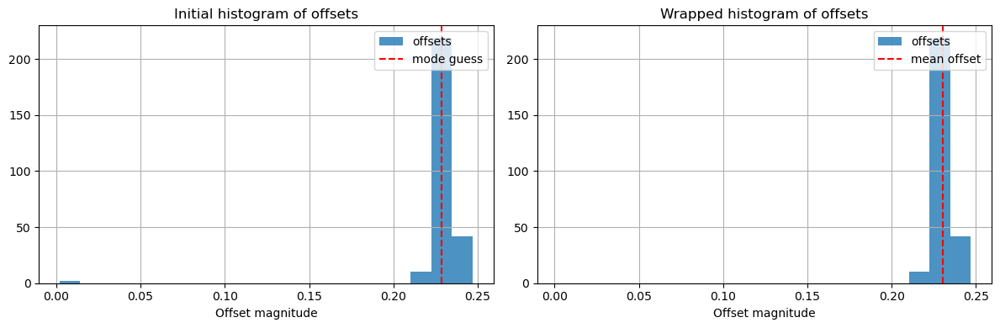



offset = 0.230 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.019 seconds over 6147.308 switches
Corrected Switch Time = 0.2499969
=== starting average_data ===
averaging data... Done
Dropped 5 observations with <4 points (out of total 6510 observations)

--- interpolating data ---
length before: 3254
length after: 3273
19 total added
--- end interpolating data ---

--- interpolating data ---
length before: 3251
length after: 3273
22 total added
--- end interpolating data ---
Signal 1 size=3273	Signal 1 range: t=(600.38,2236.35)
Signal 2 size=3273	Signal 2 range: t=(600.63,2236.60)
=== end average_data ===


In [11]:
ds_ARL_1_1345.find_switches(nominal_switch_rate=2, print_process=True)
ds_ARL_1_1345.average_data(print_process=True)

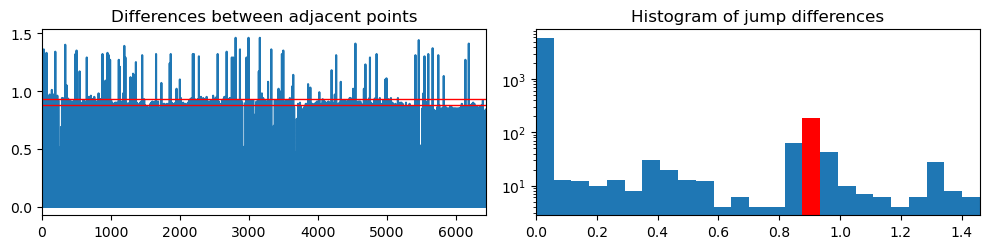

In [78]:
f1.set_size_inches(10,2.6)
for ax in ZI_fig.get_axes():
    ax.set_title(ax.get_title(), fontsize=14, fontweight='bold')
f1.tight_layout()
display(f1); plt.close(f1)
f1.savefig('CP_hist.png')

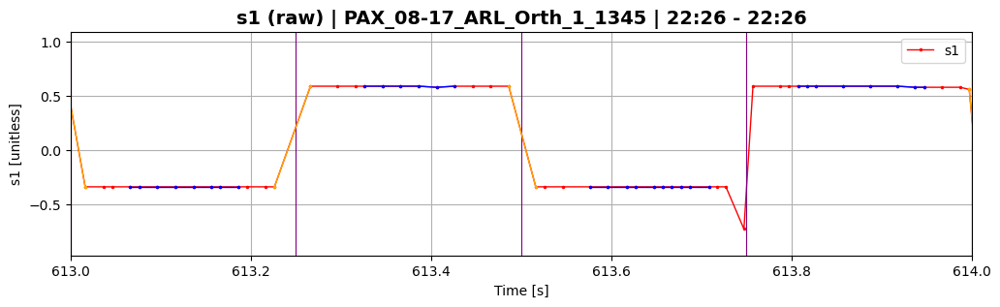

In [98]:
ds_ARL_1_1345.plot_raw(sample_range=(613,614), birds_eye=False, plot_switch=True, plot_valid=True, plot_jumps=True)

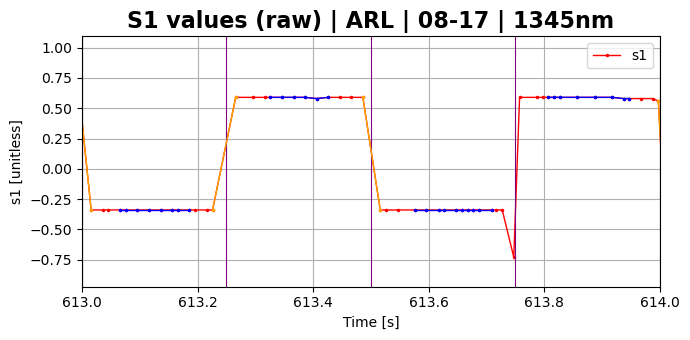

In [72]:
ZI_fig.set_size_inches(7,3.5)
ax = ZI_fig.gca()
ax.set_title('S1 values (raw) | ARL | 08-17 | 1345nm', fontsize=16, fontweight='bold')
ZI_fig.tight_layout()
display(ZI_fig); plt.close(ZI_fig)
ZI_fig.savefig('CP_Segment.png')

In [99]:
ds_ARL_1_1345.calc_similarity(input_stokes='first')

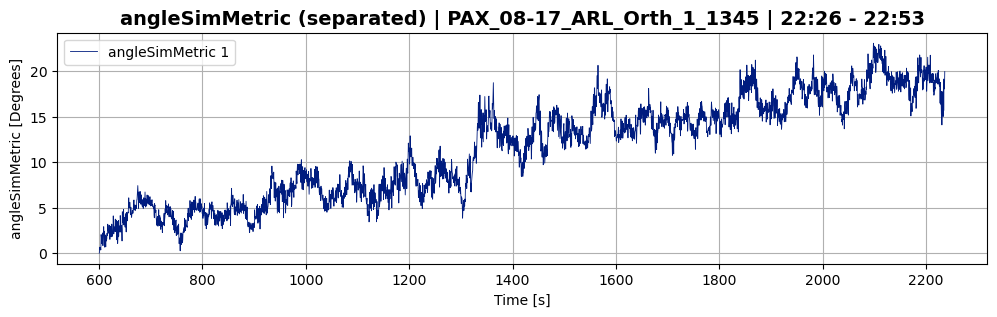

In [100]:
ds_ARL_1_1345.plot_separated(plot_param='angleSimMetric', plot_signal=1)

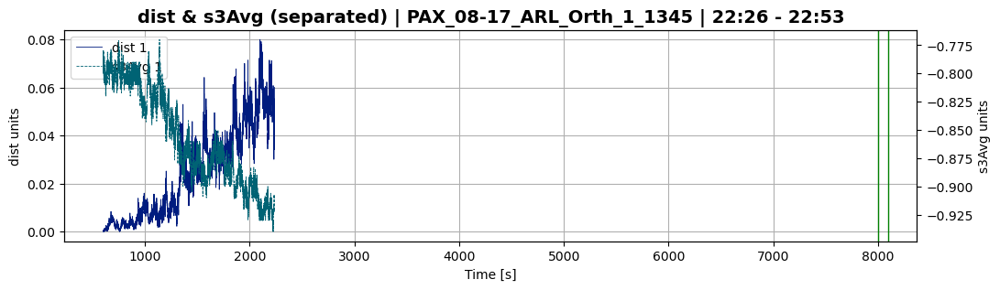

KeyError: nan

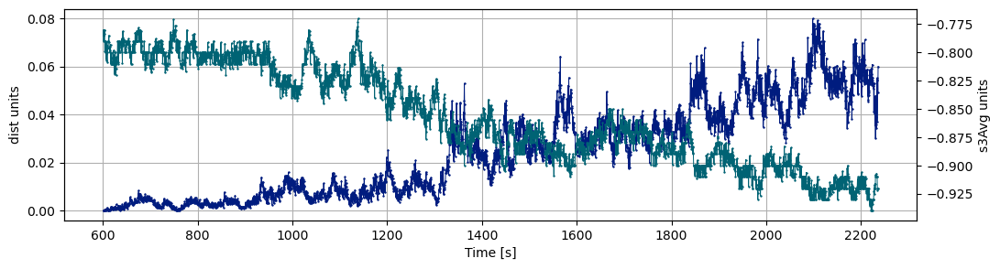

In [96]:
ds_ARL_1_1345.plot_separated(plot_param='dist', plot_param_2='s3Avg', sample_range=(8000,8100), plot_signal=1)

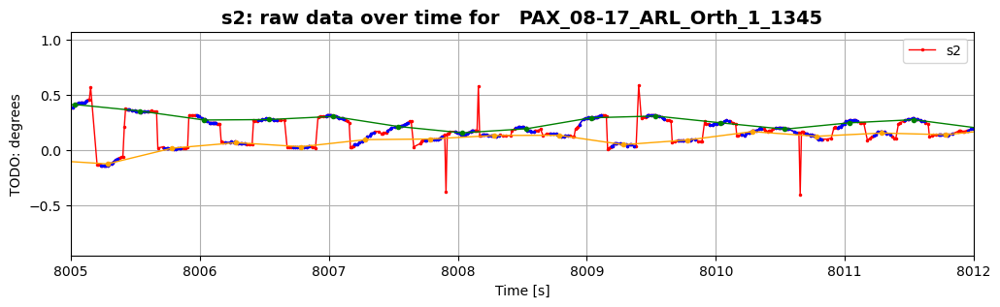

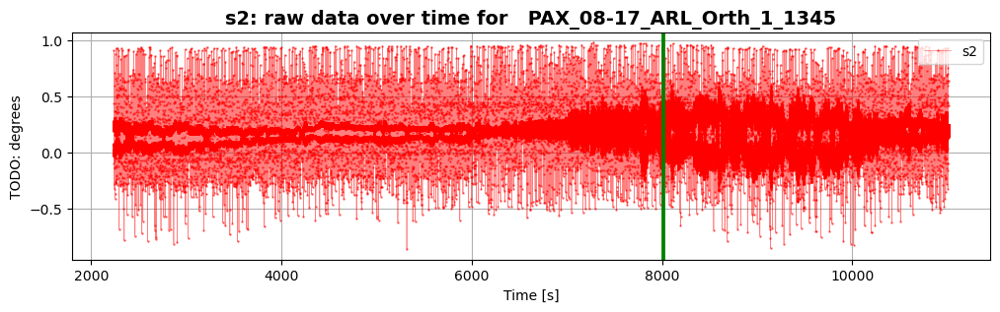

In [12]:
ds_ARL_1_1345.plot_raw(birds_eye=False, plot_param='s2', sample_range=(8005,8012), plot_valid=True, plot_avg=True)

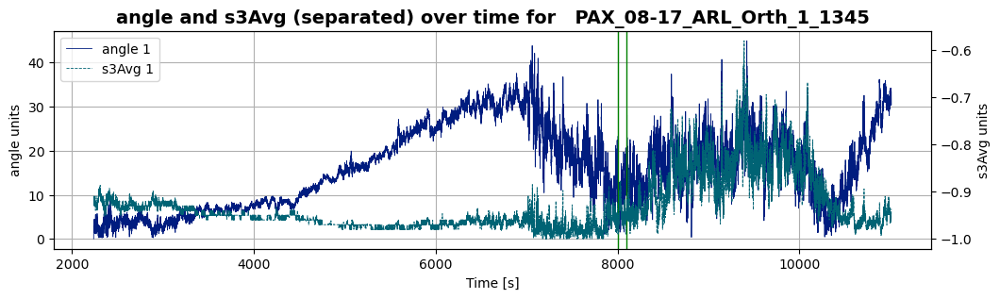

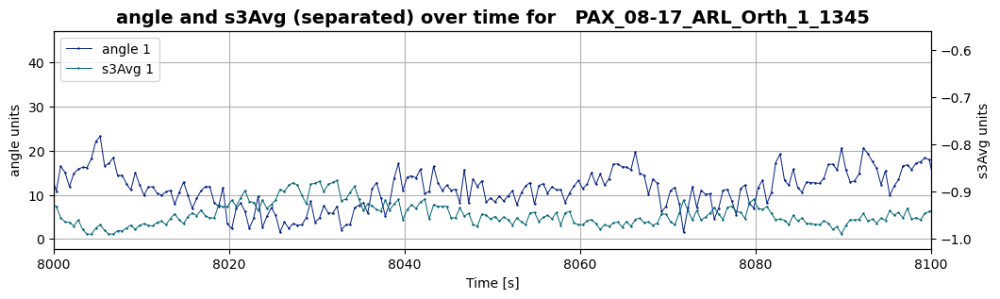

In [17]:
ds_ARL_1_1345.plot_separated(plot_param='angle', plot_param_2='s3Avg', sample_range=(8000,8100), plot_signal=1)

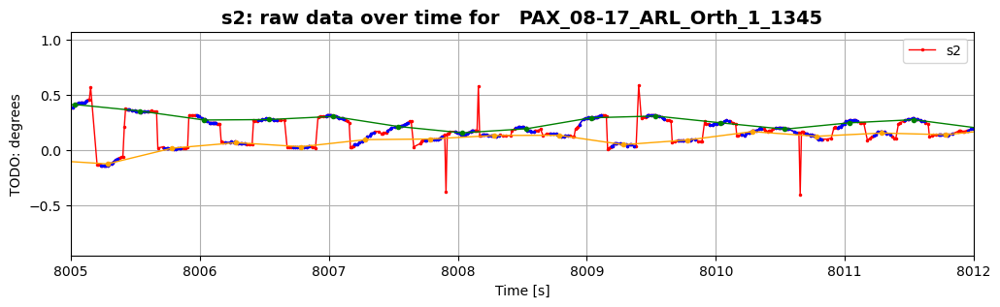

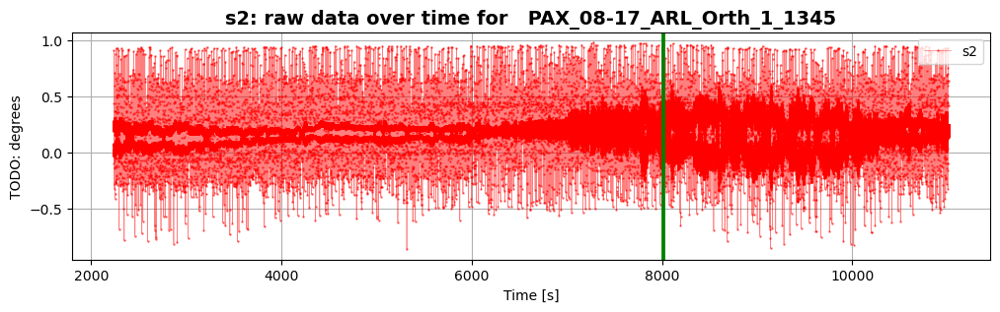

In [12]:
ds_ARL_1_1345.plot_raw(birds_eye=False, plot_param='s2', sample_range=(8005,8012), plot_valid=True, plot_avg=True)

In [101]:
ds_ARL_1_1345.adev(plot_param='angle', plot_adev=True)

TypeError: 'NoneType' object is not subscriptable

### Small portion of ARL switching dataset for allan dev

In [46]:
filepath_ARL_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
ds_temp = SwitchSet(filepath_ARL_1_1345,set_range=(0.05,0.1))

Time range: min=2236.844, max=4425.925


Determining change point ranges automatically...
Using change_point_range_1=(2236.844, 2336.844)
Using change_point_range_2=(4325.925, 4425.925)
=== performing change point detection ===
cp range: (2236.844, 2336.844)
using 6767 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6767,)
computing range... ---> range = (0.44,0.50)
displaying jump_fig for switch parameter = s1



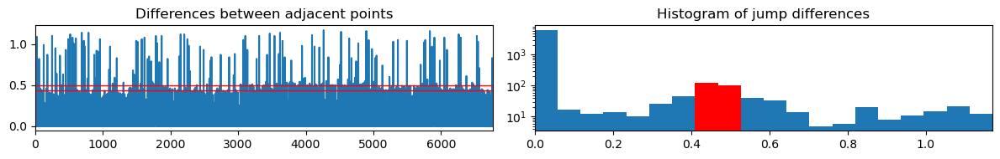



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6767,)
computing range... ---> range = (0.14,0.20)
displaying jump_fig for switch parameter = s2



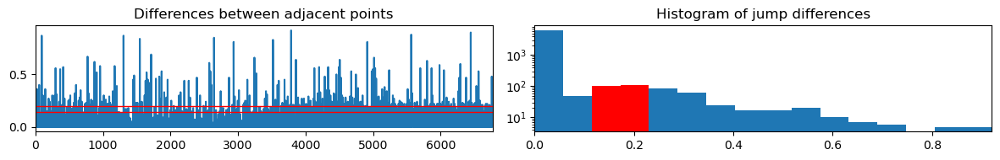



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6767,)
computing range... ---> range = (1.88,1.94)
displaying jump_fig for switch parameter = s3



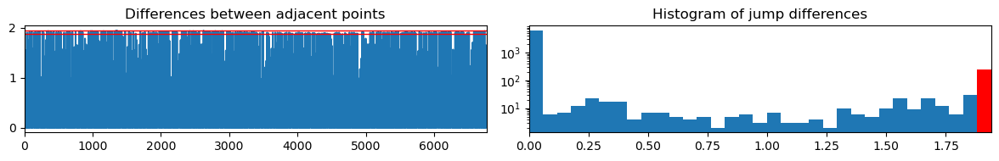



found width of 0.059 for s3
greater than prev width of 0.058 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.88,1.94)
Jump points detected: 243
out of total: ~400.0

computing offset...


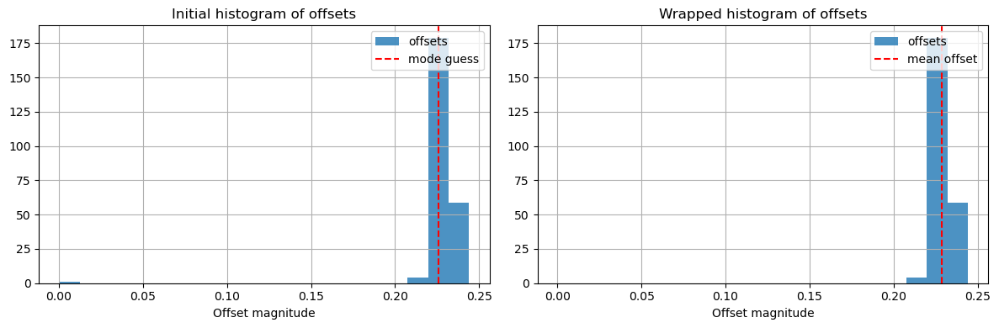



offset = 0.229 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (4325.925, 4425.925)
using 6757 data entries
skipping 140956 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6757,)
computing range... ---> range = (0.20,0.26)
displaying jump_fig for switch parameter = s1



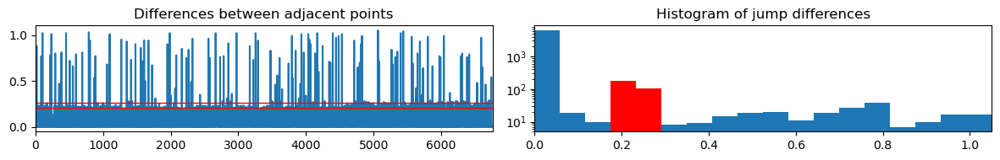



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6757,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s2



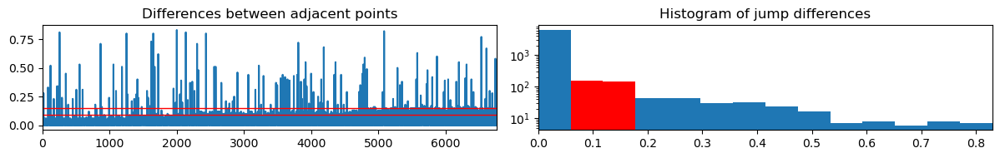



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6757,)
computing range... ---> range = (1.89,1.95)
displaying jump_fig for switch parameter = s3



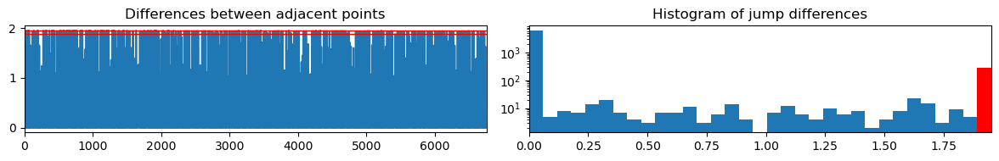



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (0.09,0.15)
Jump points detected: 161
out of total: ~399.9

computing offset...


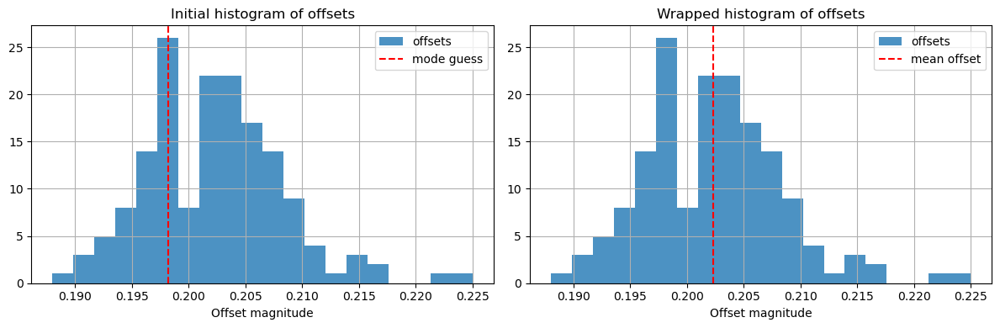



offset = 0.202 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.026 seconds over 8356.324 switches
Corrected Switch Time = 0.2499968
=== starting average_data ===
averaging data... Done
Dropped 6 observations with <4 points (out of total 8709 observations)

--- interpolating data ---
length before: 4353
length after: 4378
25 total added
--- end interpolating data ---

--- interpolating data ---
length before: 4350
length after: 4377
27 total added
--- end interpolating data ---
Signal 1 size=4377	Signal 1 range: t=(2237.35,4425.33)
Signal 2 size=4378	Signal 2 range: t=(2237.10,4425.58)
=== end average_data ===


In [47]:
ds_temp.find_switches(print_process=True)
ds_temp.average_data(print_process=True)

In [48]:
ds_temp.calc_transfer(input_stokes='first')

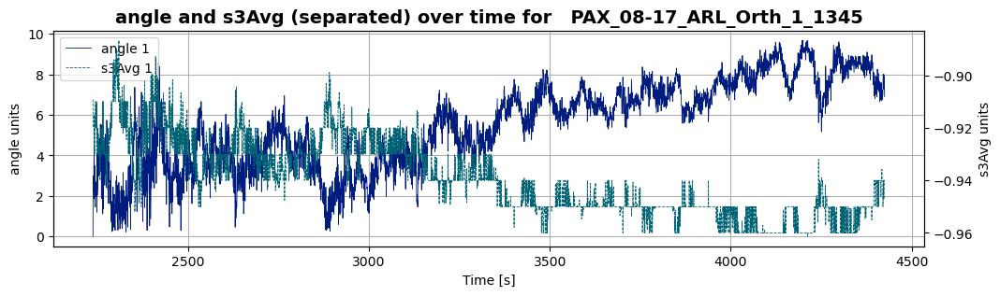

In [49]:
ds_temp.plot_separated(plot_param='angle', plot_param_2='s3Avg', plot_signal=1)

Number of taus used for signal 1: 1370
Number of taus used for signal 2: 1370


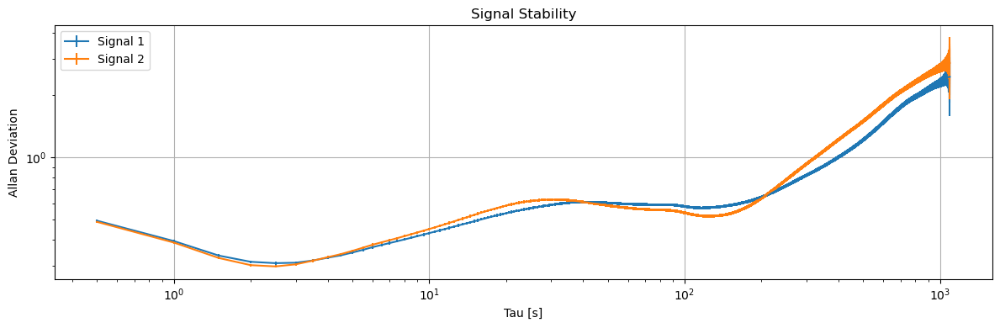

In [50]:
ds_temp.adev(plot_param='angle', plot_adev=True);

### In a loop now!

Time range: min=2236.844, max=4425.925


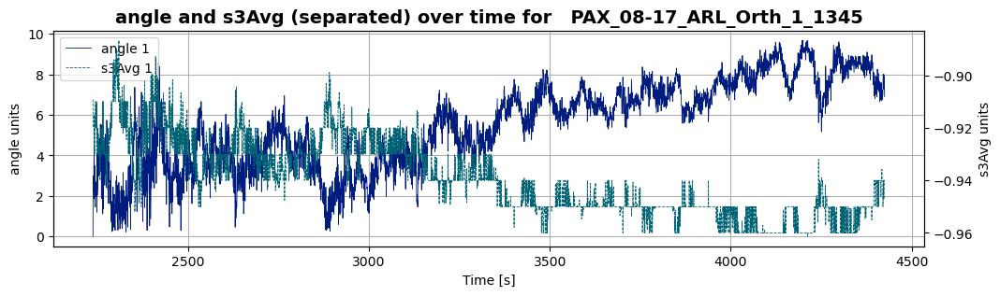

Number of taus used for signal 1: 1370
Number of taus used for signal 2: 1370


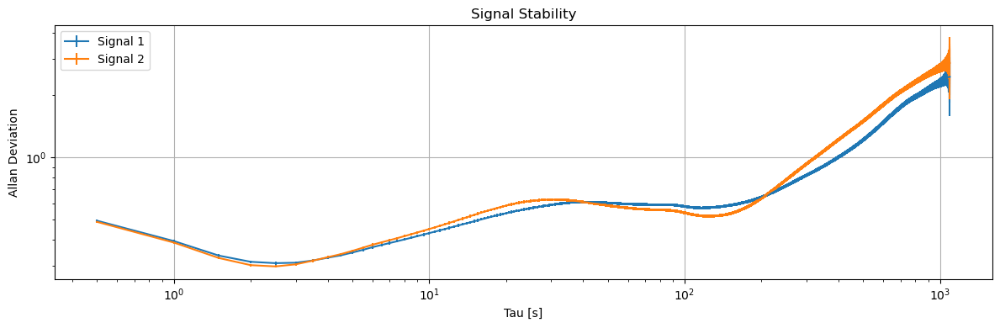

Time range: min=4425.935, max=6617.273


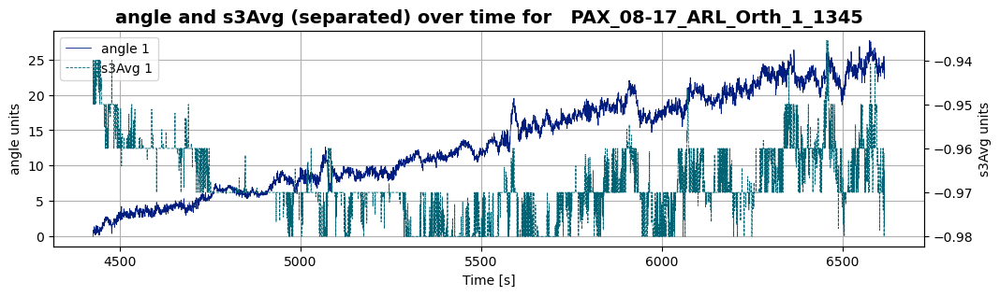

Number of taus used for signal 1: 1371
Number of taus used for signal 2: 1371


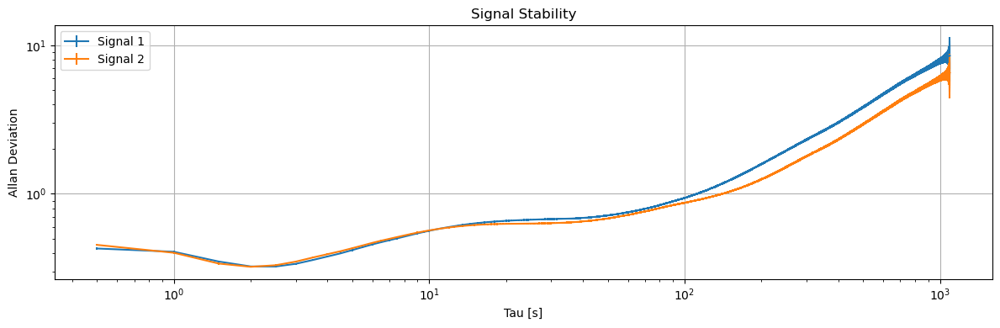

Time range: min=6617.293, max=8819.27


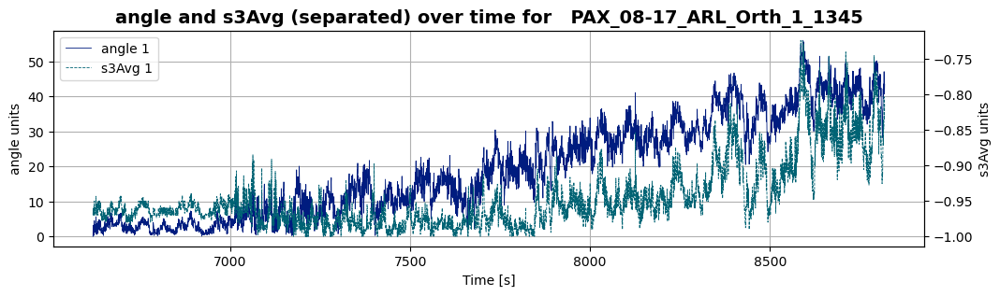

Number of taus used for signal 1: 1374
Number of taus used for signal 2: 1374


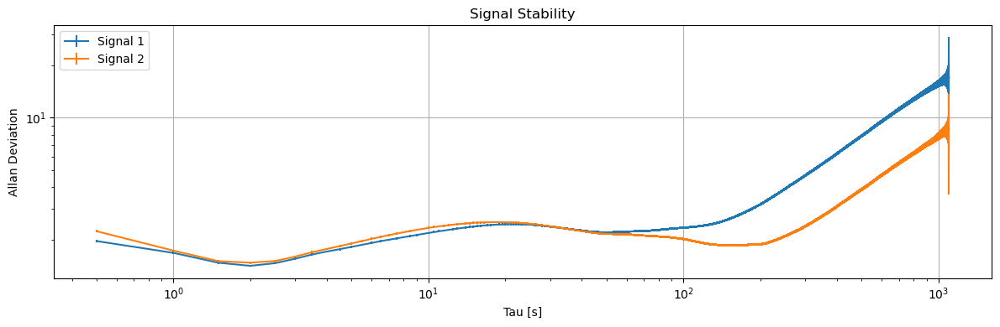

Time range: min=8819.29, max=11010.803


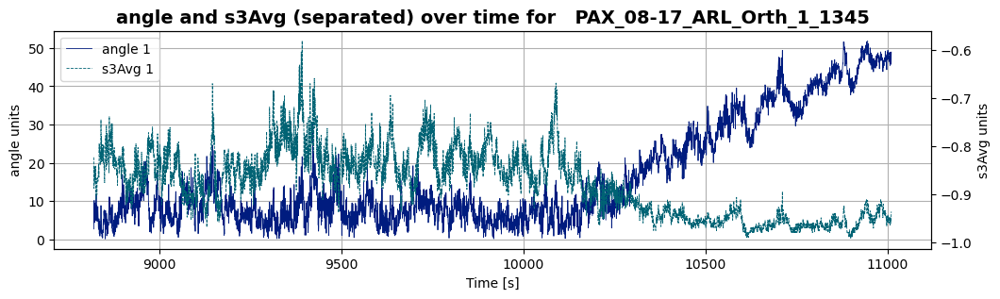

Number of taus used for signal 1: 1371
Number of taus used for signal 2: 1371


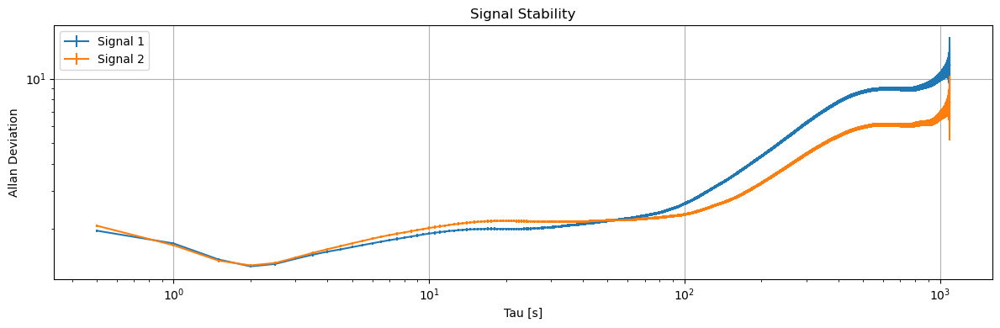

Time range: min=11010.833, max=13219.436


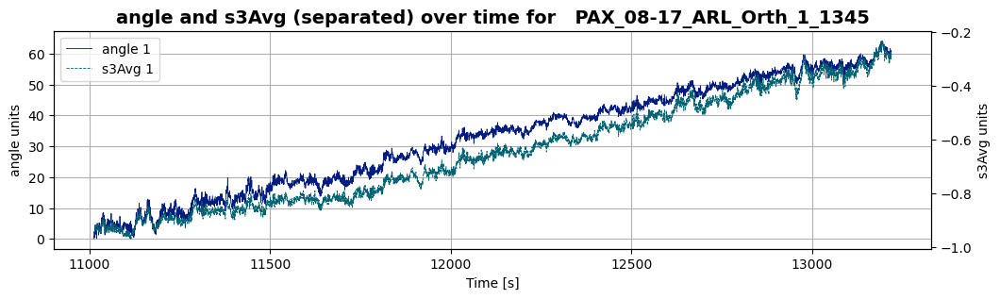

Number of taus used for signal 1: 1375
Number of taus used for signal 2: 1375


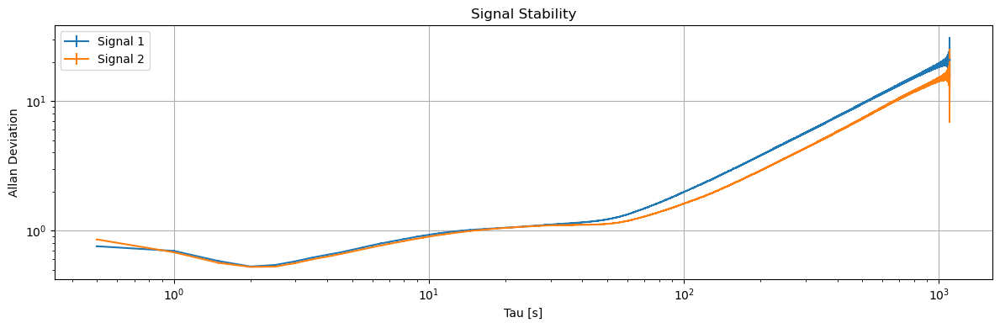

Time range: min=13219.446, max=15368.199


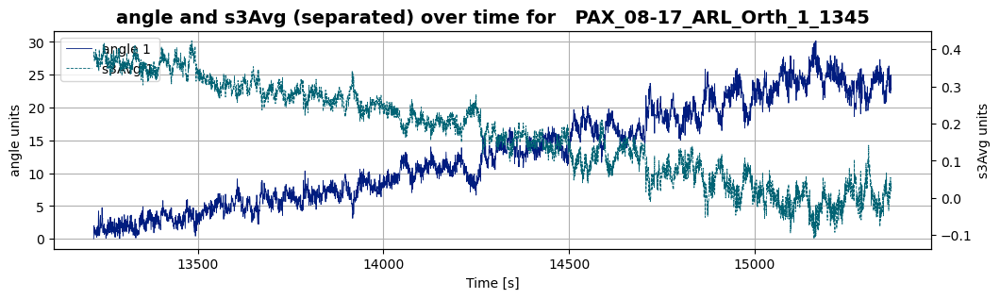

Number of taus used for signal 1: 1362
Number of taus used for signal 2: 1362


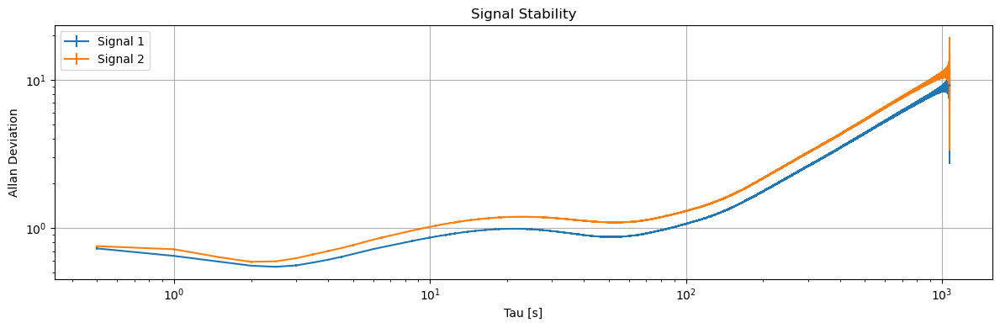

Time range: min=15368.211, max=17527.189


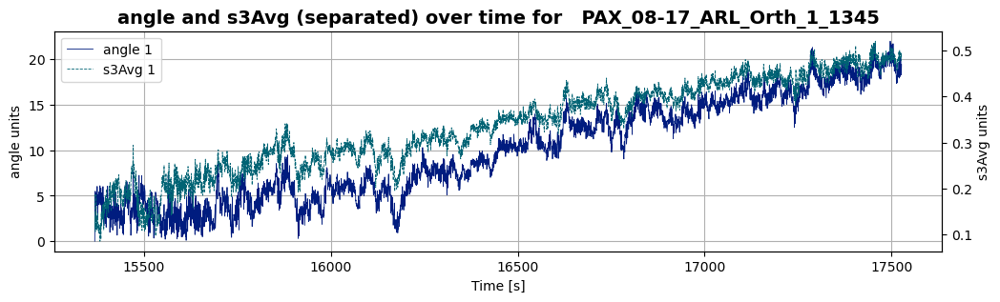

Number of taus used for signal 1: 1364
Number of taus used for signal 2: 1364


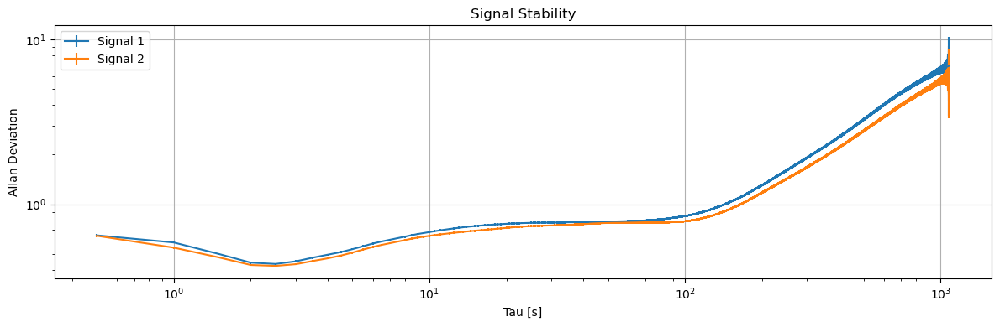

Time range: min=17527.207, max=19741.992


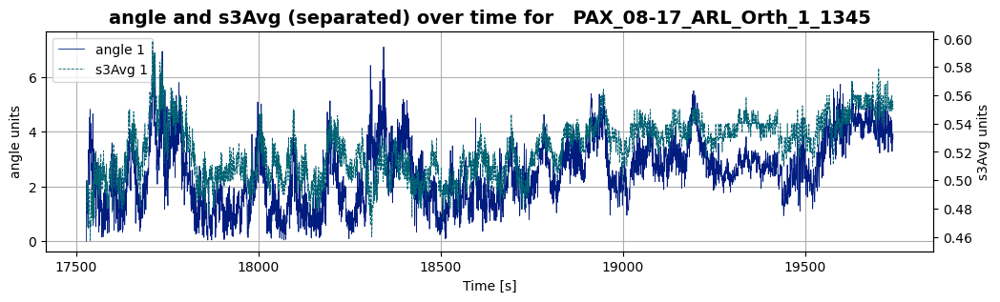

Number of taus used for signal 1: 1377
Number of taus used for signal 2: 1377


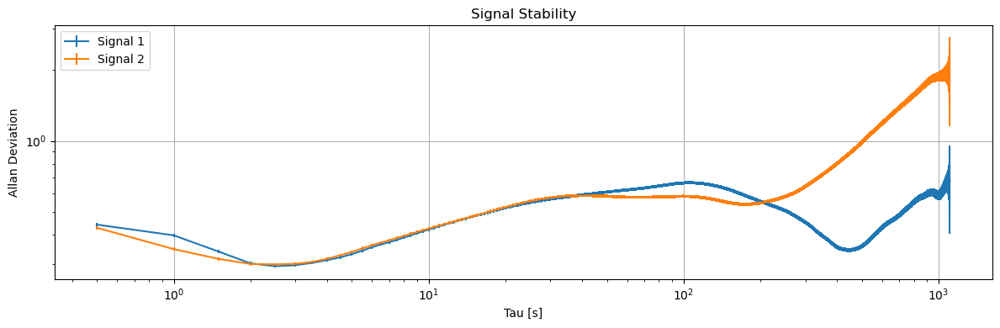

Time range: min=19742.002, max=21971.336


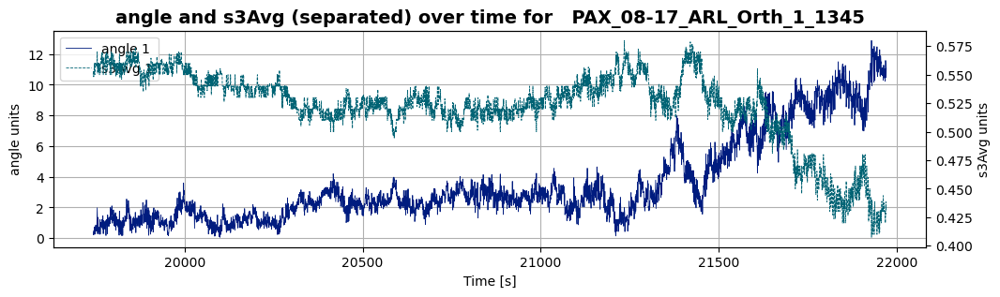

Number of taus used for signal 1: 1380
Number of taus used for signal 2: 1380


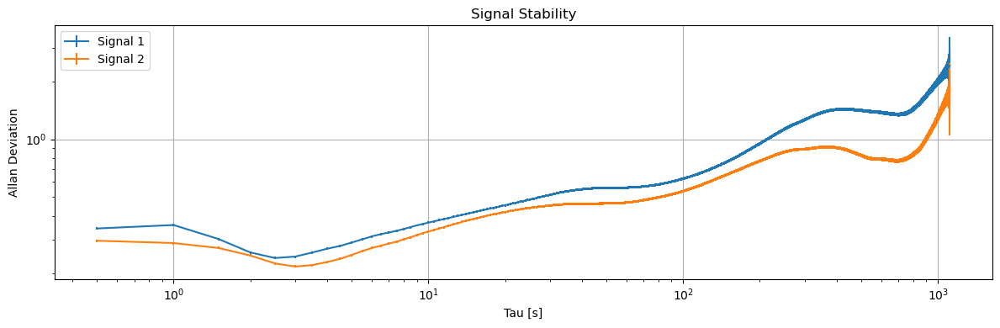

Time range: min=21971.348, max=24185.057


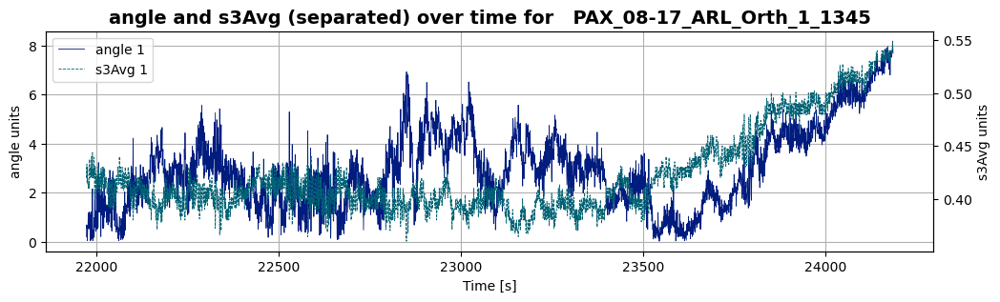

Number of taus used for signal 1: 1376
Number of taus used for signal 2: 1376


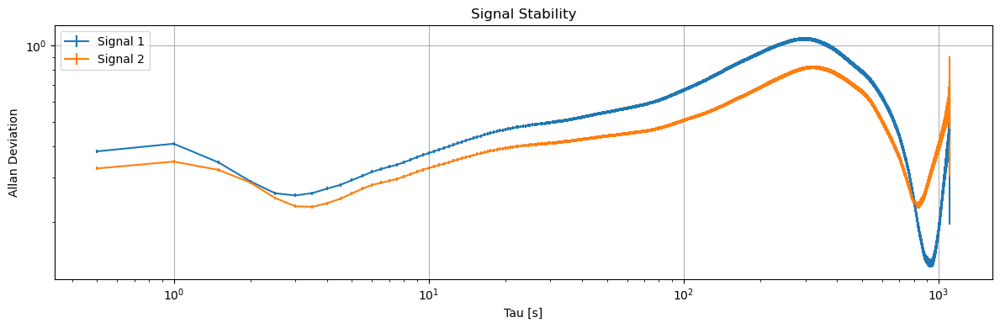

Time range: min=24185.077, max=26432.45


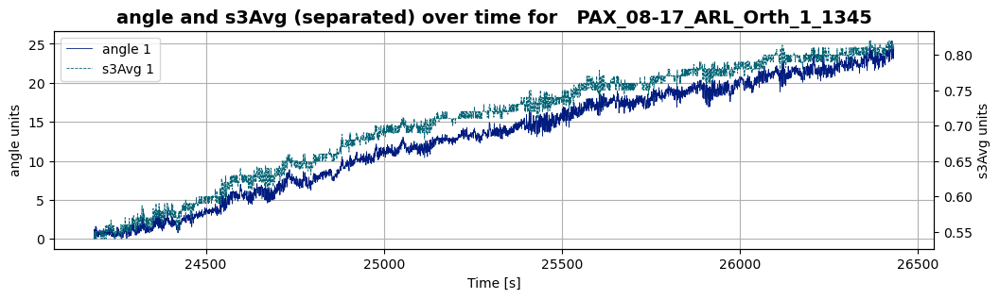

Number of taus used for signal 1: 1384
Number of taus used for signal 2: 1384


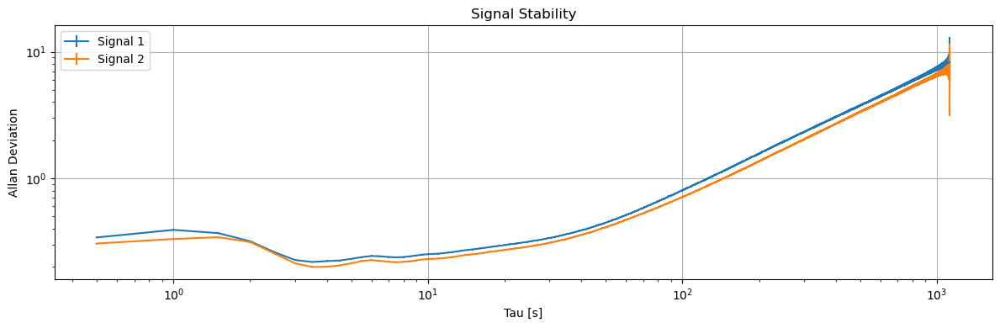

Time range: min=26432.46, max=28645.968


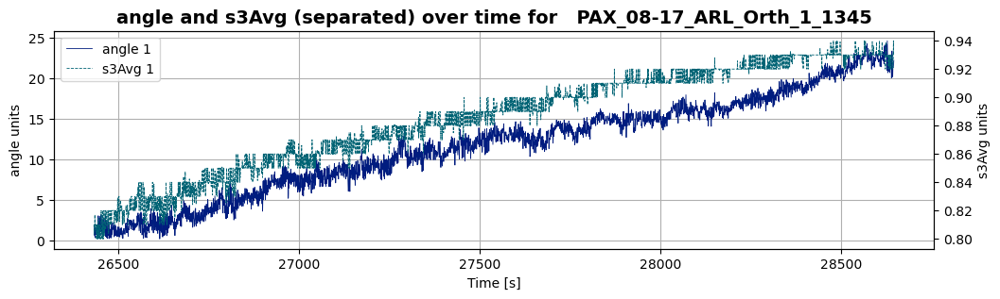

Number of taus used for signal 1: 1376
Number of taus used for signal 2: 1376


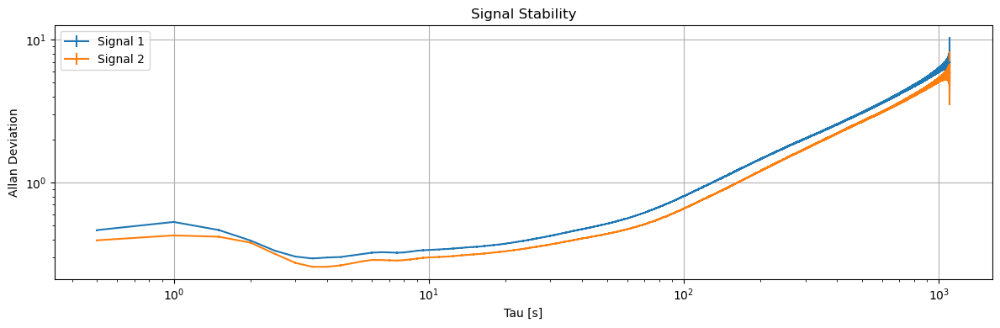

Time range: min=28645.988, max=30860.099


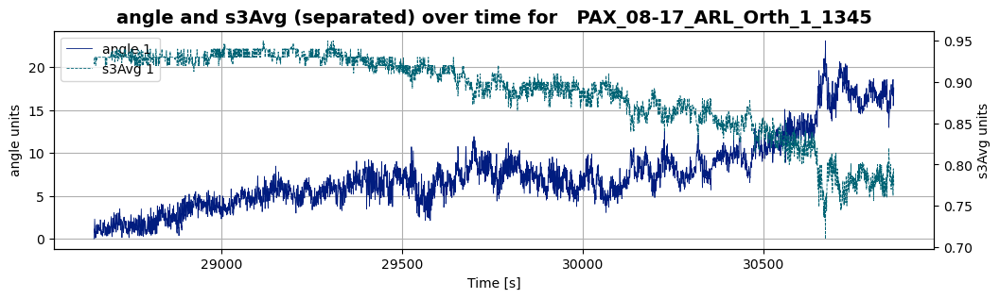

Number of taus used for signal 1: 1376
Number of taus used for signal 2: 1376


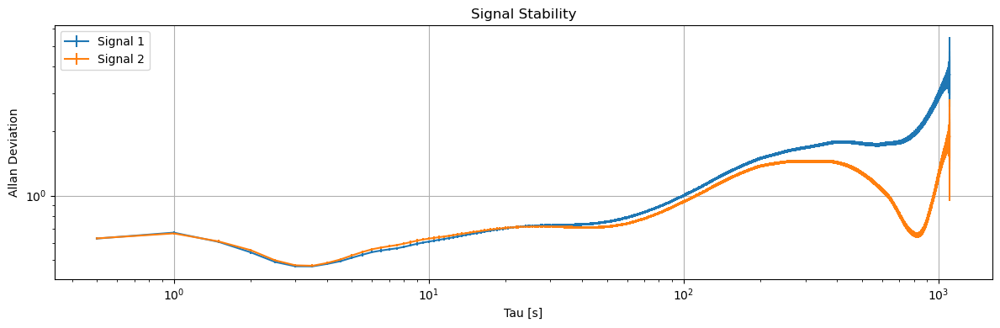

Time range: min=30860.109, max=33070.309


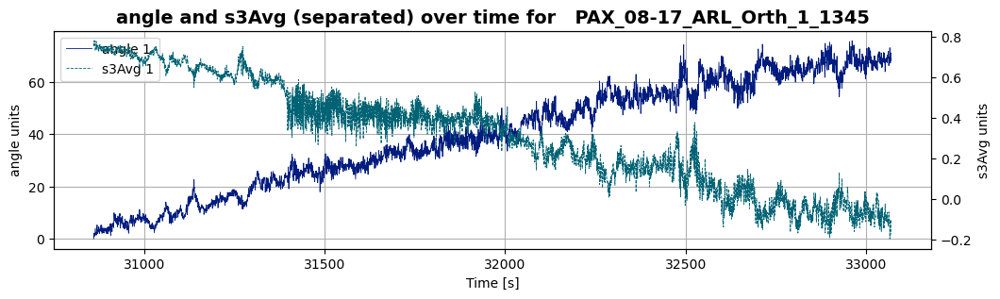

Number of taus used for signal 1: 1376
Number of taus used for signal 2: 1376


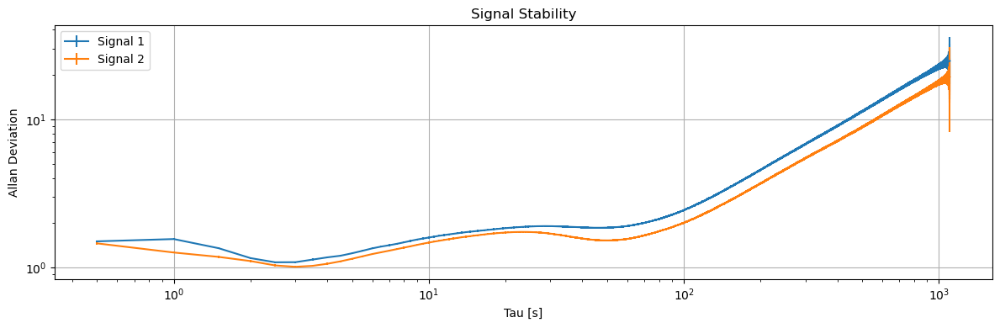

Time range: min=33070.326, max=35270.726


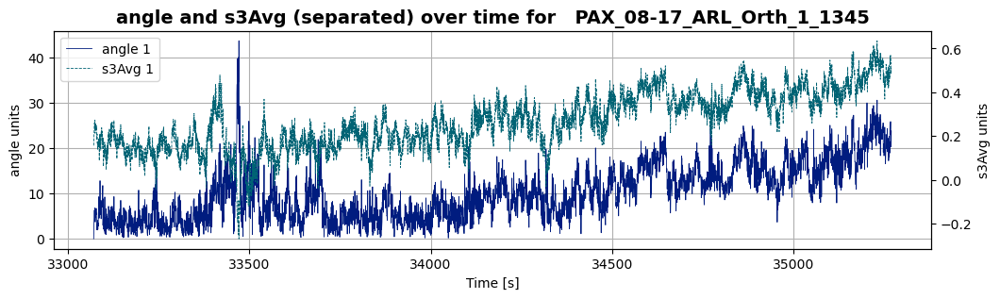

Number of taus used for signal 1: 1374
Number of taus used for signal 2: 1374


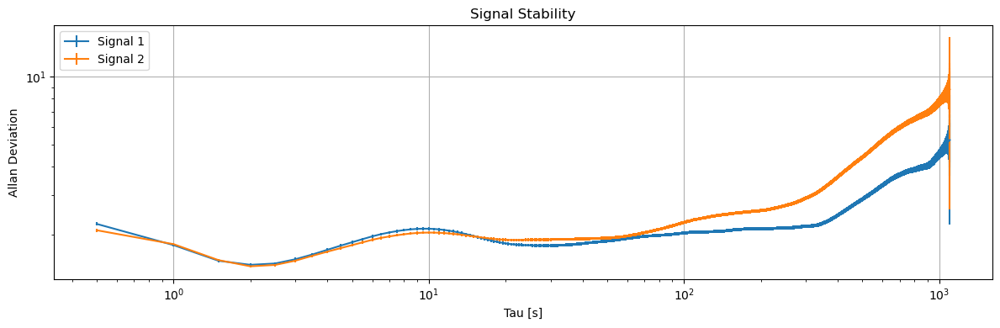

Time range: min=35270.736, max=37494.871


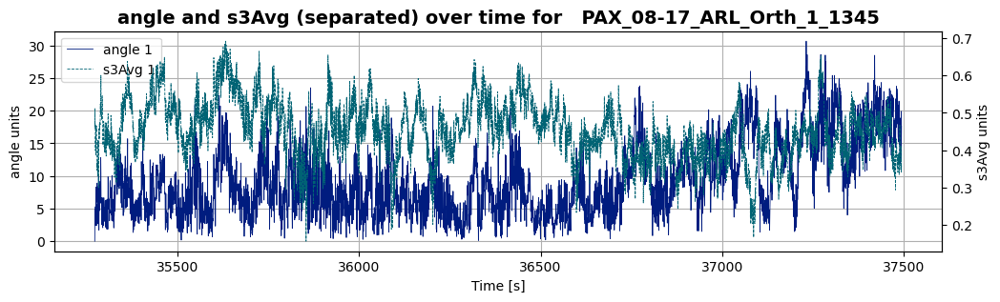

Number of taus used for signal 1: 1379
Number of taus used for signal 2: 1379


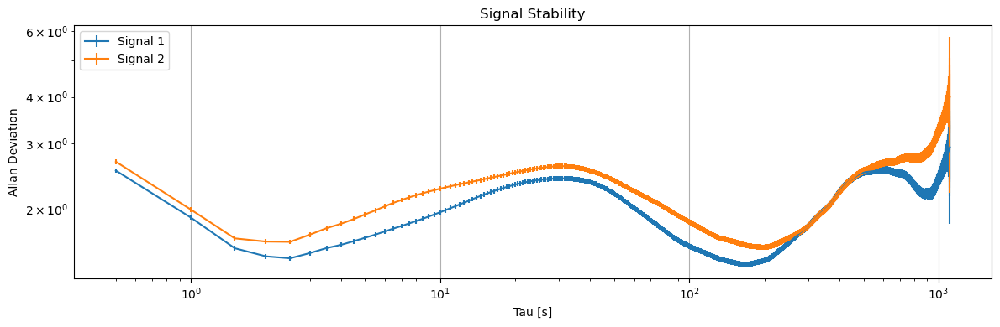

Time range: min=37494.881, max=39749.194


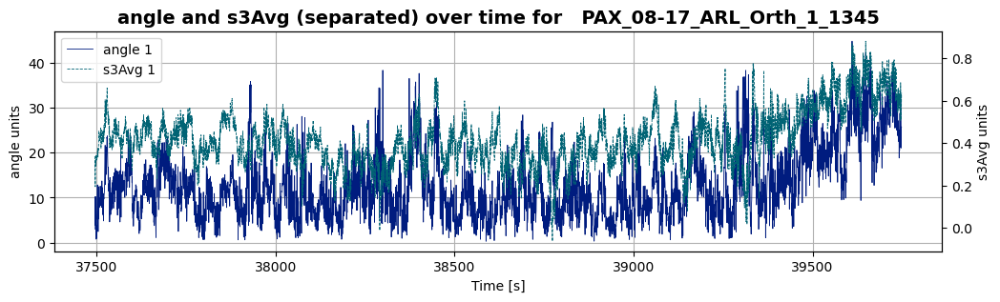

Number of taus used for signal 1: 1386
Number of taus used for signal 2: 1386


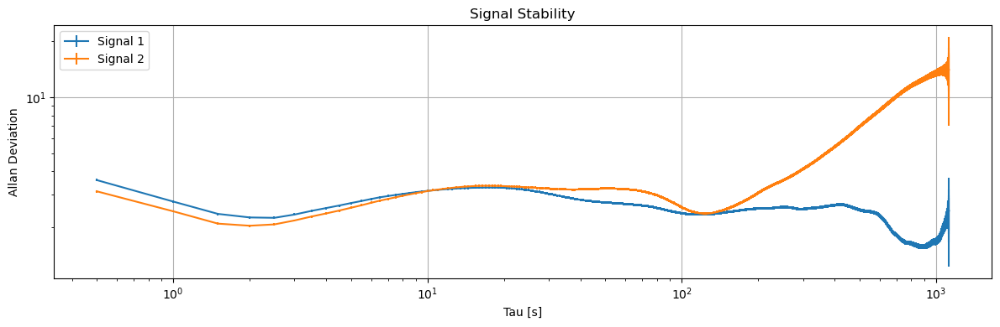

Time range: min=39749.214, max=42011.211


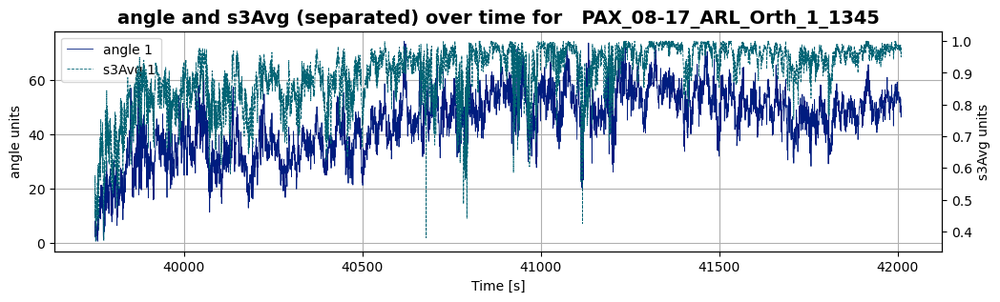

Number of taus used for signal 1: 1387
Number of taus used for signal 2: 1387


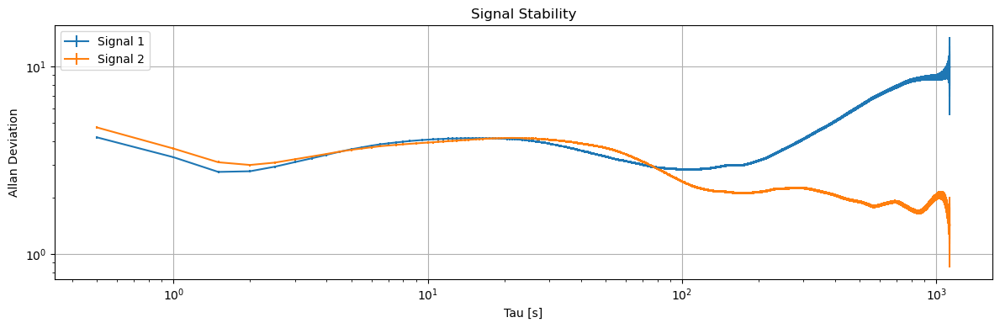

Time range: min=42011.221, max=44268.004


IndexError: single positional indexer is out-of-bounds

In [58]:
filepath_ARL_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
adev_params_arr = []
r=0.05
while r+0.05 <= 1.01:
    set_range = (r,r+0.05)
    ds_temp = SwitchSet(filepath_ARL_1_1345,set_range=set_range)
    ds_temp.find_switches(print_process=False)
    ds_temp.average_data(print_process=False)
    ds_temp.calc_transfer(input_stokes='first')
    ds_temp.plot_separated(plot_param='angle', plot_param_2='s3Avg', plot_signal=1)
    taus2_1,ad_1,ade_1,ns_1,taus2_2,ad_2,ade_2,ns_2 = ds_temp.adev(plot_param='angle', plot_adev=True)
    label = ds_temp.title+" {}".format(set_range)
    adev_params_arr.append((taus2_1,ad_1,ade_1,ns_1,label+'_Signal 1'))
    adev_params_arr.append((taus2_2,ad_2,ade_2,ns_2,label+'_Signal 2'))
    r += 0.05

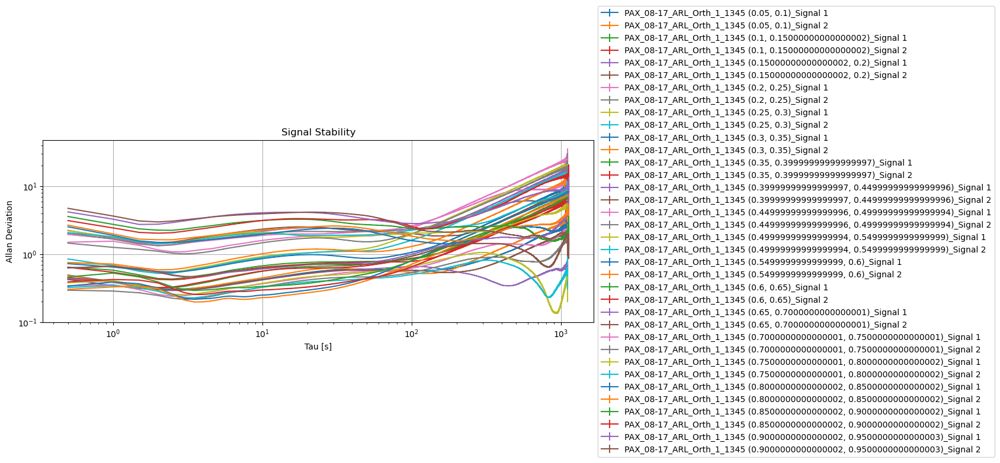

In [59]:
StationarySet.plot_adev(adev_params_arr)

## PTF Calculations

### Testing code

#### Random testing code

In [79]:
df = ds_ARL_1_1345.stokes_ptf_df
df.tail()

,EstTime,basesMatrix,sig1Stokes,sig2Stokes,axis,rotAngle,angleDif
3268,2234.479649,"[[0.37086952134255424, 0.5621055857923964, 0.7...","(0.023251, 0.010783, -0.057215)","(-0.0100328, 0.0057035, 0.062473)","[-0.09935086573273627, 0.48069882573828143, 0....",0.308642,2.834169
3269,2234.979643,"[[0.32432777490917336, 0.5557398657484739, 0.7...","(0.02029272727272727, 0.014384545454545455, -0...","(-0.0072558, 0.0023559, 0.063032)","[0.0017114857842010188, 0.5532913184429176, 0....",0.358246,2.834885
3270,2235.479637,"[[0.31973638218331085, 0.4506030970340049, 0.8...","(0.019995555555555558, 0.013225555555555555, -...","(-0.008676166666666667, 0.00622125, 0.0625275)","[-0.15825944263401698, 0.5142763917780113, 0.6...",0.433633,2.813860
3271,2235.979630,"[[0.3351216034183056, 0.6421764848826792, 0.68...","(0.020929166666666665, 0.012726666666666666, -...","(-0.007475375, 0.0008835, 0.06292125)","[0.06164190335502824, 0.5812610691123852, 0.21...",0.316206,2.872484
3272,2236.479624,"[[0.31070320243584626, 0.3568138440582557, 0.8...","(0.019435, 0.015369166666666668, -0.0574349999...","(-0.010133, 0.005441333333333333, 0.0624075000...","[-0.18564242968447342, 0.4698457157554047, 0.8...",0.509716,2.808524


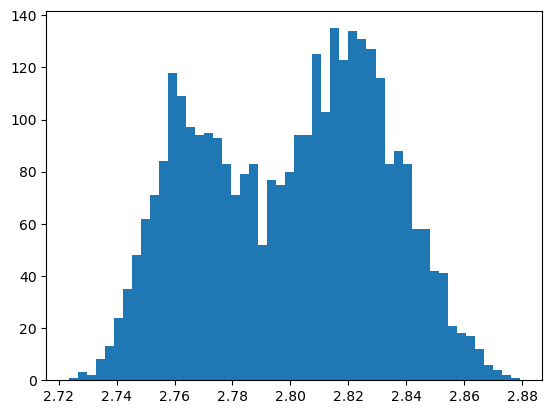

In [40]:
plt.hist(df['angleDif'],bins=50);

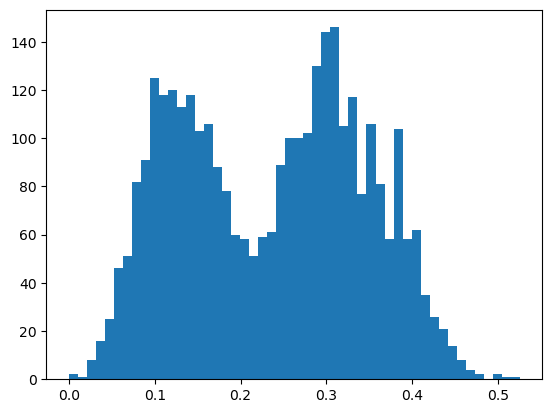

In [37]:
plt.hist(df['angle'], bins=50);

#### Proof of concept

In [81]:
plt.ioff();

In [7]:
filepath_ARL_1_1345='Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
ds_ARL_1_1345 = SwitchSet(filepath_ARL_1_1345,set_range=(0.,0.99), skip_default_signal_baseline=600)

Time range: min=600.017, max=43816.497


Determining change point ranges automatically...
Using change_point_range_1=(600.017, 700.017)
Using change_point_range_2=(3600.017, 3700.017)
=== performing change point detection ===
cp range: (600.017, 700.017)
using 6437 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6437,)
computing range... ---> range = (0.88,0.93)
displaying jump_fig for switch parameter = s1



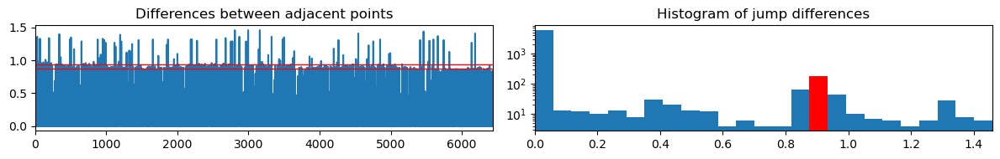



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6437,)
computing range... ---> range = (0.11,0.17)
displaying jump_fig for switch parameter = s2



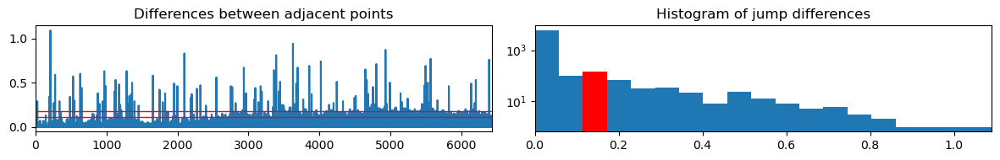



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6437,)
computing range... ---> range = (1.71,1.77)
displaying jump_fig for switch parameter = s3



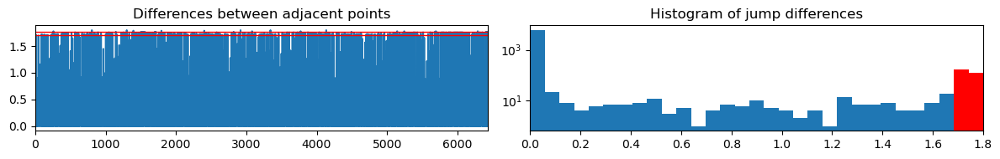



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.88,0.93)
Jump points detected: 183
out of total: ~400.0

computing offset...


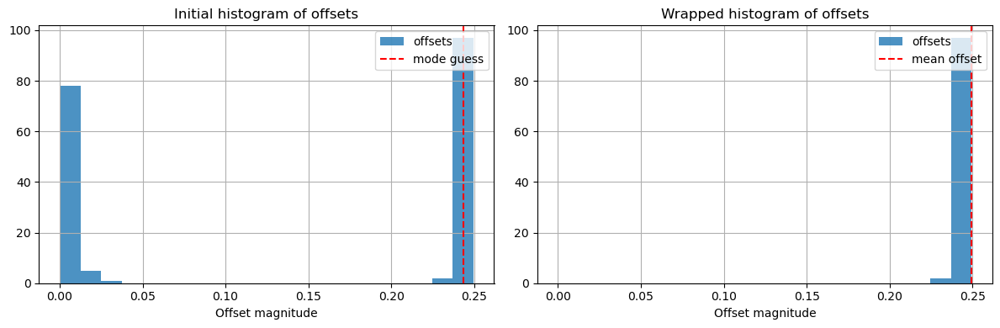



offset = 0.249 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3600.017, 3700.017)
using 6737 data entries
skipping 201553 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6737,)
computing range... ---> range = (0.32,0.38)
displaying jump_fig for switch parameter = s1



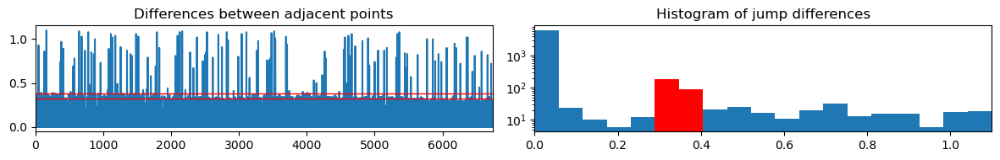



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6737,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s2



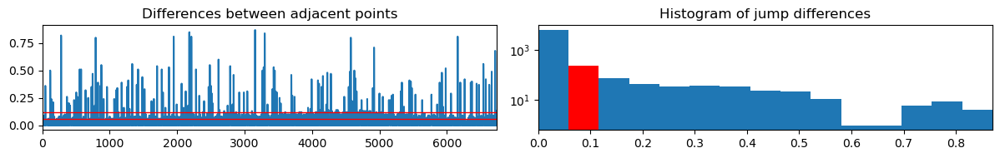



found width of 0.058 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6737,)
computing range... ---> range = (1.89,1.95)
displaying jump_fig for switch parameter = s3



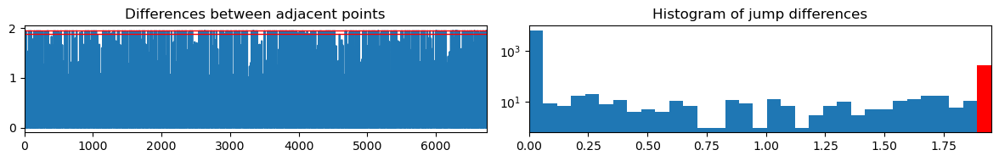



found width of 0.059 for s3
greater than prev width of 0.058 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.89,1.95)
Jump points detected: 267
out of total: ~400.0

computing offset...


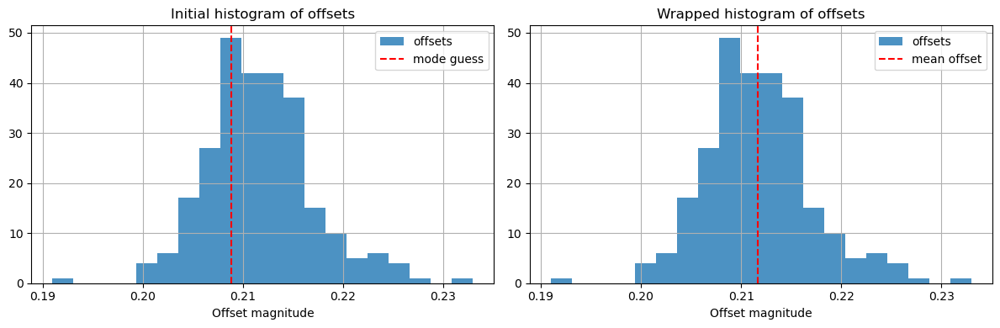



offset = 0.212 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.038 seconds over 12000.0 switches
Corrected Switch Time = 0.2499968
=== starting average_data ===
averaging data... Done
Dropped 233 observations with <4 points (out of total 171866 observations)

--- interpolating data ---
length before: 85827
length after: 86433
606 total added
--- end interpolating data ---

--- interpolating data ---
length before: 85806
length after: 86433
627 total added
--- end interpolating data ---
Signal 1 size=86433	Signal 1 range: t=(600.38,43815.83)
Signal 2 size=86433	Signal 2 range: t=(600.63,43816.08)
=== end average_data ===


In [8]:
ds_ARL_1_1345.find_switches(nominal_switch_rate=2, print_process=True)
ds_ARL_1_1345.average_data(print_process=True)

In [156]:
ds_ARL_1_1345.calc_similarity(input_stokes='first')

In [157]:
ds_ARL_1_1345.calc_stokes_ptf(input_stokes='first')

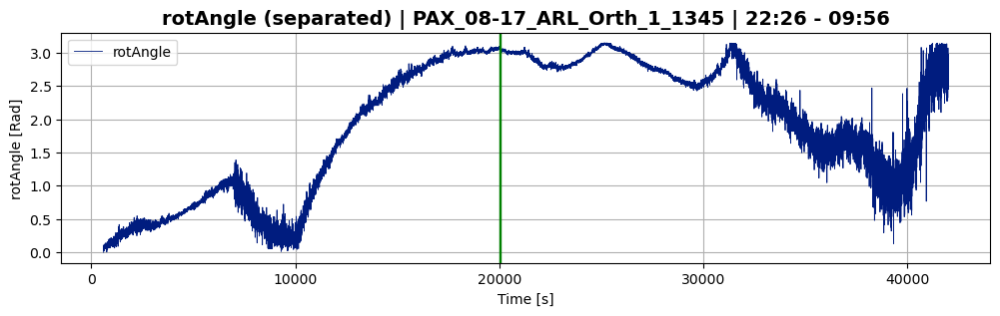

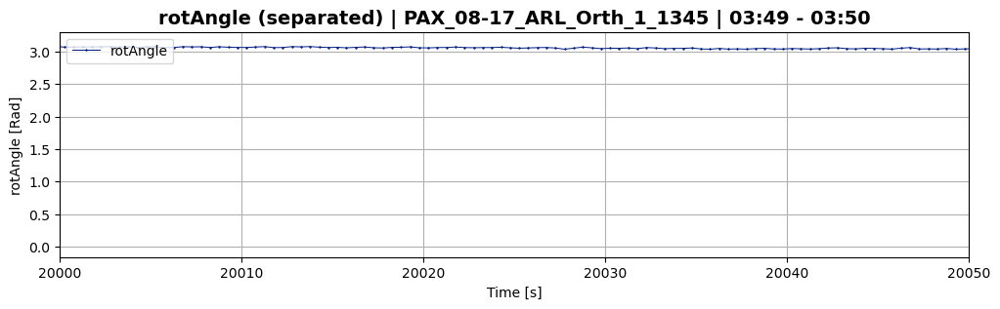

In [158]:
ds_ARL_1_1345.plot_separated(plot_param='rotAngle',sample_range=(20000,20050))

### Input SOPs as reference for entire dataset with IOPair

#### (OLD) 8-17 Manual ARL Channel Comparison

##### Get it working for 1345

###### Match input to output

In [61]:
plt.ioff();

Time range: min=0.07, max=95.271


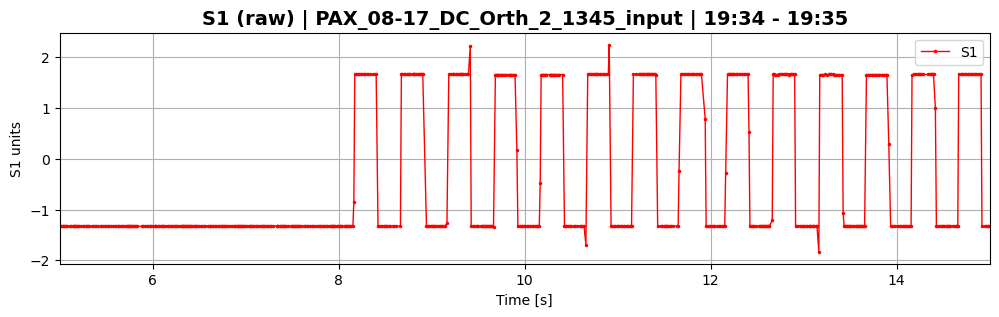

In [62]:
filepath_DC_2_1345_input='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345_input.csv'
ds_DC_2_1345_input = Dataset(filepath_DC_2_1345_input,skip_default_signal_baseline=False)
ds_DC_2_1345_input.plot_raw(plot_param='S1', birds_eye=False, sample_range=(5,15))

In [63]:
filepath_DC_2_1345_input='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345_input.csv'
ds_DC_2_1345_input = SwitchSet(filepath_DC_2_1345_input,skip_default_signal_baseline=10)
ds_DC_2_1345_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_DC_2_1345_input.average_data(print_process=False)
stokes_1_DC_2_1345_input, stokes_2_DC_2_1345_input = ds_DC_2_1345_input.average_stokes()
print('signal 1: ', stokes_1_DC_2_1345_input)   # Default signal!!
print('signal 2: ', stokes_2_DC_2_1345_input)

Time range: min=10.006, max=95.271
signal 1:  [-1.3262629134169046, -0.06001371229097209, 1.2598613051941363]
signal 2:  [1.6632221814995378, 0.2235836731351606, -0.8304236827765462]


In [64]:
filepath_DC_2_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345.csv'
ds_DC_2_1345 = Dataset(filepath_DC_2_1345,set_range=(0,0.05),skip_default_signal_baseline=False)

Time range: min=0.053, max=1407.036


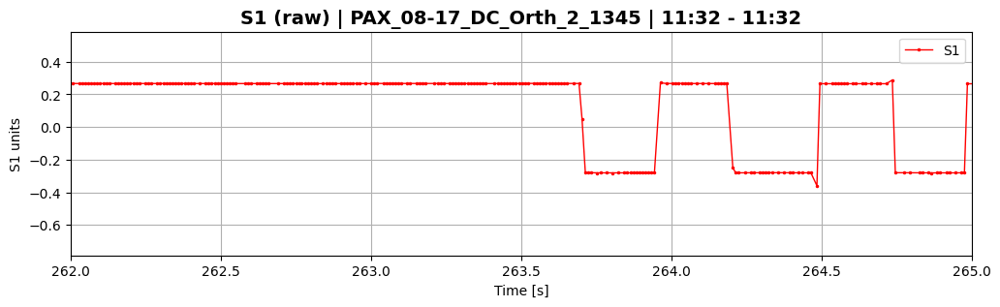

In [65]:
ds_DC_2_1345.plot_raw(plot_param='S1', birds_eye=False, sample_range=(262,265))

In [66]:
filepath_DC_2_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345.csv'
ds_DC_2_1345 = SwitchSet(filepath_DC_2_1345,set_range=(0,0.05),skip_default_signal_baseline=300)
ds_DC_2_1345.find_switches(nominal_switch_rate=2, print_process=False)
ds_DC_2_1345.average_data(print_process=False)
stokes_1_temp, stokes_2_temp = ds_DC_2_1345.average_stokes()
print('signal 1: ', stokes_1_temp)
print('signal 2: ', stokes_2_temp)   # Default signal!!

Time range: min=300.014, max=1407.036
signal 1:  [-0.3224826018745242, 1.3225520803438613, 0.09368305668902584]
signal 2:  [0.3146248896856022, -1.2705318833783006, 0.09798487645068539]


In [93]:
### Switch inputs: True
# This message will mean we need to use "switch_inputs=True" in calc_stokes_ptf(), so the correct inputs
# Get matched to the correct outputs

###### Plug input into ptf calc

In [115]:
filepath_DC_2_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345.csv'
ds_DC_2_1345 = SwitchSet(filepath_DC_2_1345,set_range=(0,0.95),skip_default_signal_baseline=300)

Time range: min=300.014, max=26798.304


Determining change point ranges automatically...
Using change_point_range_1=(300.014, 400.014)
Using change_point_range_2=(3300.014, 3400.014)
=== performing change point detection ===
cp range: (300.014, 400.014)
using 6729 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6729,)
computing range... ---> range = (0.39,0.45)
displaying jump_fig for switch parameter = s1



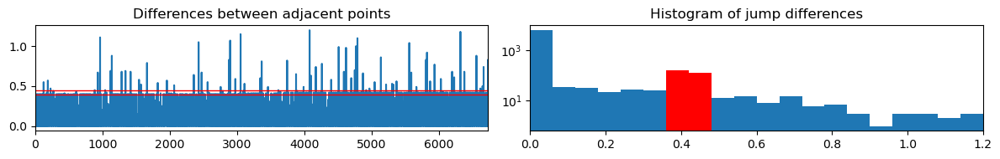



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6729,)
computing range... ---> range = (1.93,1.99)
displaying jump_fig for switch parameter = s2



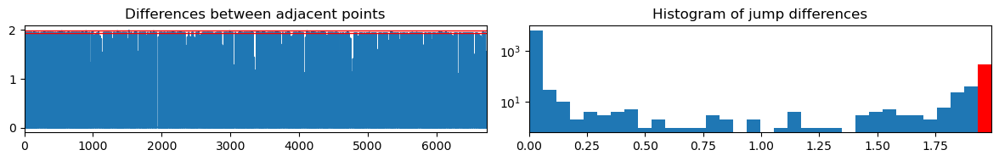



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6729,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s3



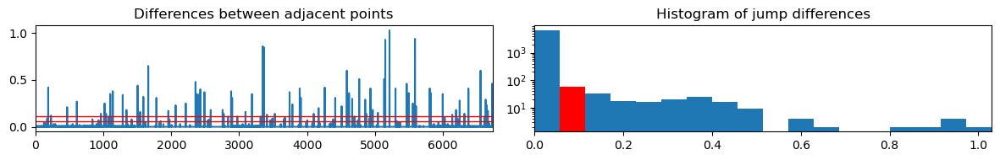



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.39,0.45)
Jump points detected: 279
out of total: ~400.0

computing offset...


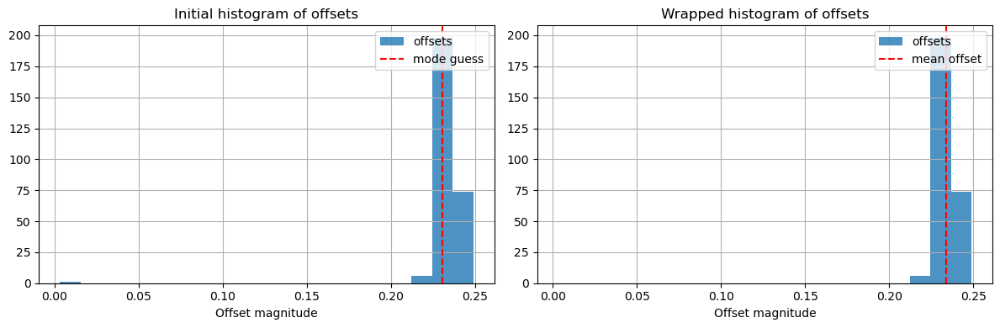



offset = 0.234 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3300.014, 3400.014)
using 7081 data entries
skipping 210210 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7081,)
computing range... ---> range = (0.47,0.53)
displaying jump_fig for switch parameter = s1



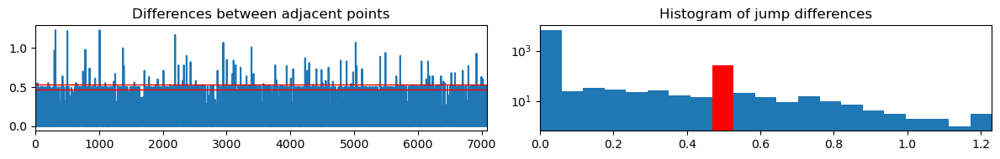



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7081,)
computing range... ---> range = (1.92,1.98)
displaying jump_fig for switch parameter = s2



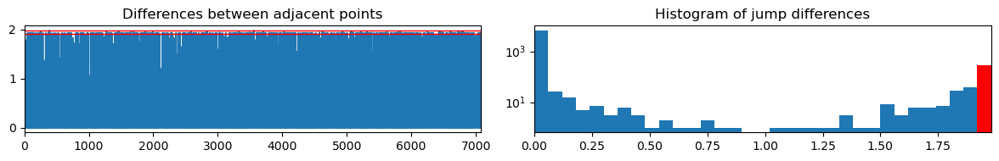



found width of 0.060 for s2
greater than prev width of 0.059 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7081,)
computing range... ---> range = (0.12,0.18)
displaying jump_fig for switch parameter = s3



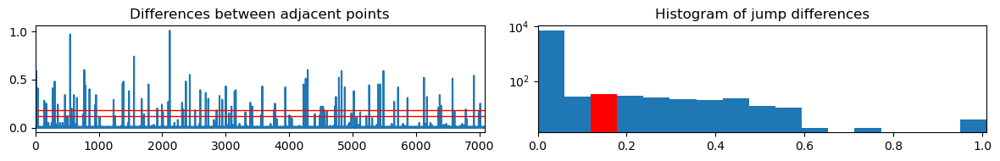



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.92,1.98)
Jump points detected: 291
out of total: ~399.9

computing offset...


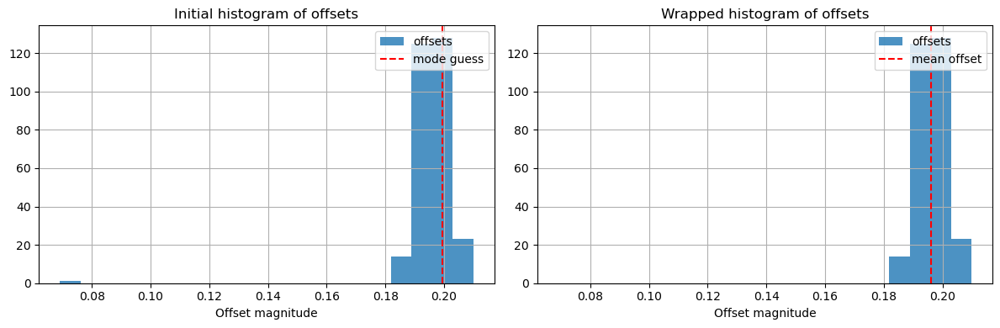



offset = 0.196 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.038 seconds over 12000.0 switches
Corrected Switch Time = 0.2499968
=== starting average_data ===
averaging data... Done
Dropped 87 observations with <4 points (out of total 105604 observations)

--- interpolating data ---
length before: 52760
length after: 52997
237 total added
--- end interpolating data ---

--- interpolating data ---
length before: 52757
length after: 52996
239 total added
--- end interpolating data ---
Signal 1 size=52997	Signal 1 range: t=(300.36,26798.03)
Signal 2 size=52996	Signal 2 range: t=(300.61,26797.78)
=== end average_data ===


In [116]:
ds_DC_2_1345.find_switches(nominal_switch_rate=2, print_process=True)
ds_DC_2_1345.average_data(print_process=True)

In [117]:
filepath_DC_2_1345_input='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345_input.csv'
ds_DC_2_1345_input = SwitchSet(filepath_DC_2_1345_input,skip_default_signal_baseline=10)
ds_DC_2_1345_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_DC_2_1345_input.average_data(print_process=False)

Time range: min=10.006, max=95.271


In [118]:
ds_DC_2_1345.calc_stokes_ptf(input_stokes=(ds_DC_2_1345_input.average_stokes()), switch_inputs=True)

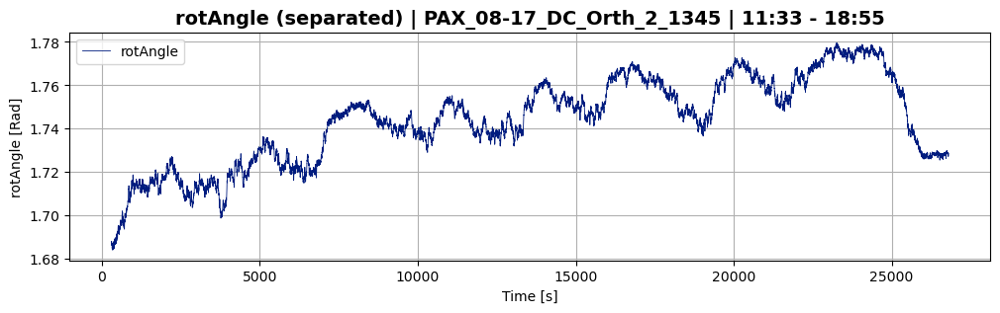

In [119]:
ds_DC_2_1345.plot_separated(plot_param='rotAngle')

Number of taus used for signal: 2322


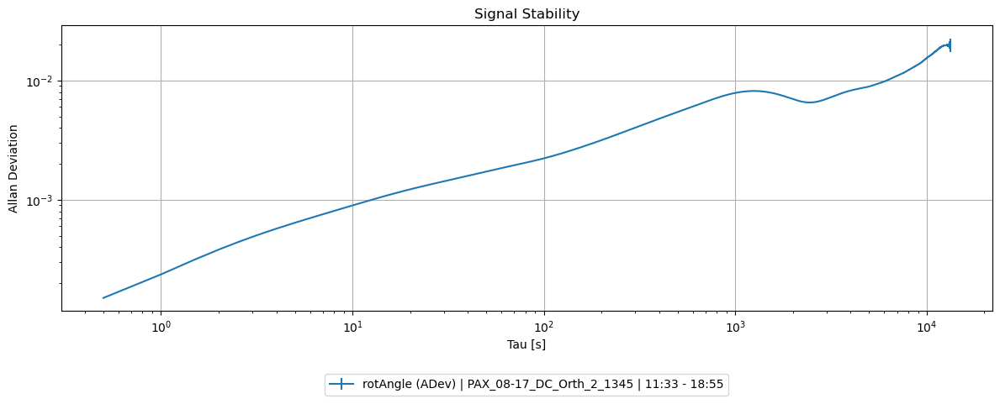

In [138]:
ds_DC_2_1345.adev(plot_param='rotAngle', plot_adev=True);

###### Testing

In [67]:
filepath_DC_2_1345='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1345.csv'
ds_DC_2_1345 = SwitchSet(filepath_DC_2_1345,set_range=(0,0.3),skip_default_signal_baseline=300)

Time range: min=300.014, max=8440.566


Determining change point ranges automatically...
Using change_point_range_1=(300.014, 400.014)
Using change_point_range_2=(3300.014, 3400.014)
=== performing change point detection ===
cp range: (300.014, 400.014)
using 6729 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6729,)
computing range... ---> range = (0.39,0.45)
displaying jump_fig for switch parameter = s1



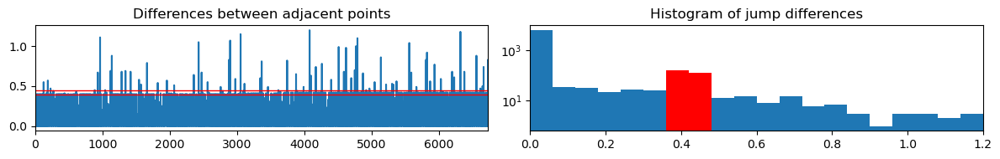



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6729,)
computing range... ---> range = (1.93,1.99)
displaying jump_fig for switch parameter = s2



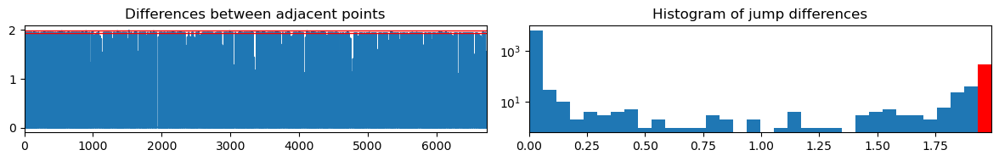



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6729,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s3



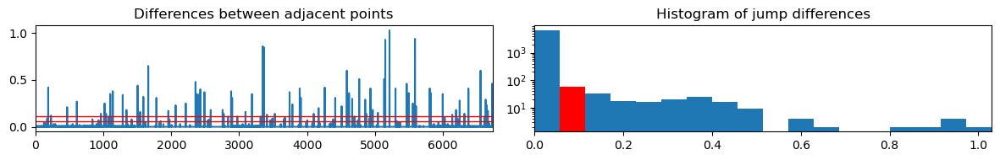



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.39,0.45)
Jump points detected: 279
out of total: ~400.0

computing offset...


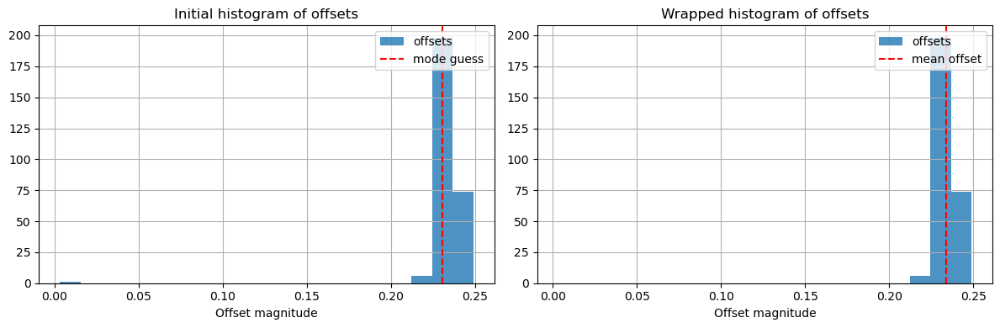



offset = 0.234 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3300.014, 3400.014)
using 7081 data entries
skipping 210210 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7081,)
computing range... ---> range = (0.47,0.53)
displaying jump_fig for switch parameter = s1



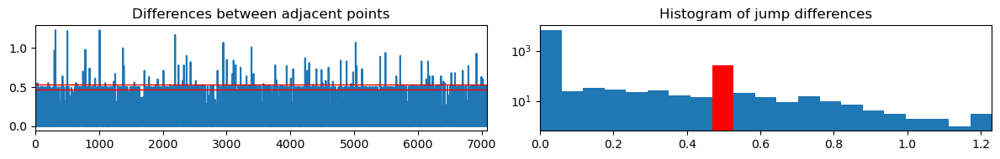



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7081,)
computing range... ---> range = (1.92,1.98)
displaying jump_fig for switch parameter = s2



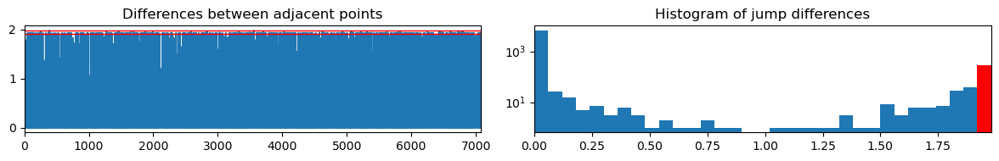



found width of 0.060 for s2
greater than prev width of 0.059 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7081,)
computing range... ---> range = (0.12,0.18)
displaying jump_fig for switch parameter = s3



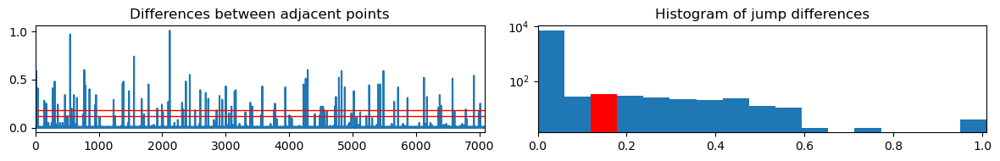



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.92,1.98)
Jump points detected: 291
out of total: ~399.9

computing offset...


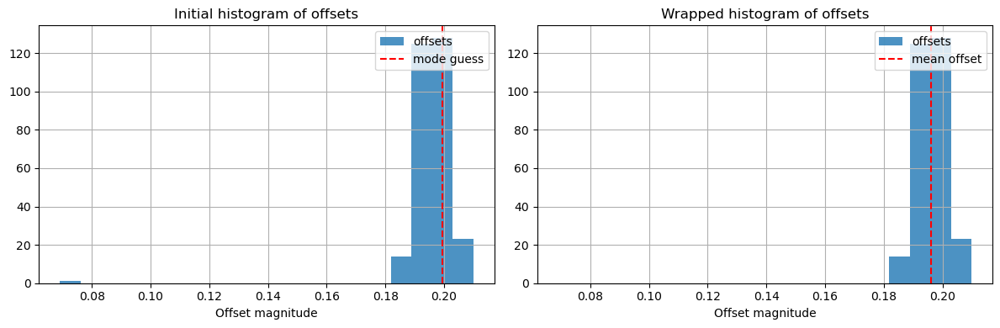



offset = 0.196 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.038 seconds over 12000.0 switches
Corrected Switch Time = 0.2499968
=== starting average_data ===
averaging data... Done
Dropped 26 observations with <4 points (out of total 32464 observations)

--- interpolating data ---
length before: 16222
length after: 16281
59 total added
--- end interpolating data ---

--- interpolating data ---
length before: 16216
length after: 16280
64 total added
--- end interpolating data ---
Signal 1 size=16281	Signal 1 range: t=(300.36,8440.26)
Signal 2 size=16280	Signal 2 range: t=(300.61,8440.01)
=== end average_data ===


In [68]:
ds_DC_2_1345.find_switches(nominal_switch_rate=2, print_process=True)
ds_DC_2_1345.average_data(print_process=True)

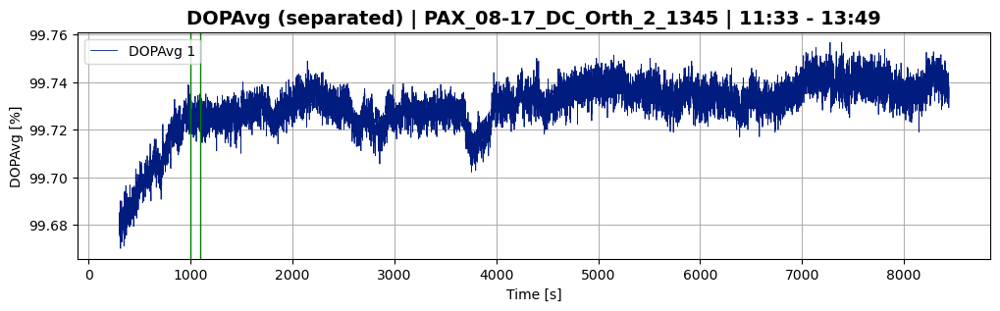

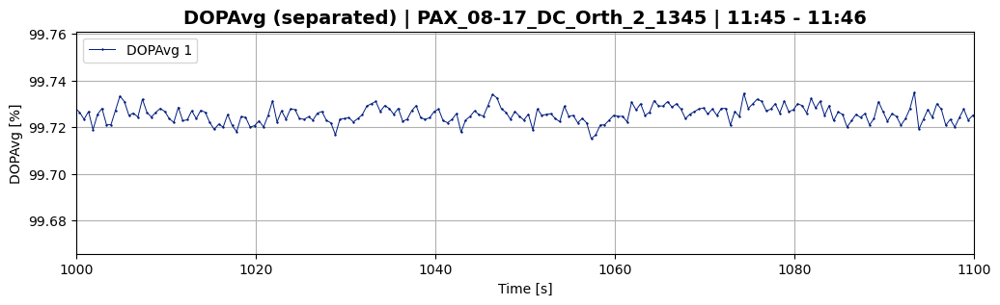

In [77]:
ds_DC_2_1345.plot_separated(plot_param='DOPAvg', plot_signal=1,sample_range=(1000,1100))

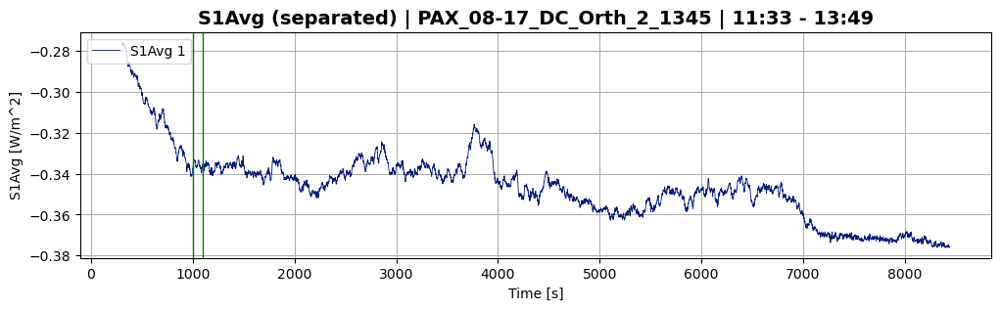

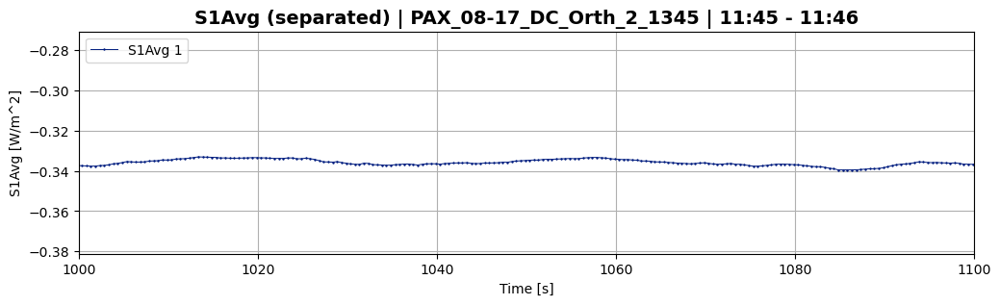

In [78]:
ds_DC_2_1345.plot_separated(plot_param='S1Avg', plot_signal=1,sample_range=(1000,1100))

##### Do same thing for 1560

###### Match input to output

In [61]:
plt.ioff();

Time range: min=0.051, max=120.36


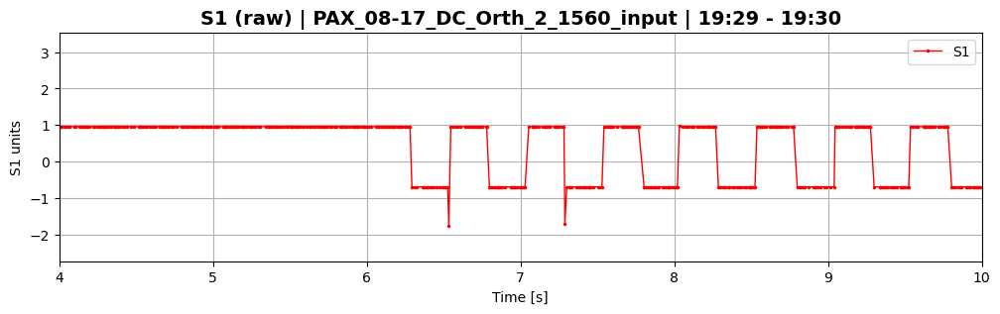

In [122]:
filepath_DC_2_1560_input='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1560_input.csv'
ds_DC_2_1560_input = Dataset(filepath_DC_2_1560_input,skip_default_signal_baseline=False)
ds_DC_2_1560_input.plot_raw(plot_param='S1', birds_eye=False, sample_range=(4,10))

In [125]:
filepath_DC_2_1560_input='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1560_input.csv'
ds_DC_2_1560_input = SwitchSet(filepath_DC_2_1560_input,skip_default_signal_baseline=10)
ds_DC_2_1560_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_DC_2_1560_input.average_data(print_process=False)
stokes_1_DC_2_1560_input, stokes_2_DC_2_1560_input = ds_DC_2_1560_input.average_stokes()
print('signal 1: ', stokes_1_DC_2_1560_input)
print('signal 2: ', stokes_2_DC_2_1560_input)   # Default signal!!

Time range: min=10.007, max=120.36
signal 1:  [-0.687088334220518, -0.22568054106304528, 2.1038238736263737]
signal 2:  [0.9582882856497966, -0.11703437570517346, -2.043392762583687]


In [126]:
filepath_DC_2_1560='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1560.csv'
ds_DC_2_1560 = Dataset(filepath_DC_2_1560,set_range=(0,0.05),skip_default_signal_baseline=False)

Time range: min=0.05, max=1398.458


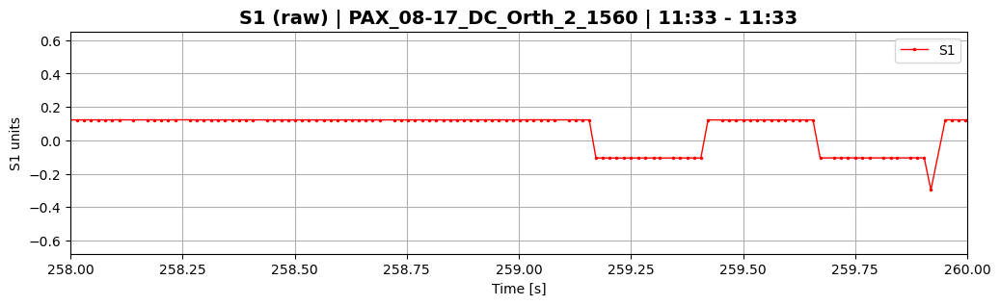

In [129]:
ds_DC_2_1560.plot_raw(plot_param='S1', birds_eye=False, sample_range=(258,260))

In [130]:
filepath_DC_2_1560='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1560.csv'
ds_DC_2_1560 = SwitchSet(filepath_DC_2_1560,set_range=(0,0.05),skip_default_signal_baseline=300)
ds_DC_2_1560.find_switches(nominal_switch_rate=2, print_process=False)
ds_DC_2_1560.average_data(print_process=False)
stokes_1_temp, stokes_2_temp = ds_DC_2_1560.average_stokes()
print('signal 1: ', stokes_1_temp)
print('signal 2: ', stokes_2_temp)   # Default signal!!

Time range: min=300.014, max=1398.458
signal 1:  [-0.10669371026597278, 1.4399089654145574, -0.2997517049868968]
signal 2:  [0.11861029993918523, -1.4829627977674864, 0.0048293431279236975]


In [93]:
### Switch inputs: False
# This message will mean we need to use "switch_inputs=True" in calc_stokes_ptf(), so the correct inputs
# Get matched to the correct outputs

###### Plug input into ptf calc

In [131]:
filepath_DC_2_1560='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1560.csv'
ds_DC_2_1560 = SwitchSet(filepath_DC_2_1560,set_range=(0,0.95),skip_default_signal_baseline=300)

Time range: min=300.014, max=26797.646


Determining change point ranges automatically...
Using change_point_range_1=(300.014, 400.014)
Using change_point_range_2=(3300.014, 3400.014)
=== performing change point detection ===
cp range: (300.014, 400.014)
using 5618 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5618,)
computing range... ---> range = (0.12,0.18)
displaying jump_fig for switch parameter = s1



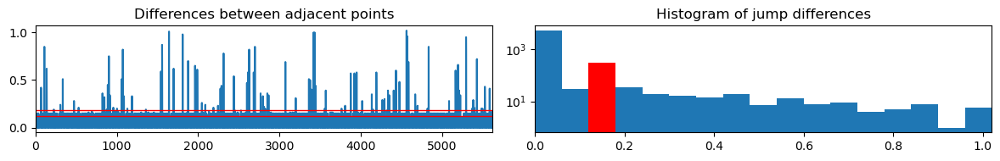



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5618,)
computing range... ---> range = (1.94,2.00)
displaying jump_fig for switch parameter = s2



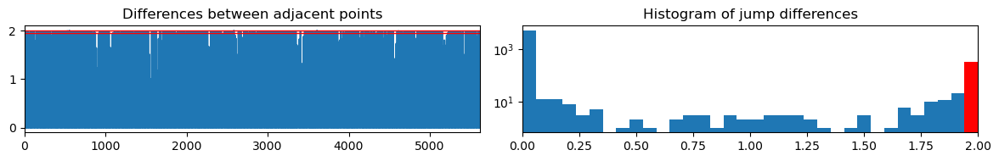



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5618,)
computing range... ---> range = (0.11,0.17)
displaying jump_fig for switch parameter = s3



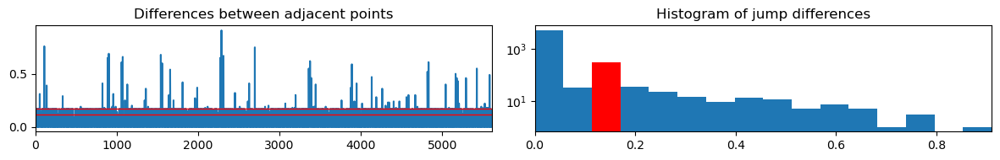



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.12,0.18)
Jump points detected: 301
out of total: ~400.0

computing offset...


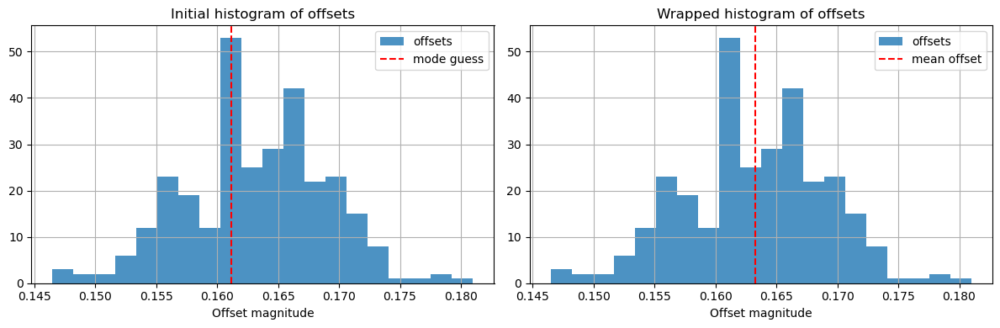



offset = 0.163 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3300.014, 3400.014)
using 5526 data entries
skipping 166024 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5526,)
computing range... ---> range = (0.12,0.18)
displaying jump_fig for switch parameter = s1



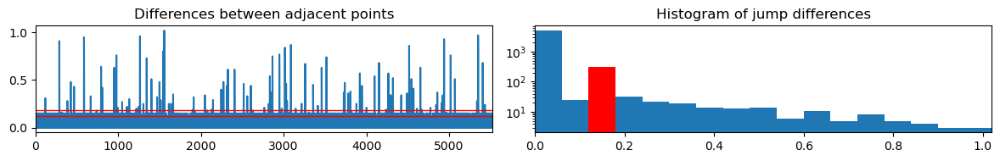



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5526,)
computing range... ---> range = (1.94,2.00)
displaying jump_fig for switch parameter = s2



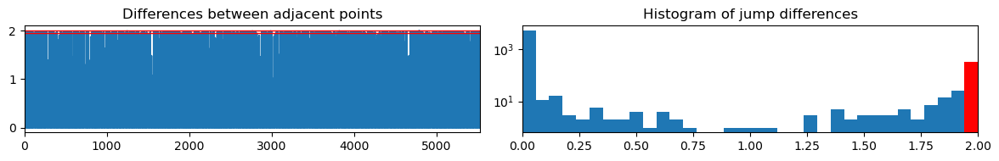



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5526,)
computing range... ---> range = (0.18,0.24)
displaying jump_fig for switch parameter = s3



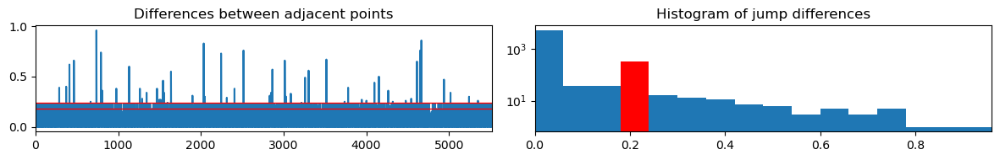



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.12,0.18)
Jump points detected: 312
out of total: ~399.9

computing offset...


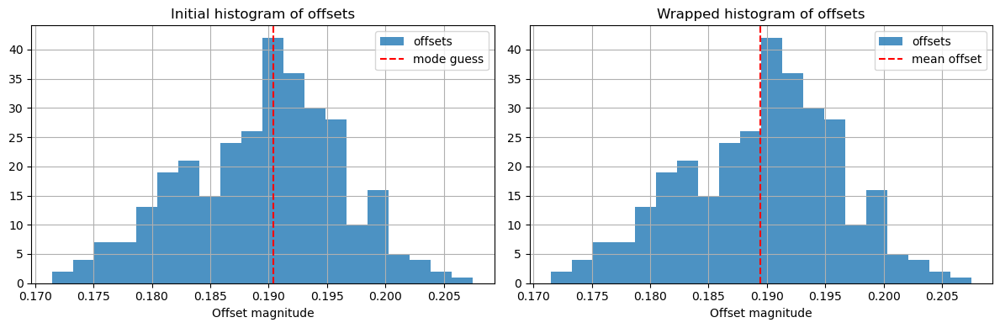



offset = 0.189 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.026 seconds over 12000.0 switches
Corrected Switch Time = 0.2500022
=== starting average_data ===
averaging data... Done
Dropped 12 observations with <4 points (out of total 105988 observations)

--- interpolating data ---
length before: 52988
length after: 52994
6 total added
--- end interpolating data ---

--- interpolating data ---
length before: 52988
length after: 52994
6 total added
--- end interpolating data ---
Signal 1 size=52994	Signal 1 range: t=(300.54,26797.27)
Signal 2 size=52994	Signal 2 range: t=(300.29,26797.02)
=== end average_data ===


In [132]:
ds_DC_2_1560.find_switches(nominal_switch_rate=2, print_process=True)
ds_DC_2_1560.average_data(print_process=True)

In [133]:
# Plug in from above section!
filepath_DC_2_1560_input='Datasets/Whole_setup/08-17/PAX_08-17_DC_Orth_2_1560_input.csv'
ds_DC_2_1560_input = SwitchSet(filepath_DC_2_1560_input,skip_default_signal_baseline=10)
ds_DC_2_1560_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_DC_2_1560_input.average_data(print_process=False)

Time range: min=10.007, max=120.36


In [135]:
ds_DC_2_1560.calc_stokes_ptf(input_stokes=(ds_DC_2_1560_input.average_stokes()), switch_inputs=False)

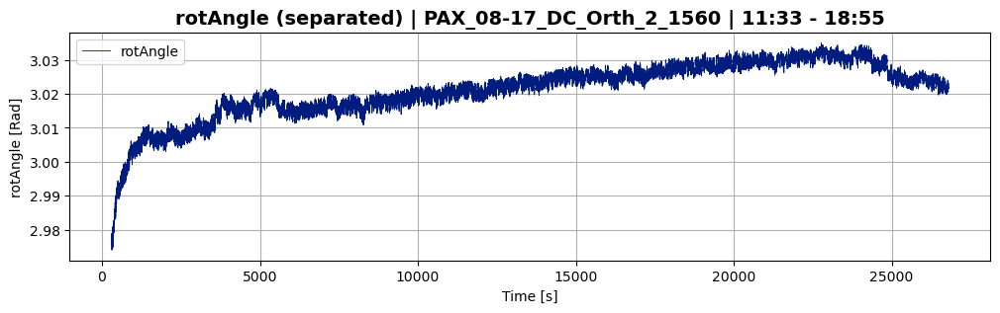

In [136]:
ds_DC_2_1560.plot_separated(plot_param='rotAngle')

Number of taus used for signal: 2322


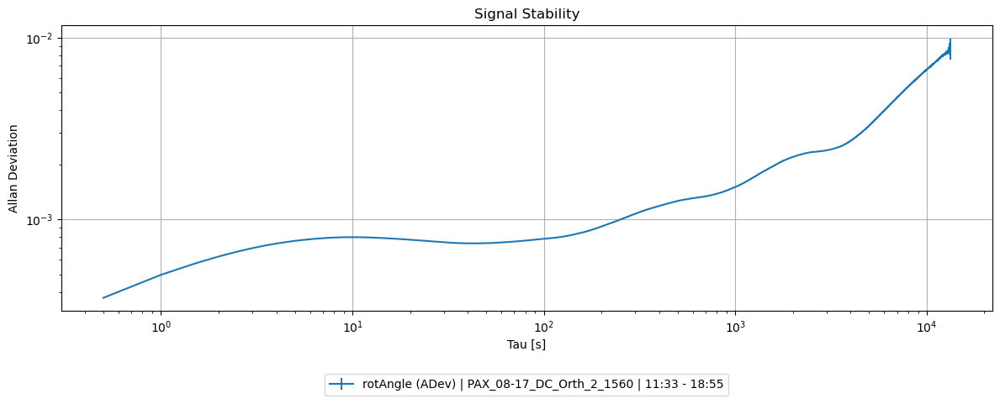

In [137]:
ds_DC_2_1560.adev(plot_param='rotAngle', plot_adev=True);

##### Results from both 1345 and 1560

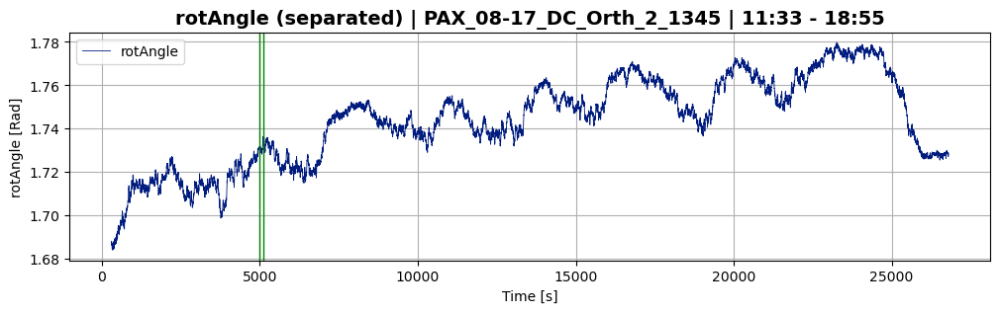

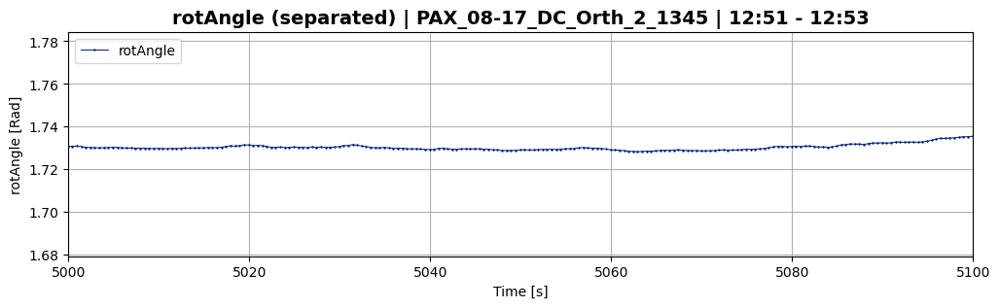

In [139]:
ds_DC_2_1345.plot_separated(plot_param='rotAngle',sample_range=(5000,5100))

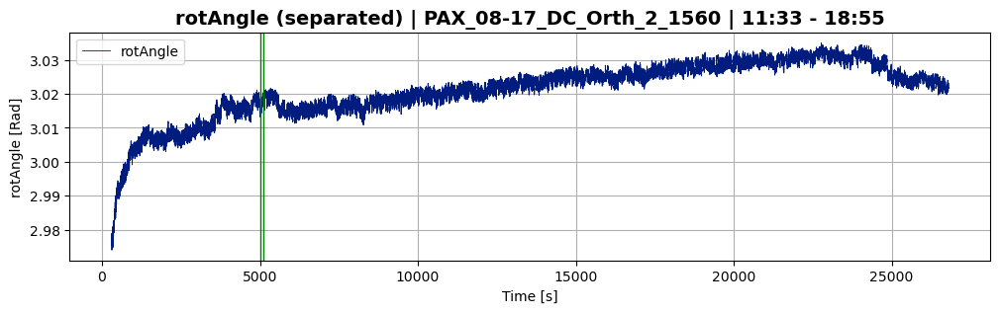

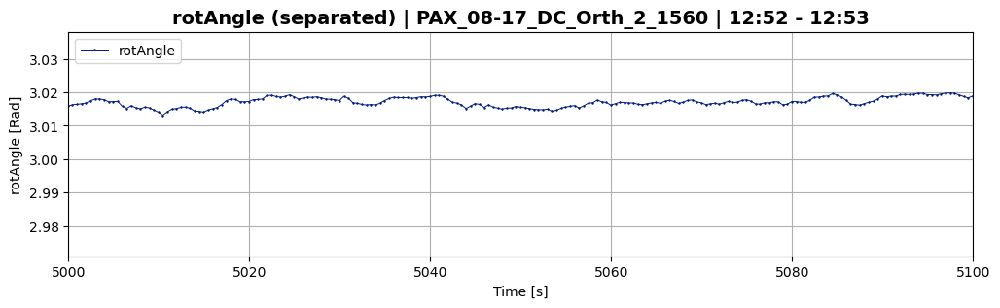

In [140]:
ds_DC_2_1560.plot_separated(plot_param='rotAngle',sample_range=(5000,5100))

Number of taus used for signal: 2322


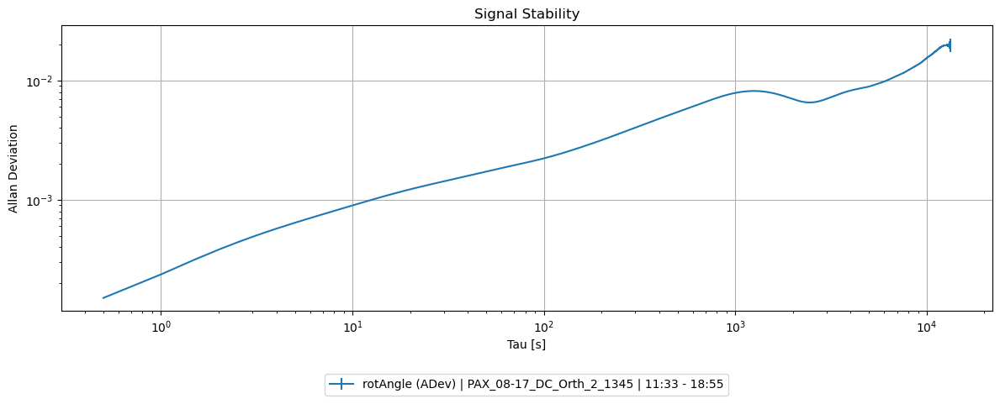

In [138]:
ds_DC_2_1345.adev(plot_param='rotAngle', plot_adev=True);

Number of taus used for signal: 2322


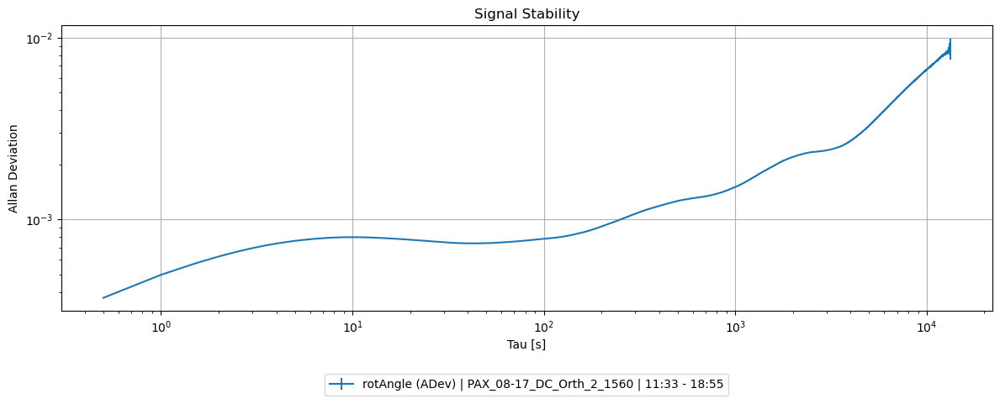

In [137]:
ds_DC_2_1560.adev(plot_param='rotAngle', plot_adev=True);

#### (OLD) 10-30 Manual ARL Channel Comparison

##### 1345

###### Match input to output

In [9]:
plt.ioff();

Time range: min=0.05, max=60.007


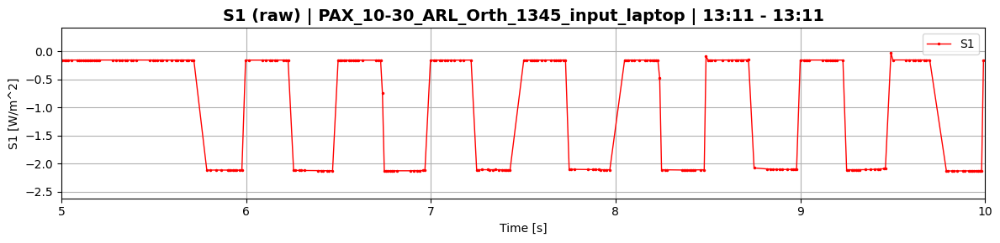

(None, <Figure size 1200x300 with 1 Axes>)

In [10]:
filepath_ARL_1345_input_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_input_laptop.csv'
ds_ARL_1345_input_1030 = Dataset(filepath_ARL_1345_input_1030,skip_default_signal_baseline=False)
ds_ARL_1345_input_1030.plot_raw(plot_param='S1', birds_eye=False, sample_range=(5,10))

In [11]:
filepath_ARL_1345_input_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_input_laptop.csv'
ds_ARL_1345_input_1030 = SwitchSet(filepath_ARL_1345_input_1030,skip_default_signal_baseline=8)
ds_ARL_1345_input_1030.find_switches(nominal_switch_rate=2, print_process=False)
ds_ARL_1345_input_1030.average_data(print_assignment=True)
# Default is signal 2

NameError: name 'SwitchSet' is not defined

In [ ]:
filepath_ARL_1345_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
ds_ARL_1345_1030 = Dataset(filepath_ARL_1345_1030,set_range=(0,0.0005),skip_default_signal_baseline=False)

In [ ]:
ds_ARL_1345_1030.plot_raw(plot_param='S3', birds_eye=False, sample_range=(5,10))

In [ ]:
filepath_ARL_1345_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
ds_ARL_1345_1030 = SwitchSet(filepath_ARL_1345_1030,set_range=(0,0.0005),skip_default_signal_baseline=8)
ds_ARL_1345_1030.find_switches(nominal_switch_rate=2, print_process=False)
t = ds_ARL_1345_1030.average_data(print_assignment=True)
# Default is signal 1

In [ ]:
### Switch inputs: True
# Meaning we need to use this value for the "switch_inputs" parameter in calc_stokes_ptf(), so the correct inputs
# Get matched to the correct outputs

###### Plug input into ptf calc

In [ ]:
filepath_ARL_1345_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
ds_ARL_1345_1030 = SwitchSet(filepath_ARL_1345_1030,set_range=(0,0.95),skip_default_signal_baseline=8)

In [ ]:
ds_ARL_1345_1030.find_switches(nominal_switch_rate=2, print_process=True)
ds_ARL_1345_1030.average_data(print_process=True)

In [ ]:
filepath_ARL_1345_1030_input='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_input_laptop.csv'
ds_ARL_1345_1030_input = SwitchSet(filepath_ARL_1345_1030_input,skip_default_signal_baseline=10)
ds_ARL_1345_1030_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_ARL_1345_1030_input.average_data(print_process=False)

In [ ]:
ds_ARL_1345_1030.calc_stokes_ptf(input_stokes=(ds_ARL_1345_1030_input.average_stokes()), switch_inputs=True)

In [ ]:
ds_ARL_1345_1030.plot_separated(plot_param='rotAngle',sample_range=(8000,8500))

##### 1560

###### Match input to output

In [ ]:
plt.ioff();

In [ ]:
filepath_ARL_1560_1030_input='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_input_laptop.csv'
ds_ARL_1560_1030_input = Dataset(filepath_ARL_1560_1030_input,skip_default_signal_baseline=False)
ds_ARL_1560_1030_input.plot_raw(plot_param='S1', birds_eye=False, sample_range=(4,10))

In [ ]:
filepath_ARL_1560_1030_input='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_input_laptop.csv'
ds_ARL_1560_1030_input = SwitchSet(filepath_ARL_1560_1030_input,skip_default_signal_baseline=10)
ds_ARL_1560_1030_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_ARL_1560_1030_input.average_data(print_process=False)
stokes_1_temp_input, stokes_2_temp_input = ds_ARL_1560_1030_input.average_stokes()
print('signal 1: ', stokes_1_temp_input)
print('signal 2: ', stokes_2_temp_input)   # Default signal!!

In [ ]:
filepath_ARL_1560_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_laptop.csv'
ds_ARL_1560_1030 = Dataset(filepath_ARL_1560_1030,set_range=(0,0.005),skip_default_signal_baseline=False)

In [ ]:
ds_ARL_1560_1030.plot_raw(plot_param='S1', birds_eye=True, sample_range=(4,10))

In [ ]:
filepath_ARL_1560_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_laptop.csv'
ds_ARL_1560_1030 = SwitchSet(filepath_ARL_1560_1030,set_range=(0,0.005),skip_default_signal_baseline=10)
ds_ARL_1560_1030.find_switches(nominal_switch_rate=2, print_process=False)
ds_ARL_1560_1030.average_data(print_process=False)
stokes_1_temp, stokes_2_temp = ds_ARL_1560_1030.average_stokes()
print('signal 1: ', stokes_1_temp)
print('signal 2: ', stokes_2_temp)   # Default signal!!

In [ ]:
### Switch inputs: False
# This message will mean we need to use "switch_inputs=True" in calc_stokes_ptf(), so the correct inputs
# Get matched to the correct outputs

###### Plug input into ptf calc

In [ ]:
filepath_ARL_1560_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_laptop.csv'
ds_ARL_1560_1030 = SwitchSet(filepath_ARL_1560_1030,set_range=(0,0.95))

In [ ]:
ds_ARL_1560_1030.find_switches(nominal_switch_rate=2, print_process=True)
ds_ARL_1560_1030.average_data(print_process=True)

In [ ]:
# Plug in from above section!
filepath_ARL_1560_1030_input='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_input_laptop.csv'
ds_ARL_1560_1030_input = SwitchSet(filepath_ARL_1560_1030_input,skip_default_signal_baseline=10)
ds_ARL_1560_1030_input.find_switches(nominal_switch_rate=2, print_process=False)
ds_ARL_1560_1030_input.average_data(print_process=False)

In [ ]:
ds_ARL_1560_1030.calc_stokes_ptf(input_stokes=(ds_ARL_1560_1030_input.average_stokes()), switch_inputs=False)

In [ ]:
ds_ARL_1560_1030.plot_separated(plot_param='rotAngle')

In [ ]:
ds_ARL_1560_1030.adev(plot_param='rotAngle', plot_adev=True);

##### Results from both 1345 and 1560

In [ ]:
ds_ARL_1345_1030.plot_separated(plot_param='rotAngle',sample_range=(2000,2500))

In [ ]:
ds_ARL_1560_1030.plot_separated(plot_param='rotAngle')

#### Input SOPs as reference for entire dataset with IOPair: 10-30 ARL Channel Comparison

In [27]:
plt.ioff()
plt.close('all')

In [28]:
filepath_ARL_1345_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
filepath_ARL_1345_input_1030='Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_input_laptop.csv'
my_pair = IOPair(filepath_ARL_1345_1030, filepath_ARL_1345_input_1030)

Using skip time of 8.0 seconds for input dataset
Time range: min=8.049, max=60.007
	Choosing assign_by parameter automatically; 	Using assign_by = "s2Avg" where dif = -0.94
	Dif = -0.94 for s2Avg is negative; switching signals
	First measurement of Signal 1:  [-2.114125, 0.118375, -0.2504875]
	First measurement of Signal 2:  [-0.1567, 2.046875, -0.006604]
Time range: min=0.05, max=60.007


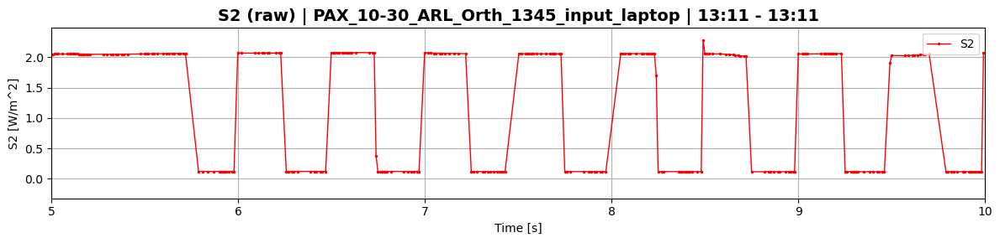

Using skip time of 8.0 seconds for output dataset
Time range: min=8.007, max=95.591
	Choosing assign_by parameter automatically; 	Using assign_by = "s3Avg" where dif = 1.30
	Dif = 1.30 for s3Avg is positive; not switching signals
	First measurement of Signal 1:  [-0.024437333333333332, -0.042478666666666665, -0.040250666666666664]
	First measurement of Signal 2:  [-0.018779999999999998, -0.045171538461538464, 0.04355384615384616]
Time range: min=0.029, max=95.591


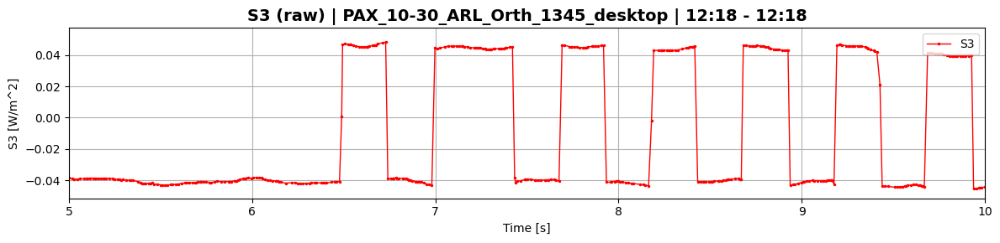

In [29]:
my_pair.match_IO_plot()

In [30]:
# For input, default is signal 2
# For output, default is signal 1
my_pair.set_signal_switch(True)   # We need to switch the signal arrays used as input

	======Begin averaging INPUT dataset...======

Time range: min=8.049, max=60.007

	======INPUT dataset averaged successfully======


	======Begin averaging OUTPUT dataset...======

Time range: min=8.007, max=95046.109
Determining change point ranges automatically...
Using change_point_range_1=(8.007, 108.007)
Using change_point_range_2=(3008.007, 3108.007)
=== performing change point detection ===
cp range: (8.007, 108.007)
using 7740 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7740,)
computing range... ---> range = (0.15,0.21)
displaying jump_fig for switch parameter = s1



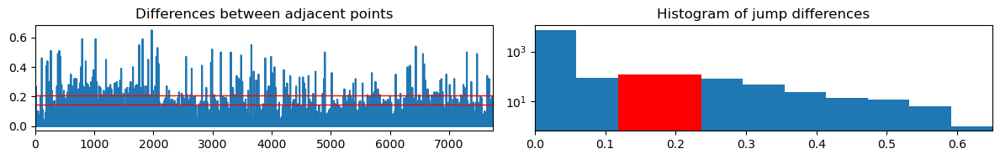



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7740,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s2



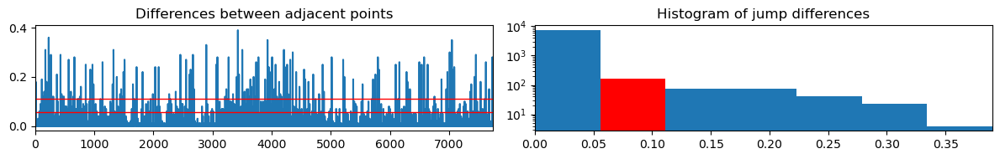



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7740,)
computing range... ---> range = (1.31,1.37)
displaying jump_fig for switch parameter = s3



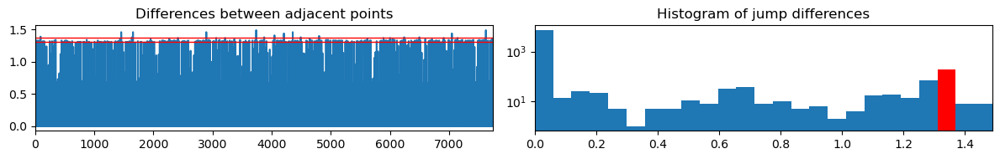



found width of 0.060 for s3
greater than prev width of 0.059 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.31,1.37)
Jump points detected: 196
out of total: ~400.0

computing offset...


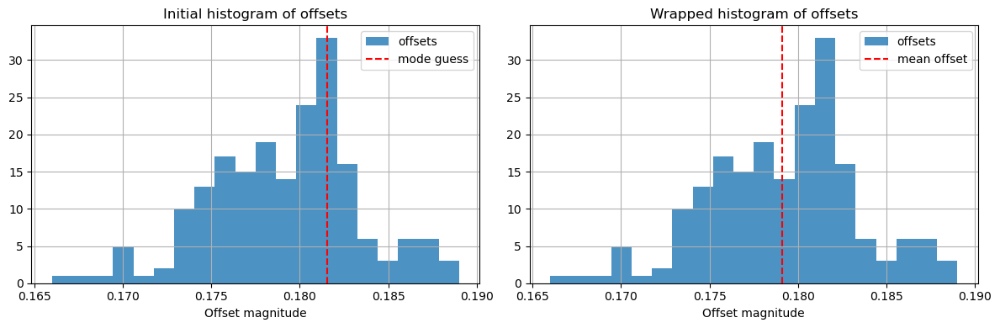



offset = 0.179 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3008.007, 3108.007)
using 7739 data entries
skipping 232316 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7739,)
computing range... ---> range = (0.77,0.83)
displaying jump_fig for switch parameter = s1



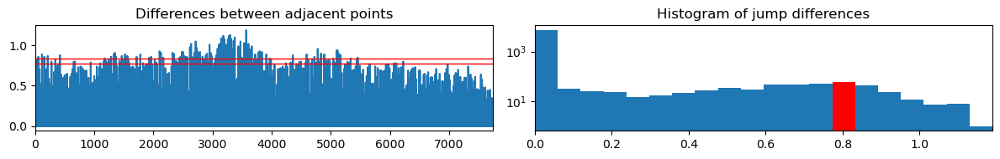



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7739,)
computing range... ---> range = (1.07,1.13)
displaying jump_fig for switch parameter = s2



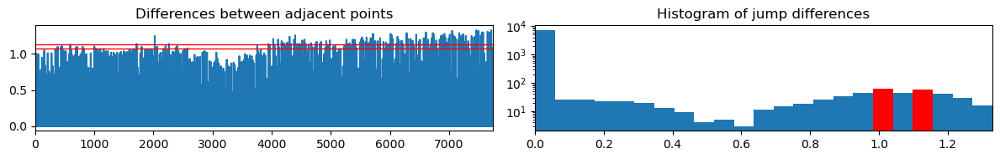



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7739,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s3



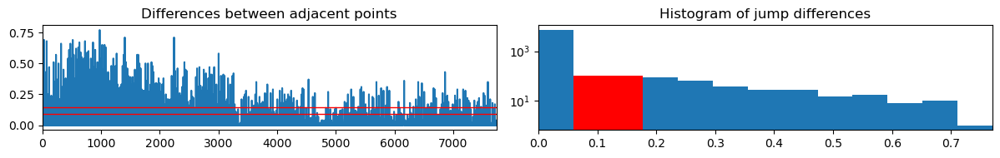



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.77,0.83)
Jump points detected: 59
out of total: ~399.9

computing offset...


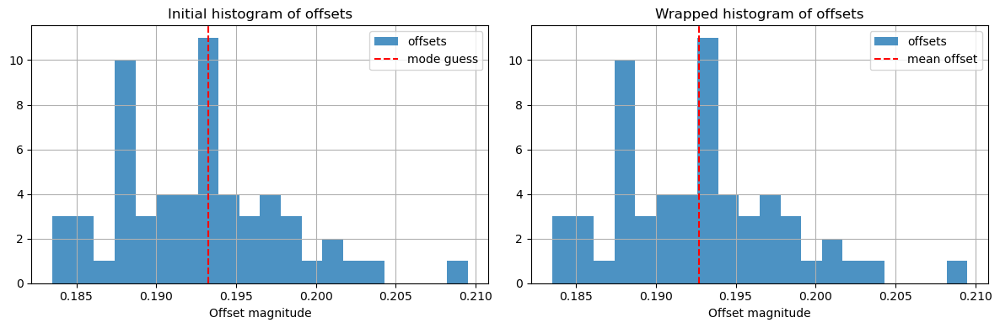



offset = 0.193 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.014 seconds over 12000.0 switches
Corrected Switch Time = 0.2500011
=== starting average_data ===
averaging data... Done
Dropped 2 observations with <4 points (out of total 380148 observations)

--- interpolating data ---
length before: 190073
length after: 190075
2 total added
--- end interpolating data ---

--- interpolating data ---
length before: 190073
length after: 190074
1 total added
--- end interpolating data ---
Signal 1 size=190074	Signal 1 range: t=(8.55,95045.48)
Signal 2 size=190075	Signal 2 range: t=(8.30,95045.73)
=== end average_data ===

	======OUTPUT dataset averaged successfully======



	======Begin PTF calculations for INPUT/OUTPUT dataset pair...======



NameError: name 'self' is not defined

In [31]:
ds_ARL_1345_1030 = my_pair.get_full_ds()

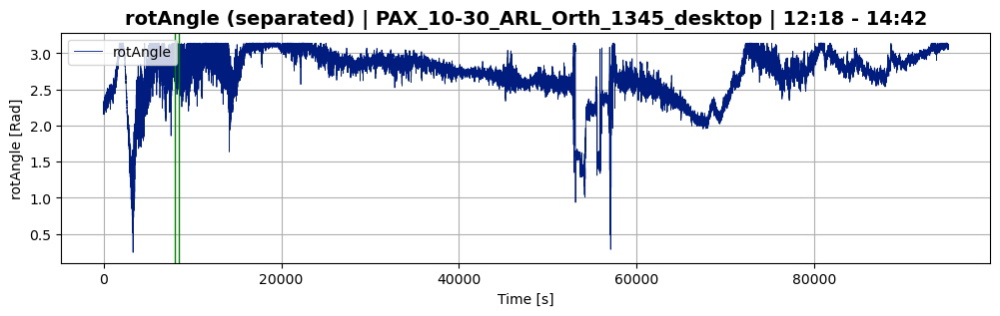

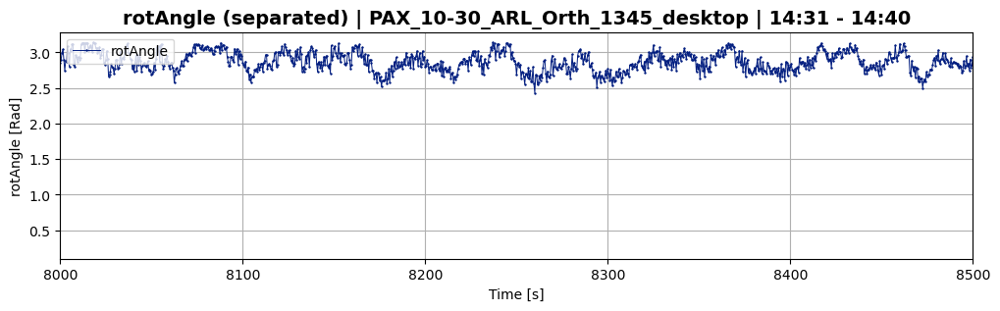

In [16]:
ds_ARL_1345_1030.plot_separated(plot_param='rotAngle',sample_range=(8000,8500))

#### Input SOPs as reference for entire dataset with IOPair: 11-15 Manual Movement Channel Comparison

1345 channel

In [50]:
plt.ioff()
plt.close('all')

In [51]:
filepath_Manual_1345='Datasets/Whole_setup/11-15/PAX_11-15_Manual_Orth_1345_desktop.csv'
filepath_Manual_1345_input='Datasets/Whole_setup/11-15/PAX_11-15_Manual_Orth_1345_input_laptop.csv'
my_pair_1345 = IOPair(filepath_Manual_1345, filepath_Manual_1345_input)

Using skip time of 8.0 seconds for input dataset
Time range: min=8.011, max=60.005
	Choosing assign_by parameter automatically; 	Using assign_by = "s2Avg" where dif = 1.09
	Dif = 1.09 for s2Avg is positive; not switching signals
	First measurement of Signal 1:  [-2.011375, -0.19012500000000002, 0.060643749999999996]
	First measurement of Signal 2:  [-0.07614, 1.9624444444444444, 0.09056666666666667]
Time range: min=0.031, max=60.005


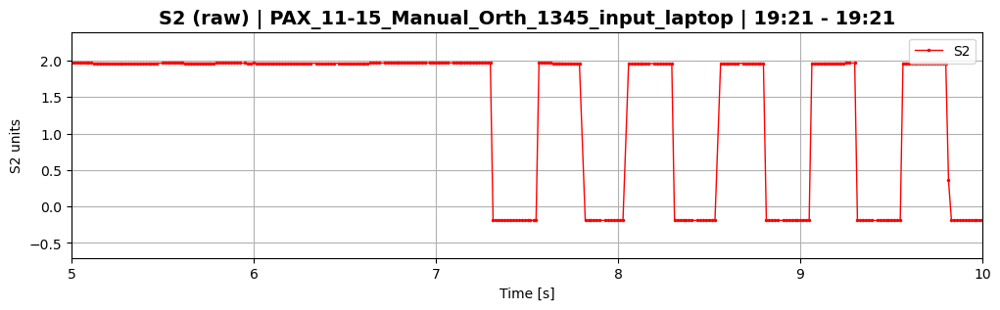

Using skip time of 12.5 seconds for output dataset
Time range: min=12.503, max=61.824
	Choosing assign_by parameter automatically; 	Using assign_by = "s2Avg" where dif = -1.01
	Dif = -1.01 for s2Avg is negative; switching signals
	First measurement of Signal 1:  [-1.273, -0.026734444444444443, -0.2779111111111111]
	First measurement of Signal 2:  [-0.055843, 1.331, 0.19792]
Time range: min=0.085, max=61.824


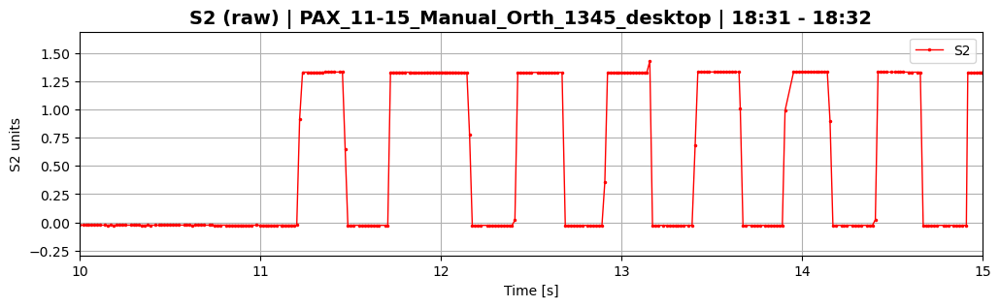

In [52]:
my_pair_1345.match_IO_plot(output_set_range=(0,0.1),output_plot_range=(10,15),output_skip_time=12.5)

In [54]:
# For input, default is signal 2
# For output, default is signal 1
my_pair_1345.set_signal_switch(True)   # We need to switch the signal arrays used as input

	Begin averaging INPUT dataset...

Time range: min=8.011, max=60.005

	INPUT dataset averaged successfully


	Begin averaging OUTPUT dataset...

Time range: min=12.503, max=603.946
Determining change point ranges automatically...
Using change_point_range_1=(12.503, 112.503)
Using change_point_range_2=(503.946, 603.946)
=== performing change point detection ===
cp range: (12.503, 112.503)
using 5760 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5760,)
computing range... ---> range = (0.91,0.96)
displaying jump_fig for switch parameter = s1



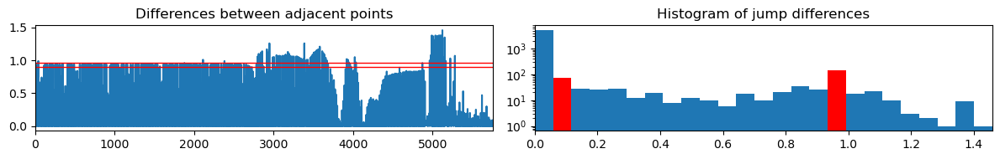



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5760,)
computing range... ---> range = (1.00,1.06)
displaying jump_fig for switch parameter = s2



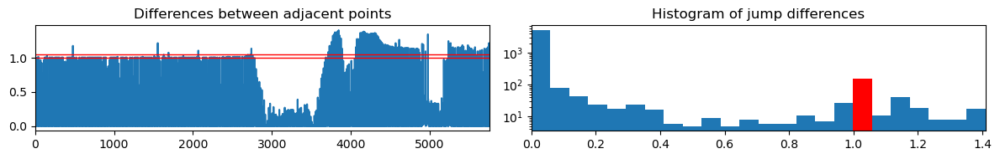



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5760,)
computing range... ---> range = (0.29,0.35)
displaying jump_fig for switch parameter = s3



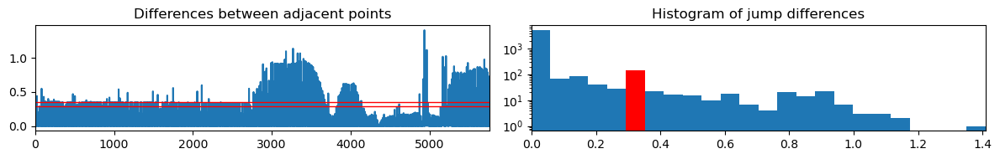



found width of 0.059 for s3
greater than prev width of 0.059 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.29,0.35)
Jump points detected: 143
out of total: ~400.0

computing offset...


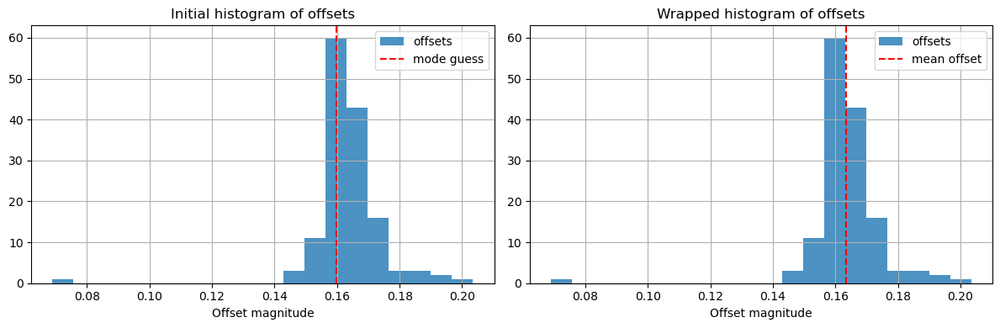



offset = 0.163 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (503.946, 603.946)
using 5830 data entries
skipping 28528 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5830,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s1



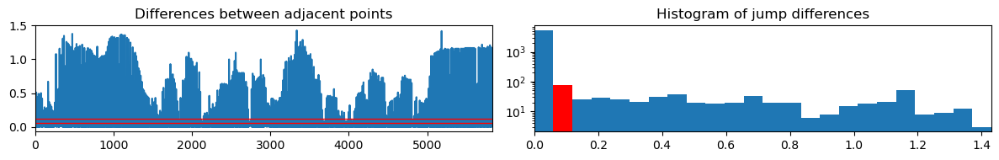



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5830,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s2



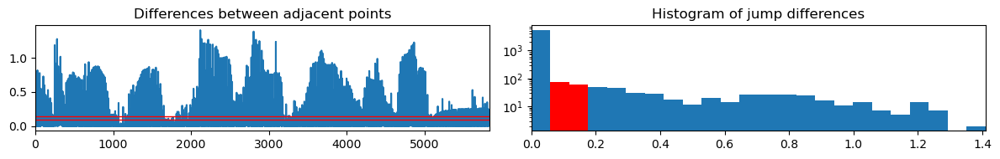



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5830,)
computing range... ---> range = (0.67,0.73)
displaying jump_fig for switch parameter = s3



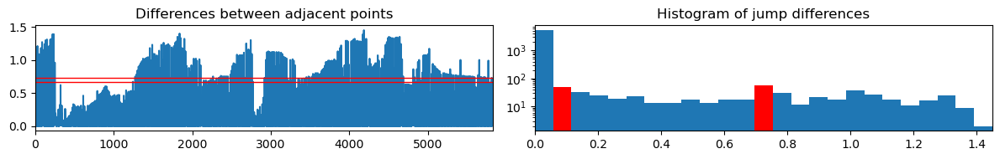



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.06,0.12)
Jump points detected: 74
out of total: ~400.0

computing offset...


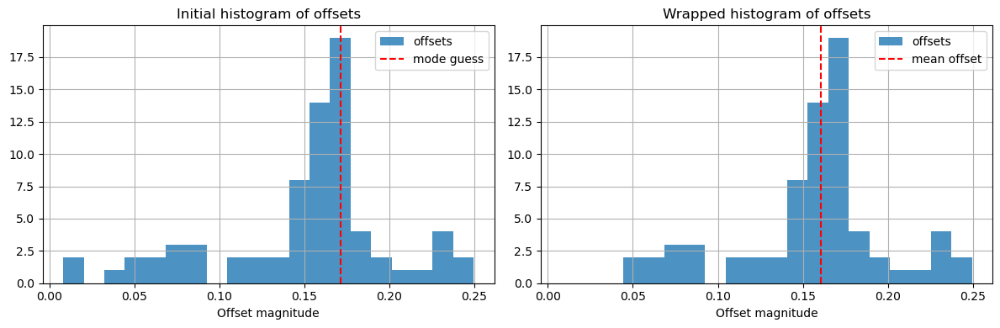



offset = 0.161 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.003 seconds over 1965.7720000000002 switches
Corrected Switch Time = 0.2499987
=== starting average_data ===
averaging data... Done
Dropped 10 observations with <4 points (out of total 2362 observations)

--- interpolating data ---
length before: 1174
length after: 1182
8 total added
--- end interpolating data ---

--- interpolating data ---
length before: 1178
length after: 1182
4 total added
--- end interpolating data ---
Signal 1 size=1182	Signal 1 range: t=(12.79,603.29)
Signal 2 size=1182	Signal 2 range: t=(13.04,603.54)
=== end average_data ===

	OUTPUT dataset averaged successfully



	Begin PTF calculations for INPUT/OUTPUT dataset pair...


	PTF calculations for INPUT/OUTPUT dataset pair performed successfully!!


In [55]:
ds_Manual_1345 = my_pair_1345.get_full_ds()

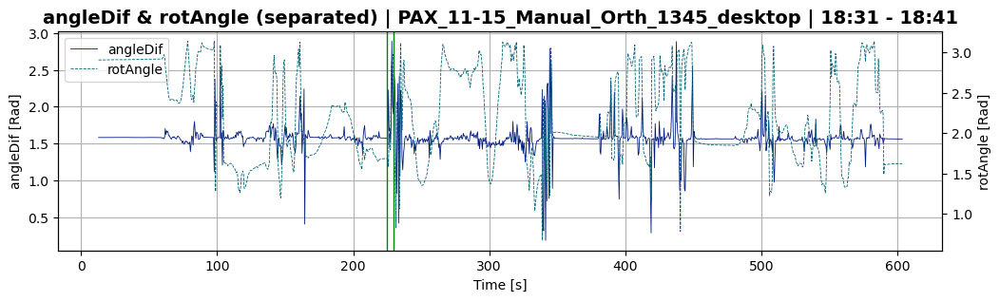

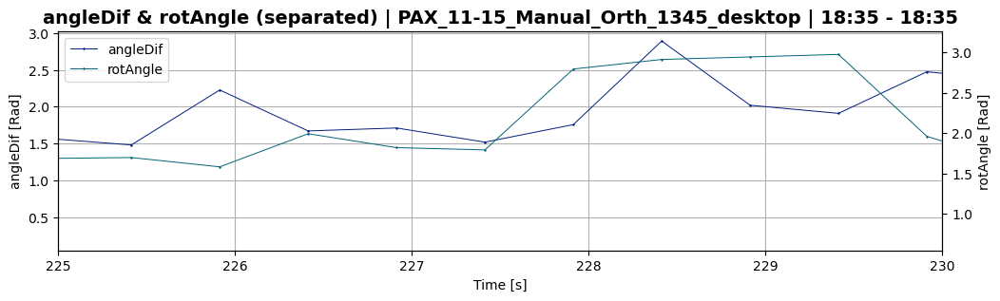

In [58]:
ds_Manual_1345.plot_separated(plot_param='angleDif',plot_param_2='rotAngle',sample_range=(225,230))

1560 channel

In [64]:
plt.ioff()
plt.close('all')

In [60]:
filepath_Manual_1560='Datasets/Whole_setup/11-15/PAX_11-15_Manual_Orth_1560_laptop.csv'
filepath_Manual_1560_input='Datasets/Whole_setup/11-15/PAX_11-15_Manual_Orth_1560_input_laptop.csv'
my_pair_1560 = IOPair(filepath_Manual_1560, filepath_Manual_1560_input)

Using skip time of 8.0 seconds for input dataset
Time range: min=8.013, max=59.996
	Choosing assign_by parameter automatically; 	Using assign_by = "s1Avg" where dif = 1.01
	Dif = 1.01 for s1Avg is positive; not switching signals
	First measurement of Signal 1:  [-2.271333333333333, 0.024167777777777778, -0.12487777777777777]
	First measurement of Signal 2:  [0.0270025, 2.2824999999999998, 0.2133625]
Time range: min=0.04, max=59.996


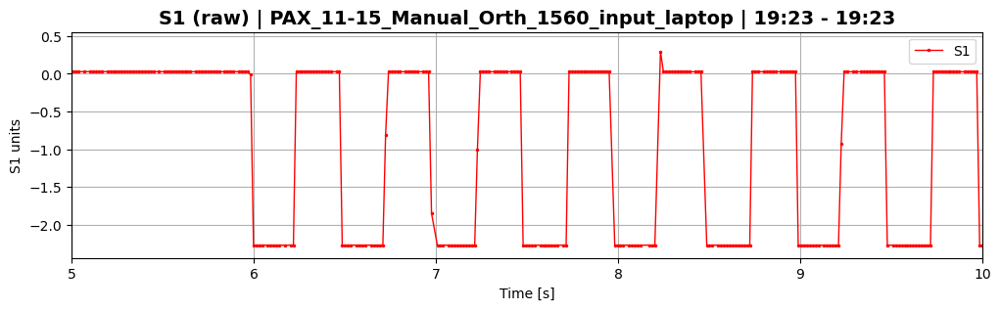

Using skip time of 12.0 seconds for output dataset
Time range: min=12.0, max=61.834
	Choosing assign_by parameter automatically; 	Using assign_by = "s1Avg" where dif = -1.17
	Dif = -1.17 for s1Avg is negative; switching signals
	First measurement of Signal 1:  [-1.548, -0.5236571428571428, -0.2937571428571429]
	First measurement of Signal 2:  [0.3828, -0.3125142857142857, -1.543]
Time range: min=0.048, max=61.834


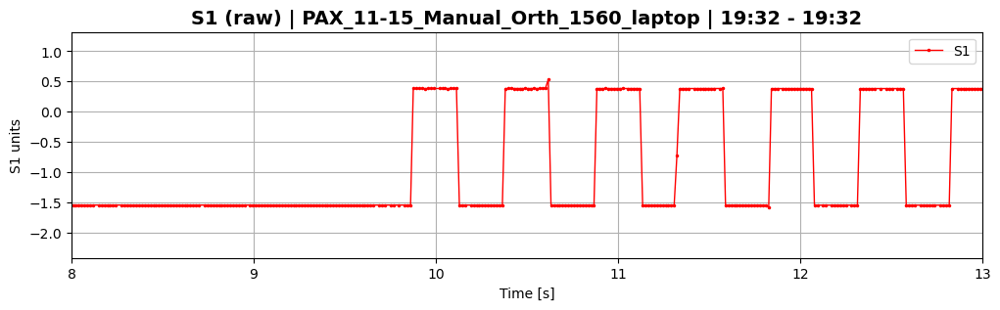

In [65]:
my_pair_1560.match_IO_plot(output_set_range=(0,0.1),output_plot_range=(8,13),output_skip_time=12)

In [66]:
# For input, default is signal 2
# For output, default is signal 1
my_pair_1560.set_signal_switch(True)   # We need to switch the signal arrays used as input

	======Begin averaging INPUT dataset...======

Time range: min=8.013, max=59.996

	======INPUT dataset averaged successfully======


	======Begin averaging OUTPUT dataset...======

Time range: min=12.0, max=603.831
Determining change point ranges automatically...
Using change_point_range_1=(12.0, 112.0)
Using change_point_range_2=(503.831, 603.831)
=== performing change point detection ===
cp range: (12.0, 112.0)
using 5772 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5772,)
computing range... ---> range = (1.11,1.17)
displaying jump_fig for switch parameter = s1



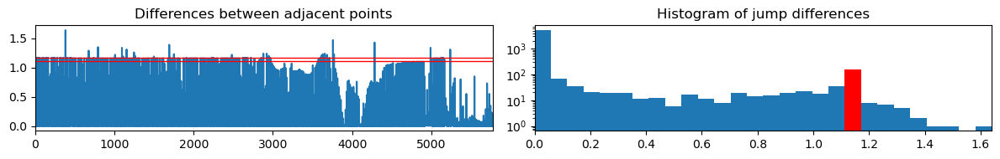



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5772,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s2



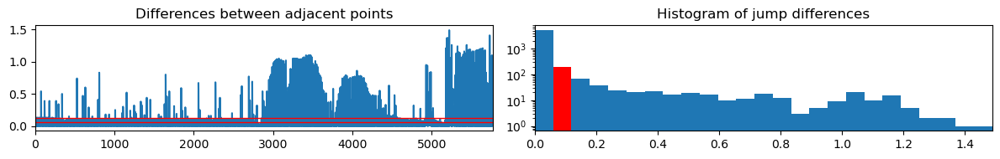



found width of 0.060 for s2
greater than prev width of 0.059 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5772,)
computing range... ---> range = (0.72,0.78)
displaying jump_fig for switch parameter = s3



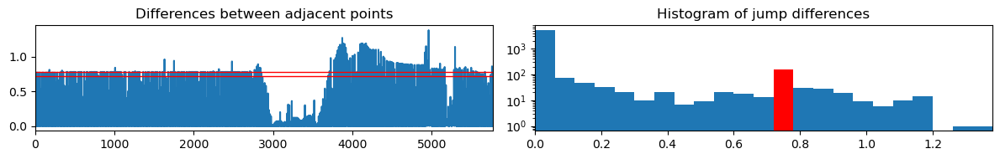



found width of 0.060 for s3
greater than prev width of 0.060 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.72,0.78)
Jump points detected: 157
out of total: ~400.0

computing offset...


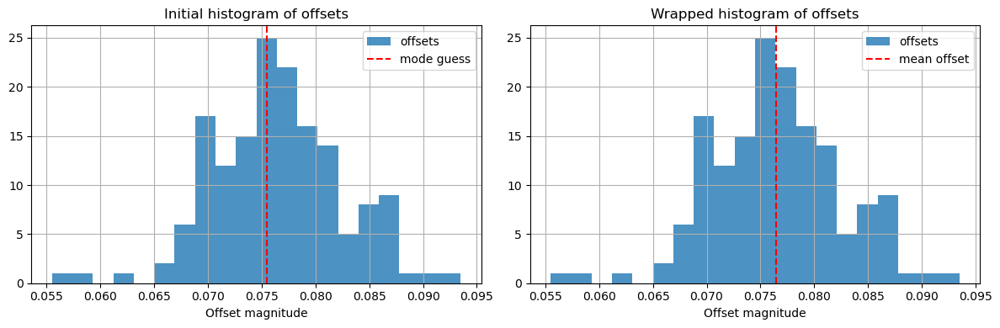



offset = 0.076 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (503.831, 603.831)
using 5839 data entries
skipping 29409 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5839,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s1



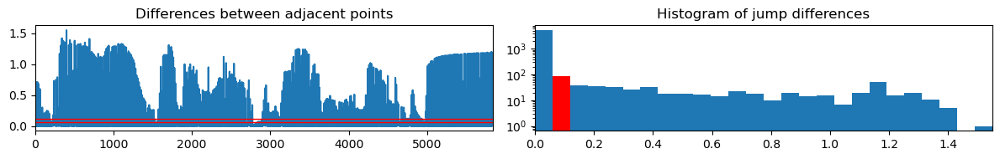



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5839,)
computing range... ---> range = (0.47,0.53)
displaying jump_fig for switch parameter = s2



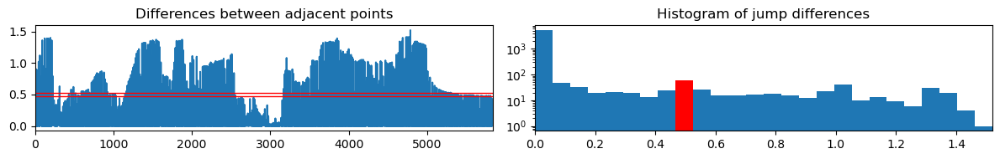



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5839,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s3



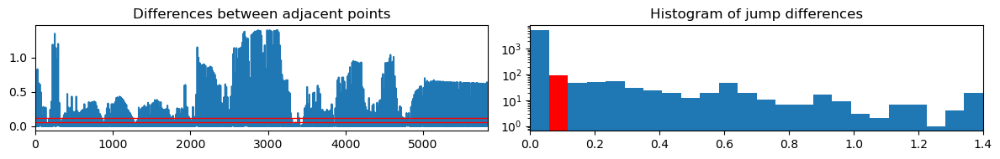



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.06,0.12)
Jump points detected: 87
out of total: ~400.0

computing offset...


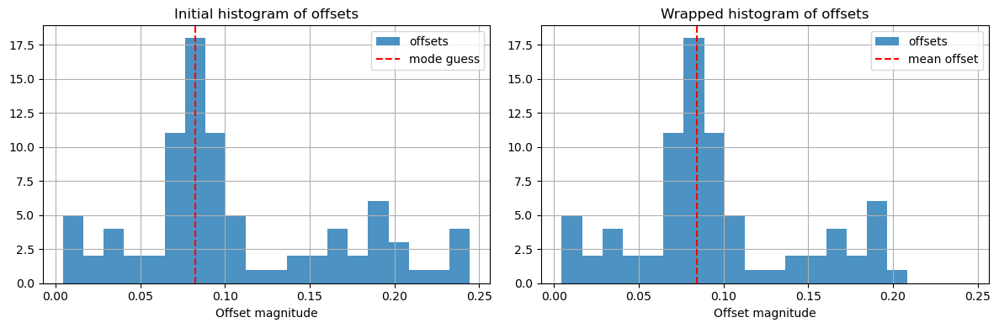



offset = 0.084 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.008 seconds over 1967.324 switches
Corrected Switch Time = 0.2500041
=== starting average_data ===
averaging data... Done
Dropped 3 observations with <4 points (out of total 2363 observations)

--- interpolating data ---
length before: 1180
length after: 1183
3 total added
--- end interpolating data ---

--- interpolating data ---
length before: 1180
length after: 1183
3 total added
--- end interpolating data ---
Signal 1 size=1183	Signal 1 range: t=(12.20,603.21)
Signal 2 size=1183	Signal 2 range: t=(12.45,603.46)
=== end average_data ===

	======OUTPUT dataset averaged successfully======



	======Begin PTF calculations for INPUT/OUTPUT dataset pair...======


	======PTF calculations for INPUT/OUTPUT dataset pair performed successfully!!======


In [67]:
ds_Manual_1560 = my_pair_1560.get_full_ds()

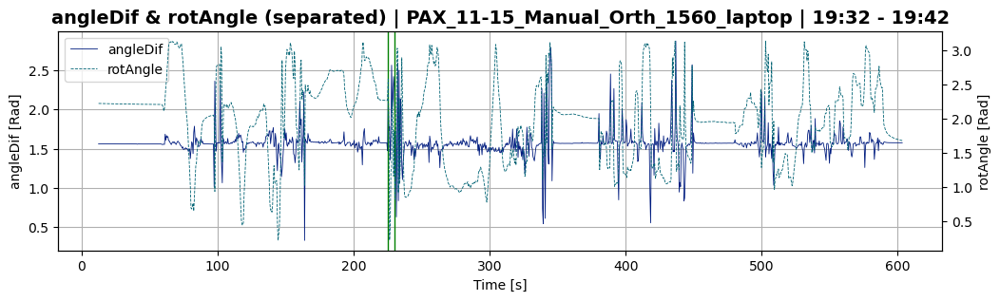

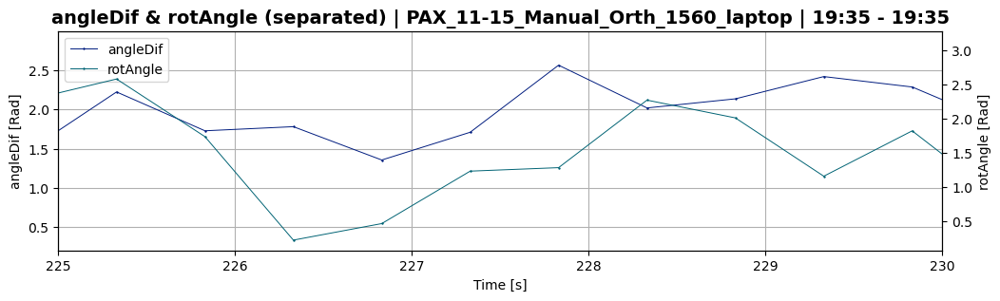

In [68]:
ds_Manual_1560.plot_separated(plot_param='angleDif',plot_param_2='rotAngle',sample_range=(225,230))

### Resetting reference SOPs

#### Connector dataset 08-17

##### 1345 dataset

In [29]:
plt.ioff()
plt.close('all')

In [8]:
# filename = 'Datasets/Whole_setup/08-17/PAX_08-17_Connector_Orth_1_1345.csv'
# ds_test = Dataset(filename)
# ds_test.plot_raw(plot_param="S1",sample_range=(385,390))

Time range: min=390.004, max=7512.632
Determining change point ranges automatically...
Using change_point_range_1=(390.004, 490.004)
Using change_point_range_2=(3390.004, 3490.004)
=== performing change point detection ===
cp range: (390.004, 490.004)
using 6730 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6730,)
computing range... ---> range = (1.70,1.75)
displaying jump_fig for switch parameter = s1



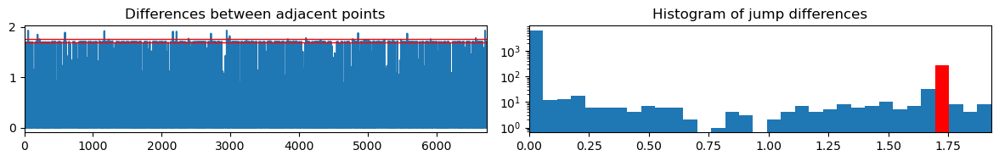



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6730,)
computing range... ---> range = (0.83,0.89)
displaying jump_fig for switch parameter = s2



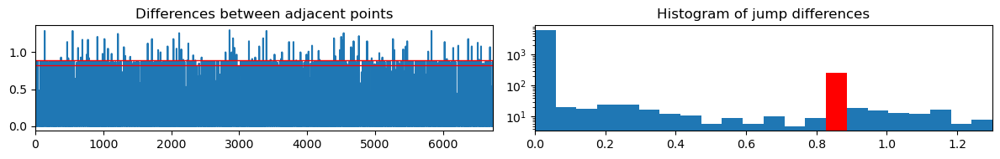



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6730,)
computing range... ---> range = (0.40,0.46)
displaying jump_fig for switch parameter = s3



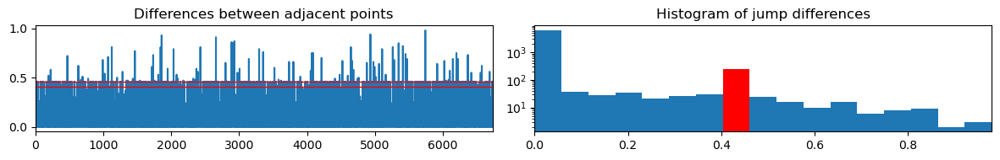



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (0.83,0.89)
Jump points detected: 257
out of total: ~399.9

computing offset...


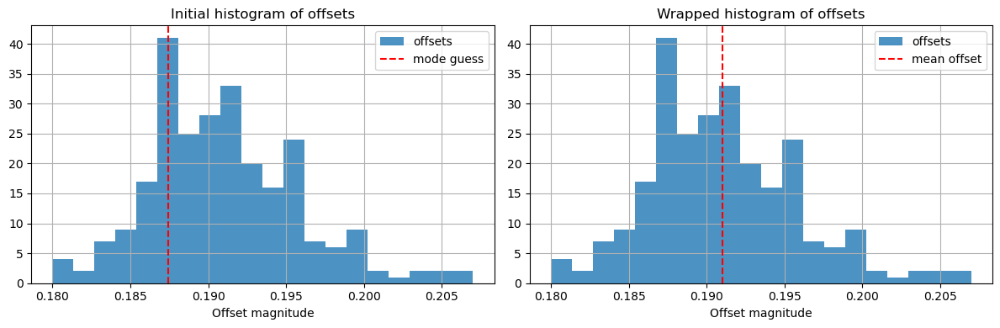



offset = 0.191 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3390.004, 3490.004)
using 6836 data entries
skipping 203792 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6836,)
computing range... ---> range = (1.64,1.70)
displaying jump_fig for switch parameter = s1



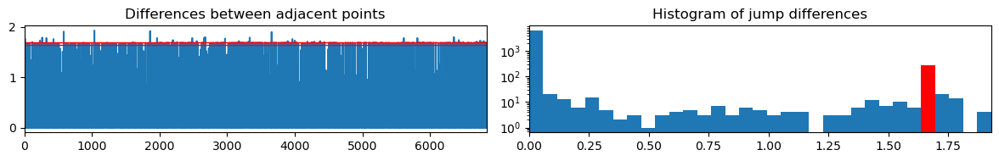



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6836,)
computing range... ---> range = (0.93,0.99)
displaying jump_fig for switch parameter = s2



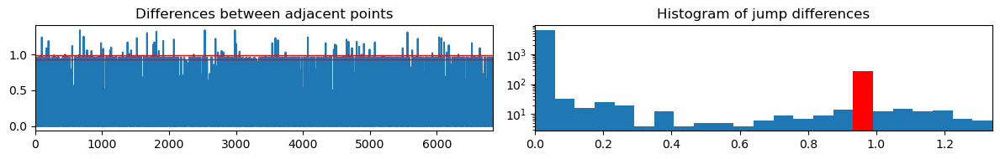



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6836,)
computing range... ---> range = (0.29,0.34)
displaying jump_fig for switch parameter = s3



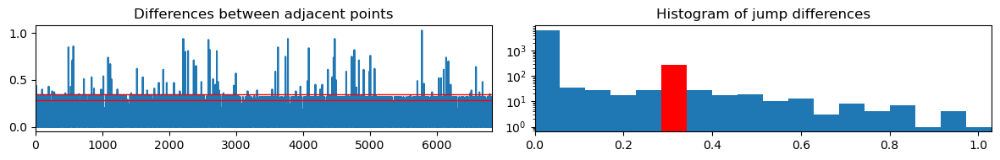



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (1.64,1.70)
Jump points detected: 288
out of total: ~400.0

computing offset...


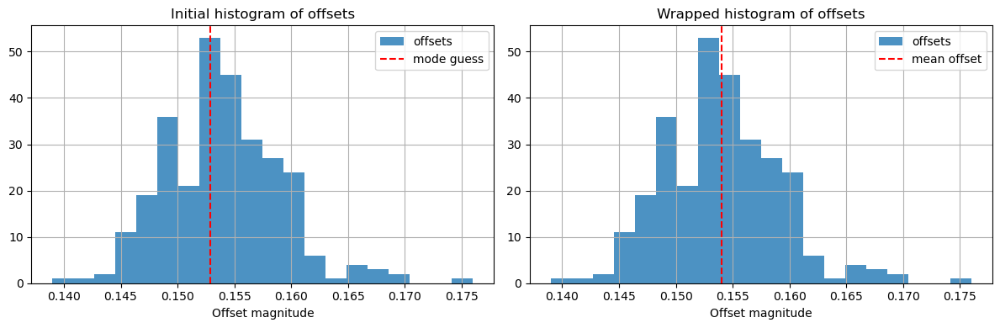



offset = 0.154 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.037 seconds over 12000.0 switches
Corrected Switch Time = 0.2499969


In [31]:
filename = 'Datasets/Whole_setup/08-17/PAX_08-17_Connector_Orth_1_1345.csv'
#ds = SwitchSet(filename, skip_default_signal_baseline=14)
#ds.find_switches(nominal_switch_rate=2, change_point_range_1=(15,50), print_process=True)
ds_1345 = SwitchSet(filename, skip_default_signal_baseline=390)
ds_1345.find_switches(nominal_switch_rate=2, print_process=True)

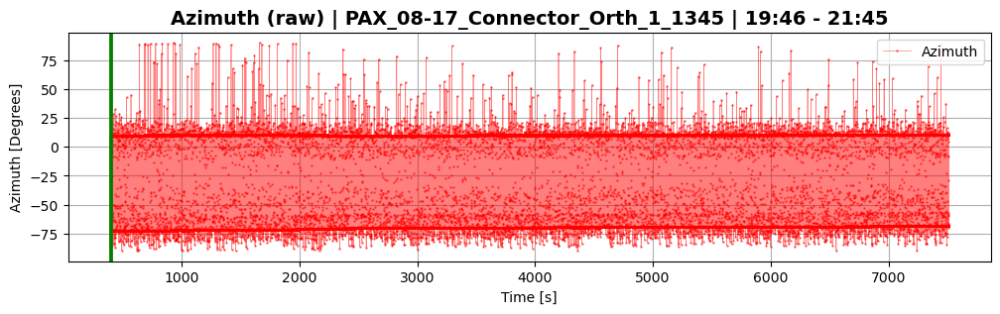

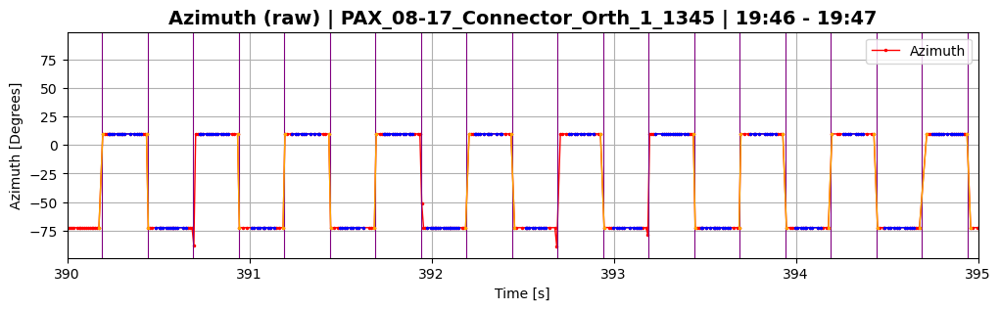

In [32]:
ds_1345.plot_raw(plot_param='Azimuth', sample_range=(390,395),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

In [33]:
ds_1345.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 38 observations with <4 points (out of total 28353 observations)

--- interpolating data ---
length before: 14158
length after: 14245
87 total added
--- end interpolating data ---

--- interpolating data ---
length before: 14157
length after: 14243
86 total added
--- end interpolating data ---
Signal 1 size=14243	Signal 1 range: t=(390.57,7511.48)
Signal 2 size=14245	Signal 2 range: t=(390.32,7512.23)
=== end average_data ===


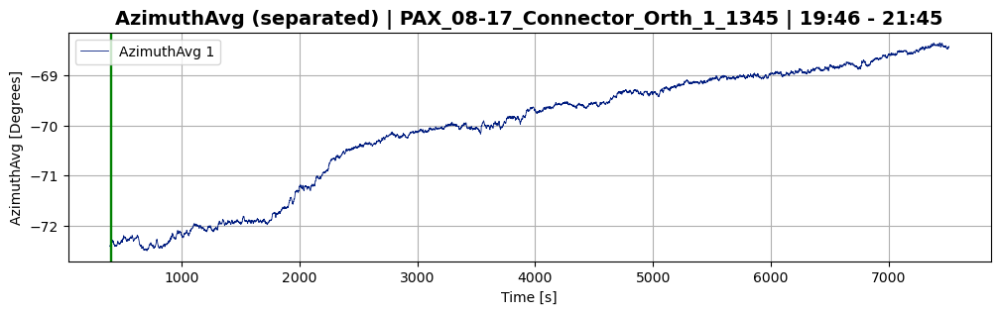

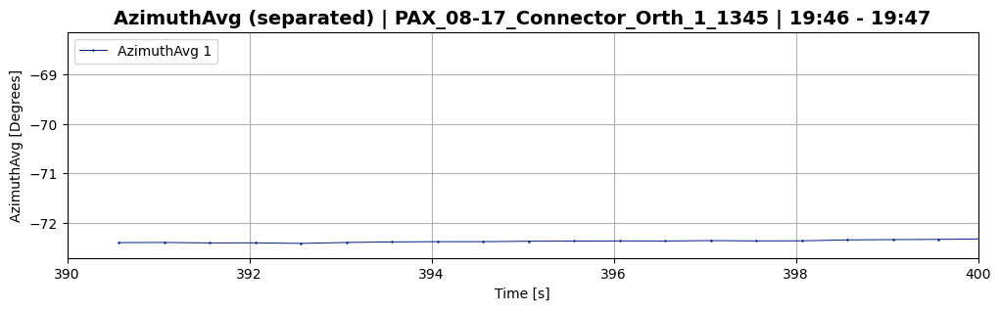

In [34]:
ds_1345.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(390,400))

In [35]:
reset_times_1345 = ds_1345.calc_stokes_ptf(reference=None, angle_threshold_deg=2, print_process=True);

Using "resetting reference SOPs" approach with threshold = 2.0 degrees
Reference matrix was reset 10 times
Reset at time t=570.94
Reset at time t=912.44
Reset at time t=1518.43
Reset at time t=1919.42
Reset at time t=2211.42
Reset at time t=2392.92
Reset at time t=3273.91
Reset at time t=4292.89
Reset at time t=6339.87
Reset at time t=7395.36


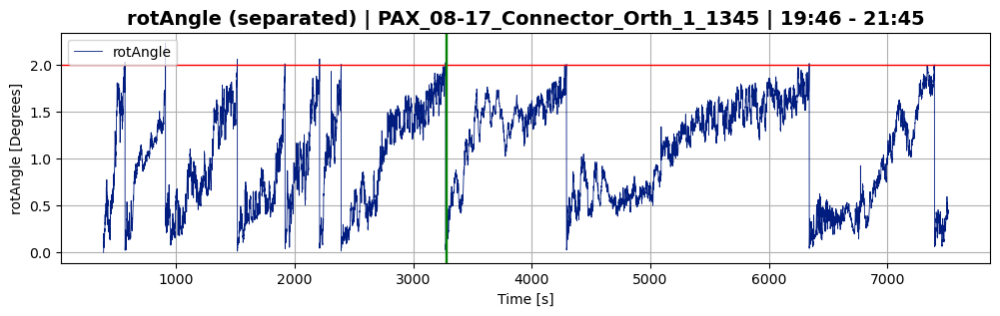

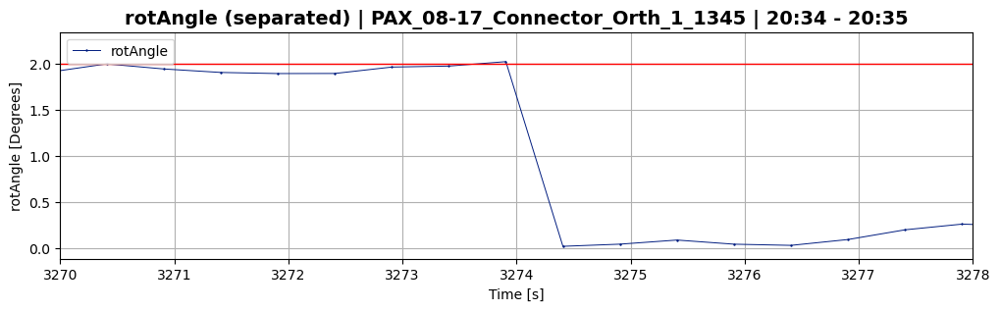

In [36]:
ds_1345.plot_separated(plot_param='rotAngle',plot_signal=1,sample_range=(3270,3278))

##### 1560 dataset

Time range: min=390.006, max=7513.214
Determining change point ranges automatically...
Using change_point_range_1=(390.006, 490.006)
Using change_point_range_2=(3390.006, 3490.006)
=== performing change point detection ===
cp range: (390.006, 490.006)
using 5473 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5473,)
computing range... ---> range = (0.71,0.77)
displaying jump_fig for switch parameter = s1



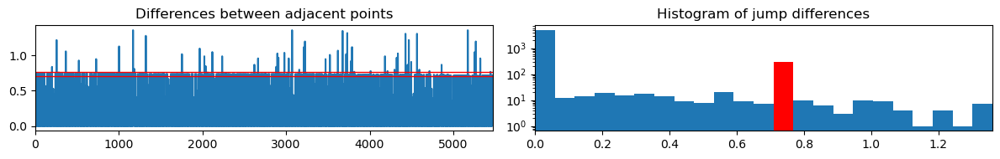



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5473,)
computing range... ---> range = (1.81,1.87)
displaying jump_fig for switch parameter = s2



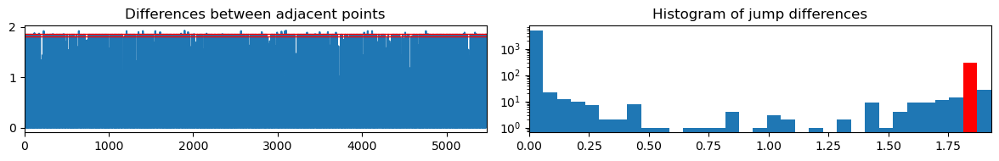



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5473,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s3



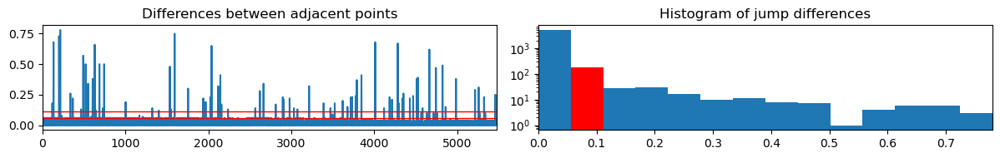



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.71,0.77)
Jump points detected: 296
out of total: ~400.0

computing offset...


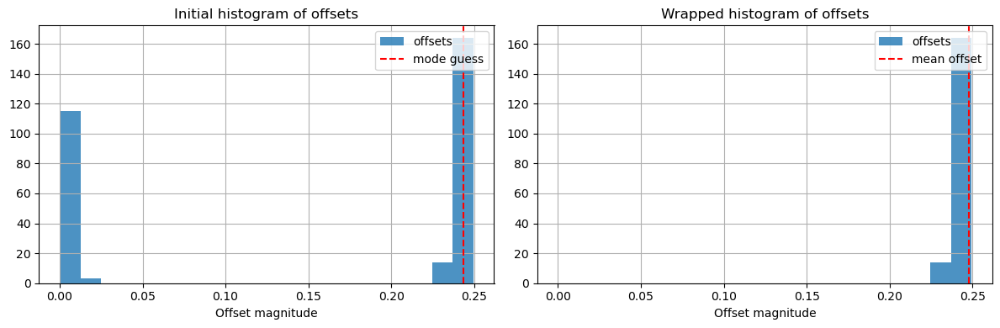



offset = 0.248 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3390.006, 3490.006)
using 5438 data entries
skipping 164666 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5438,)
computing range... ---> range = (0.36,0.42)
displaying jump_fig for switch parameter = s1



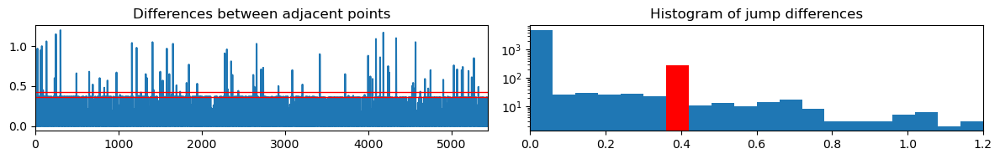



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5438,)
computing range... ---> range = (1.93,1.99)
displaying jump_fig for switch parameter = s2



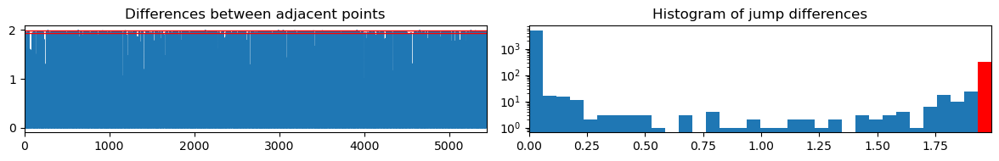



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5438,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s3



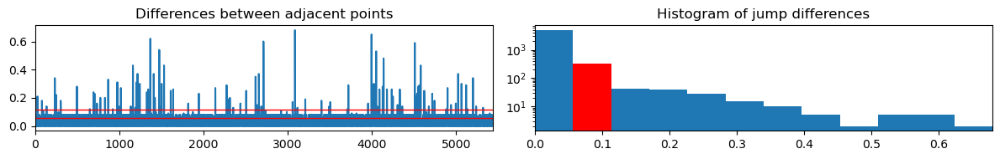



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.36,0.42)
Jump points detected: 281
out of total: ~399.8

computing offset...


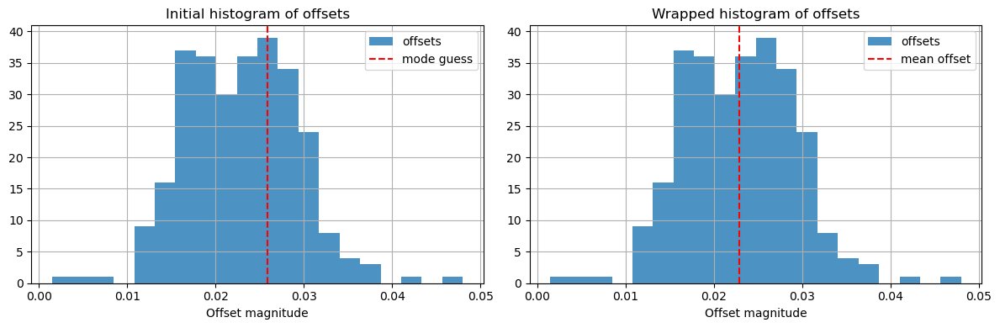



offset = 0.023 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.025 seconds over 12000.0 switches
Corrected Switch Time = 0.2500021


In [37]:
filename = 'Datasets/Whole_setup/08-17/PAX_08-17_Connector_Orth_1_1560.csv'
#ds = SwitchSet(filename, skip_default_signal_baseline=14)
#ds.find_switches(nominal_switch_rate=2, change_point_range_1=(15,50), print_process=True)
ds_1560 = SwitchSet(filename, skip_default_signal_baseline=390)
ds_1560.find_switches(nominal_switch_rate=2, print_process=True)

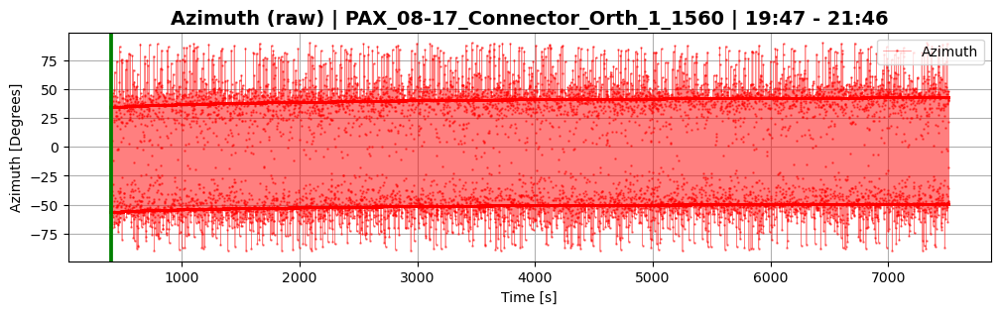

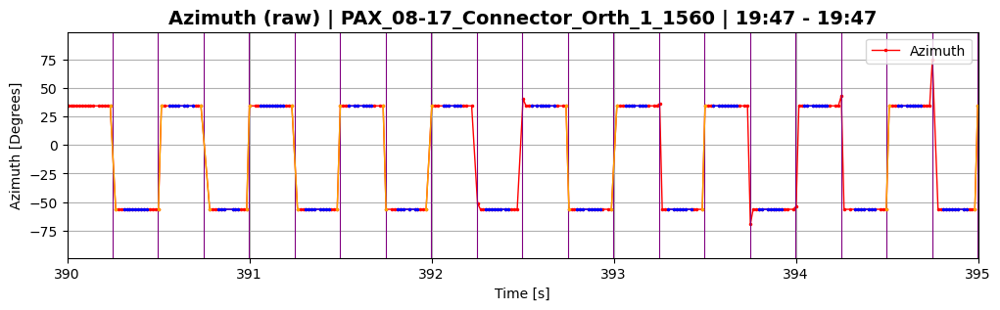

In [38]:
ds_1560.plot_raw(plot_param='Azimuth', sample_range=(390,395),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

In [39]:
ds_1560.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 6 observations with <4 points (out of total 28491 observations)

--- interpolating data ---
length before: 14243
length after: 14246
3 total added
--- end interpolating data ---

--- interpolating data ---
length before: 14242
length after: 14245
3 total added
--- end interpolating data ---
Signal 1 size=14246	Signal 1 range: t=(390.37,7512.93)
Signal 2 size=14245	Signal 2 range: t=(390.62,7512.68)
=== end average_data ===


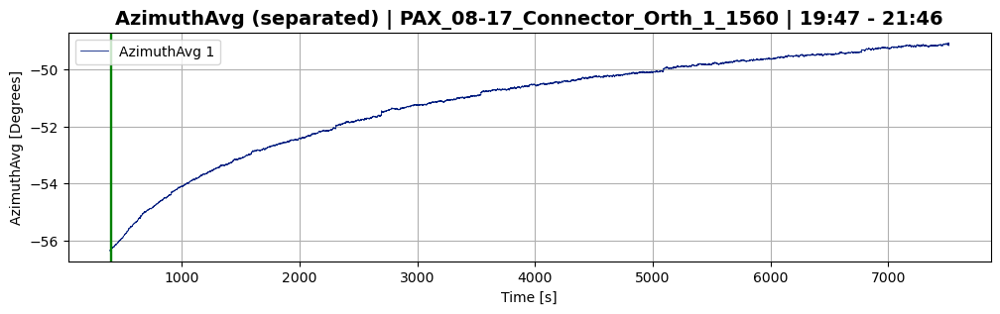

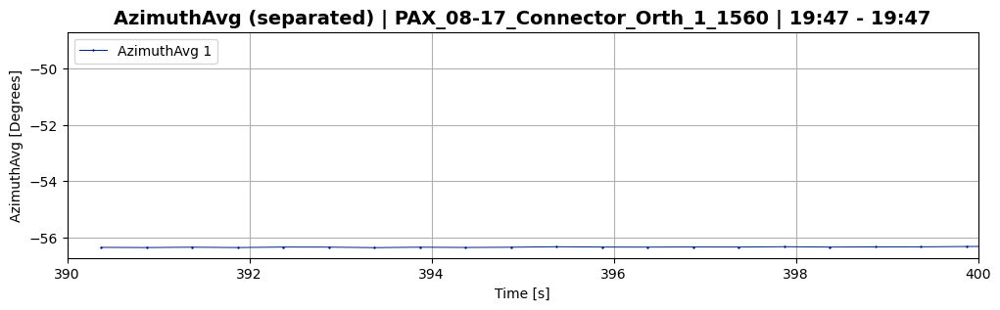

In [40]:
ds_1560.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(390,400))

In [41]:
reset_times_1560 = ds_1560.calc_stokes_ptf(reference=reset_times_1345, angle_threshold_deg=2, print_process=True);

Using provided reset times to reset reference matrix
Reference matrix was reset 10 times
Reset at time t=571.00
Reset at time t=912.50
Reset at time t=1518.51
Reset at time t=1919.51
Reset at time t=2211.51
Reset at time t=2393.01
Reset at time t=3274.02
Reset at time t=4293.03
Reset at time t=6340.05
Reset at time t=7395.56


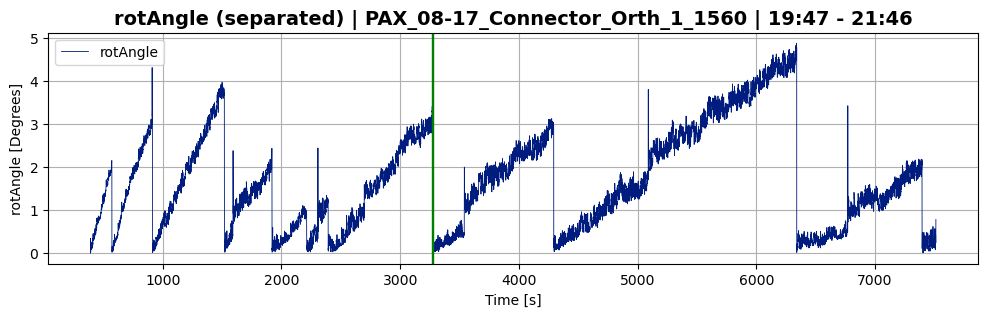

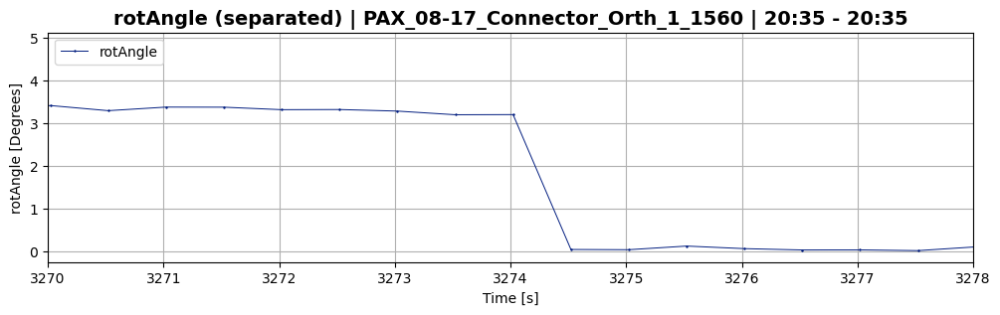

In [42]:
ds_1560.plot_separated(plot_param='rotAngle',plot_signal=1,sample_range=(3270,3278))

##### Both 1345 and 1560 rotAngle

In [44]:
ds_con_08_17 = (ds_1345, ds_1560)

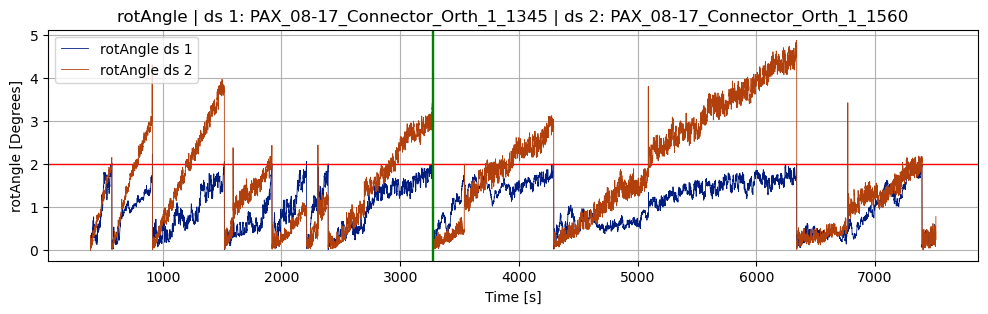

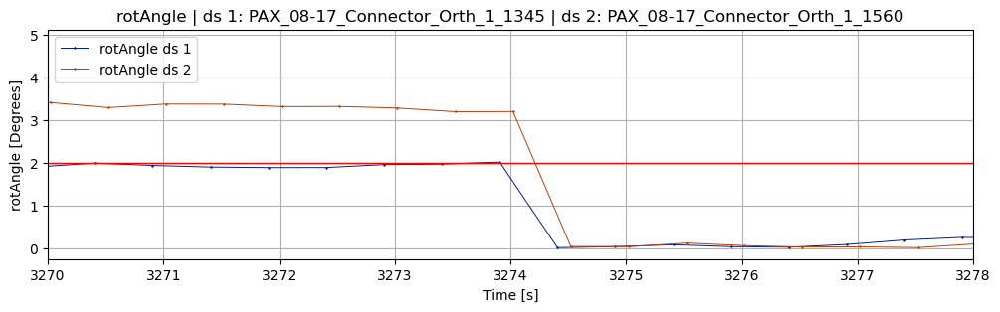

In [43]:
plot_rot_angle(ds_1345, ds_1560, birds_eye=True, sample_range=(3270,3278))

#### ARL dataset 08-17

##### 1345 dataset

In [45]:
plt.ioff()
plt.close('all')

Time range: min=20.005, max=922.238


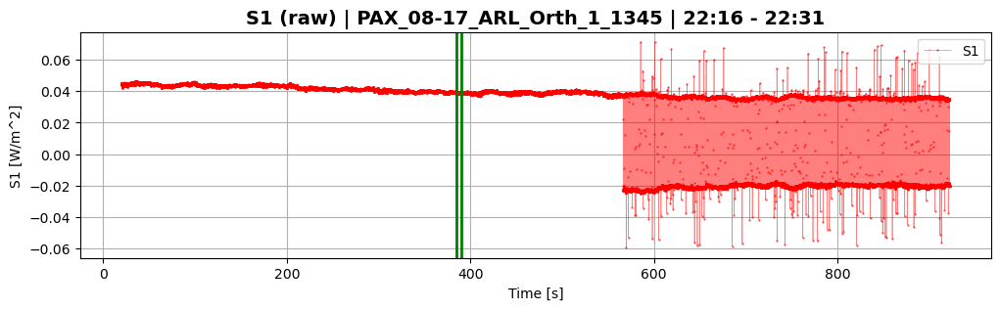

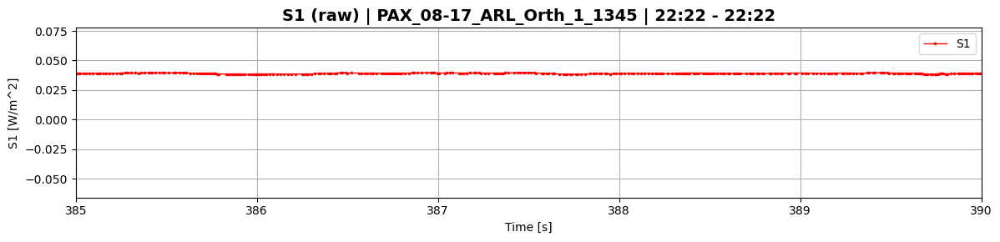

(<Figure size 1200x300 with 1 Axes>, <Figure size 1200x300 with 1 Axes>)

In [48]:
# filename = 'Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
# ds_test = Dataset(filename,set_range=(0,0.02))
# ds_test.plot_raw(plot_param="S1",sample_range=(565,575))

Time range: min=570.005, max=6617.293
Determining change point ranges automatically...
Using change_point_range_1=(570.005, 670.005)
Using change_point_range_2=(3570.005, 3670.005)
=== performing change point detection ===
cp range: (570.005, 670.005)
using 6415 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6415,)
computing range... ---> range = (0.91,0.96)
displaying jump_fig for switch parameter = s1



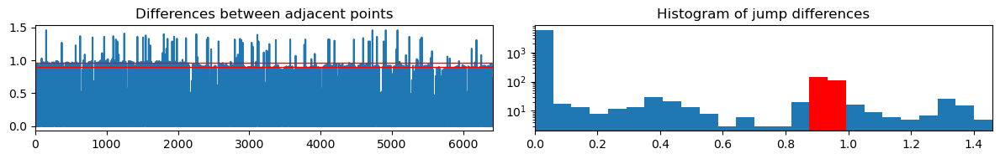



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6415,)
computing range... ---> range = (0.09,0.14)
displaying jump_fig for switch parameter = s2



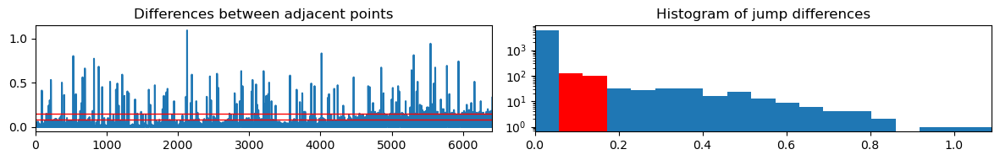



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6415,)
computing range... ---> range = (1.68,1.74)
displaying jump_fig for switch parameter = s3



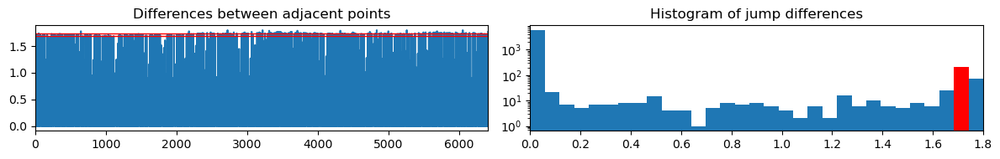



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.91,0.96)
Jump points detected: 137
out of total: ~400.0

computing offset...


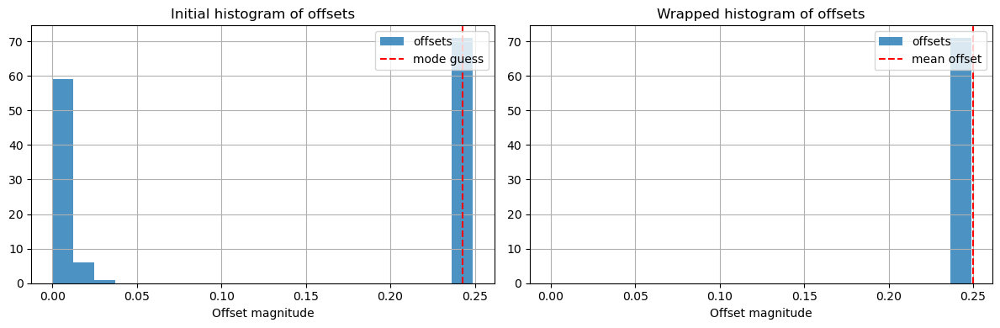



offset = 0.250 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3570.005, 3670.005)
using 6728 data entries
skipping 201483 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6728,)
computing range... ---> range = (0.32,0.38)
displaying jump_fig for switch parameter = s1



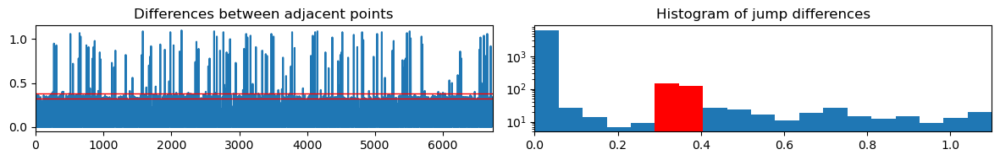



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6728,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s2



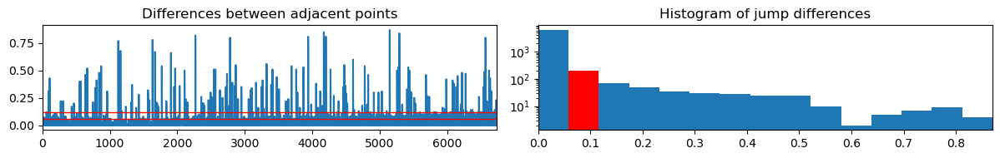



found width of 0.058 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6728,)
computing range... ---> range = (1.89,1.95)
displaying jump_fig for switch parameter = s3



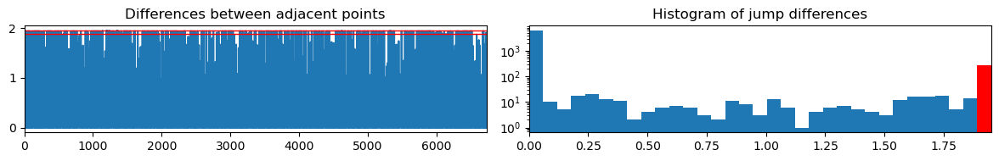



found width of 0.059 for s3
greater than prev width of 0.058 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.89,1.95)
Jump points detected: 267
out of total: ~400.0

computing offset...


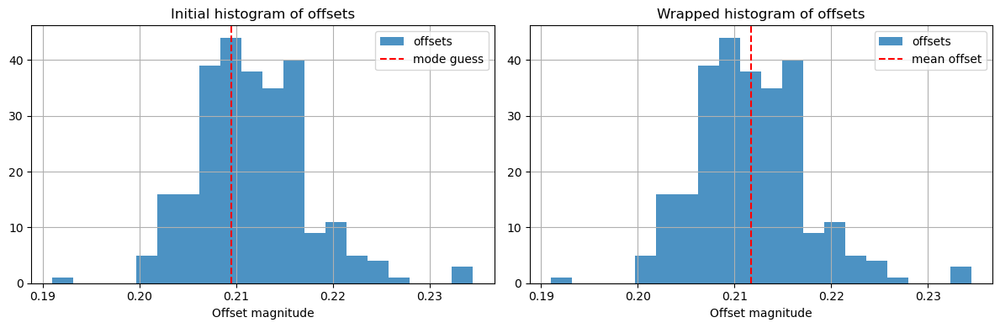



offset = 0.212 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.038 seconds over 12000.0 switches
Corrected Switch Time = 0.2499968


In [111]:
filename = 'Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1345.csv'
#ds = SwitchSet(filename, skip_default_signal_baseline=14)
#ds.find_switches(nominal_switch_rate=2, change_point_range_1=(15,50), print_process=True)
ds_1345 = SwitchSet(filename, set_range=(0,0.15), skip_default_signal_baseline=570)
ds_1345.find_switches(nominal_switch_rate=2, print_process=True)

In [112]:
ds_1345.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 15 observations with <4 points (out of total 24050 observations)

--- interpolating data ---
length before: 12021
length after: 12094
73 total added
--- end interpolating data ---

--- interpolating data ---
length before: 12014
length after: 12094
80 total added
--- end interpolating data ---
Signal 1 size=12094	Signal 1 range: t=(570.38,6616.80)
Signal 2 size=12094	Signal 2 range: t=(570.63,6617.05)
=== end average_data ===


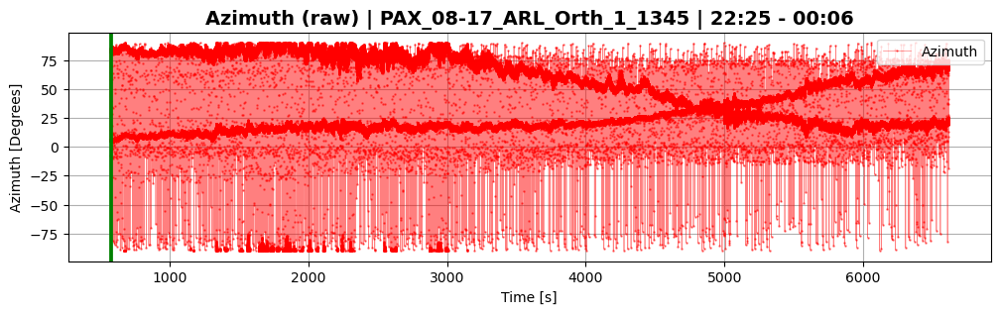

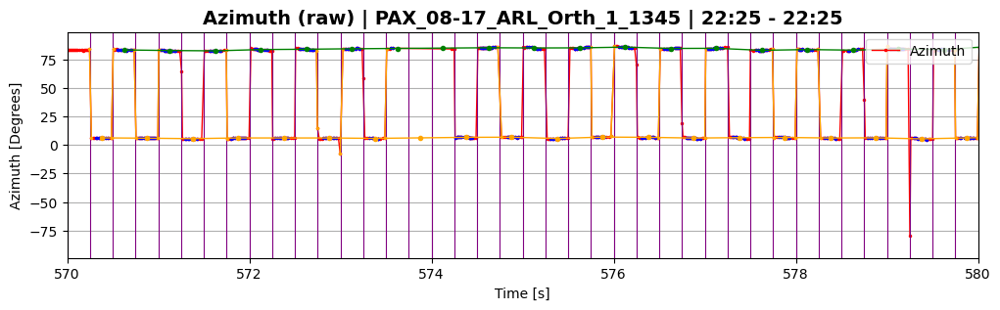

In [113]:
ds_1345.plot_raw(plot_param='Azimuth', sample_range=(570,580),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

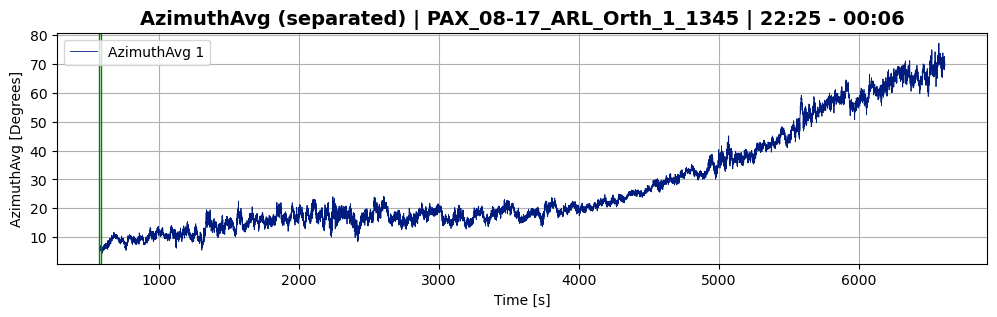

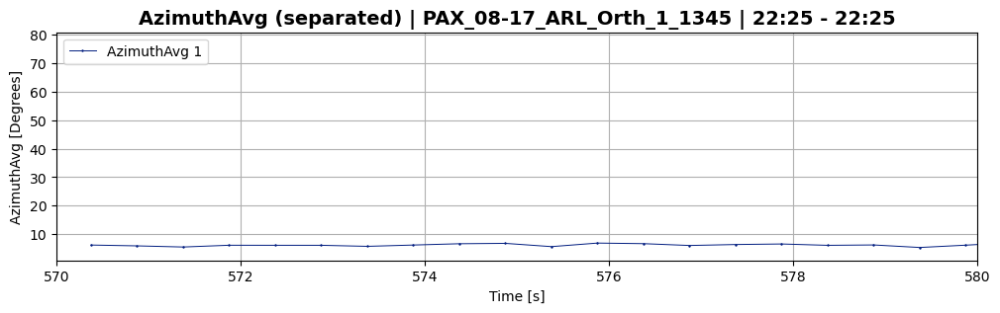

In [114]:
ds_1345.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(570,580))

In [115]:
reset_times_1345 = ds_1345.calc_stokes_ptf(reference=None, angle_threshold_deg=12, print_process=True);

Using "resetting reference SOPs" approach with threshold = 12.0 degrees
Reference matrix was reset 34 times
Reset at time t=855.50
Reset at time t=1149.49
Reset at time t=1154.99
Reset at time t=1166.49
Reset at time t=1177.99
Reset at time t=1362.99
Reset at time t=1370.49
Reset at time t=1724.49
Reset at time t=1752.49
Reset at time t=1867.48
...


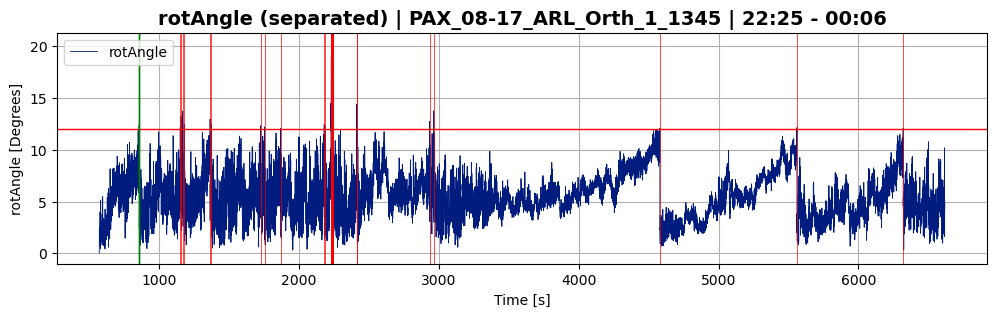

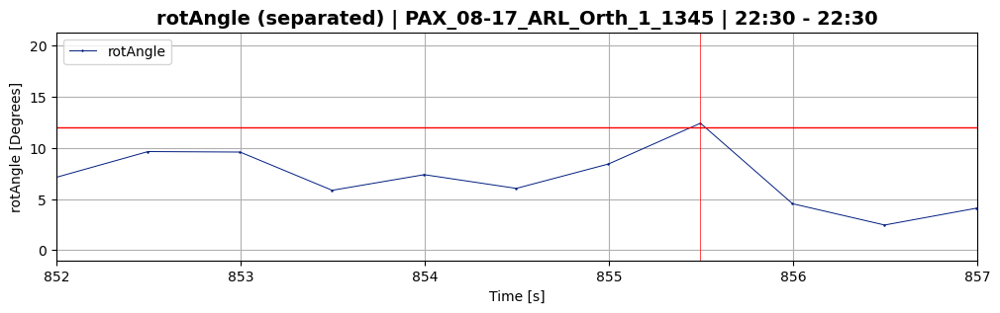

In [116]:
ds_1345.plot_separated(plot_param='rotAngle',plot_signal=1,sample_range=(852,857))

##### 1560 dataset

Time range: min=570.005, max=6618.248
Determining change point ranges automatically...
Using change_point_range_1=(570.005, 670.005)
Using change_point_range_2=(3570.005, 3670.005)
=== performing change point detection ===
cp range: (570.005, 670.005)
using 5658 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5658,)
computing range... ---> range = (1.52,1.58)
displaying jump_fig for switch parameter = s1



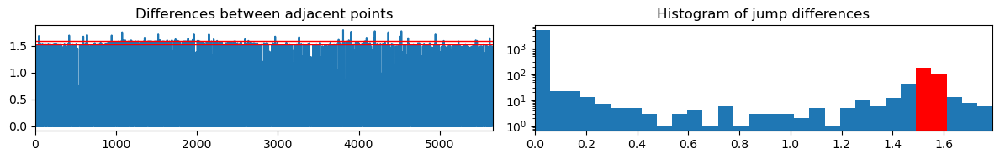



found width of 0.060 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5658,)
computing range... ---> range = (1.08,1.14)
displaying jump_fig for switch parameter = s2



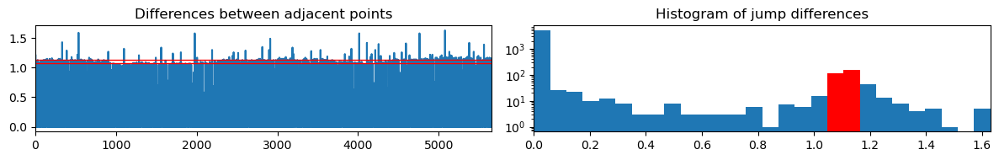



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5658,)
computing range... ---> range = (0.58,0.64)
displaying jump_fig for switch parameter = s3



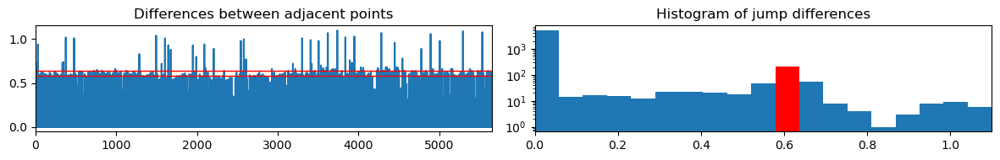



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (1.52,1.58)
Jump points detected: 183
out of total: ~399.9

computing offset...


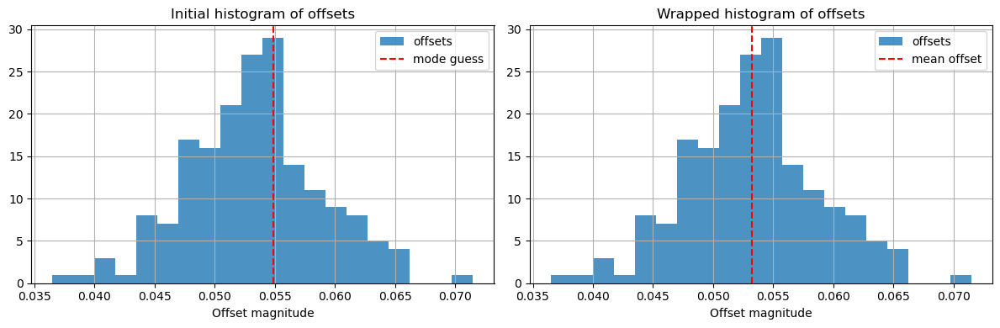



offset = 0.053 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3570.005, 3670.005)
using 5734 data entries
skipping 171203 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5734,)
computing range... ---> range = (1.13,1.19)
displaying jump_fig for switch parameter = s1



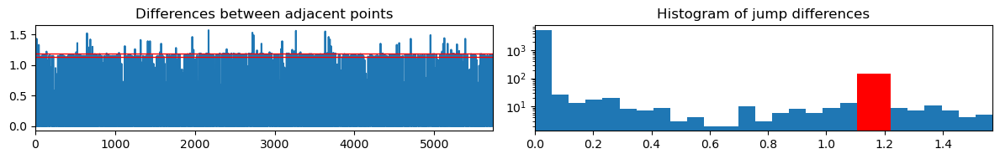



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5734,)
computing range... ---> range = (1.42,1.48)
displaying jump_fig for switch parameter = s2



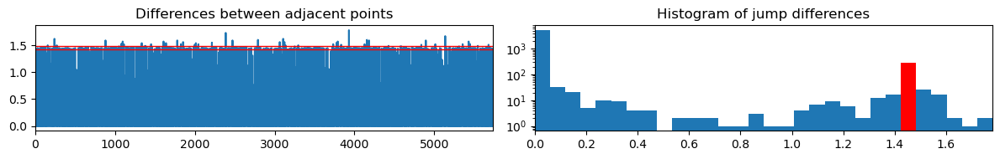



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5734,)
computing range... ---> range = (0.67,0.73)
displaying jump_fig for switch parameter = s3



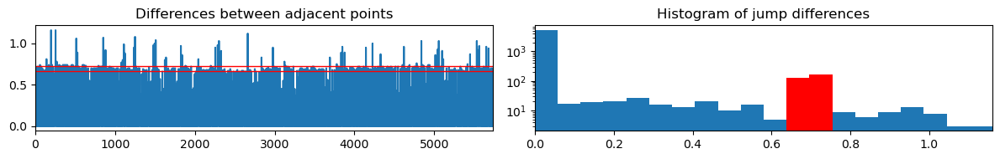



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (1.42,1.48)
Jump points detected: 290
out of total: ~400.0

computing offset...


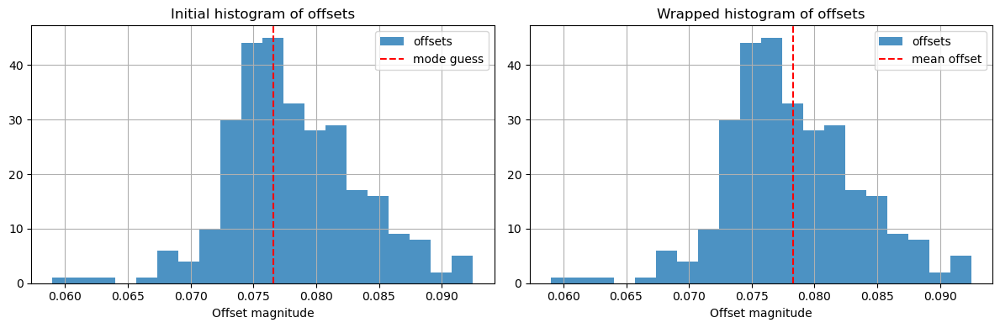



offset = 0.078 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.025 seconds over 12000.0 switches
Corrected Switch Time = 0.2500021


In [130]:
filename = 'Datasets/Whole_setup/08-17/PAX_08-17_ARL_Orth_1_1560.csv'
#ds = SwitchSet(filename, skip_default_signal_baseline=14)
#ds.find_switches(nominal_switch_rate=2, change_point_range_1=(15,50), print_process=True)
ds_1560 = SwitchSet(filename, set_range=(0,0.15), skip_default_signal_baseline=570)
ds_1560.find_switches(nominal_switch_rate=2, print_process=True)

In [131]:
ds_1560.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 24192 observations)

--- interpolating data ---
length before: 12096
length after: 12096
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 12096
length after: 12096
0 total added
--- end interpolating data ---
Signal 1 size=12096	Signal 1 range: t=(570.18,6617.73)
Signal 2 size=12096	Signal 2 range: t=(570.43,6617.98)
=== end average_data ===


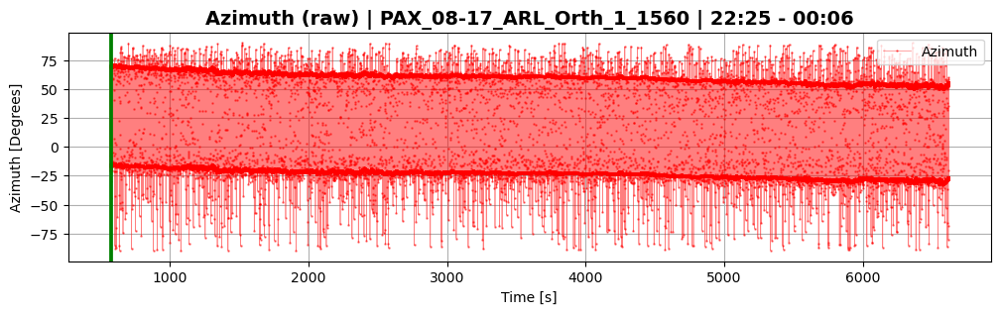

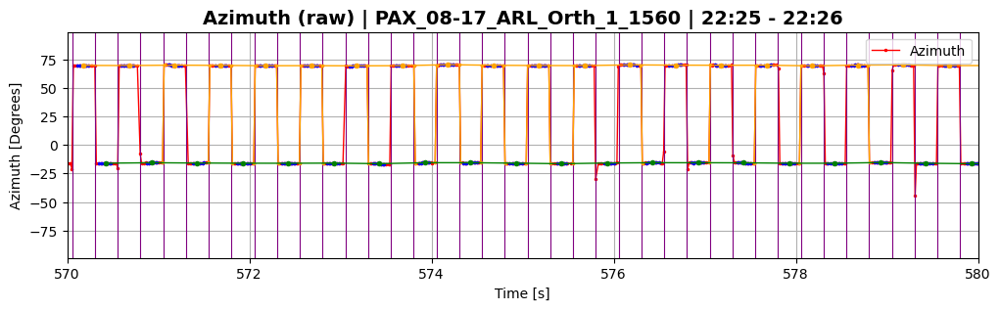

In [132]:
ds_1560.plot_raw(plot_param='Azimuth', sample_range=(570,580),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

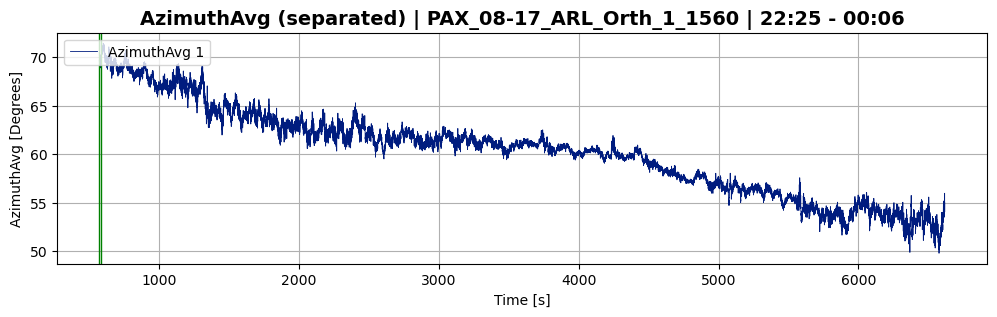

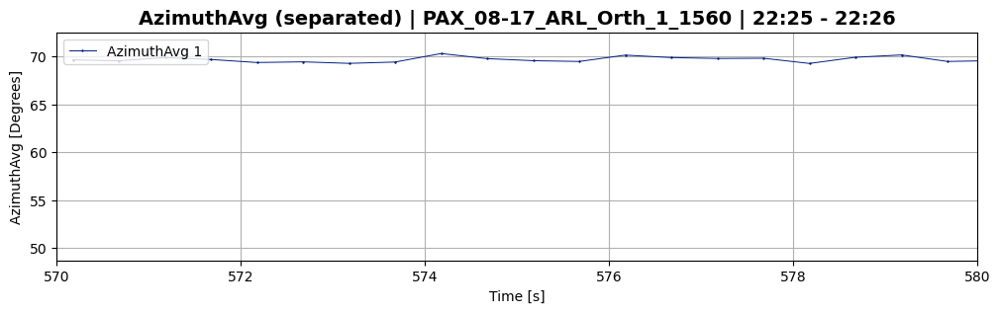

In [133]:
ds_1560.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(570,580))

In [134]:
reset_times_1560 = ds_1560.calc_stokes_ptf(reference=reset_times_1345, angle_threshold_deg=2, print_process=True);

Using provided reset times to reset reference matrix
Reference matrix was reset 34 times
Reset at time t=855.81
Reset at time t=1149.81
Reset at time t=1155.31
Reset at time t=1166.81
Reset at time t=1178.31
Reset at time t=1363.31
Reset at time t=1370.81
Reset at time t=1724.81
Reset at time t=1752.81
Reset at time t=1867.81
...


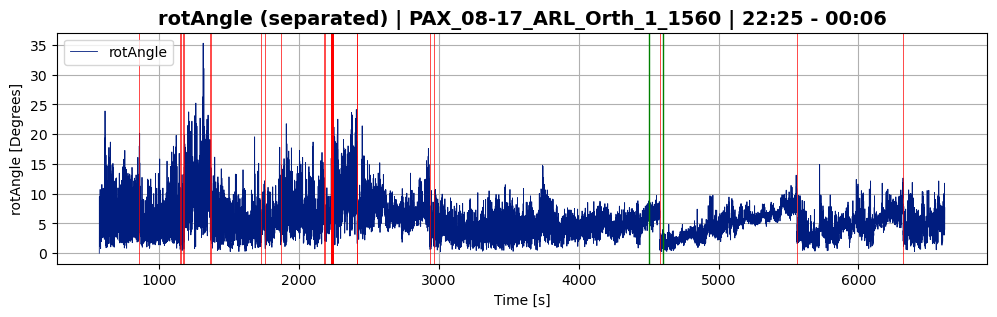

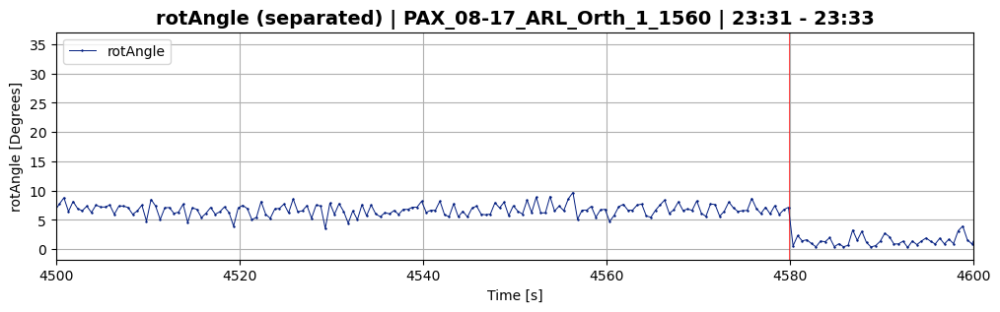

In [138]:
ds_1560.plot_separated(plot_param='rotAngle',plot_signal=1,sample_range=(4500,4600))

##### Both 1345 and 1560 rotAngle

In [136]:
ds_arl_08_17 = (ds_1345, ds_1560)

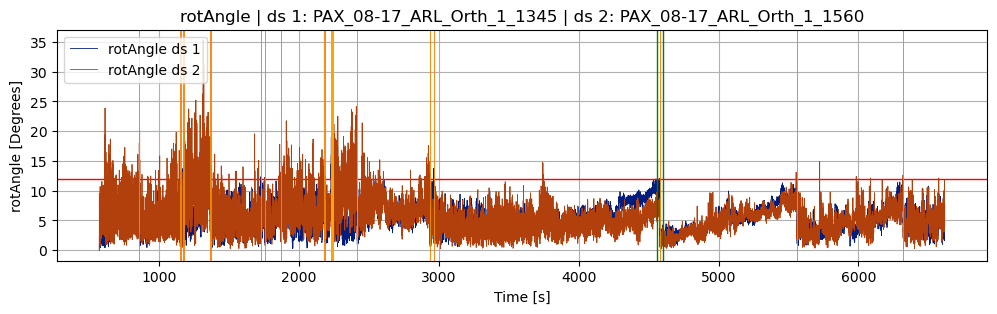

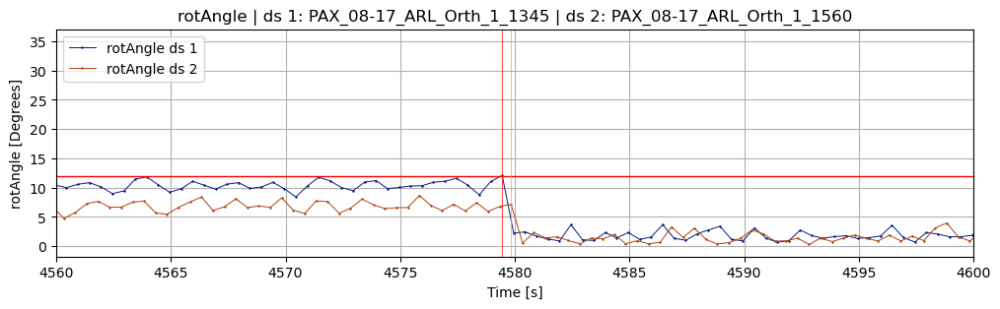

In [140]:
plot_rot_angle(ds_1345, ds_1560, birds_eye=True, sample_range=(4560,4600))

#### Connector dataset 11-16

##### 1345 dataset

In [45]:
plt.ioff()
plt.close('all')

In [142]:
#filename = 'Datasets/Whole_setup/11-16/PAX_11-16_CON_Orth_1345_desktop.csv'
#ds_test = Dataset(filename,set_range=(0,0.01),skip_default_signal_baseline=False)

Time range: min=0.064, max=976.995


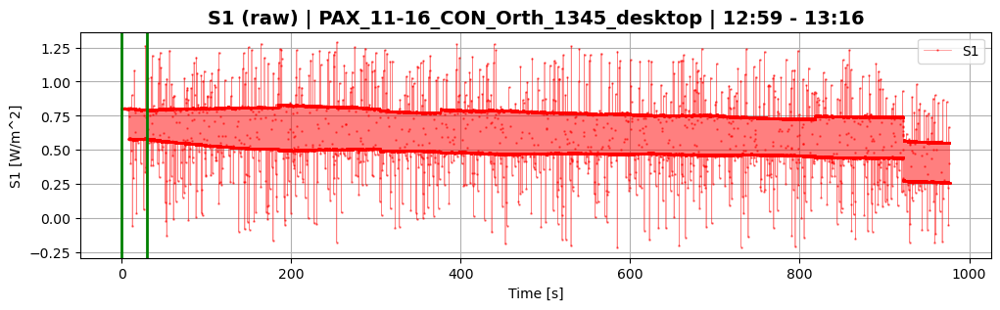

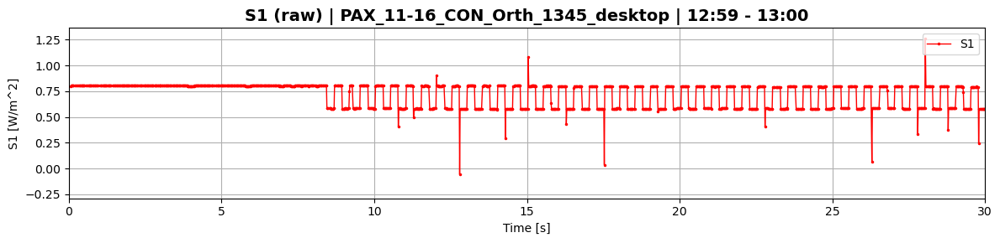

(<Figure size 1200x300 with 1 Axes>, <Figure size 1200x300 with 1 Axes>)

In [144]:
#ds_test.plot_raw(plot_param="S1",sample_range=(0,30))

Time range: min=20.012, max=4908.415
Determining change point ranges automatically...
Using change_point_range_1=(20.012, 120.012)
Using change_point_range_2=(3020.012, 3120.012)
=== performing change point detection ===
cp range: (20.012, 120.012)
using 6007 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (6007,)
computing range... ---> range = (0.18,0.24)
displaying jump_fig for switch parameter = s1



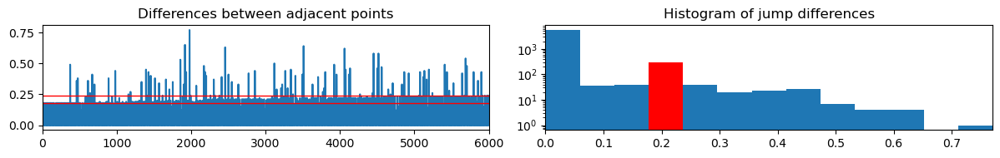



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (6007,)
computing range... ---> range = (0.06,0.12)
displaying jump_fig for switch parameter = s2



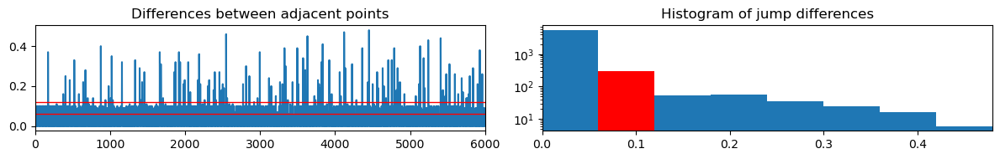



found width of 0.060 for s2
greater than prev width of 0.059 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (6007,)
computing range... ---> range = (1.24,1.30)
displaying jump_fig for switch parameter = s3



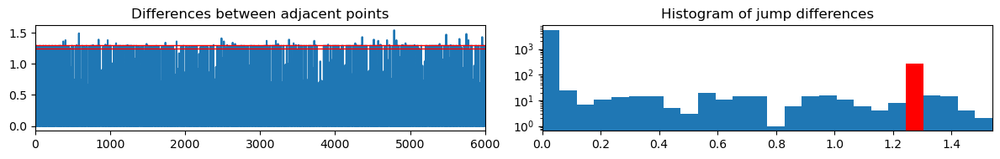



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (0.06,0.12)
Jump points detected: 307
out of total: ~400.0

computing offset...


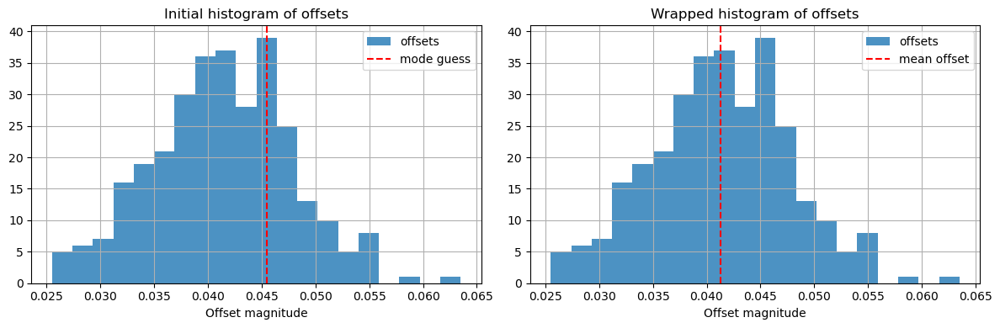



offset = 0.041 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3020.012, 3120.012)
using 5991 data entries
skipping 179653 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5991,)
computing range... ---> range = (0.17,0.23)
displaying jump_fig for switch parameter = s1



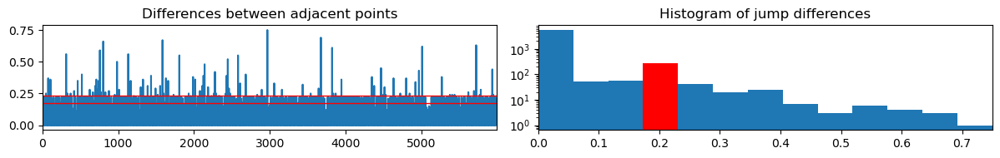



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5991,)
computing range... ---> range = (0.99,1.04)
displaying jump_fig for switch parameter = s2



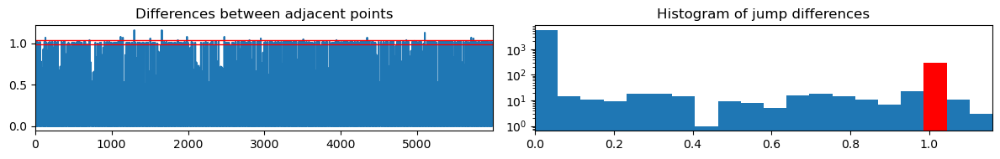



found width of 0.058 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5991,)
computing range... ---> range = (0.86,0.92)
displaying jump_fig for switch parameter = s3



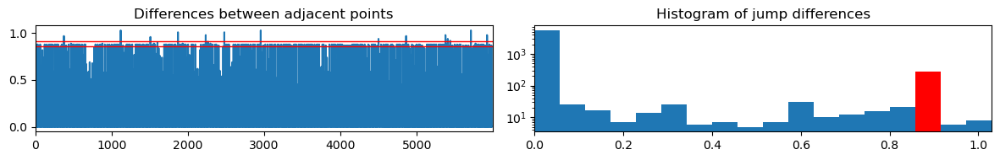



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (0.99,1.04)
Jump points detected: 283
out of total: ~400.0

computing offset...


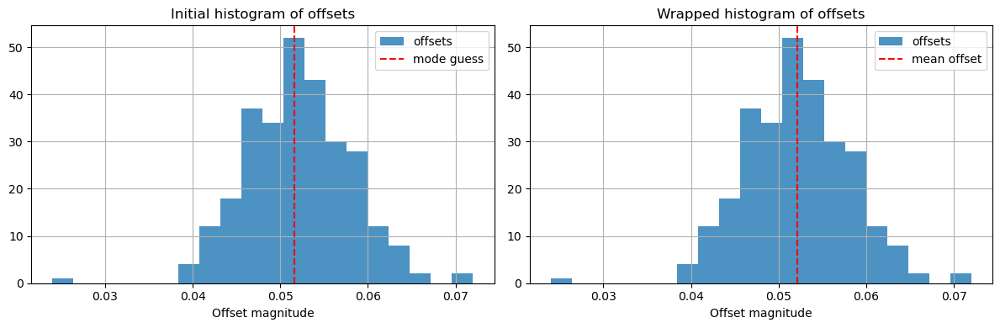



offset = 0.052 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.011 seconds over 12000.0 switches
Corrected Switch Time = 0.2500009


In [145]:
filename = 'Datasets/Whole_setup/11-16/PAX_11-16_CON_Orth_1345_desktop.csv'
ds_1345 = SwitchSet(filename, set_range=(0,0.05), skip_default_signal_baseline=20)
ds_1345.find_switches(nominal_switch_rate=2, print_process=True)

In [146]:
ds_1345.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 19552 observations)

--- interpolating data ---
length before: 9776
length after: 9776
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 9776
length after: 9776
0 total added
--- end interpolating data ---
Signal 1 size=9776	Signal 1 range: t=(20.67,4908.18)
Signal 2 size=9776	Signal 2 range: t=(20.42,4907.93)
=== end average_data ===


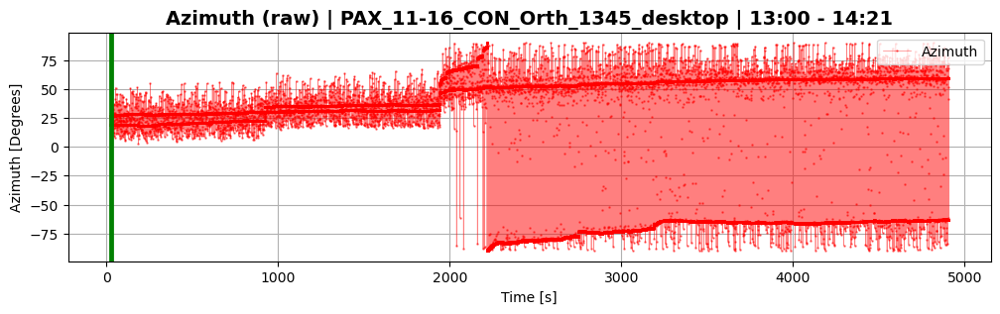

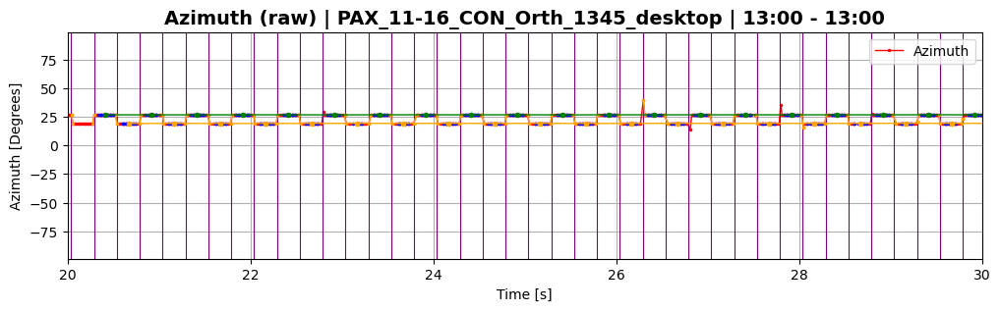

In [147]:
ds_1345.plot_raw(plot_param='Azimuth', sample_range=(20,30),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

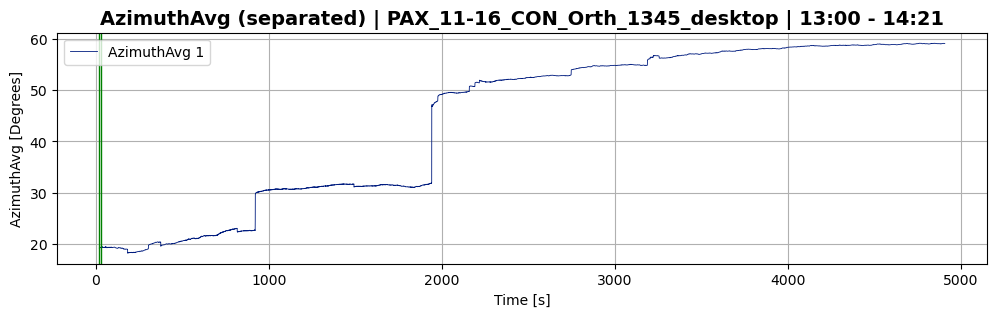

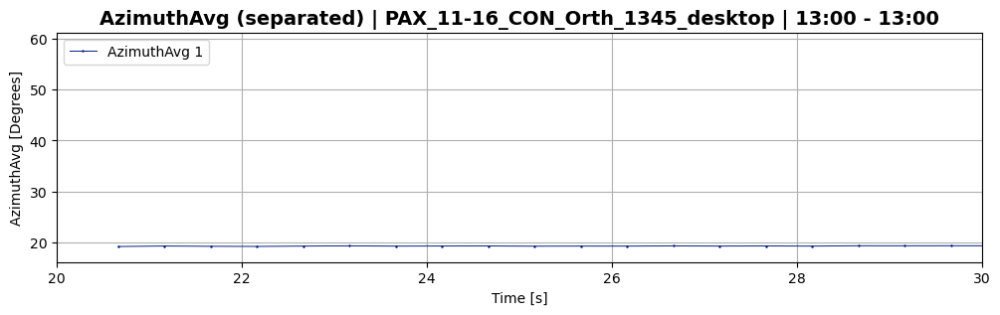

In [148]:
ds_1345.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(20,30))

In [149]:
reset_times_1345 = ds_1345.calc_stokes_ptf(reference=None, angle_threshold_deg=5, print_process=True);

Using "resetting reference SOPs" approach with threshold = 5.0 degrees


/tmp/ipykernel_54062/1230508500.py:983: RuntimeWarning:

invalid value encountered in arccos



Reference matrix was reset 10 times
Reset at time t=714.04
Reset at time t=922.54
Reset at time t=1664.55
Reset at time t=1942.55
Reset at time t=1977.55
Reset at time t=2162.55
Reset at time t=2525.05
Reset at time t=2875.55
Reset at time t=3224.05
Reset at time t=4494.56


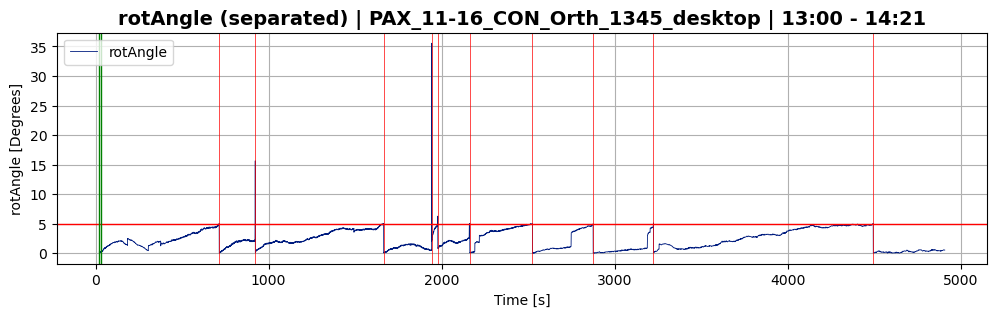

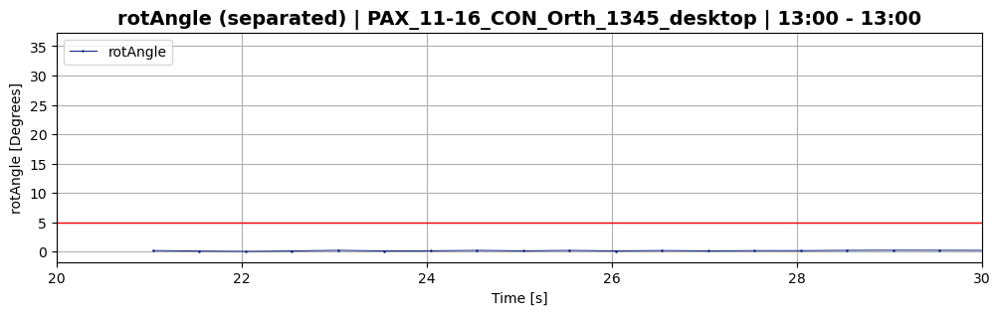

In [150]:
ds_1345.plot_separated(plot_param='rotAngle',sample_range=(20,30))

##### 1560 dataset

Time range: min=20.003, max=4845.596
Determining change point ranges automatically...
Using change_point_range_1=(20.003, 120.003)
Using change_point_range_2=(3020.003, 3120.003)
=== performing change point detection ===
cp range: (20.003, 120.003)
using 5859 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5859,)
computing range... ---> range = (0.93,0.99)
displaying jump_fig for switch parameter = s1



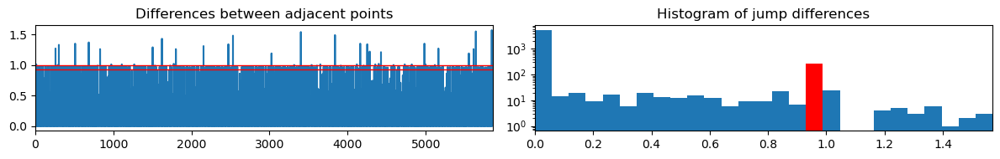



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5859,)
computing range... ---> range = (0.36,0.41)
displaying jump_fig for switch parameter = s2



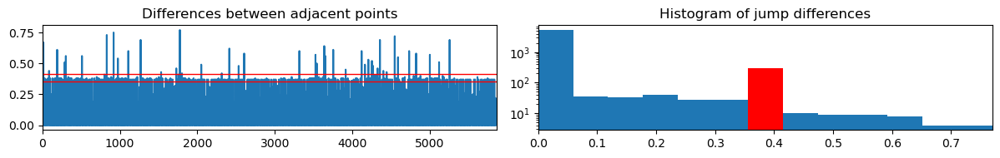



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5859,)
computing range... ---> range = (0.91,0.97)
displaying jump_fig for switch parameter = s3



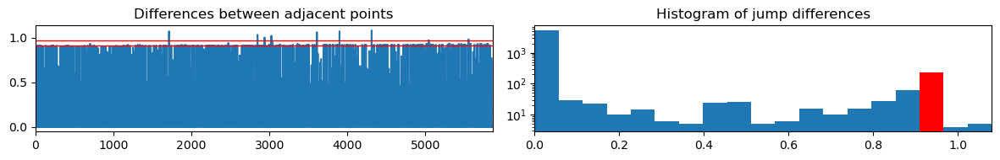



--- end of switch param: s3 ---

---> switch parameter found: s2 <---
finding differences within range = (0.36,0.41)
Jump points detected: 290
out of total: ~400.0

computing offset...


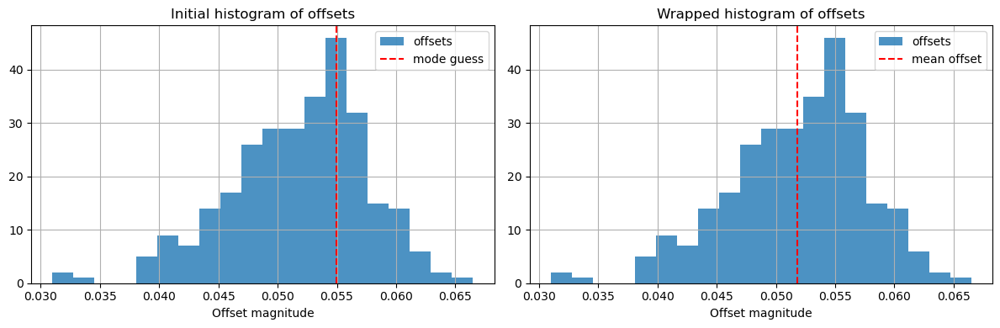



offset = 0.052 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3020.003, 3120.003)
using 5865 data entries
skipping 176849 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5865,)
computing range... ---> range = (0.24,0.30)
displaying jump_fig for switch parameter = s1



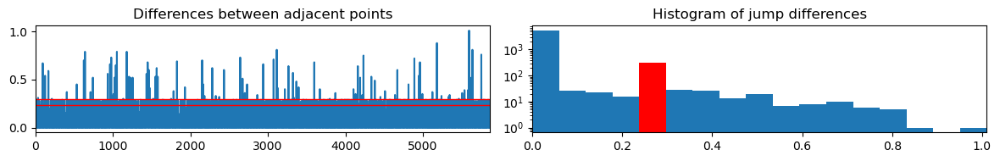



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5865,)
computing range... ---> range = (1.05,1.11)
displaying jump_fig for switch parameter = s2



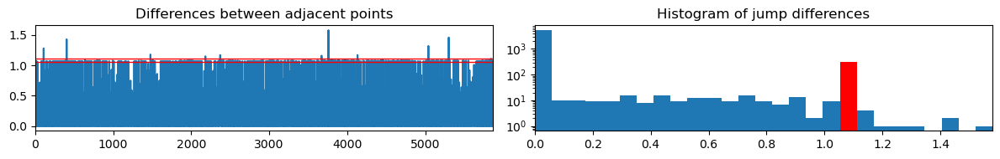



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5865,)
computing range... ---> range = (0.82,0.88)
displaying jump_fig for switch parameter = s3



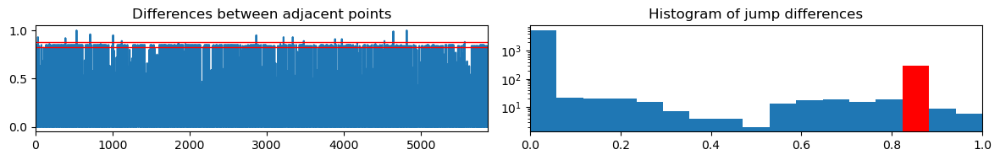



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.24,0.30)
Jump points detected: 302
out of total: ~400.0

computing offset...


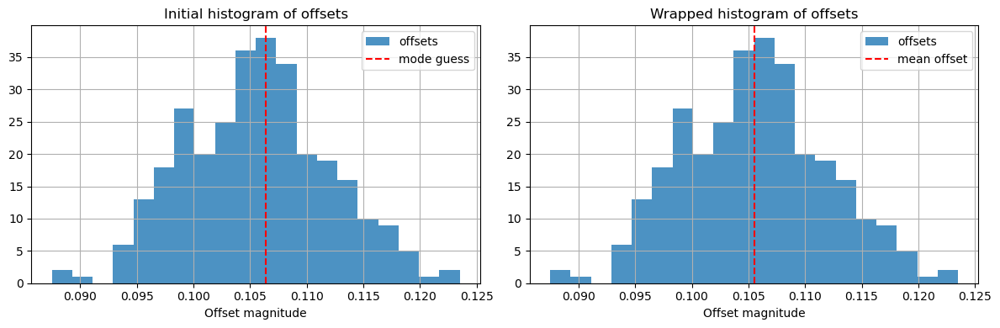



offset = 0.106 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.054 seconds over 12000.0 switches
Corrected Switch Time = 0.2500045


In [161]:
filename = 'Datasets/Whole_setup/11-16/PAX_11-16_CON_Orth_1560_laptop.csv'
ds_1560 = SwitchSet(filename, set_range=(0,0.05), skip_default_signal_baseline=20)
ds_1560.find_switches(nominal_switch_rate=2, print_process=True)

In [162]:
ds_1560.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 19300 observations)

--- interpolating data ---
length before: 9650
length after: 9650
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 9650
length after: 9650
0 total added
--- end interpolating data ---
Signal 1 size=9650	Signal 1 range: t=(20.68,4845.26)
Signal 2 size=9650	Signal 2 range: t=(20.43,4845.01)
=== end average_data ===


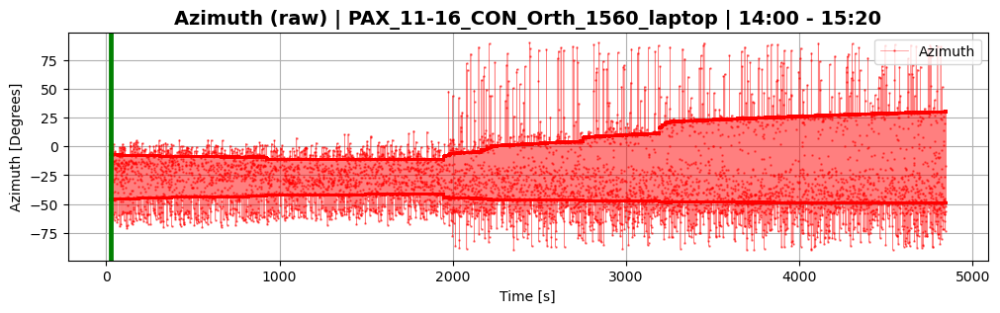

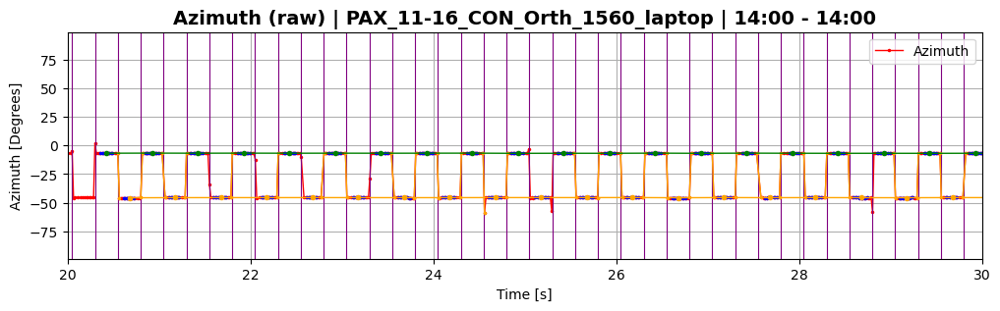

In [163]:
ds_1560.plot_raw(plot_param='Azimuth', sample_range=(20,30),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

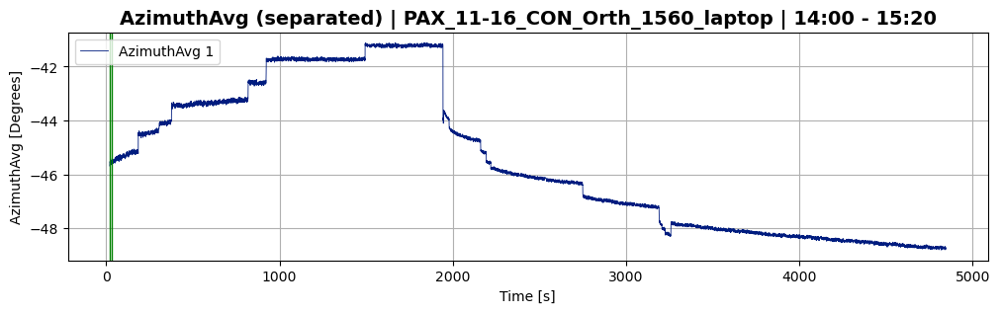

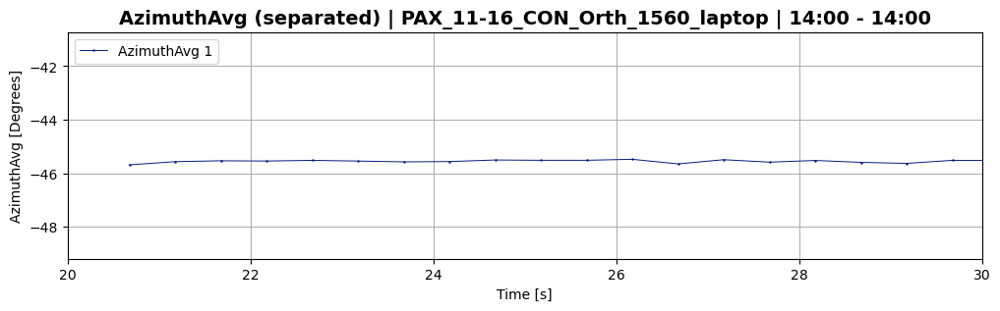

In [164]:
ds_1560.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(20,30))

In [165]:
reset_times_1560 = ds_1560.calc_stokes_ptf(reference=reset_times_1345, angle_threshold_deg=2, reset_delay=5, print_process=True);

Using provided reset times to reset reference matrix
Reference matrix was reset 10 times
Reset at time t=719.06
Reset at time t=927.57
Reset at time t=1669.58
Reset at time t=1947.59
Reset at time t=1982.59
Reset at time t=2167.59
Reset at time t=2530.10
Reset at time t=2880.60
Reset at time t=3229.11
Reset at time t=4499.63


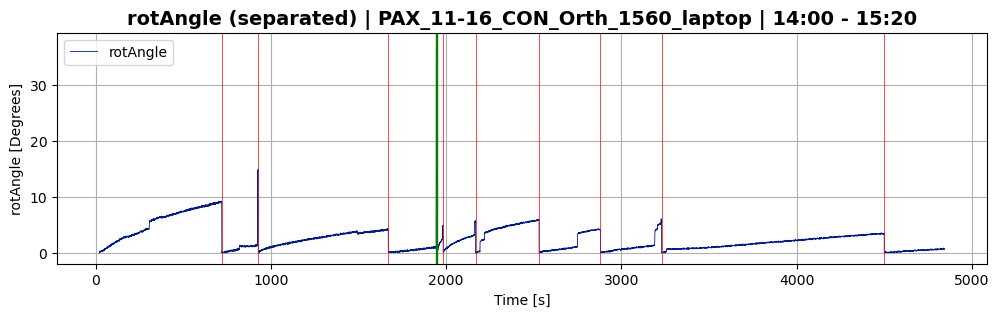

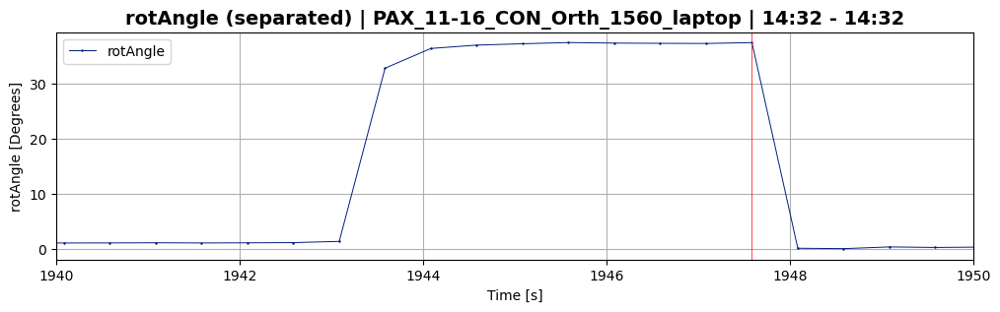

In [170]:
ds_1560.plot_separated(plot_param='rotAngle',sample_range=(1940,1950))

##### Both 1345 and 1560 rotAngle

In [167]:
ds_con_11_16 = (ds_1345, ds_1560)

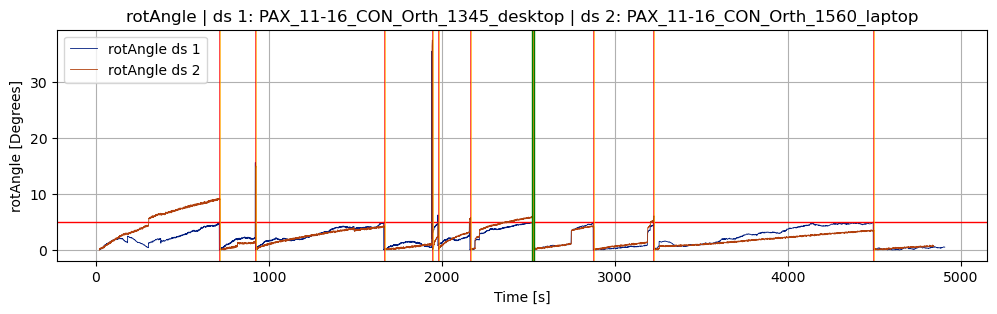

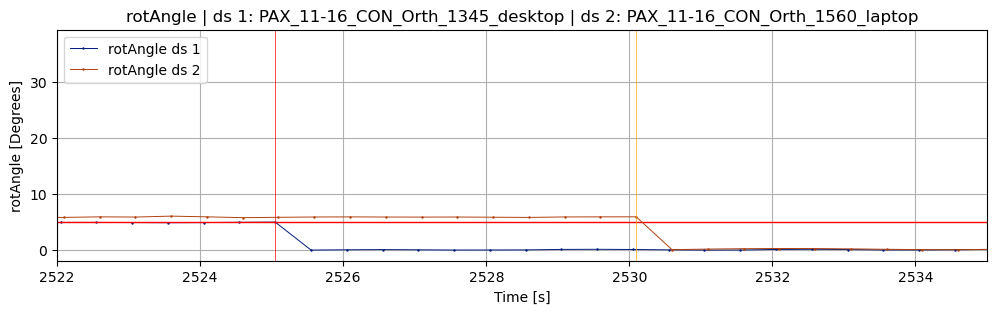

In [172]:
plot_rot_angle(ds_1345, ds_1560, birds_eye=True, sample_range=(2522,2535))

#### ARL dataset 10-30

##### 1345 dataset

In [11]:
plt.ioff()
plt.close('all')

In [6]:
filename = DATA + 'Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
ds_test = Dataset(filename,set_range=(0,0.01),skip_default_signal_baseline=False)

Time range: min=0.029, max=955.284


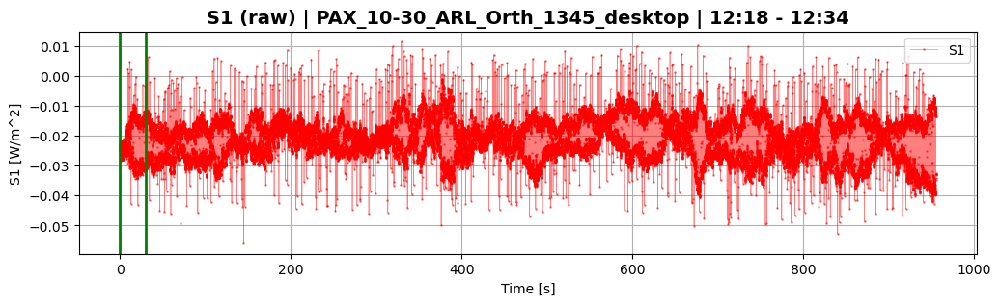

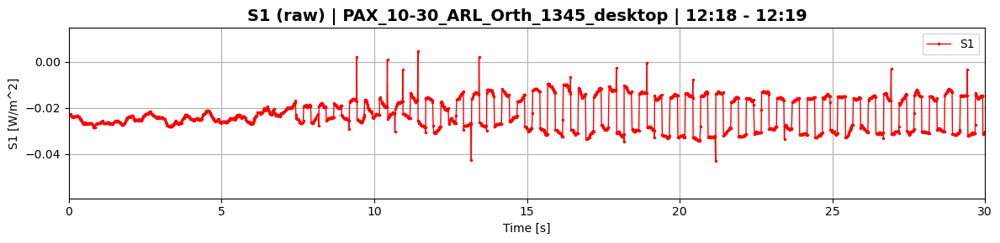

(<Figure size 1200x300 with 1 Axes>, <Figure size 1200x300 with 1 Axes>)

In [10]:
#ds_test.plot_raw(plot_param="S1",sample_range=(0,30))

Time range: min=20.0, max=3836.263
Determining change point ranges automatically...
Using change_point_range_1=(20.0, 120.0)
Using change_point_range_2=(3020.0, 3120.0)
=== performing change point detection ===
cp range: (20.0, 120.0)
using 7736 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7736,)
computing range... ---> range = (0.15,0.20)
displaying jump_fig for switch parameter = s1



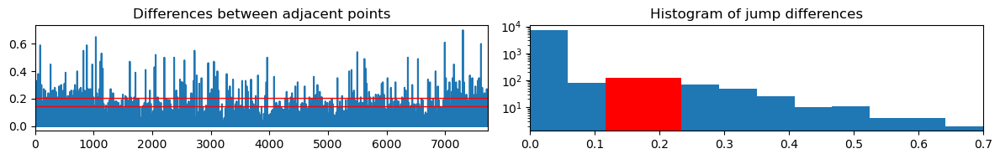



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7736,)
computing range... ---> range = (0.06,0.11)
displaying jump_fig for switch parameter = s2



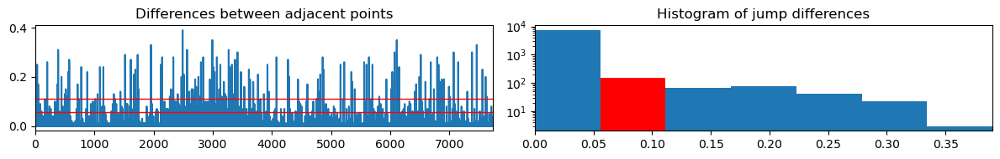



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7736,)
computing range... ---> range = (1.31,1.37)
displaying jump_fig for switch parameter = s3



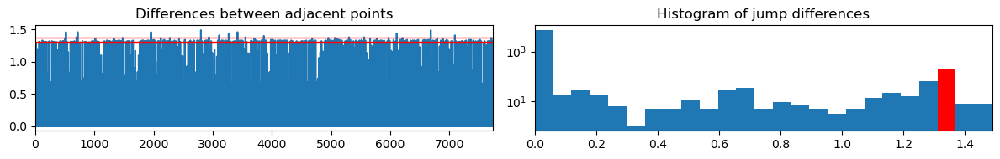



found width of 0.060 for s3
greater than prev width of 0.058 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (1.31,1.37)
Jump points detected: 207
out of total: ~400.0

computing offset...


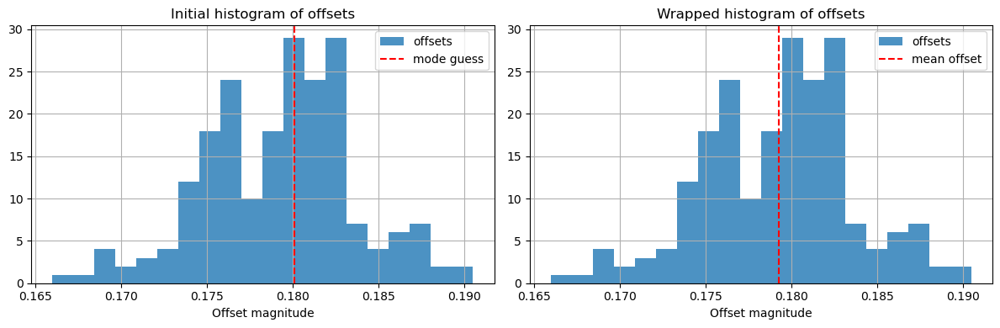



offset = 0.179 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3020.0, 3120.0)
using 7707 data entries
skipping 232326 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (7707,)
computing range... ---> range = (0.77,0.83)
displaying jump_fig for switch parameter = s1



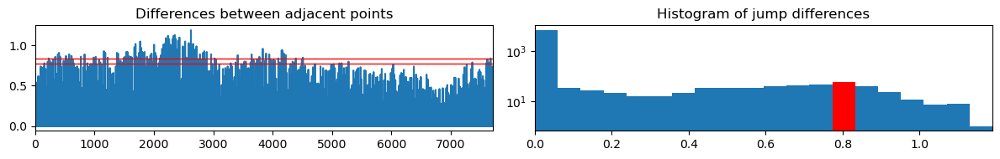



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (7707,)
computing range... ---> range = (1.14,1.19)
displaying jump_fig for switch parameter = s2



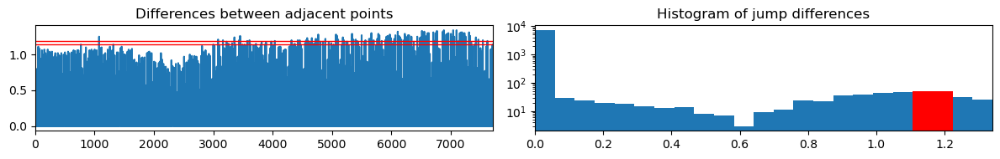



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (7707,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s3



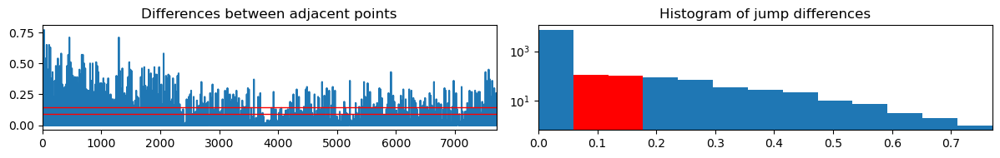



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.77,0.83)
Jump points detected: 57
out of total: ~400.0

computing offset...


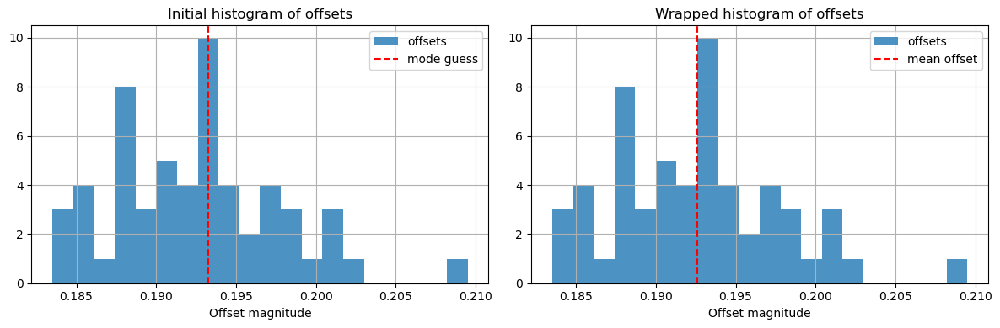



offset = 0.193 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.013 seconds over 12000.0 switches
Corrected Switch Time = 0.2500011


In [16]:
filename = DATA + 'Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
ds_1345 = SwitchSet(filename, set_range=(0,0.04), skip_default_signal_baseline=20)
ds_1345.find_switches(nominal_switch_rate=2, print_process=True)

In [30]:
ds_1345.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 15264 observations)

--- interpolating data ---
length before: 7632
length after: 7632
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 7632
length after: 7632
0 total added
--- end interpolating data ---
Signal 1 size=7632	Signal 1 range: t=(20.55,3836.07)
Signal 2 size=7632	Signal 2 range: t=(20.30,3835.82)
=== end average_data ===


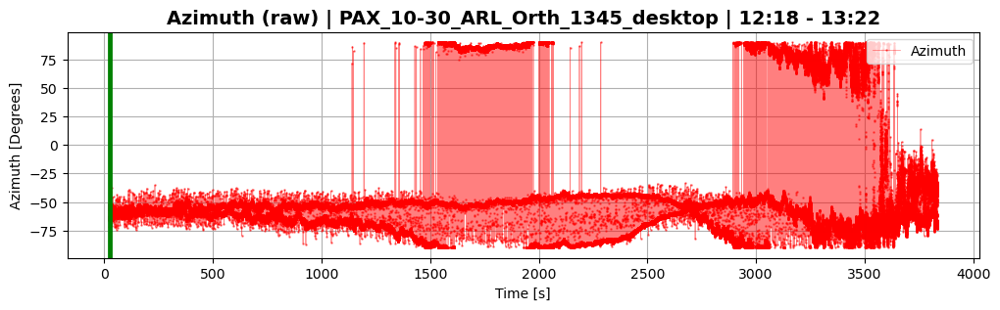

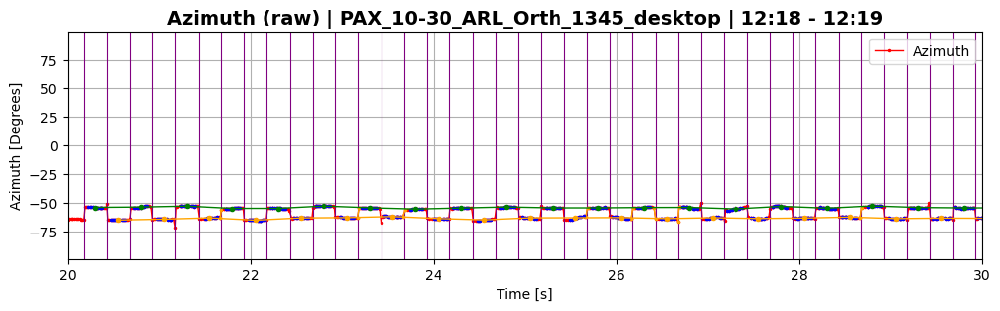

In [31]:
ds_1345.plot_raw(plot_param='Azimuth', sample_range=(20,30),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

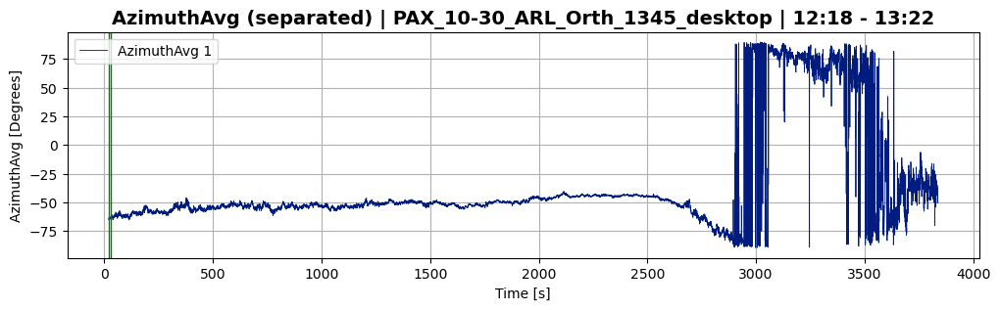

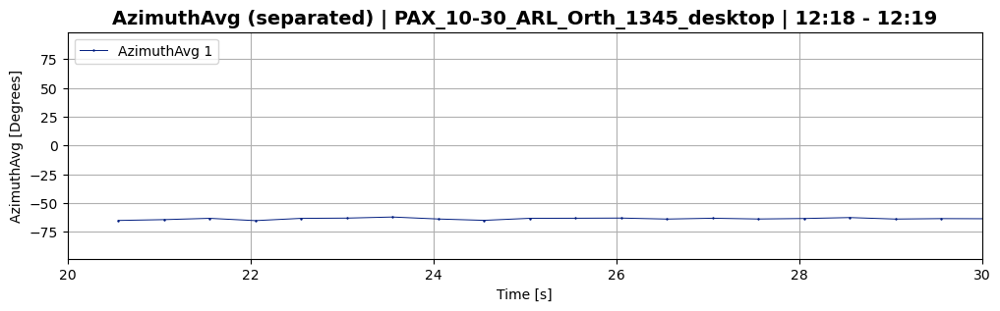

In [32]:
ds_1345.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(20,30))

In [43]:
reset_times_1345 = ds_1345.calc_stokes_ptf(reference=None, angle_threshold_deg=20, print_process=True);

Using "resetting reference SOPs" approach with threshold = 20.0 degrees


/tmp/ipykernel_137629/1855016075.py:983: RuntimeWarning:

invalid value encountered in arccos



Reference matrix was reset 351 times
Reset at time t=183.93
Reset at time t=678.43
Reset at time t=686.93
Reset at time t=1313.43
Reset at time t=1474.94
Reset at time t=1686.44
Reset at time t=1836.94
Reset at time t=2110.94
Reset at time t=2324.94
Reset at time t=2454.94
...


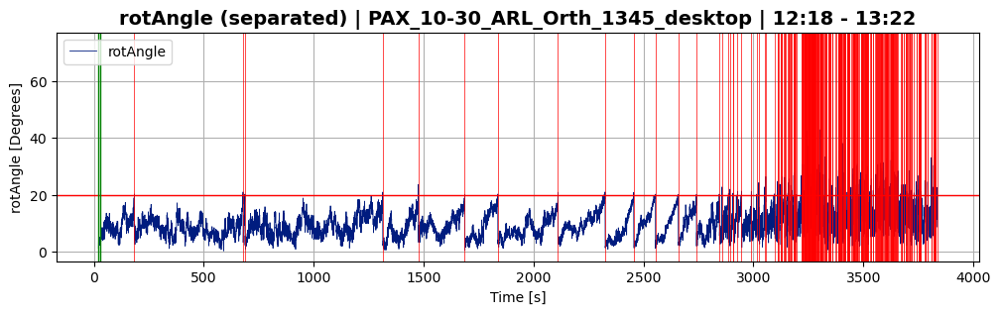

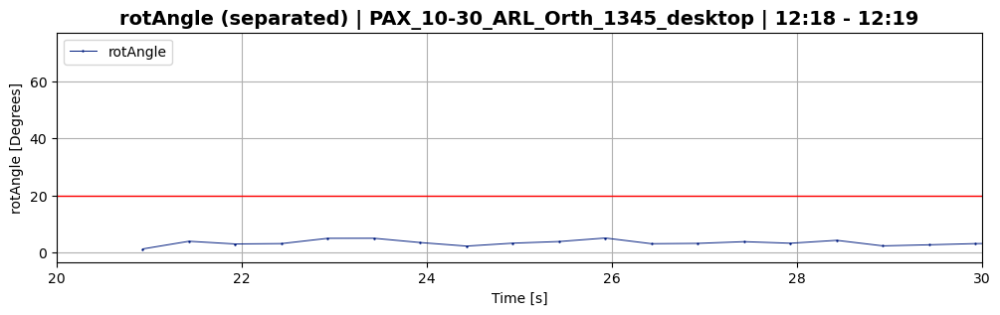

In [44]:
ds_1345.plot_separated(plot_param='rotAngle',sample_range=(20,30))

##### 1560 dataset

Time range: min=20.005, max=4035.361
Determining change point ranges automatically...
Using change_point_range_1=(20.005, 120.005)
Using change_point_range_2=(3020.005, 3120.005)
=== performing change point detection ===
cp range: (20.005, 120.005)
using 5029 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5029,)
computing range... ---> range = (0.09,0.15)
displaying jump_fig for switch parameter = s1



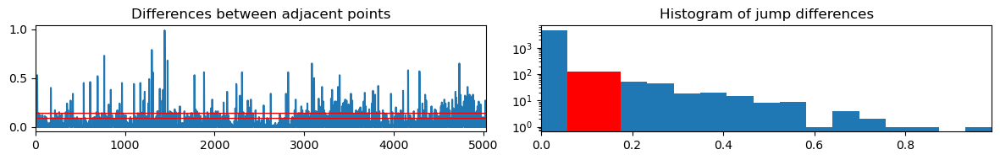



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5029,)
computing range... ---> range = (1.03,1.08)
displaying jump_fig for switch parameter = s2



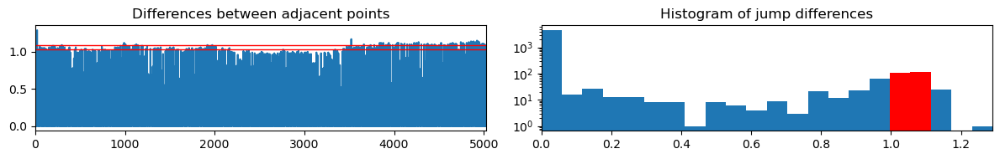



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5029,)
computing range... ---> range = (0.92,0.98)
displaying jump_fig for switch parameter = s3



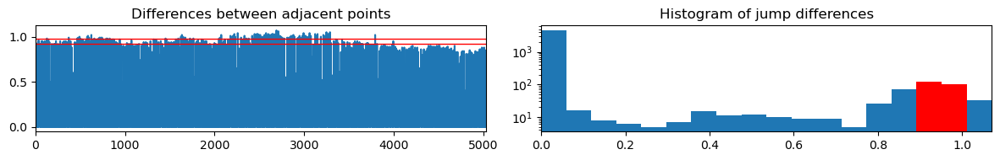



found width of 0.059 for s3
greater than prev width of 0.059 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.92,0.98)
Jump points detected: 122
out of total: ~399.9

computing offset...


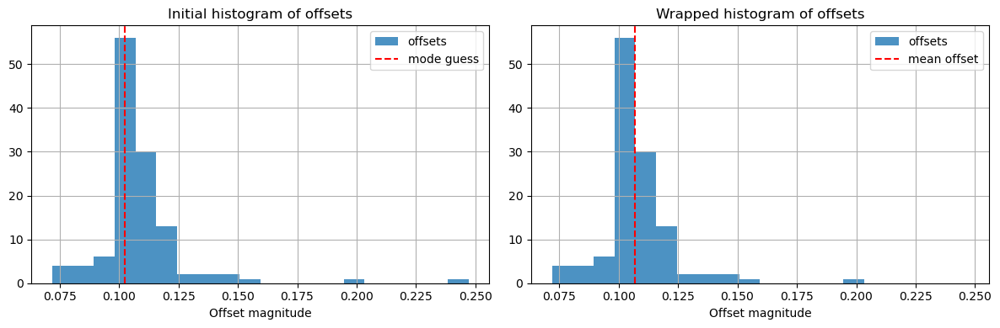



offset = 0.107 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (3020.005, 3120.005)
using 5168 data entries
skipping 150647 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5168,)
computing range... ---> range = (1.13,1.19)
displaying jump_fig for switch parameter = s1



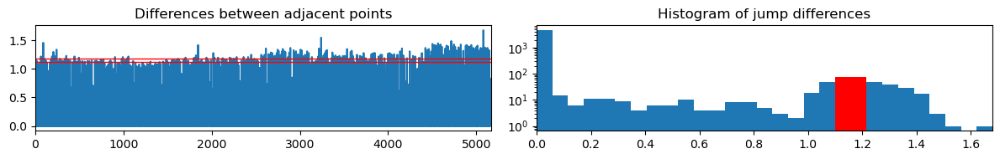



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5168,)
computing range... ---> range = (0.08,0.14)
displaying jump_fig for switch parameter = s2



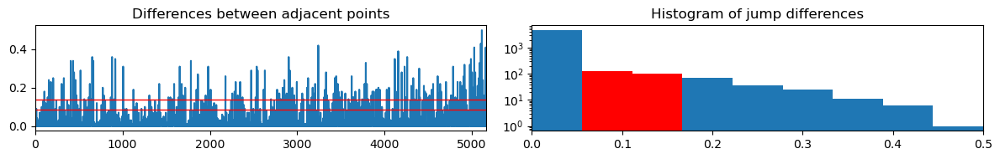



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5168,)
computing range... ---> range = (0.80,0.86)
displaying jump_fig for switch parameter = s3



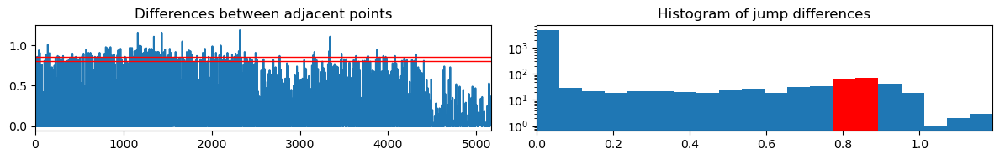



found width of 0.059 for s3
greater than prev width of 0.058 for s1
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.80,0.86)
Jump points detected: 79
out of total: ~399.8

computing offset...


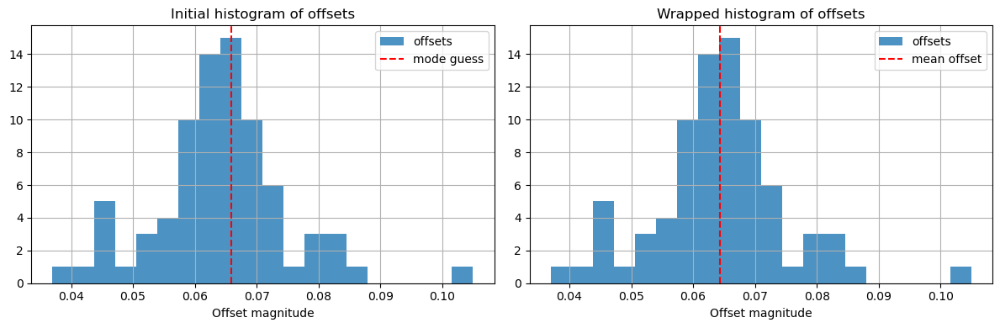



offset = 0.064 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of -0.043 seconds over 12000.0 switches
Corrected Switch Time = 0.2499964


In [35]:
filename = 'Datasets/Whole_setup/10-30/PAX_10-30_ARL_Orth_1560_laptop.csv'
ds_1560 = SwitchSet(filename, set_range=(0,0.056), skip_default_signal_baseline=20)
ds_1560.find_switches(nominal_switch_rate=2, print_process=True)

In [36]:
ds_1560.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 834 observations with <4 points (out of total 15847 observations)

--- interpolating data ---
length before: 7499
length after: 8031
532 total added
--- end interpolating data ---

--- interpolating data ---
length before: 7514
length after: 8030
516 total added
--- end interpolating data ---
Signal 1 size=8030	Signal 1 range: t=(20.48,4034.93)
Signal 2 size=8031	Signal 2 range: t=(20.23,4035.18)
=== end average_data ===


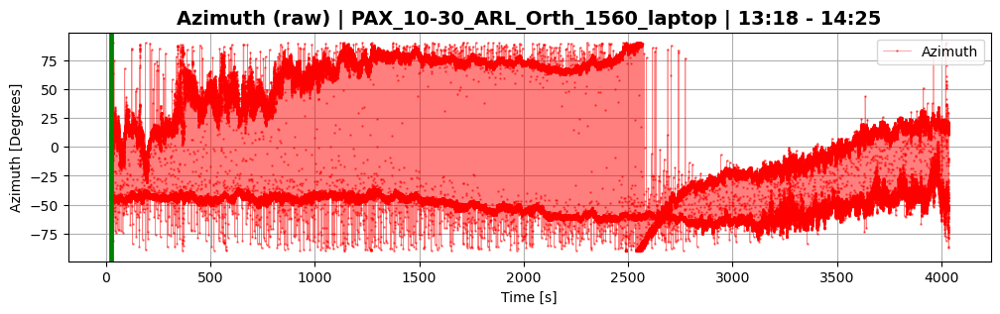

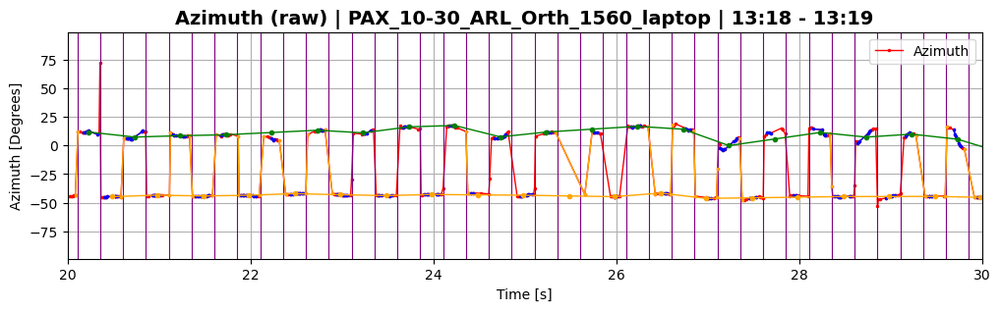

In [37]:
ds_1560.plot_raw(plot_param='Azimuth', sample_range=(20,30),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

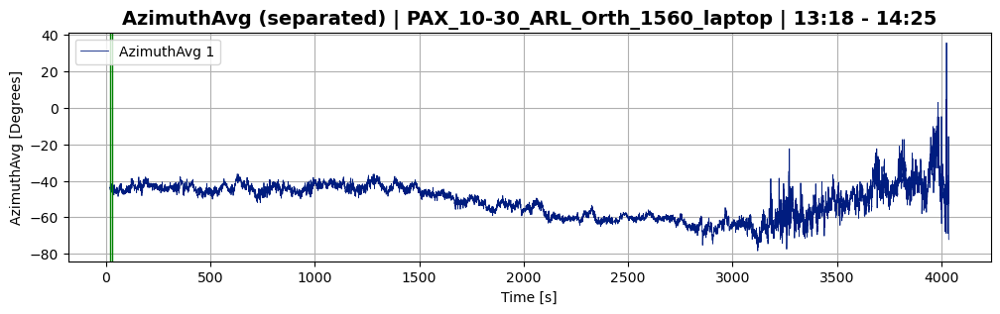

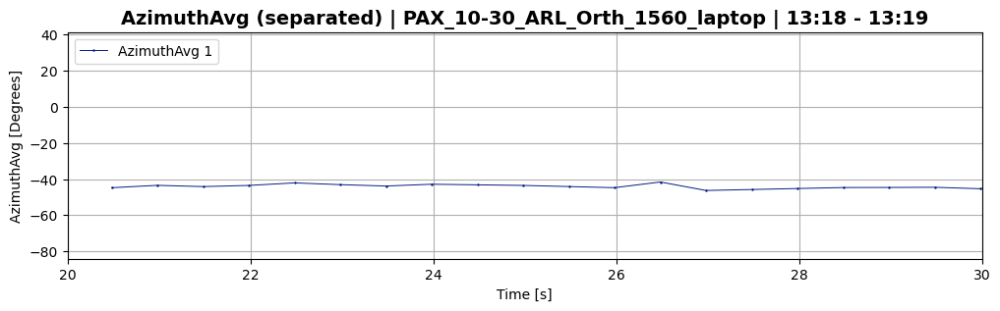

In [38]:
ds_1560.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(20,30))

In [45]:
reset_times_1560 = ds_1560.calc_stokes_ptf(reference=reset_times_1345, reset_delay=5, print_process=True);

Using provided reset times to reset reference matrix
Reference matrix was reset 351 times
Reset at time t=189.36
Reset at time t=683.85
Reset at time t=692.35
Reset at time t=1318.84
Reset at time t=1480.34
Reset at time t=1691.83
Reset at time t=1842.33
Reset at time t=2116.33
Reset at time t=2330.32
Reset at time t=2460.32
...


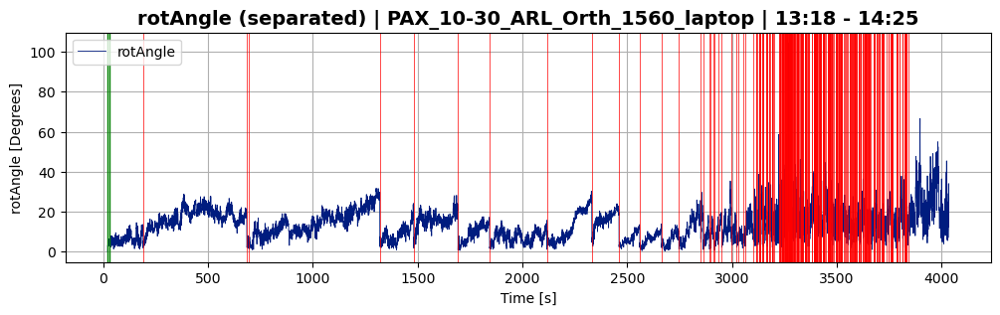

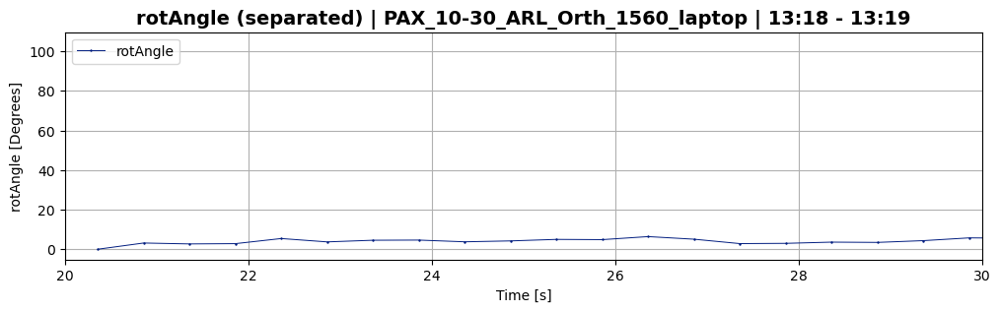

In [46]:
ds_1560.plot_separated(plot_param='rotAngle',sample_range=(20,30))

##### Both 1345 and 1560 rotAngle

In [47]:
ds_arl_10_30 = (ds_1345, ds_1560)

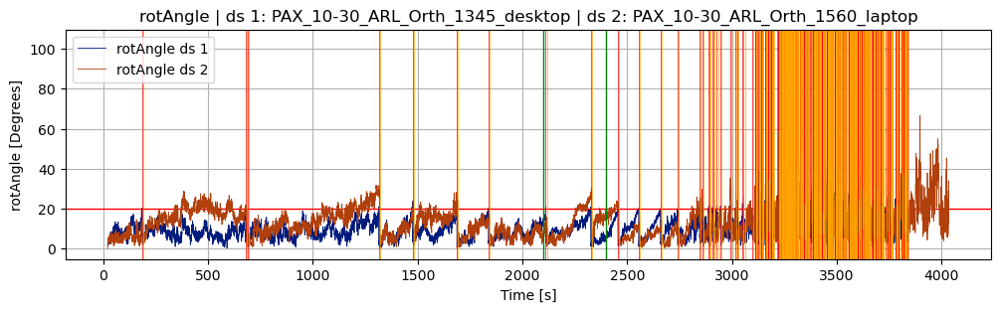

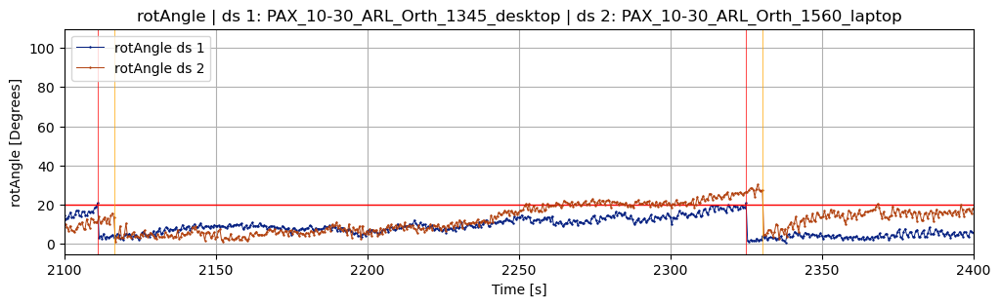

In [77]:
plot_rot_angle(ds_arl_10_30[0], ds_arl_10_30[1], birds_eye=True, sample_range=(2100,2400))

In [78]:
import statistics
statistics.mean(reset_times_1560)

1276.6427284609322

#### 50m short dataset 3-11

##### 1345 dataset

In [5]:
# filename = DATA + 'Whole_setup/10-30/PAX_10-30_ARL_Orth_1345_desktop.csv'
# ds_test = Dataset(filename,set_range=(0,0.01),skip_default_signal_baseline=False)

Time range: min=0.029, max=955.284


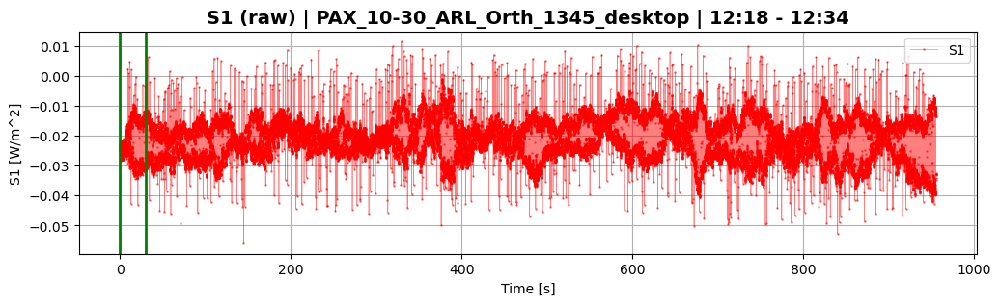

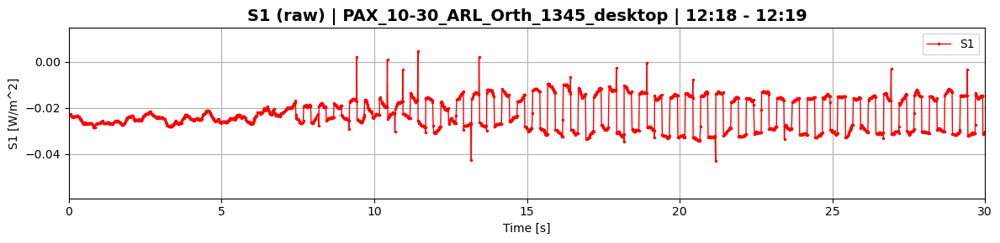

(<Figure size 1200x300 with 1 Axes>, <Figure size 1200x300 with 1 Axes>)

In [10]:
#ds_test.plot_raw(plot_param="S1",sample_range=(0,30))

Time range: min=20.006, max=2324.049
Determining change point ranges automatically...
Using change_point_range_1=(20.006, 120.006)
Using change_point_range_2=(2224.049, 2324.049)
=== performing change point detection ===
cp range: (20.006, 120.006)
using 5390 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5390,)
computing range... ---> range = (0.12,0.18)
displaying jump_fig for switch parameter = s1



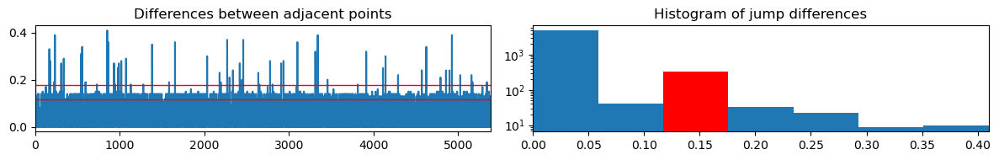



found width of 0.059 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5390,)
computing range... ---> range = (1.23,1.29)
displaying jump_fig for switch parameter = s2



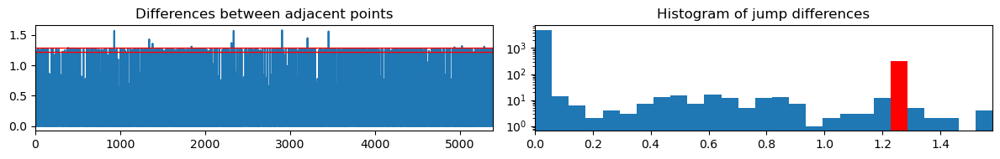



--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5390,)
computing range... ---> range = (0.45,0.50)
displaying jump_fig for switch parameter = s3



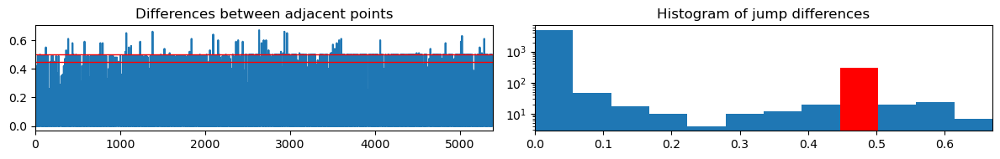



--- end of switch param: s3 ---

---> switch parameter found: s1 <---
finding differences within range = (0.12,0.18)
Jump points detected: 334
out of total: ~399.9

computing offset...


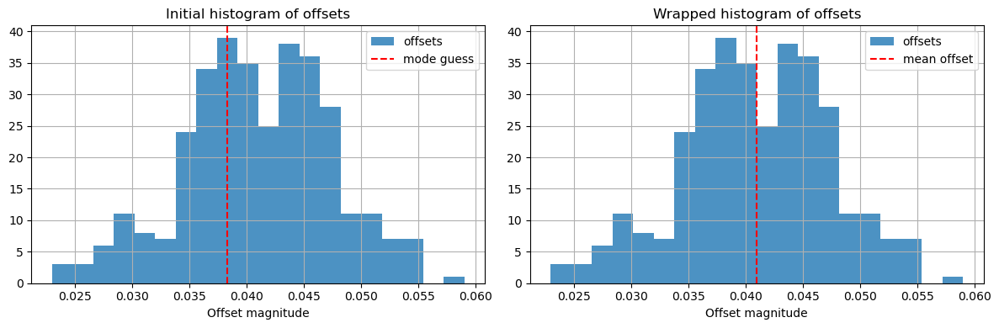



offset = 0.041 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (2224.049, 2324.049)
using 5189 data entries
skipping 115930 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5189,)
computing range... ---> range = (0.08,0.14)
displaying jump_fig for switch parameter = s1



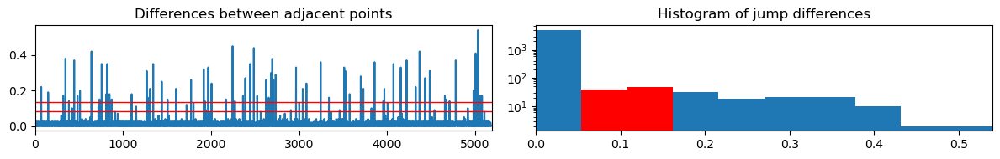



found width of 0.054 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5189,)
computing range... ---> range = (1.01,1.07)
displaying jump_fig for switch parameter = s2



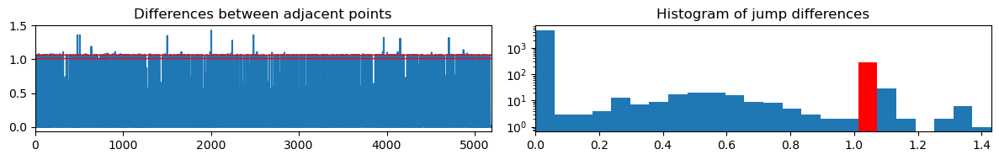



found width of 0.060 for s2
greater than prev width of 0.054 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5189,)
computing range... ---> range = (0.81,0.87)
displaying jump_fig for switch parameter = s3



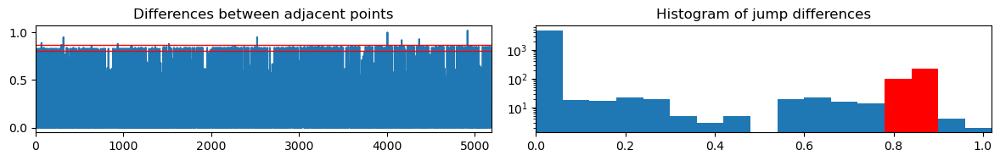



found width of 0.060 for s3
greater than prev width of 0.060 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.81,0.87)
Jump points detected: 302
out of total: ~400.0

computing offset...


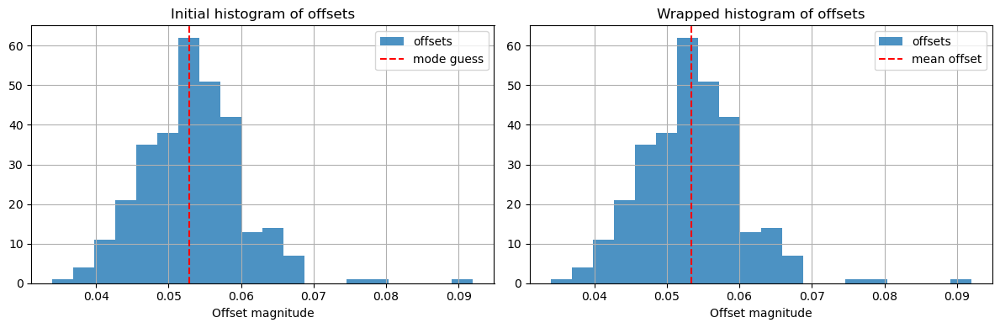



offset = 0.053 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.012 seconds over 8816.172 switches
Corrected Switch Time = 0.2500014


In [53]:
filename = 'Datasets/Whole_setup/03-11/PAX_3-11_50m_Orth_2_1345_desktop.csv'
ds_1345 = SwitchSet(filename, set_range=None, skip_default_signal_baseline=20)
ds_1345.find_switches(nominal_switch_rate=2, print_process=True)

In [54]:
ds_1345.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 35 observations with <4 points (out of total 9213 observations)

--- interpolating data ---
length before: 4590
length after: 4607
17 total added
--- end interpolating data ---

--- interpolating data ---
length before: 4588
length after: 4607
19 total added
--- end interpolating data ---
Signal 1 size=4607	Signal 1 range: t=(20.42,2323.43)
Signal 2 size=4607	Signal 2 range: t=(20.67,2323.68)
=== end average_data ===


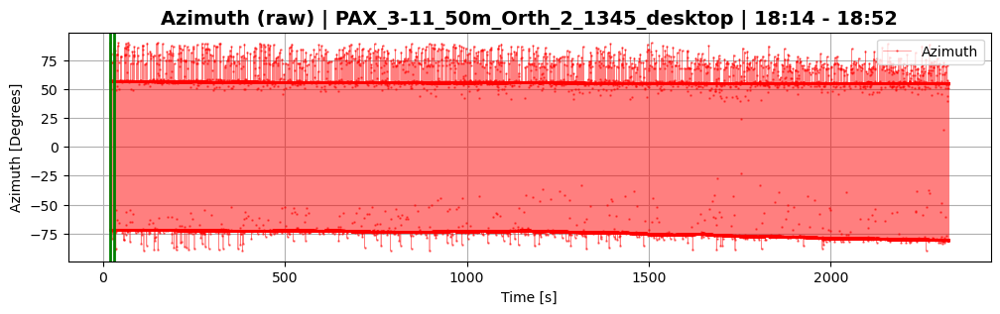

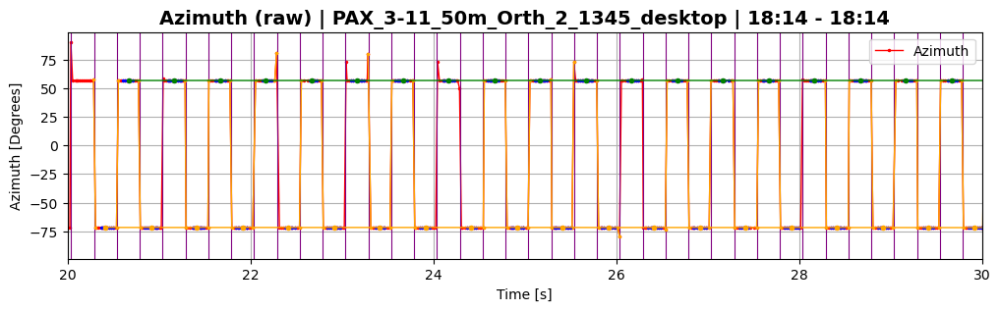

In [55]:
ds_1345.plot_raw(plot_param='Azimuth', sample_range=(20,30),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

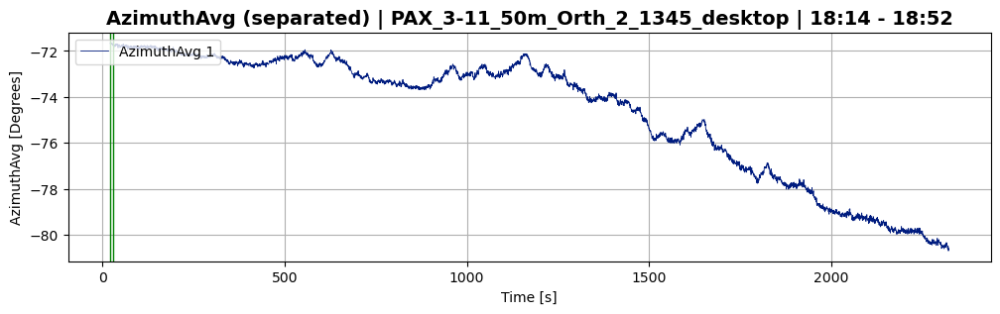

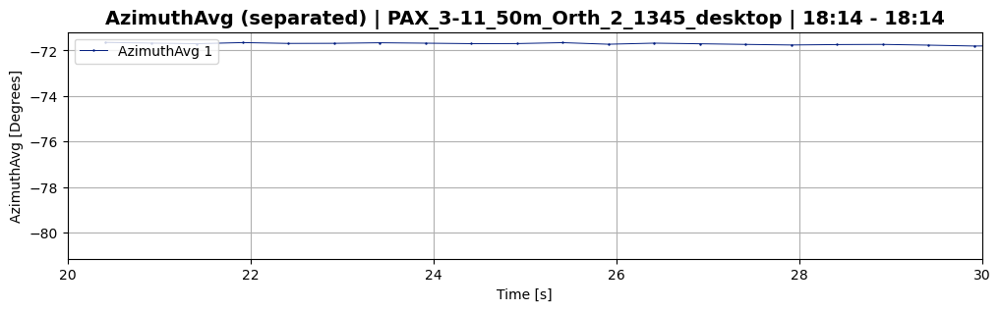

In [56]:
ds_1345.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(20,30))

In [79]:
reset_times_1345 = ds_1345.calc_stokes_ptf(reference=None, angle_threshold_deg=2, print_process=True);

Using "resetting reference SOPs" approach with threshold = 2.0 degrees
Reference matrix was reset 12 times
Reset at time t=211.04
Reset at time t=430.54
Reset at time t=500.54
Reset at time t=711.04
Reset at time t=896.55
Reset at time t=1038.55
Reset at time t=1303.05
Reset at time t=1497.05
Reset at time t=1746.05
Reset at time t=1949.05
...


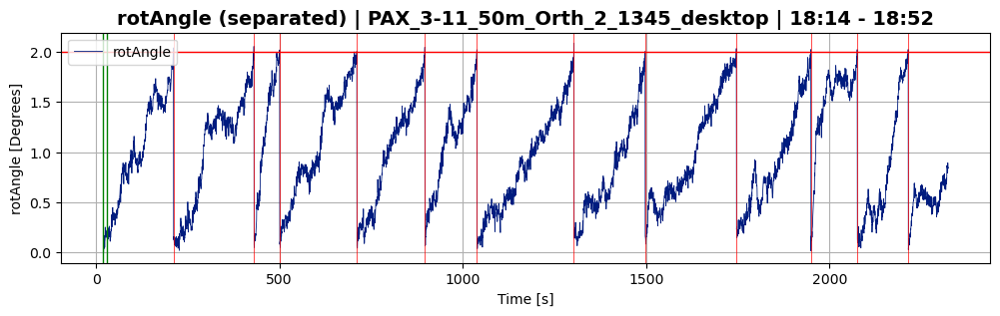

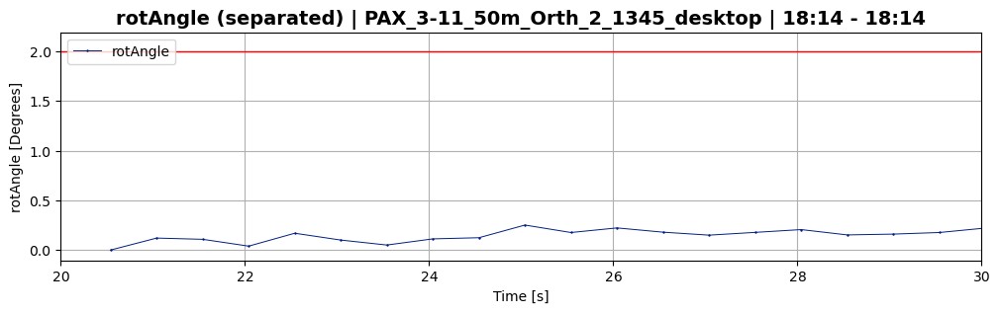

In [80]:
ds_1345.plot_separated(plot_param='rotAngle',sample_range=(20,30))

##### 1560 dataset

Time range: min=20.003, max=2324.011
Determining change point ranges automatically...
Using change_point_range_1=(20.003, 120.003)
Using change_point_range_2=(2224.011, 2324.011)
=== performing change point detection ===
cp range: (20.003, 120.003)
using 5952 data entries
skipping 0 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5952,)
computing range... ---> range = (0.29,0.35)
displaying jump_fig for switch parameter = s1



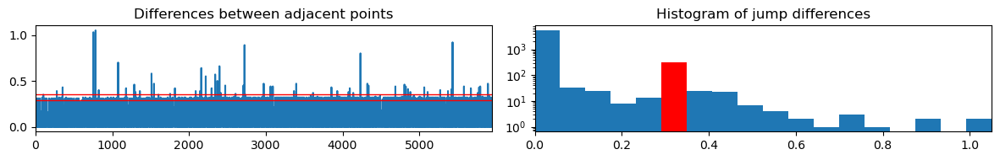



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5952,)
computing range... ---> range = (1.17,1.23)
displaying jump_fig for switch parameter = s2



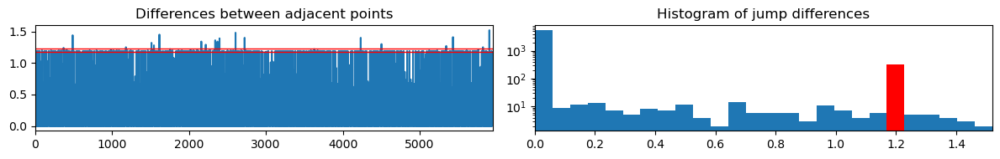



found width of 0.058 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5952,)
computing range... ---> range = (0.66,0.72)
displaying jump_fig for switch parameter = s3



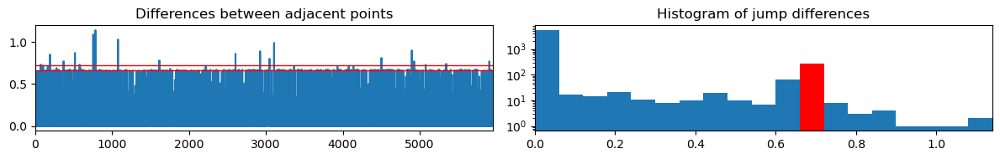



found width of 0.060 for s3
greater than prev width of 0.058 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.66,0.72)
Jump points detected: 270
out of total: ~399.9

computing offset...


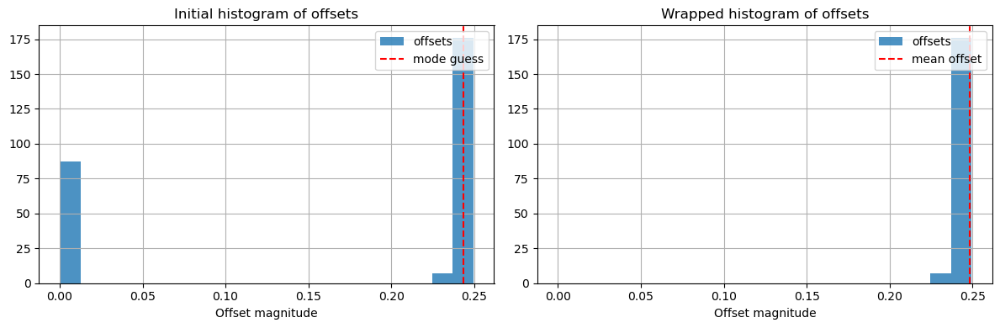



offset = 0.248 seconds
=== end change point detection ===
=== performing change point detection ===
cp range: (2224.011, 2324.011)
using 5867 data entries
skipping 130601 points
considering params: ['s1', 's2', 's3']

--- switch param: s1 ---
size of data we are using = (5867,)
computing range... ---> range = (0.52,0.58)
displaying jump_fig for switch parameter = s1



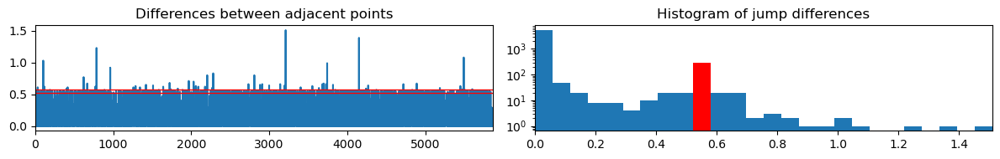



found width of 0.058 for s1
greater than prev width of -1.000 for None
--- end of switch param: s1 ---

--- switch param: s2 ---
size of data we are using = (5867,)
computing range... ---> range = (0.94,1.00)
displaying jump_fig for switch parameter = s2



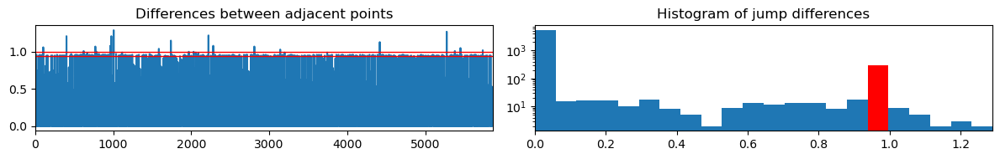



found width of 0.059 for s2
greater than prev width of 0.058 for s1
--- end of switch param: s2 ---

--- switch param: s3 ---
size of data we are using = (5867,)
computing range... ---> range = (0.83,0.89)
displaying jump_fig for switch parameter = s3



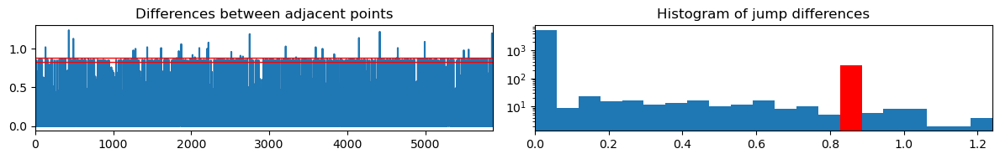



found width of 0.059 for s3
greater than prev width of 0.059 for s2
--- end of switch param: s3 ---

---> switch parameter found: s3 <---
finding differences within range = (0.83,0.89)
Jump points detected: 297
out of total: ~400.0

computing offset...


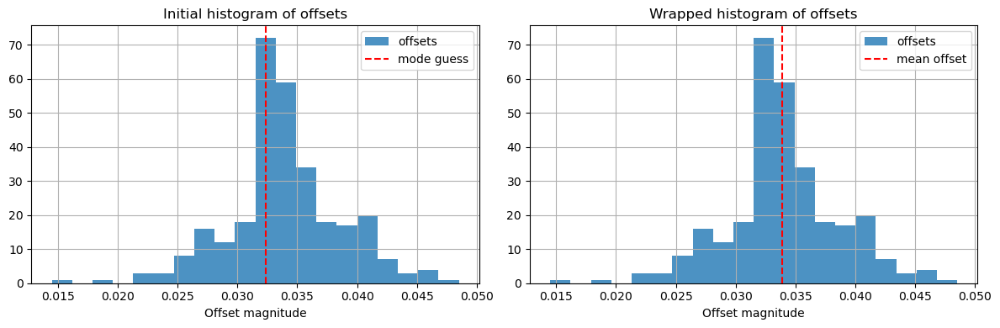



offset = 0.034 seconds
=== end change point detection ===
Nominal Switch Time = 0.2500000
Offset change of 0.036 seconds over 8816.032 switches
Corrected Switch Time = 0.2500040


In [59]:
filename = 'Datasets/Whole_setup/03-11/PAX_3-11_50m_Orth_2_1560_laptop.csv'
ds_1560 = SwitchSet(filename, set_range=None, skip_default_signal_baseline=20)
ds_1560.find_switches(nominal_switch_rate=2, print_process=True)

In [60]:
ds_1560.average_data(print_process=True)

=== starting average_data ===
averaging data... Done
Dropped 0 observations with <4 points (out of total 9214 observations)

--- interpolating data ---
length before: 4607
length after: 4607
0 total added
--- end interpolating data ---

--- interpolating data ---
length before: 4607
length after: 4607
0 total added
--- end interpolating data ---
Signal 1 size=4607	Signal 1 range: t=(20.62,2323.66)
Signal 2 size=4607	Signal 2 range: t=(20.37,2323.41)
=== end average_data ===


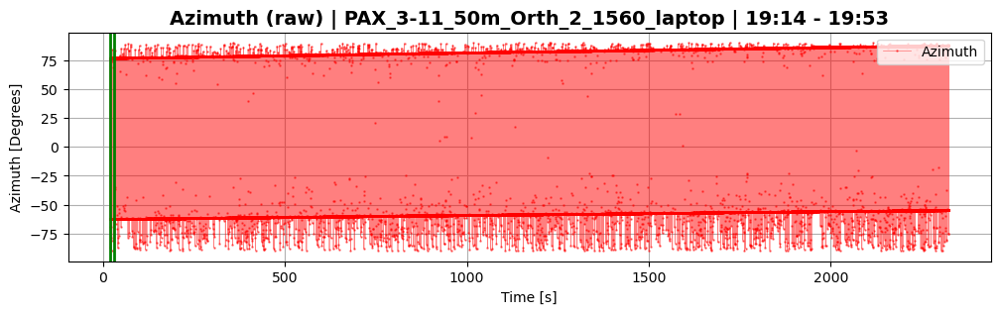

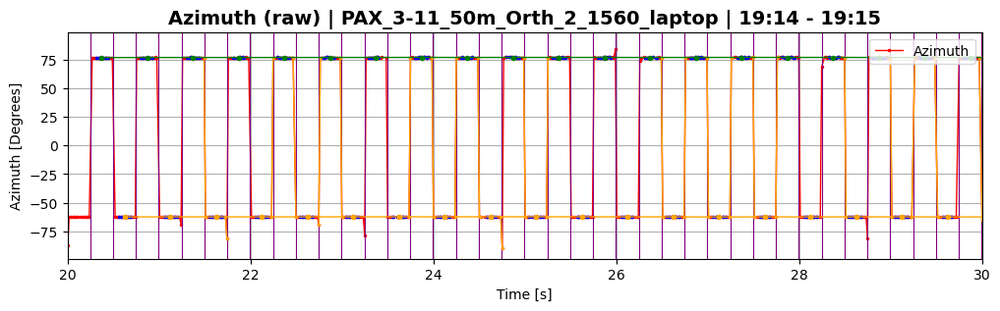

In [61]:
ds_1560.plot_raw(plot_param='Azimuth', sample_range=(20,30),plot_switch=True,plot_jumps=True,plot_valid=True,plot_avg=True)

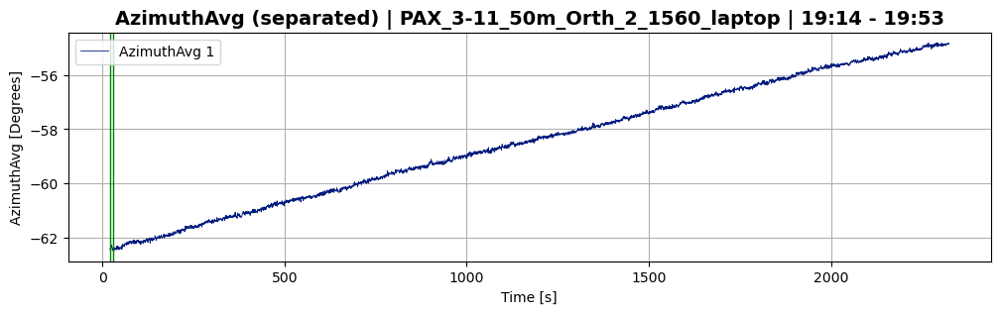

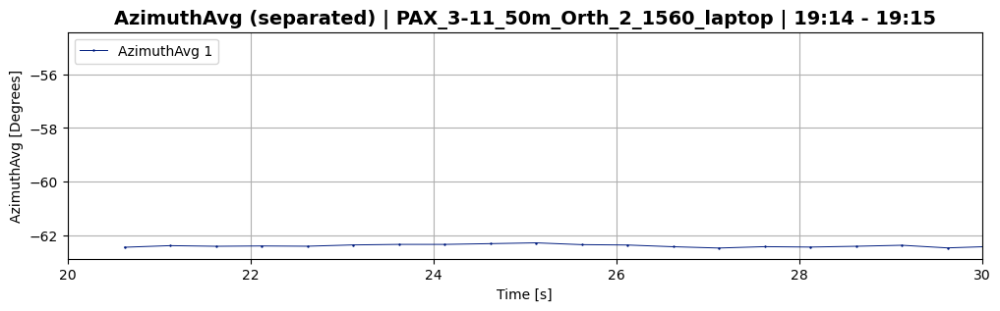

In [62]:
ds_1560.plot_separated(plot_param='AzimuthAvg',plot_signal=1,sample_range=(20,30))

In [81]:
reset_times_1560 = ds_1560.calc_stokes_ptf(reference=reset_times_1345, reset_delay=0, print_process=True);

Using provided reset times to reset reference matrix
Reference matrix was reset 12 times
Reset at time t=211.50
Reset at time t=431.00
Reset at time t=501.01
Reset at time t=711.51
Reset at time t=897.01
Reset at time t=1039.01
Reset at time t=1303.52
Reset at time t=1497.52
Reset at time t=1746.53
Reset at time t=1949.53
...


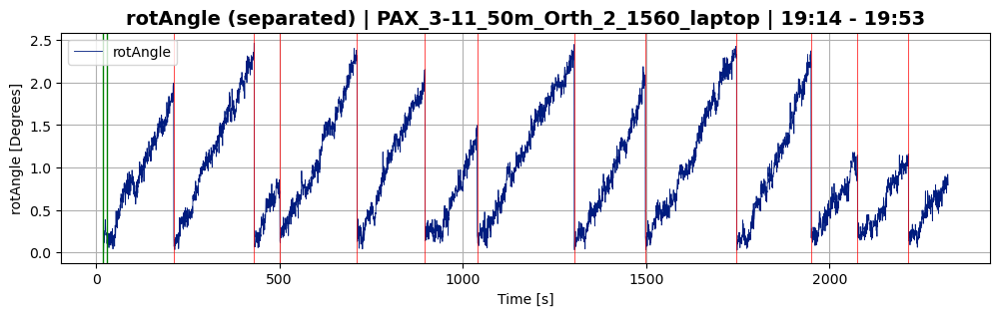

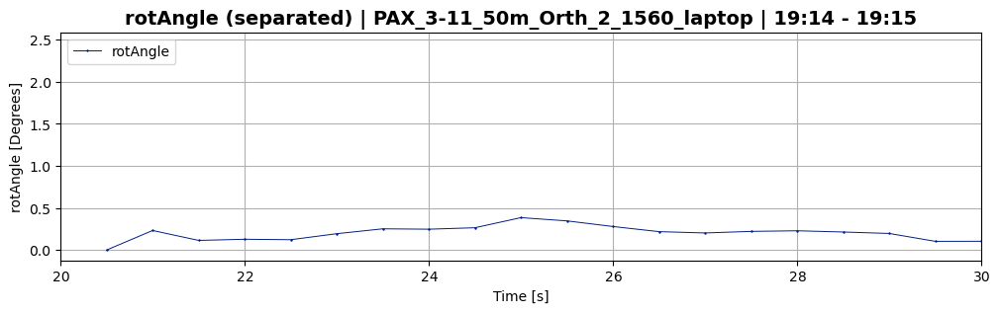

In [82]:
ds_1560.plot_separated(plot_param='rotAngle',sample_range=(20,30))

##### Both 1345 and 1560 rotAngle

In [83]:
ds_50m_3_11 = (ds_1345, ds_1560)

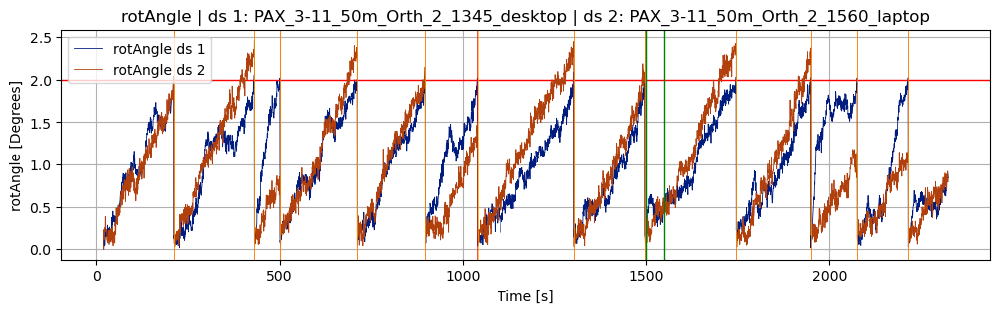

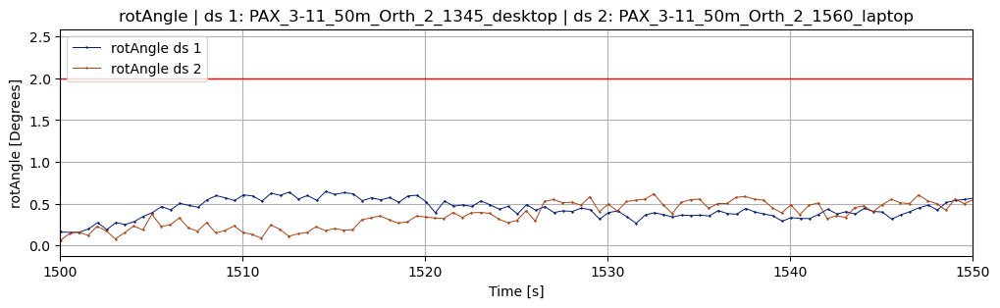

In [84]:
plot_rot_angle(ds_50m_3_11[0], ds_50m_3_11[1], birds_eye=True, sample_range=(1500,1550))

In [86]:
statistics.mean(reset_times_1560)

1214.9333957367376

### Measurement reliability

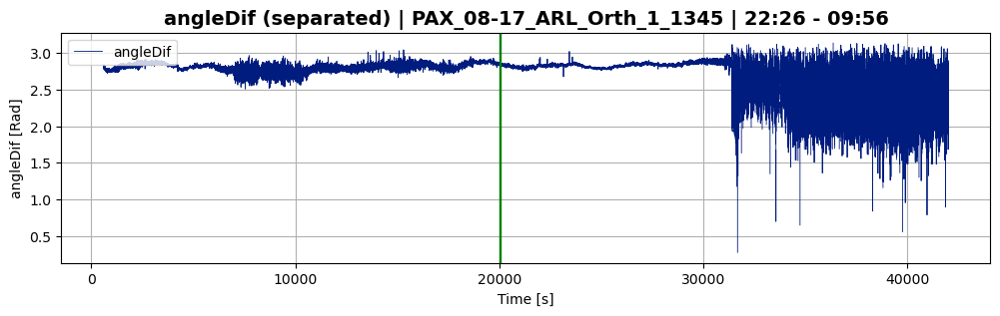

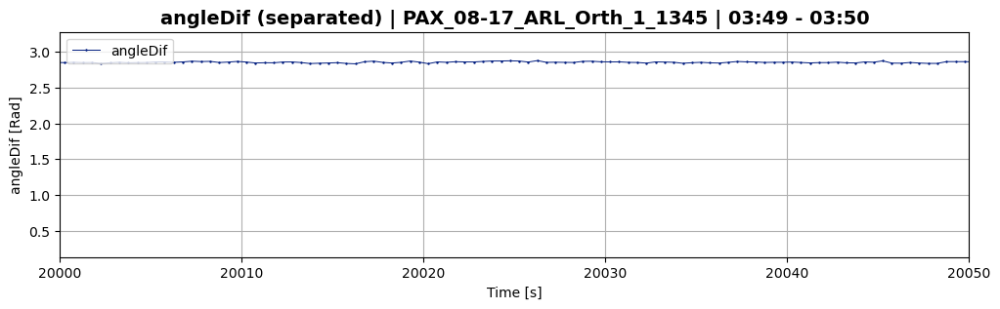

In [159]:
ds_ARL_1_1345.plot_separated(plot_param='angleDif',sample_range=(20000,20050))

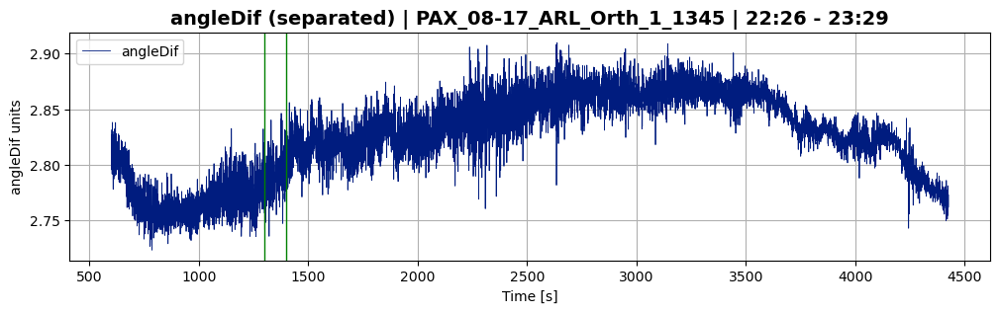

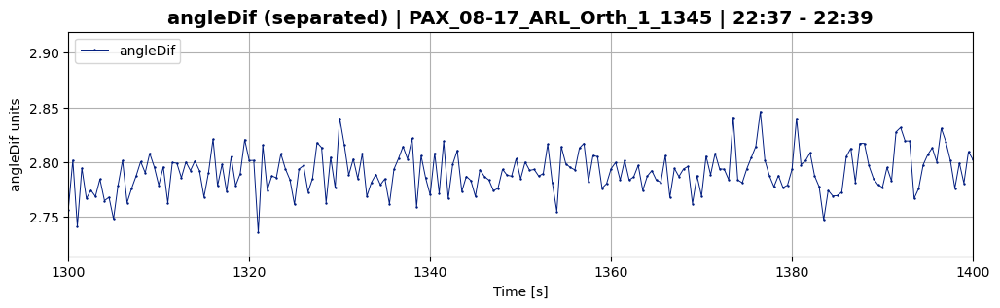

In [94]:
### Is the delta between the stokes vectors stable? Ideally, yes
ds_ARL_1_1345.plot_separated(plot_param='angleDif', sample_range=(1300,1400))